In [1]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta,date
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [2]:
cust_data = pd.read_excel('/Users/pritigirishvankudre/Capstone Project/data/Customer_Data.xlsx')

In [3]:
cust_data.head()

,Business Partner,Customer No.,Partner Type,Data Origin,Title,Marital Status,Occupation,Date of Birth,Death date
0,31,1,1.0,Z001,NaN,NaN,NaN,NaN,NaT
1,32,2,1.0,Z005,NaN,NaN,NaN,NaN,NaT
2,34,4,1.0,Z005,NaN,2.0,NaN,NaN,NaT
3,35,5,1.0,Z005,NaN,NaN,NaN,NaN,NaT
4,42,7,1.0,Z008,NaN,NaN,NaN,NaN,NaT


In [4]:
cust_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 555338 entries, 0 to 555337
Data columns (total 9 columns):
Business Partner    555338 non-null object
Customer No.        555338 non-null object
Partner Type        555260 non-null float64
Data Origin         555202 non-null object
Title               509031 non-null float64
Marital Status      16037 non-null float64
Occupation          14558 non-null float64
Date of Birth       13444 non-null object
Death date          663 non-null datetime64[ns]
dtypes: datetime64[ns](1), float64(4), object(4)
memory usage: 38.1+ MB


In [5]:
'''
Mehtod to understand Null values distribution
'''
col_null = pd.DataFrame(cust_data.isnull().sum()).reset_index()
col_null.columns = ['DataColumns','NullCount']
col_null['NullCount_Pct'] = round((col_null['NullCount']/cust_data.shape[0])*100,2)
display (col_null)

,DataColumns,NullCount,NullCount_Pct
0,Business Partner,0,0.00
1,Customer No.,0,0.00
2,Partner Type,78,0.01
3,Data Origin,136,0.02
4,Title,46307,8.34
5,Marital Status,539301,97.11
6,Occupation,540780,97.38
7,Date of Birth,541894,97.58
8,Death date,554675,99.88


In [6]:
'''
Method to understand Unique values distribution
'''

col_uniq = pd.DataFrame(cust_data.nunique()).reset_index()
col_uniq.columns = ['DataColumns','UniqCount']
col_uniq_cnt = pd.DataFrame(cust_data.count(axis=0)).reset_index()
col_uniq_cnt.columns = ['DataColumns','UniqCount']
col_uniq['UniqCount_Pct'] = round((col_uniq['UniqCount']/col_uniq_cnt['UniqCount'])*100,2)
display (col_uniq)

,DataColumns,UniqCount,UniqCount_Pct
0,Business Partner,555338,100.00
1,Customer No.,555338,100.00
2,Partner Type,7,0.00
3,Data Origin,22,0.00
4,Title,2,0.00
5,Marital Status,5,0.03
6,Occupation,31,0.21
7,Date of Birth,7045,52.40
8,Death date,623,93.97


- Death Date, Birth Date, Marital Status, Occupation could be dropped as close to 97% data is null
- NA values for Title could be filled out basis Partner Type

In [7]:
cust_data_final = cust_data[['Customer No.','Partner Type','Data Origin']].copy()

In [8]:
cust_data_final.head()

,Customer No.,Partner Type,Data Origin
0,1,1.0,Z001
1,2,1.0,Z005
2,4,1.0,Z005
3,5,1.0,Z005
4,7,1.0,Z008


In [9]:
final_inv_data = pd.read_csv('/Users/pritigirishvankudre/Capstone Project/data/Final_invoice.csv')

/Users/pritigirishvankudre/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (9,10,14,15,21,41,51) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [10]:
final_inv_data.head()

,Unnamed: 0,Amt Rcvd From Custom,Amt Rcvd From Ins Co,Area / Locality,CGST(14%),CGST(2.5%),CGST(6%),CGST(9%),CITY,Cash /Cashless Type,Claim No.,Cust Type,Customer No.,District,Expiry Date,Gate Pass Date,Gate Pass Time,IGST(12%),IGST(18%),IGST(28%),IGST(5%),Insurance Company,Invoice Date,Invoice No,Invoice Time,Job Card No,JobCard Date,JobCard Time,KMs Reading,Labour Total,Make,Misc Total,Model,ODN No.,OSL Total,Order Type,Outstanding Amt,Parts Total,Pin code,Plant,Plant Name1,Policy no.,Print Status,Recovrbl Exp,Regn No,SGST/UGST(14%),SGST/UGST(2.5%),SGST/UGST(6%),SGST/UGST(9%),Service Advisor Name,TDS amount,Technician Name,Total Amt Wtd Tax.,Total CGST,Total GST,Total IGST,Total SGST/UGST,Total Value,User ID
0,0,0.0,0.0,MAJIWADA,0.0,0.0,0.0,0.0,Thane,NaN,NaN,Retail,67849,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-02,7005200002,11:30:36,168303,2014-12-13,14:29:43,49317,1203.14,GENERAL MOTORS,0.00,SPARK,7.005200e+09,500.06,Paid Service,0.0,2348.75,400601,BC01,THANE,NaN,NO,0.0,KA19MA1291,0.0,0.0,0.0,0.0,NaN,0.0,RUPESH,4051.95,0.0,0.0,0.0,0.0,4051.95,BC01FS1
1,1,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200003,10:07:32,173997,2015-01-02,14:12:18,78584,804.26,TATA MOTORS,197.03,INDICA,7.005200e+09,0.00,SMC Value Package,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,1001.29,0.0,0.0,0.0,0.0,1001.29,BC01SA2
2,2,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE[W],NaN,NaN,Retail,81055,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200004,11:12:57,173889,2015-01-02,11:40:44,33985,180.19,MARUTI SUZUKI,0.00,ZEN,7.005200e+09,0.00,Running Repairs,0.0,52.95,400607,BC01,THANE,NaN,NO,0.0,AP09AX0582,0.0,0.0,0.0,0.0,NaN,0.0,IMRAN,233.14,0.0,0.0,0.0,0.0,233.14,BC01SA2
3,3,0.0,0.0,THNAE,0.0,0.0,0.0,0.0,THNAE,NaN,NaN,Retail,84419,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200005,11:40:44,174158,2015-01-03,10:12:32,78584,0.00,TATA MOTORS,0.00,INDICA,7.005200e+09,0.00,SMC Redemption,0.0,0.00,400603,BC01,THANE,NaN,NO,0.0,MH43R3046,0.0,0.0,0.0,0.0,NaN,0.0,PRASHANT,0.00,0.0,0.0,0.0,0.0,0.00,BC01SA2
4,4,0.0,0.0,THANE,0.0,0.0,0.0,0.0,THANE,NaN,NaN,Retail,18980,Maharashtra,NaN,NaN,00:00:00,0.0,0.0,0.0,0.0,NaN,2015-01-03,7005200006,12:07:17,173860,2015-01-02,10:45:42,50057,1202.97,HYUNDAI,100.00,SANTRO XING,7.005200e+09,499.99,Paid Service,0.0,944.16,400603,BC01,THANE,NaN,NO,0.0,MH04CD9768,0.0,0.0,0.0,0.0,NaN,0.0,DAYANAND,2747.12,0.0,0.0,0.0,0.0,2747.12,BC01SA2


In [11]:
final_inv_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 492314 entries, 0 to 492313
Data columns (total 59 columns):
Unnamed: 0              492314 non-null int64
Amt Rcvd From Custom    295028 non-null float64
Amt Rcvd From Ins Co    295028 non-null float64
Area / Locality         468424 non-null object
CGST(14%)               295028 non-null float64
CGST(2.5%)              295028 non-null float64
CGST(6%)                295028 non-null float64
CGST(9%)                295028 non-null float64
CITY                    492313 non-null object
Cash /Cashless Type     27420 non-null object
Claim No.               4804 non-null object
Cust Type               492314 non-null object
Customer No.            492314 non-null object
District                492314 non-null object
Expiry Date             22231 non-null object
Gate Pass Date          40915 non-null object
Gate Pass Time          492314 non-null object
IGST(12%)               295028 non-null float64
IGST(18%)               295028 non-null fl

In [12]:
'''
Mehtod to understand Null values distribution
'''
col_null = pd.DataFrame(final_inv_data.isnull().sum()).reset_index()
col_null.columns = ['DataColumns','NullCount']
col_null['NullCount_Pct'] = round((col_null['NullCount']/final_inv_data.shape[0])*100,2)
display (col_null)

,DataColumns,NullCount,NullCount_Pct
0,Unnamed: 0,0,0.00
1,Amt Rcvd From Custom,197286,40.07
2,Amt Rcvd From Ins Co,197286,40.07
3,Area / Locality,23890,4.85
4,CGST(14%),197286,40.07
5,CGST(2.5%),197286,40.07
6,CGST(6%),197286,40.07
7,CGST(9%),197286,40.07
8,CITY,1,0.00
9,Cash /Cashless Type,464894,94.43


In [13]:
final_inv_data_final = final_inv_data[['Cust Type','Customer No.','District','JobCard Date','KMs Reading','Make','Model','Order Type','Plant','Total Amt Wtd Tax.']].copy()
final_inv_data_final.head()

,Cust Type,Customer No.,District,JobCard Date,KMs Reading,Make,Model,Order Type,Plant,Total Amt Wtd Tax.
0,Retail,67849,Maharashtra,2014-12-13,49317,GENERAL MOTORS,SPARK,Paid Service,BC01,4051.95
1,Retail,84419,Maharashtra,2015-01-02,78584,TATA MOTORS,INDICA,SMC Value Package,BC01,1001.29
2,Retail,81055,Maharashtra,2015-01-02,33985,MARUTI SUZUKI,ZEN,Running Repairs,BC01,233.14
3,Retail,84419,Maharashtra,2015-01-03,78584,TATA MOTORS,INDICA,SMC Redemption,BC01,0.00
4,Retail,18980,Maharashtra,2015-01-02,50057,HYUNDAI,SANTRO XING,Paid Service,BC01,2747.12


In [14]:
'''
Method to understand Unique values distribution
'''

col_uniq = pd.DataFrame(final_inv_data_final.nunique()).reset_index()
col_uniq.columns = ['DataColumns','UniqCount']
col_uniq_cnt = pd.DataFrame(final_inv_data_final.count(axis=0)).reset_index()
col_uniq_cnt.columns = ['DataColumns','UniqCount']
col_uniq['UniqCount_Pct'] = round((col_uniq['UniqCount']/col_uniq_cnt['UniqCount'])*100,2)
display (col_uniq)

,DataColumns,UniqCount,UniqCount_Pct
0,Cust Type,7,0.00
1,Customer No.,253484,51.49
2,District,36,0.01
3,JobCard Date,1643,0.33
4,KMs Reading,159473,32.39
5,Make,28,0.01
6,Model,245,0.05
7,Order Type,9,0.00
8,Plant,242,0.05
9,Total Amt Wtd Tax.,258071,52.42


In [15]:
'''
Mehtod to understand Null values distribution
'''
col_null = pd.DataFrame(final_inv_data_final.isnull().sum()).reset_index()
col_null.columns = ['DataColumns','NullCount']
col_null['NullCount_Pct'] = round((col_null['NullCount']/final_inv_data_final.shape[0])*100,2)
display (col_null)

,DataColumns,NullCount,NullCount_Pct
0,Cust Type,0,0.00
1,Customer No.,0,0.00
2,District,0,0.00
3,JobCard Date,0,0.00
4,KMs Reading,0,0.00
5,Make,0,0.00
6,Model,1525,0.31
7,Order Type,0,0.00
8,Plant,0,0.00
9,Total Amt Wtd Tax.,0,0.00


In [16]:
jtd_data = pd.read_csv('/Users/pritigirishvankudre/Capstone Project/data/JTD.csv')

In [17]:
jtd_data.head()

,Unnamed: 0,DBM Order,Order Item,Material,Labor Value Number,Description,Item Category,Order Quantity,Target quantity UoM,Net value
0,0,22385,180,OSLCC_SRV31,NaN,MACHINING RR.SUSPENSION CHARGE (MAJOR),P010,1.2,MIN,1869.87
1,1,23910,10,1DM279018170117,NaN,ASSY.OIL COOLER (6-PLATE) (VOR,P002,1.0,EA,2151.13
2,2,23910,40,1IS150203BE01,NaN,FRONT WHEEL BEARING/ LUBRICATE,P002,1.0,EA,2552.92
3,3,23910,60,1DM279001990173,NaN,ASSY.CYL.HEAD W /O INJ.(NA W /O,P002,1.0,EA,20360.14
4,4,23910,70,1DM88552790S001SA,NaN,Engine Overhaul Kit -Indica Di,P002,1.0,EA,10691.63


In [18]:
'''
Mehtod to understand Null values distribution
'''
col_null = pd.DataFrame(jtd_data.isnull().sum()).reset_index()
col_null.columns = ['DataColumns','NullCount']
col_null['NullCount_Pct'] = round((col_null['NullCount']/jtd_data.shape[0])*100,2)
display (col_null)

,DataColumns,NullCount,NullCount_Pct
0,Unnamed: 0,0,0.00
1,DBM Order,0,0.00
2,Order Item,0,0.00
3,Material,51629,0.92
4,Labor Value Number,3774033,67.16
5,Description,51629,0.92
6,Item Category,0,0.00
7,Order Quantity,0,0.00
8,Target quantity UoM,51629,0.92
9,Net value,0,0.00


In [19]:
'''
Method to understand Unique values distribution
'''

col_uniq = pd.DataFrame(jtd_data.nunique()).reset_index()
col_uniq.columns = ['DataColumns','UniqCount']
col_uniq_cnt = pd.DataFrame(jtd_data.count(axis=0)).reset_index()
col_uniq_cnt.columns = ['DataColumns','UniqCount']
col_uniq['UniqCount_Pct'] = round((col_uniq['UniqCount']/col_uniq_cnt['UniqCount'])*100,2)
display (col_uniq)

,DataColumns,UniqCount,UniqCount_Pct
0,Unnamed: 0,5619484,100.00
1,DBM Order,973473,17.32
2,Order Item,558,0.01
3,Material,126567,2.27
4,Labor Value Number,41176,2.23
5,Description,58558,1.05
6,Item Category,5,0.00
7,Order Quantity,3604,0.06
8,Target quantity UoM,4,0.00
9,Net value,375642,6.68


In [20]:
plant_mast_data = pd.read_excel('/Users/pritigirishvankudre/Capstone Project/data/Plant Master.xlsx')

In [21]:
plant_mast_data.head()

,Plant,Name 1,Valuation Area,Customer no. - plant,Vendor number plant,Factory calendar,Name 2,House number and street,PO Box,Postal Code,City,Sales organization,State
0,BC07,NERKUNDRAM,BC07,PLBC07,PLBC07,IN,NaN,"No.117 Poonamallee High Road,",600107.0,600107,Chennai,MFCS,Tamil Nadu
1,BC30,SAS NAGAR - MOHALI,BC30,PLBC30,PLBC30,IN,NaN,"C-118, Phase 07,",160055.0,160055,Mohali,MFCS,Punjab
2,X001,X001 - AUTO PLANET WHEELS,X001,PLX001,NaN,IN,Thane,"Unit No.3, Kothari Compound,",400610.0,400610,Thane,MFCA,Maharashtra
3,X002,X002 - BHANDARI INDUSTRIES PVT,X002,PLX002,NaN,IN,Ghaziabad,"18/1, C Site 4, Sahibabad",201010.0,201010,Ghaziabad,MFCA,Uttar Pradesh
4,X003,X003 - Om Sri Satya Sai Automo,X003,PLX003,NaN,IN,Bengaluru,"#75, Sy.No. 83/2, Panathur Mai",560087.0,560087,Bengaluru,MFCB,Karnataka


In [22]:
plant_mast_data_final = plant_mast_data[['Plant','Postal Code','City','Sales organization','State']]

- No point joining plant master file as it does not contain data for most of the records from customer/invoice master file.
- Also there is no key value basis which we can join JTD file

In [23]:
# Inner join for Customer Data and Final Invoice

#cust_data_final['Customer No.'] = cust_data_final['Customer No.'].astype(str)
#final_inv_data_final['Customer No.'] = final_inv_data_final['Customer No.'].astype(str)

#cust_inv_data = pd.merge(cust_data_final,final_inv_data_final,how='inner',on=['Customer No.'])
#cust_inv_data.to_csv('/Users/pritigirishvankudre/Capstone Project/data/cust_inv_data.csv')

# Run the join file from here

In [24]:
cust_inv_data = pd.read_csv('/Users/pritigirishvankudre/Capstone Project/data/cust_inv_data.csv')
cust_inv_data.head()

/Users/pritigirishvankudre/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Unnamed: 0,Customer No.,Partner Type,Data Origin,Cust Type,District,JobCard Date,KMs Reading,Make,Model,Order Type,Plant,Total Amt Wtd Tax.
0,0,1,1.0,Z001,Retail,Maharashtra,2012-04-01,1212,MARUTI SUZUKI,KIZASHI,Paid Service,BC02,0.0
1,1,1,1.0,Z001,Retail,Maharashtra,2012-04-02,10,MARUTI SUZUKI,OMNI,Paid Service,BC02,0.0
2,2,1,1.0,Z001,Retail,Maharashtra,2012-07-27,35817,MARUTI SUZUKI,OMNI,Paid Service,BC02,0.0
3,3,1,1.0,Z001,Retail,Maharashtra,2013-03-17,39975,MARUTI SUZUKI,OMNI,Running Repairs,BC02,0.0
4,4,2,1.0,Z005,Retail,Maharashtra,2012-04-02,133165,TATA MOTORS,INDIGO,Running Repairs,BC11,718.3


In [25]:
'''
Mehtod to understand Null values distribution
'''
col_null = pd.DataFrame(cust_inv_data.isnull().sum()).reset_index()
col_null.columns = ['DataColumns','NullCount']
col_null['NullCount_Pct'] = round((col_null['NullCount']/cust_inv_data.shape[0])*100,2)
display (col_null)

,DataColumns,NullCount,NullCount_Pct
0,Unnamed: 0,0,0.00
1,Customer No.,0,0.00
2,Partner Type,1667,0.34
3,Data Origin,3567,0.72
4,Cust Type,0,0.00
5,District,0,0.00
6,JobCard Date,0,0.00
7,KMs Reading,0,0.00
8,Make,0,0.00
9,Model,1525,0.31


In [26]:
'''
Method to understand Unique values distribution
'''

col_uniq = pd.DataFrame(cust_inv_data.nunique()).reset_index()
col_uniq.columns = ['DataColumns','UniqCount']
col_uniq_cnt = pd.DataFrame(cust_inv_data.count(axis=0)).reset_index()
col_uniq_cnt.columns = ['DataColumns','UniqCount']
col_uniq['UniqCount_Pct'] = round((col_uniq['UniqCount']/col_uniq_cnt['UniqCount'])*100,2)
display (col_uniq)

,DataColumns,UniqCount,UniqCount_Pct
0,Unnamed: 0,492312,100.00
1,Customer No.,253482,51.49
2,Partner Type,7,0.00
3,Data Origin,22,0.00
4,Cust Type,7,0.00
5,District,36,0.01
6,JobCard Date,1643,0.33
7,KMs Reading,159472,32.39
8,Make,28,0.01
9,Model,245,0.05


In [27]:
cust_inv_data.dropna(axis = 0,subset=['Model'],inplace=True)

In [28]:
cust_inv_data['Partner Type'].fillna('9004',inplace=True)
cust_inv_data['Data Origin'].fillna('Z000',inplace=True)

For Partner Type the value 9004 mapped to Unspecified.

For Data Origin the value Z000 mapped to Unspecified.

In [29]:
cust_inv_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 490787 entries, 0 to 492311
Data columns (total 13 columns):
Unnamed: 0            490787 non-null int64
Customer No.          490787 non-null object
Partner Type          490787 non-null object
Data Origin           490787 non-null object
Cust Type             490787 non-null object
District              490787 non-null object
JobCard Date          490787 non-null object
KMs Reading           490787 non-null int64
Make                  490787 non-null object
Model                 490787 non-null object
Order Type            490787 non-null object
Plant                 490787 non-null object
Total Amt Wtd Tax.    490787 non-null float64
dtypes: float64(1), int64(2), object(10)
memory usage: 52.4+ MB


In [30]:
'''
Function to convert the date into quarter/season
'''

def date_q(date):
    
    """
    Convert Date to Quarter when separated with -
    """
    qdate = date.strip().split('-')[0:2]
    qdate1 = qdate[1]
    qdate2 = str(qdate[0])
    if qdate1 in ['01','02','03']:
        return (qdate2+'-Q1')
    if qdate1 in ['04','05','06']:
        return (qdate2+'-Q2')
    if qdate1 in ['07','08','09']:
        return (qdate2+'-Q3')
    if qdate1 in ['10','11','12']:
        return (qdate2+'-Q4')

cust_inv_data['JobCard Date'] = cust_inv_data['JobCard Date'].apply(lambda x: date_q(x))
cust_inv_data.head()

,Unnamed: 0,Customer No.,Partner Type,Data Origin,Cust Type,District,JobCard Date,KMs Reading,Make,Model,Order Type,Plant,Total Amt Wtd Tax.
0,0,1,1,Z001,Retail,Maharashtra,2012-Q2,1212,MARUTI SUZUKI,KIZASHI,Paid Service,BC02,0.0
1,1,1,1,Z001,Retail,Maharashtra,2012-Q2,10,MARUTI SUZUKI,OMNI,Paid Service,BC02,0.0
2,2,1,1,Z001,Retail,Maharashtra,2012-Q3,35817,MARUTI SUZUKI,OMNI,Paid Service,BC02,0.0
3,3,1,1,Z001,Retail,Maharashtra,2013-Q1,39975,MARUTI SUZUKI,OMNI,Running Repairs,BC02,0.0
4,4,2,1,Z005,Retail,Maharashtra,2012-Q2,133165,TATA MOTORS,INDIGO,Running Repairs,BC11,718.3


# State wise total revenue generation irrespective of the model

In [31]:
a = pd.DataFrame(cust_inv_data.groupby(['District'])['Total Amt Wtd Tax.'].sum()).reset_index()
a.columns = ['state','tot_revenue']
a['percent'] = round(a['tot_revenue']/(a['tot_revenue'].sum())*100,4)
display (a.sort_values(['tot_revenue'], ascending=0))

,state,tot_revenue,percent
30,Tamil Nadu,6.057790e+08,28.0845
20,Maharashtra,5.100709e+08,23.6474
1,Andhra Pradesh,2.022559e+08,9.3768
16,Karnataka,1.743882e+08,8.0848
33,Uttar Pradesh,1.071989e+08,4.9698
27,Punjab,9.898791e+07,4.5892
11,Gujarat,9.274320e+07,4.2997
12,Haryana,6.971315e+07,3.2320
19,Madhya Pradesh,6.037215e+07,2.7989
28,Rajasthan,4.851947e+07,2.2494


# Observation

1. TN and MH leads the geography in terms of revenue.
2. For rest of India, there is a potential to grow from below 10% share to above 10% share.
3. More penetration would be required in states of J&K and NE India.

# Car Make wise total revenue generation irrespective of the state

In [32]:
b = pd.DataFrame(cust_inv_data.groupby(['Make'])['Total Amt Wtd Tax.'].sum()).reset_index()
b.columns = ['make','tot_revenue']
b['percent'] = round(b['tot_revenue']/(b['tot_revenue'].sum())*100,4)
display (b.sort_values(['tot_revenue'], ascending=0))

,make,tot_revenue,percent
12,MAHINDRA & MAHINDRA,5.700116e+08,26.4263
13,MARUTI SUZUKI,4.714567e+08,21.8572
9,HYUNDAI,3.133957e+08,14.5293
24,TATA MOTORS,2.505193e+08,11.6143
6,GENERAL MOTORS,1.301430e+08,6.0336
25,TOYOTA,1.097858e+08,5.0898
5,FORD,9.710378e+07,4.5018
8,HONDA,6.852793e+07,3.1770
22,SKODA,3.926651e+07,1.8204
3,FIAT,3.050094e+07,1.4141


# Observation

1. M&M being the leader generating revenue for MFC followed by Maruti Suzuki.

# State wise Car ownership

In [33]:
c = pd.DataFrame(cust_inv_data.groupby(['Customer No.','District','Make'])['Make'].count())
c.columns = ['make_cnt']
c.head()

,,,make_cnt
Customer No.,District,Make,
1,Maharashtra,MARUTI SUZUKI,4
2,Maharashtra,TATA MOTORS,2
4,Maharashtra,SKODA,3
5,Maharashtra,FORD,3
7,Andhra Pradesh,MAHINDRA & MAHINDRA,1


In [34]:
# Sorting the data basis highest make count against corresponding state

c.sort_values(['make_cnt'], ascending=0)
c.head()

,,,make_cnt
Customer No.,District,Make,
1,Maharashtra,MARUTI SUZUKI,4
2,Maharashtra,TATA MOTORS,2
4,Maharashtra,SKODA,3
5,Maharashtra,FORD,3
7,Andhra Pradesh,MAHINDRA & MAHINDRA,1


In [35]:
#d = c.copy().reset_index()
d = pd.DataFrame(c.groupby(['District','Make'])['make_cnt'].sum()).reset_index()
d.sort_values(['make_cnt','District'], ascending=[0,1], inplace=True)
d.head()

,District,Make,make_cnt
316,Maharashtra,MARUTI SUZUKI,40949
437,Tamil Nadu,MAHINDRA & MAHINDRA,27237
438,Tamil Nadu,MARUTI SUZUKI,25835
312,Maharashtra,HYUNDAI,22359
315,Maharashtra,MAHINDRA & MAHINDRA,22193


In [36]:
def pie_chart(mk_percent,mk_lable,mk_cnt):
    %matplotlib inline
    plt.figure(figsize=(3,3))
    plt.pie(mk_percent,radius=2.5)
    plt.legend(loc='best',labels=['%s = %.2f %%  (%s)' % (l,s,d) for l,s,d in zip(mk_lable,mk_percent,mk_cnt)],bbox_to_anchor=(2.0,1.5))
    plt.show()

Car (Make) ownership distribution for the State of Maharashtra


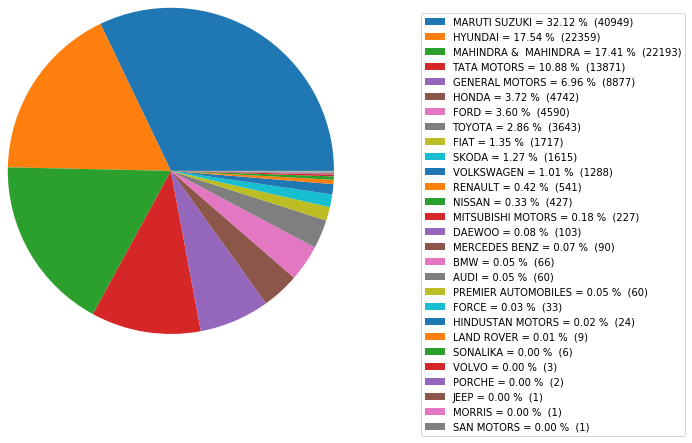

Car (Make) ownership distribution for the State of Tamil Nadu


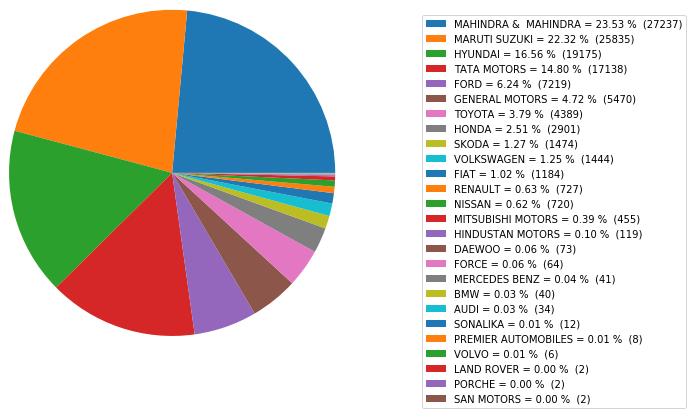

Car (Make) ownership distribution for the State of Karnataka


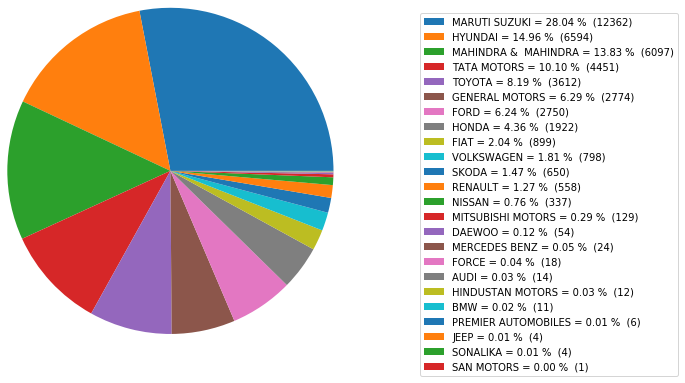

Car (Make) ownership distribution for the State of Uttar Pradesh


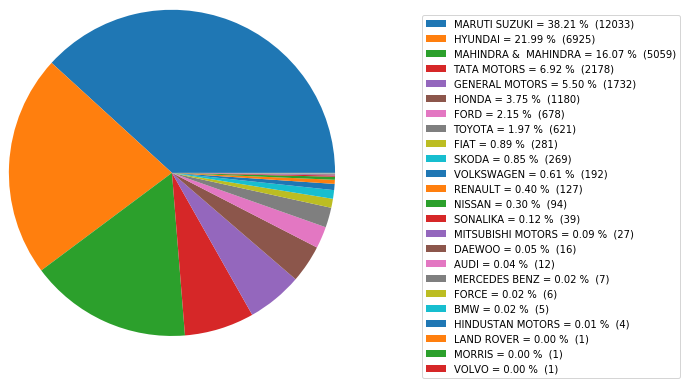

Car (Make) ownership distribution for the State of Andhra Pradesh


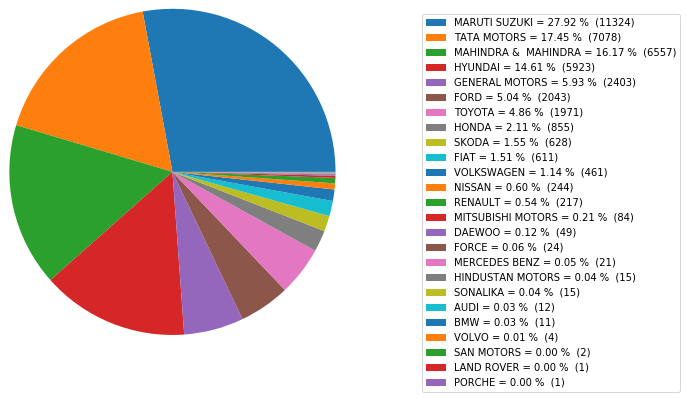

Car (Make) ownership distribution for the State of Gujarat


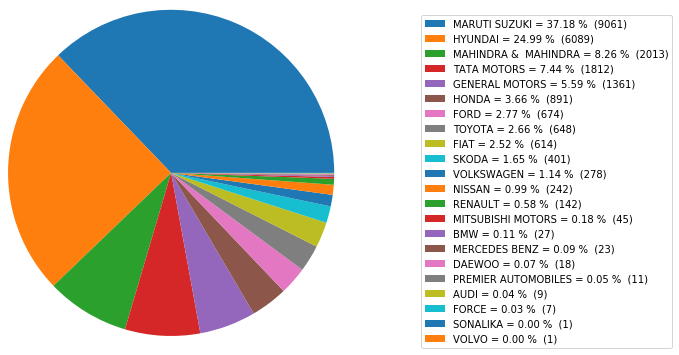

Car (Make) ownership distribution for the State of Punjab


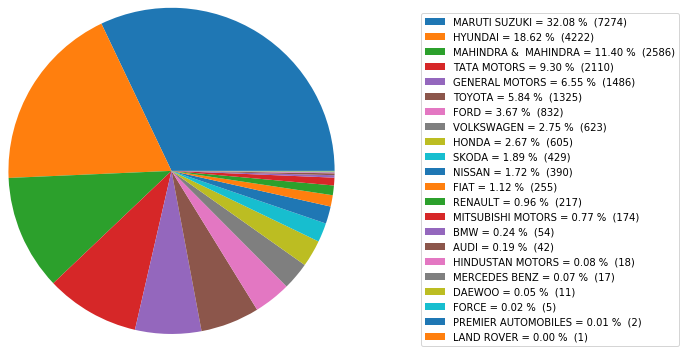

Car (Make) ownership distribution for the State of Haryana


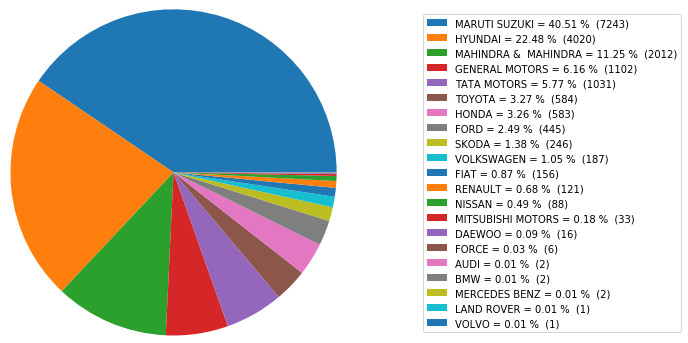

Car (Make) ownership distribution for the State of Rajasthan


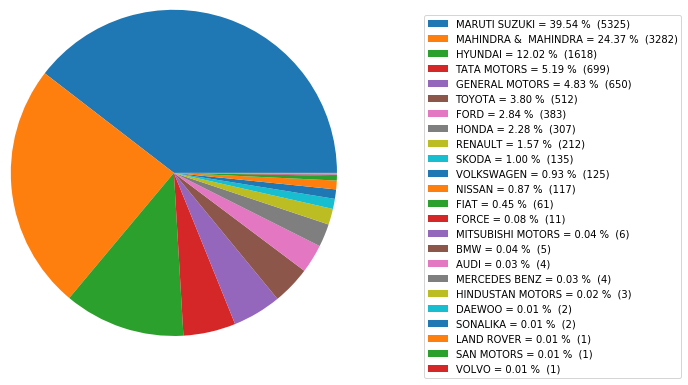

Car (Make) ownership distribution for the State of Madhya Pradesh


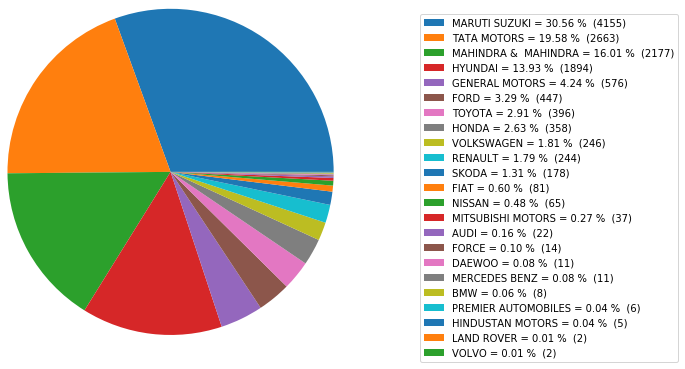

Car (Make) ownership distribution for the State of Delhi


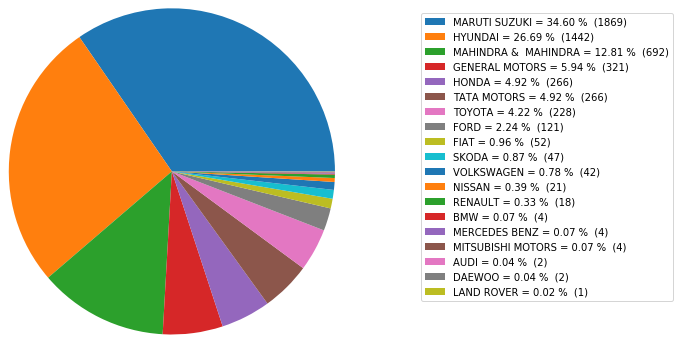

Car (Make) ownership distribution for the State of Telangana


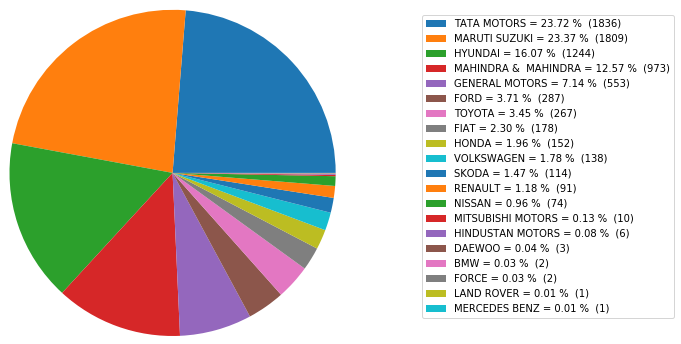

Car (Make) ownership distribution for the State of Bihar


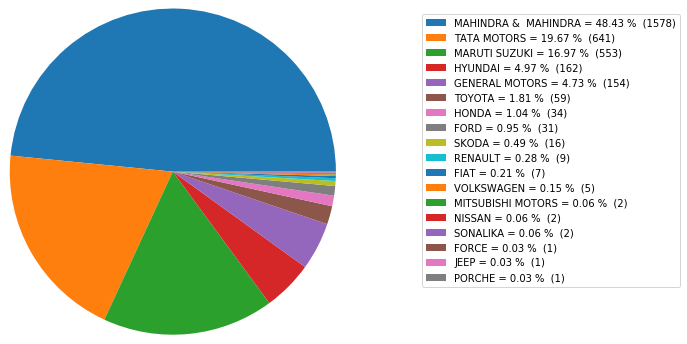

Car (Make) ownership distribution for the State of Kerala


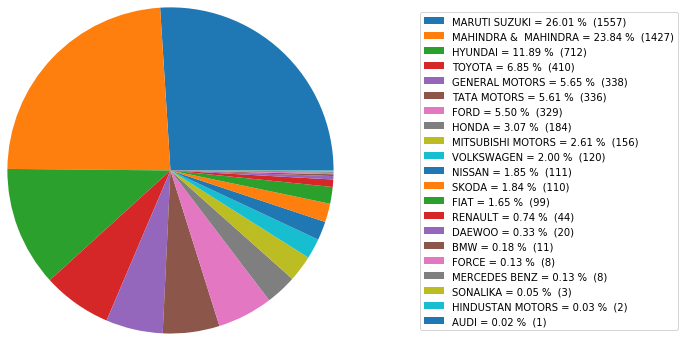

Car (Make) ownership distribution for the State of Himachal Pradesh


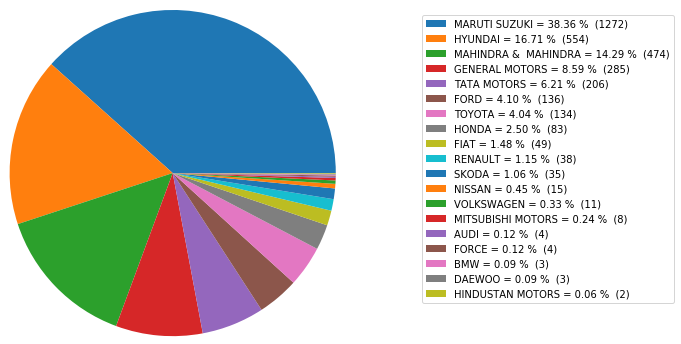

Car (Make) ownership distribution for the State of Uttarakhand


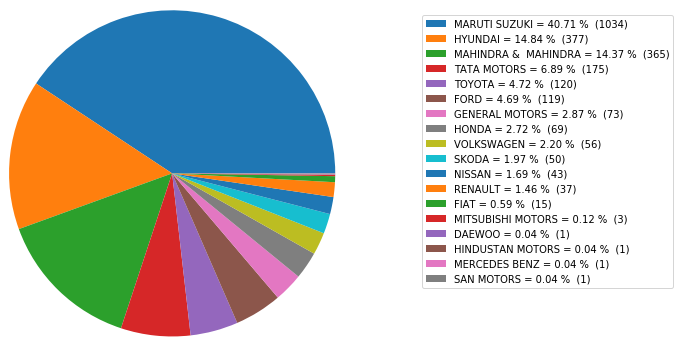

Car (Make) ownership distribution for the State of Chandigarh


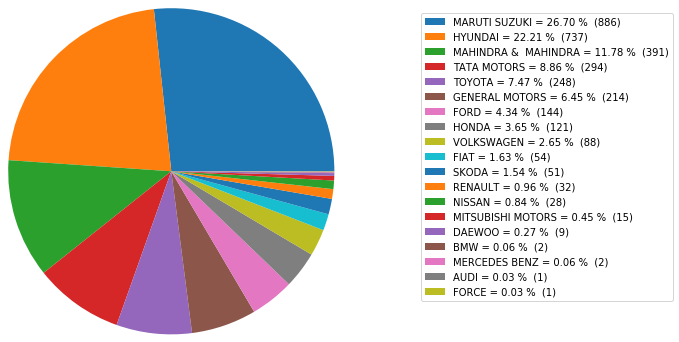

Car (Make) ownership distribution for the State of Odisha


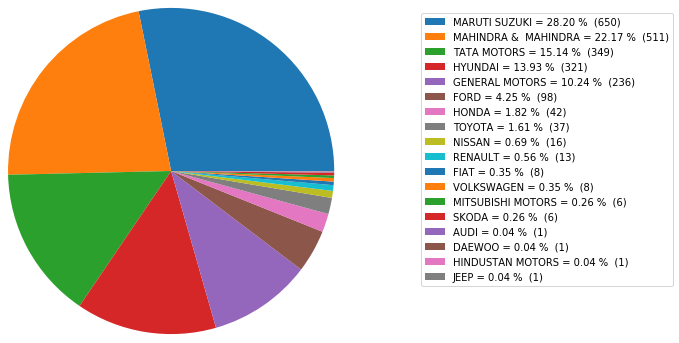

Car (Make) ownership distribution for the State of West Bengal


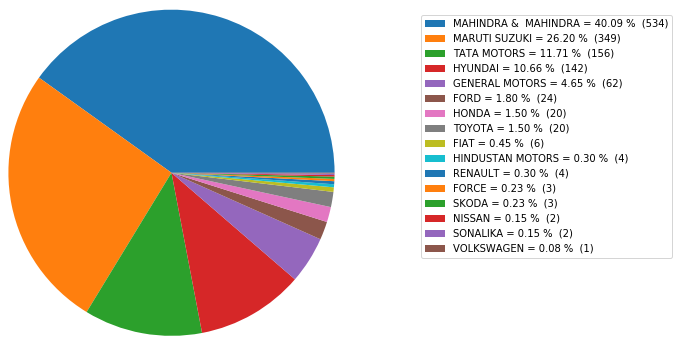

Car (Make) ownership distribution for the State of Puducherry


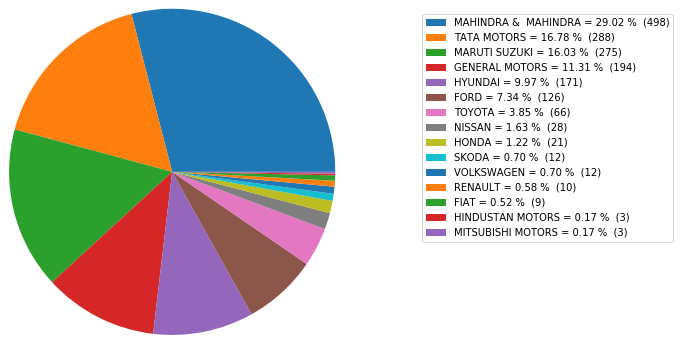

Car (Make) ownership distribution for the State of Dadra and Nagar Hav.


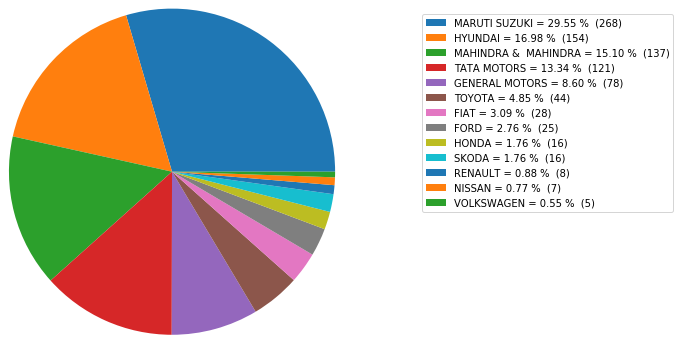

Car (Make) ownership distribution for the State of Chhattisgarh


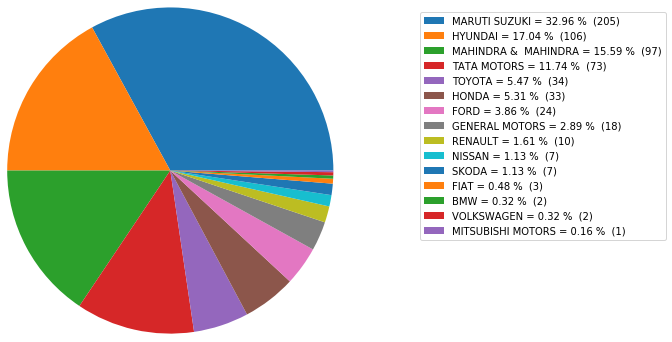

Car (Make) ownership distribution for the State of Daman and Diu


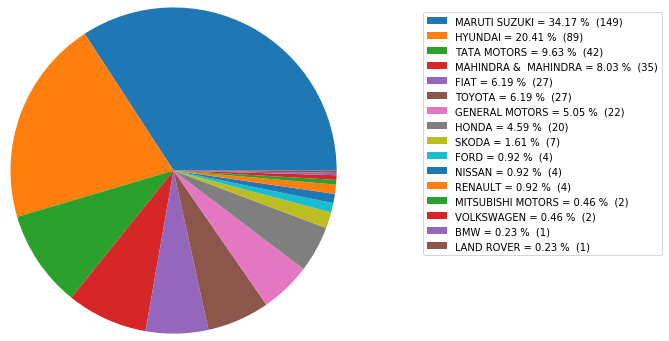

Car (Make) ownership distribution for the State of Jharkhand


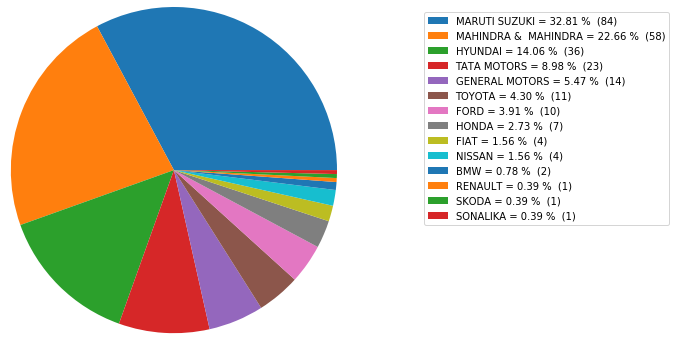

Car (Make) ownership distribution for the State of Assam


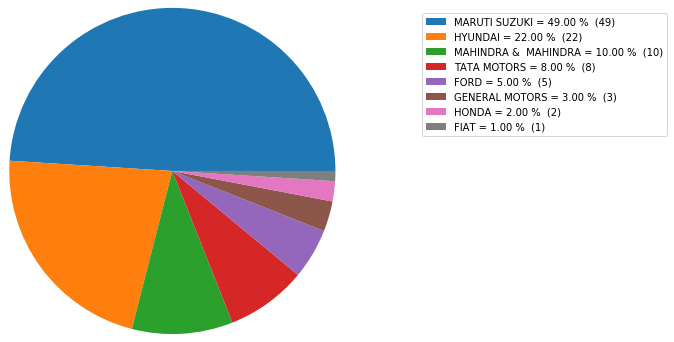

Car (Make) ownership distribution for the State of Arunachal Pradesh


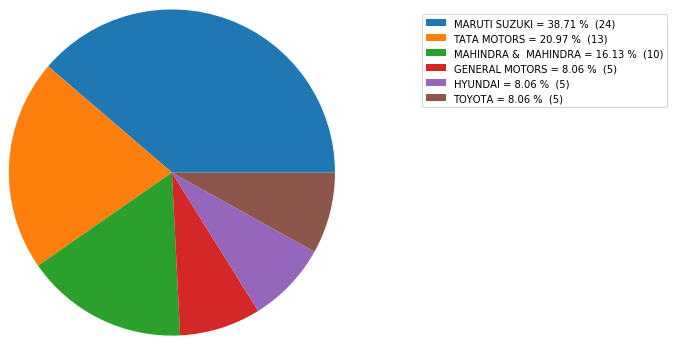

Car (Make) ownership distribution for the State of Nagaland


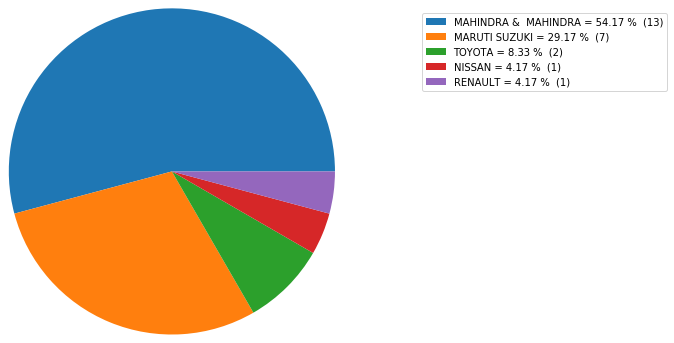

Car (Make) ownership distribution for the State of Goa


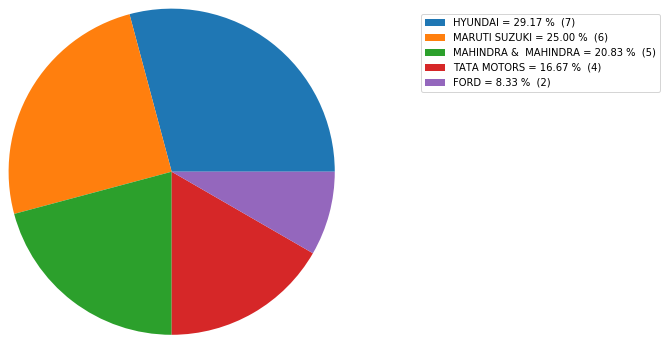

Car (Make) ownership distribution for the State of Jammu and Kashmir


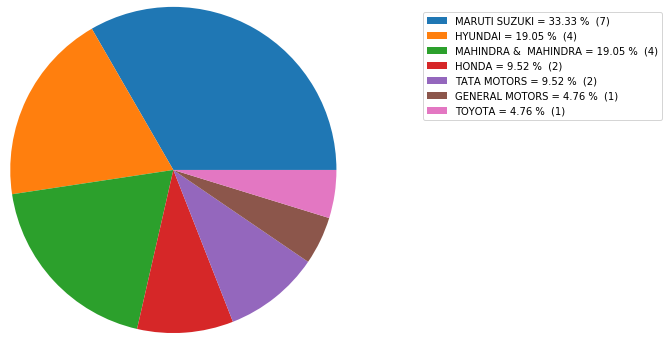

Car (Make) ownership distribution for the State of Megalaya


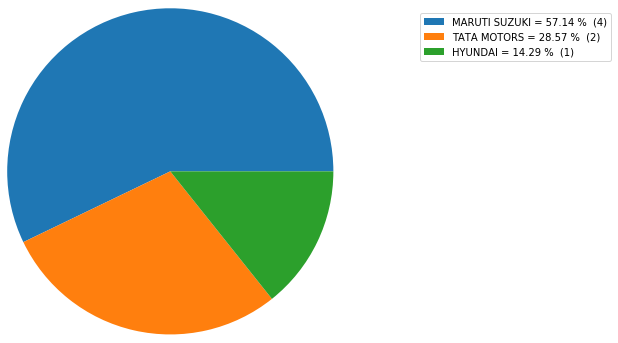

Car (Make) ownership distribution for the State of Andaman and Nico.In.


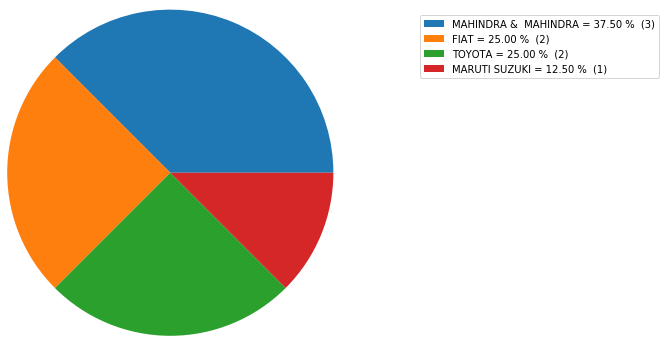

Car (Make) ownership distribution for the State of Lakshadweep


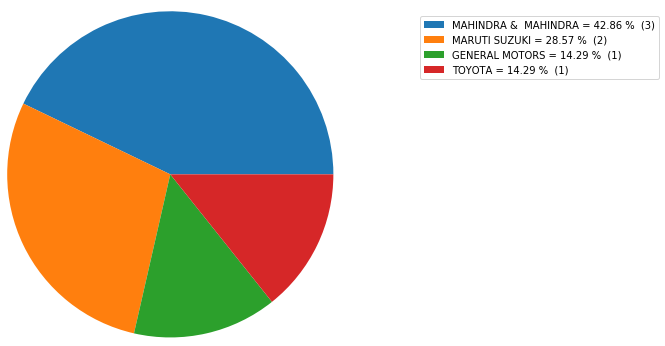

Car (Make) ownership distribution for the State of Sikkim


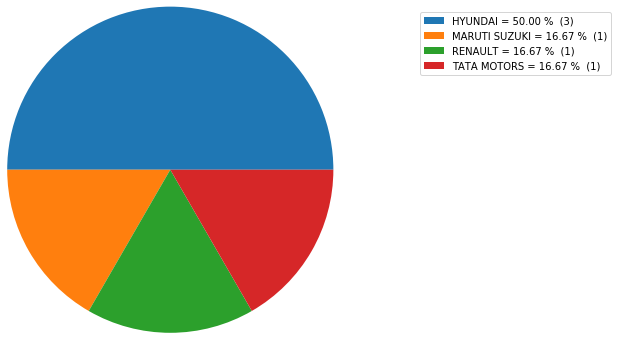

Car (Make) ownership distribution for the State of Mizoram


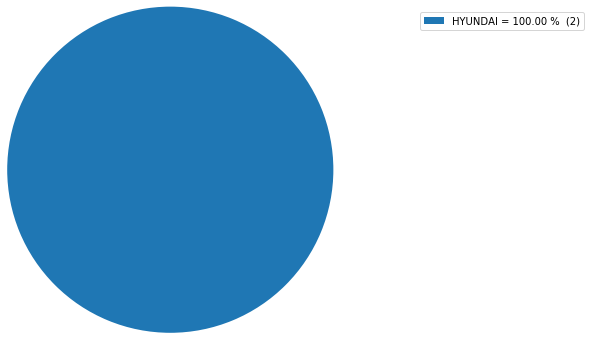

Car (Make) ownership distribution for the State of Tripura


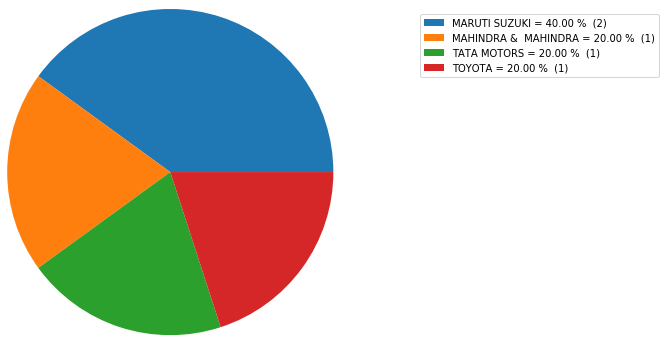

Car (Make) ownership distribution for the State of Manipur


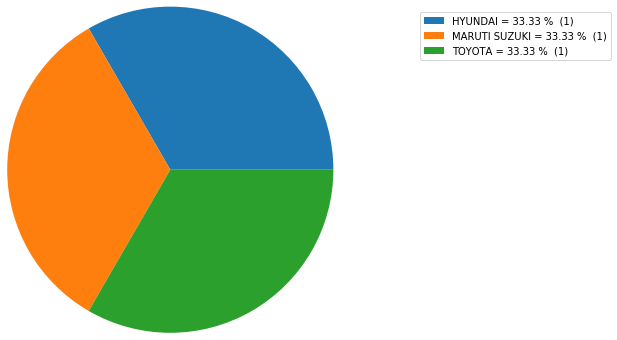

In [37]:
for i in d['District'].unique():
    state = i
    mk_cnt = list(d[d['District']== i]['make_cnt'].values)
    mk_percent = list(mk_cnt/d[d['District']== i]['make_cnt'].values.sum()*100)
    mk_lable = list(d[d['District']== i]['Make'].values)
    print('Car (Make) ownership distribution for the State of '+state)
    pie_chart(mk_percent,mk_lable,mk_cnt)

# From Car (Make) ownership against each state we could gather below insights

1) Either not enough data available for workshops located in NE Indian states/Hilly states (like J&K) or workshops in these states are operating very poorely in terms of attracting customer base or workshops could be poorely placed. In either way there is lot of work required to be done in terms of record management and exploring potential customer base and relocating the workshops at an advantageous location on case by case basis.


2) MFC as an entity could also look for partnership with other Car Makers to act as preferred partner in the areas where it is performing poorely and sees potential business. Thereby strtegically placing itself in local market. (Potential partnership with Maruti Suzuki, Tata Motors, Hyundai)


3) Densly populated, economy drivers and tourism friendly states are showing good number of footfalls. So in these states vehicular presence seems to be more catering variety of customer base according to their income. (This observation could be backed by other sources of data pertainig to RTO vehicle registartion per year in these states.)


4) Most of the variety in terms of car ownership (Make) is seen amongst the state of MH, TN, AP, HR, RJ PB, KA KE.


5) Premier car (Make) ownership is present in selected few states of MH, PB, TN, KA, GJ, MP, AP.

# State wise Revenue generation

In [38]:
e = pd.DataFrame(cust_inv_data.groupby(['District','Make'])['Total Amt Wtd Tax.'].sum()).reset_index()
e.columns = ['District','Make','mk_revenue']
e.sort_values(['mk_revenue','District'], ascending=[0,1], inplace=True)
e.head()

,District,Make,mk_revenue
437,Tamil Nadu,MAHINDRA & MAHINDRA,2.085315e+08
315,Maharashtra,MAHINDRA & MAHINDRA,1.309256e+08
316,Maharashtra,MARUTI SUZUKI,1.256018e+08
438,Tamil Nadu,MARUTI SUZUKI,9.061193e+07
435,Tamil Nadu,HYUNDAI,8.378596e+07


Total Spend per Car (Make) ownership distribution for the State of Tamil Nadu


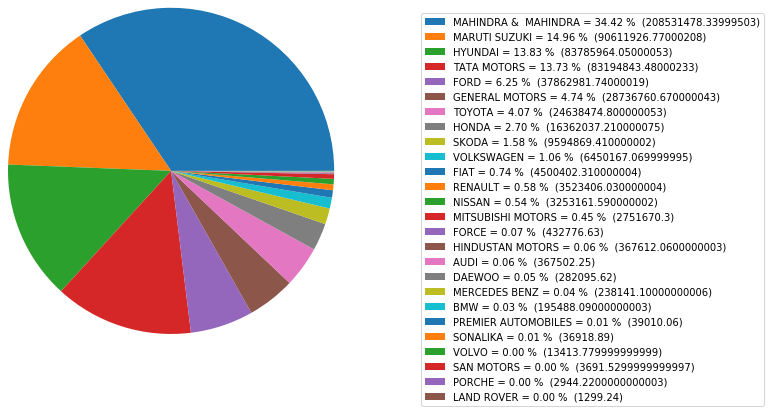

Total Spend per Car (Make) ownership distribution for the State of Maharashtra


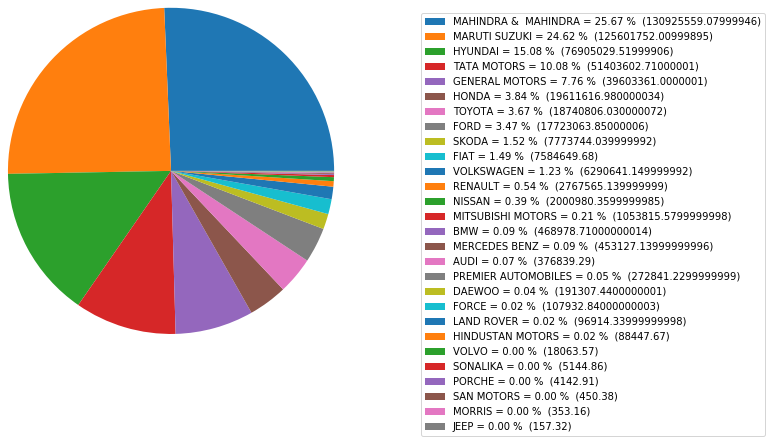

Total Spend per Car (Make) ownership distribution for the State of Andhra Pradesh


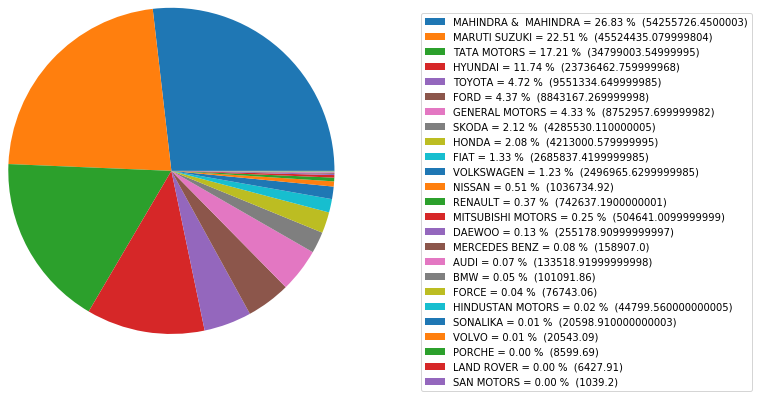

Total Spend per Car (Make) ownership distribution for the State of Karnataka


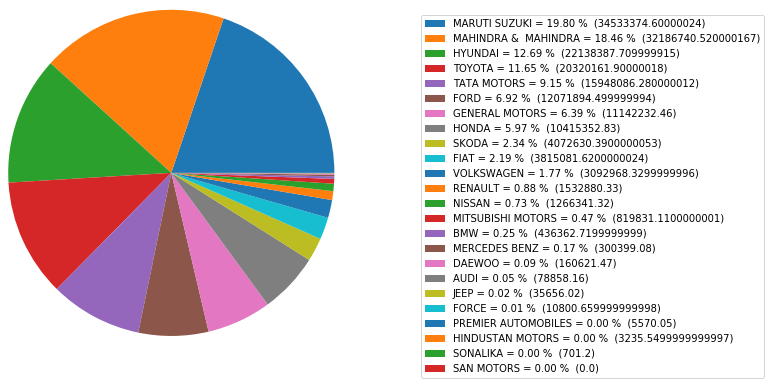

Total Spend per Car (Make) ownership distribution for the State of Uttar Pradesh


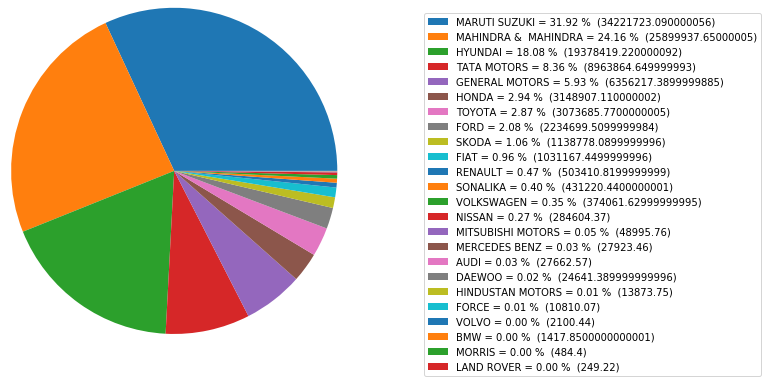

Total Spend per Car (Make) ownership distribution for the State of Gujarat


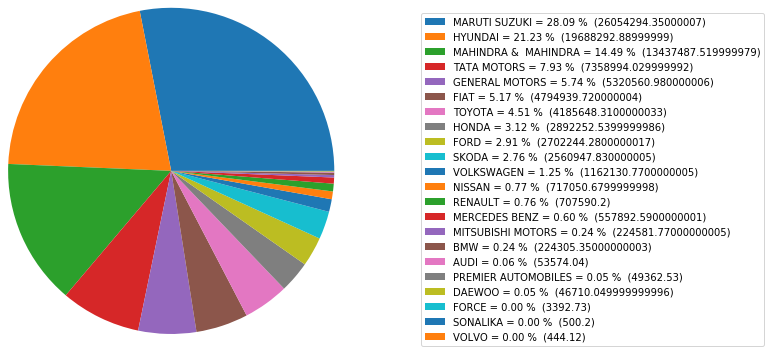

Total Spend per Car (Make) ownership distribution for the State of Haryana


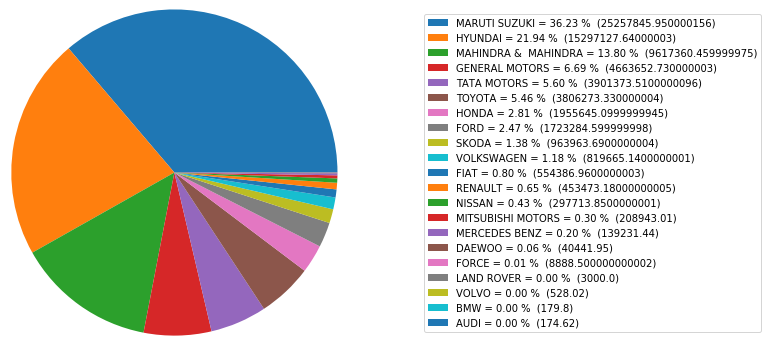

Total Spend per Car (Make) ownership distribution for the State of Punjab


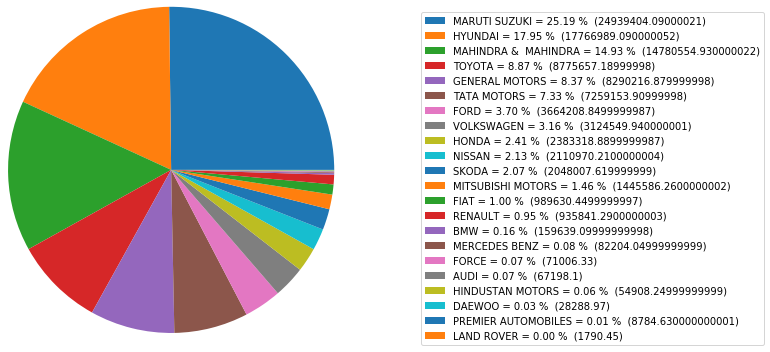

Total Spend per Car (Make) ownership distribution for the State of Rajasthan


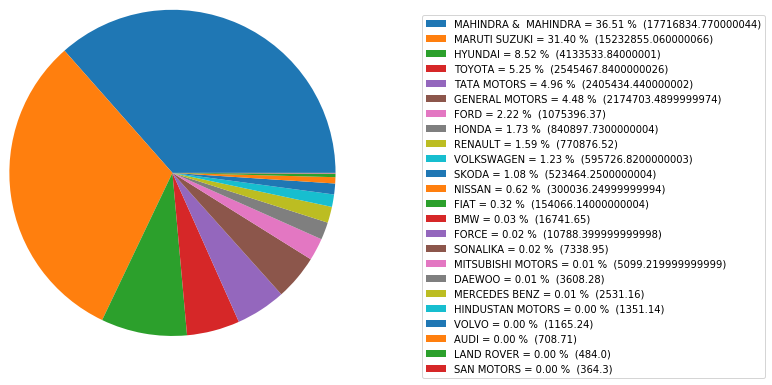

Total Spend per Car (Make) ownership distribution for the State of Madhya Pradesh


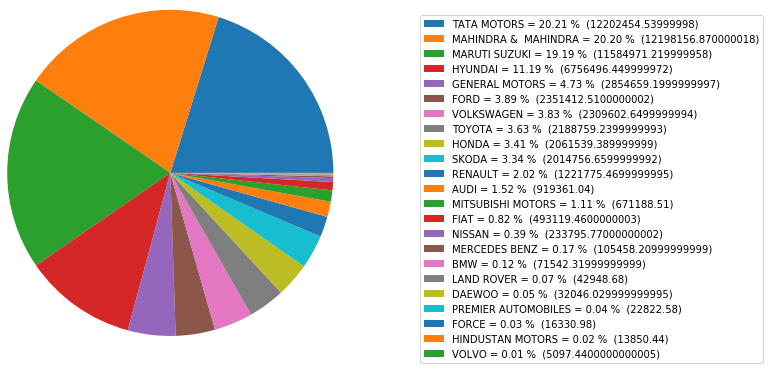

Total Spend per Car (Make) ownership distribution for the State of Telangana


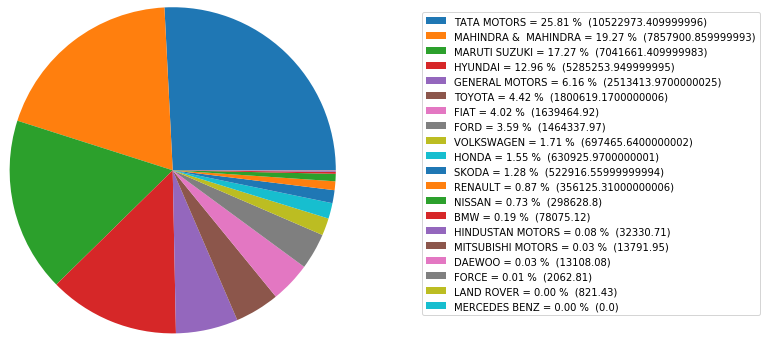

Total Spend per Car (Make) ownership distribution for the State of Kerala


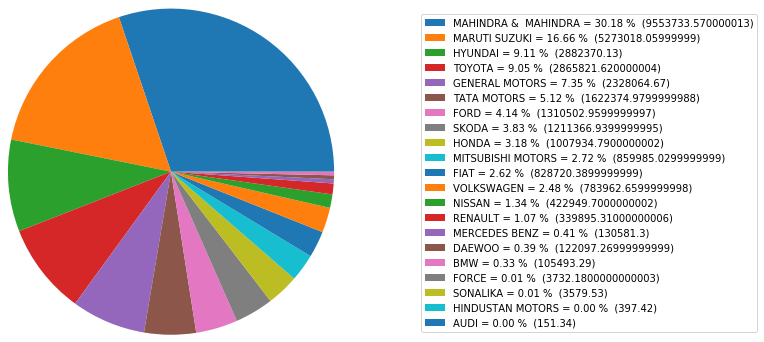

Total Spend per Car (Make) ownership distribution for the State of Bihar


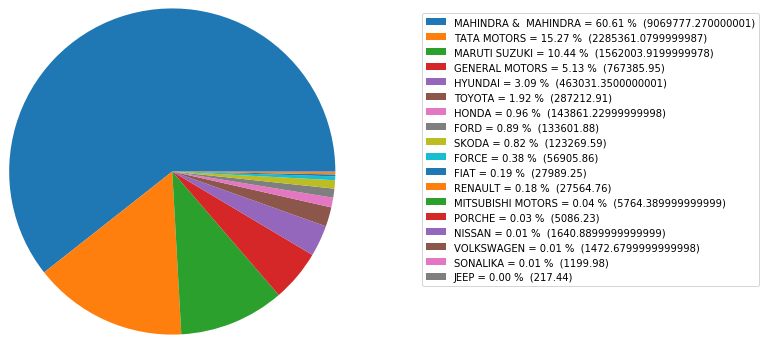

Total Spend per Car (Make) ownership distribution for the State of Delhi


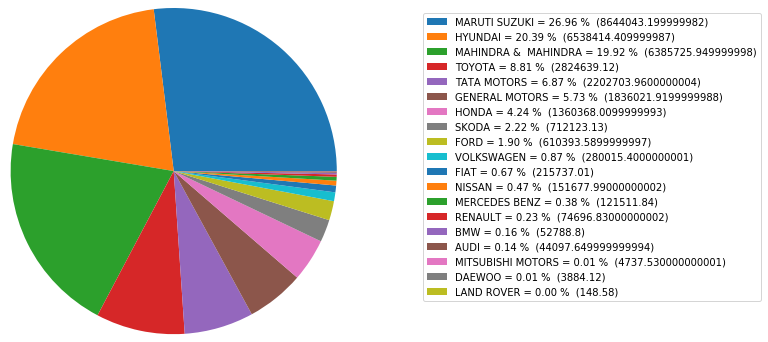

Total Spend per Car (Make) ownership distribution for the State of Chandigarh


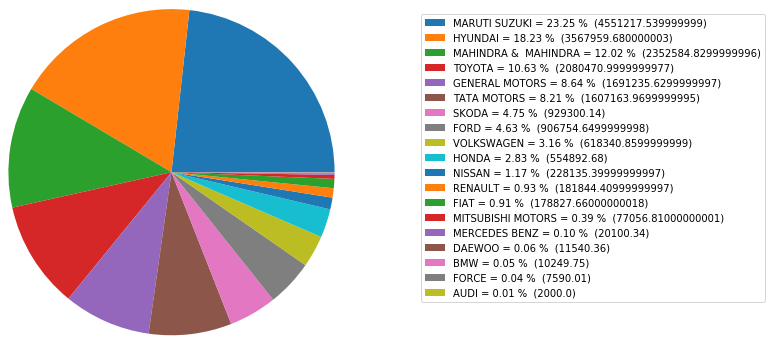

Total Spend per Car (Make) ownership distribution for the State of Puducherry


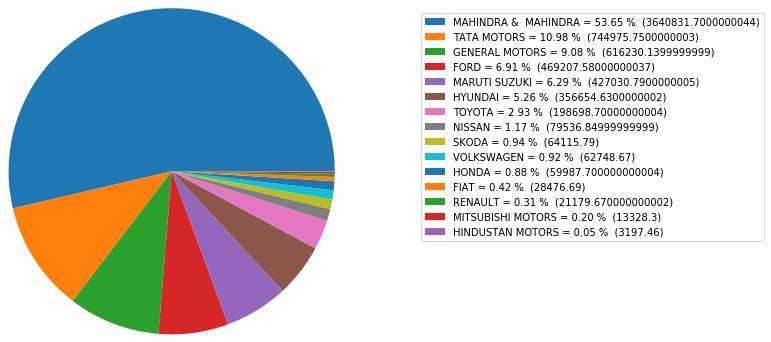

Total Spend per Car (Make) ownership distribution for the State of West Bengal


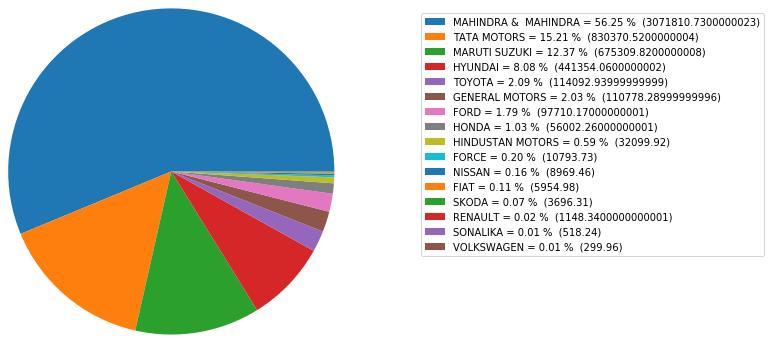

Total Spend per Car (Make) ownership distribution for the State of Uttarakhand


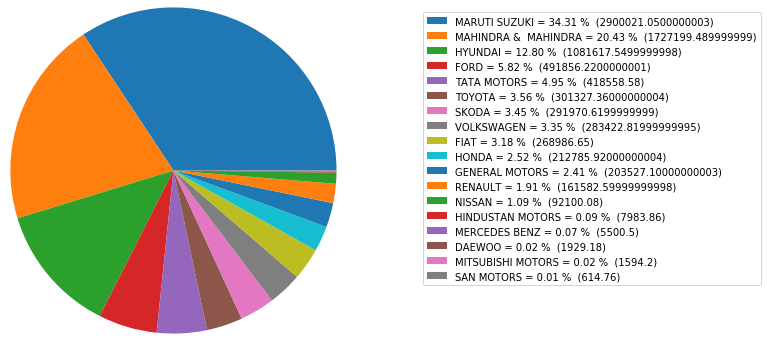

Total Spend per Car (Make) ownership distribution for the State of Himachal Pradesh


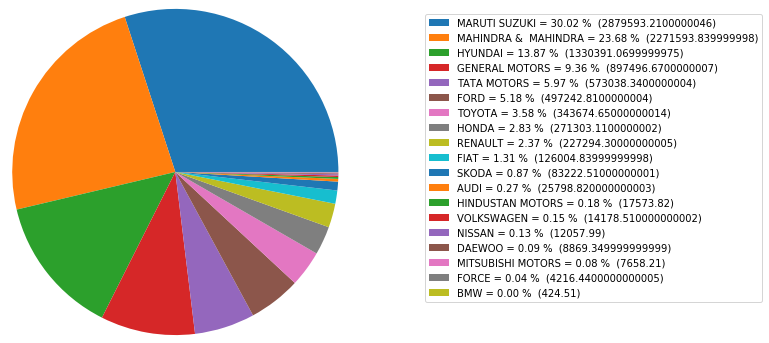

Total Spend per Car (Make) ownership distribution for the State of Odisha


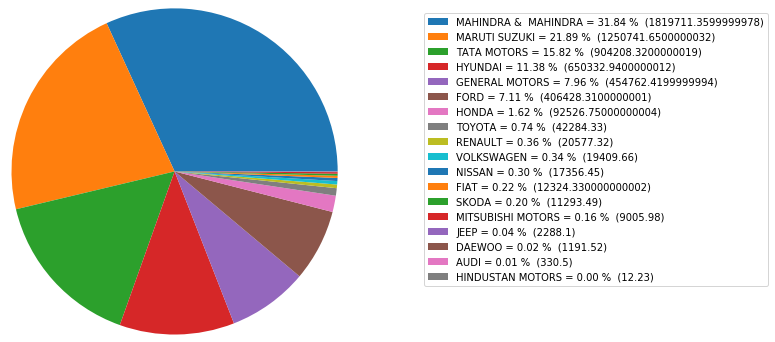

Total Spend per Car (Make) ownership distribution for the State of Dadra and Nagar Hav.


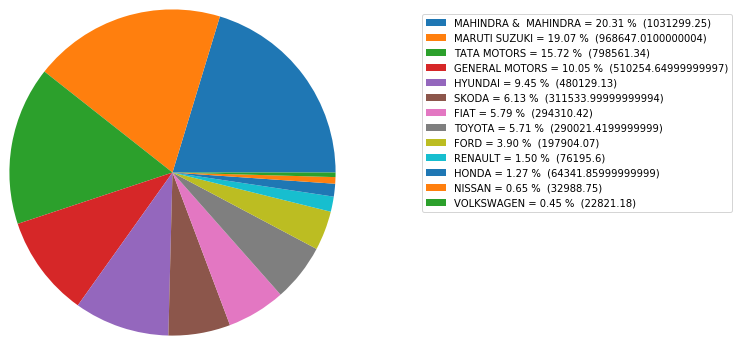

Total Spend per Car (Make) ownership distribution for the State of Chhattisgarh


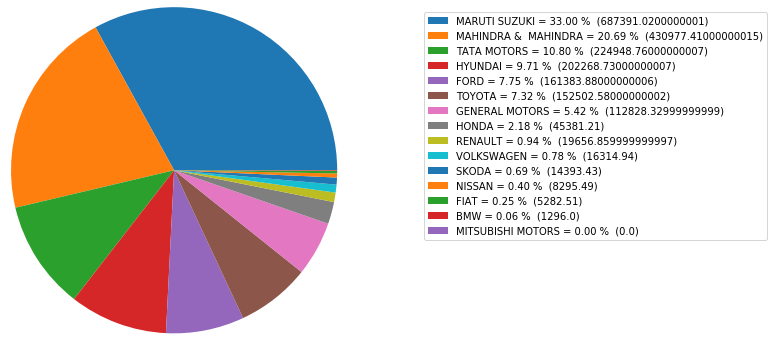

Total Spend per Car (Make) ownership distribution for the State of Daman and Diu


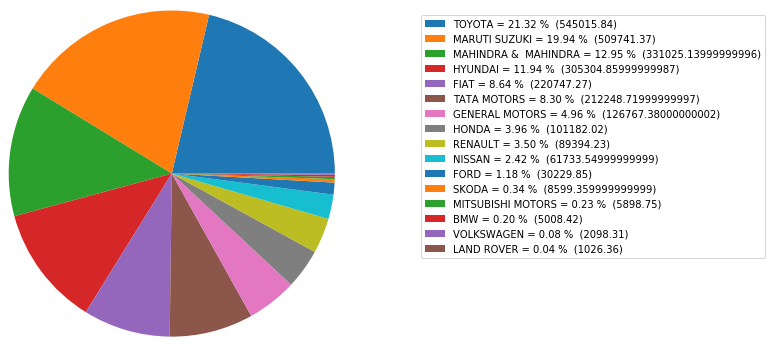

Total Spend per Car (Make) ownership distribution for the State of Jharkhand


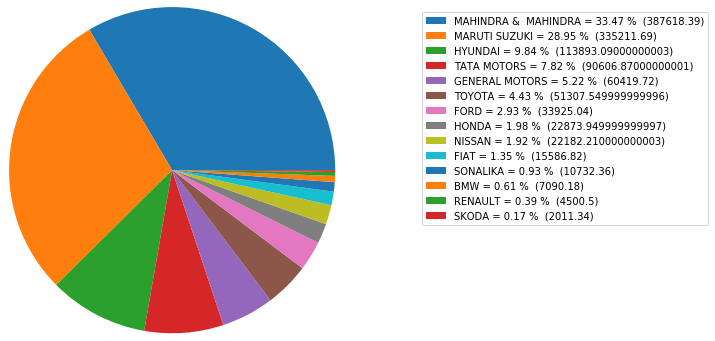

Total Spend per Car (Make) ownership distribution for the State of Assam


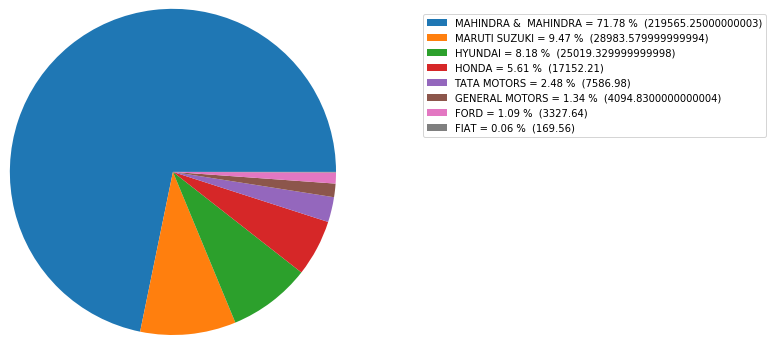

Total Spend per Car (Make) ownership distribution for the State of Nagaland


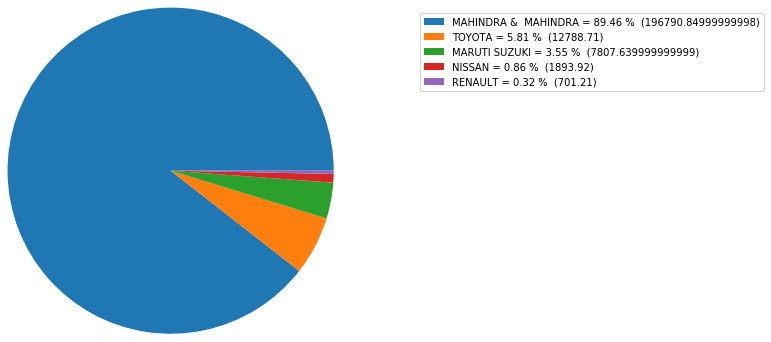

Total Spend per Car (Make) ownership distribution for the State of Arunachal Pradesh


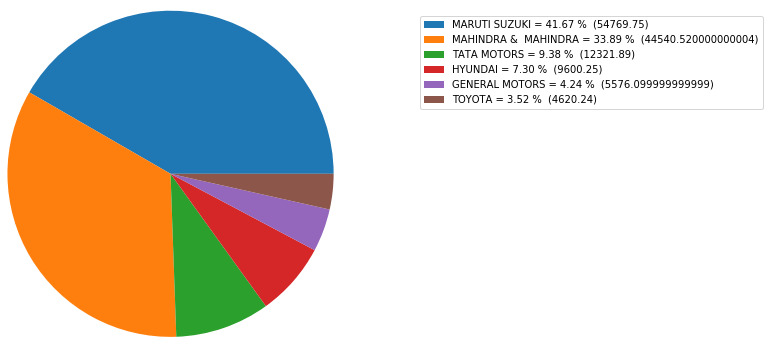

Total Spend per Car (Make) ownership distribution for the State of Goa


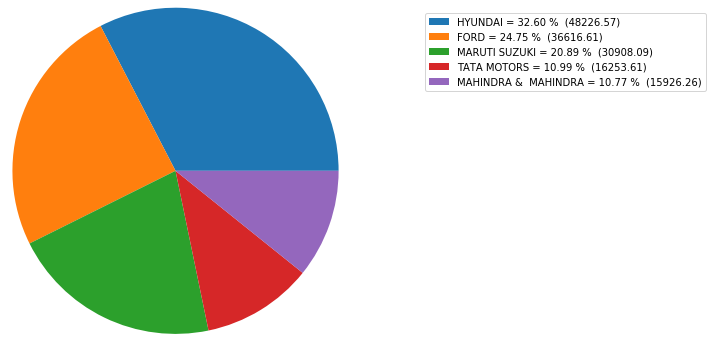

Total Spend per Car (Make) ownership distribution for the State of Andaman and Nico.In.


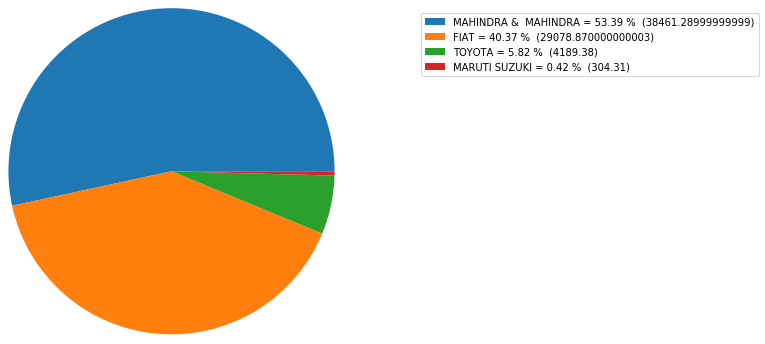

Total Spend per Car (Make) ownership distribution for the State of Jammu and Kashmir


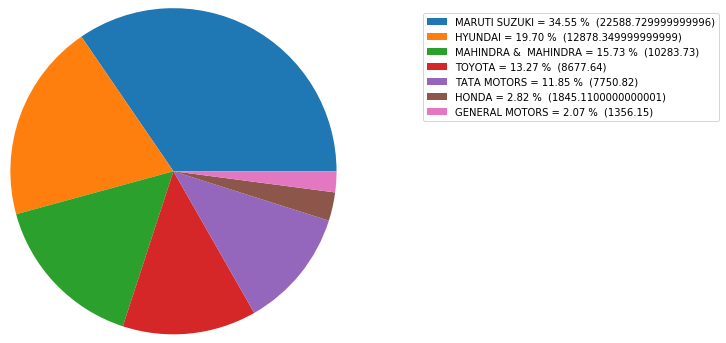

Total Spend per Car (Make) ownership distribution for the State of Manipur


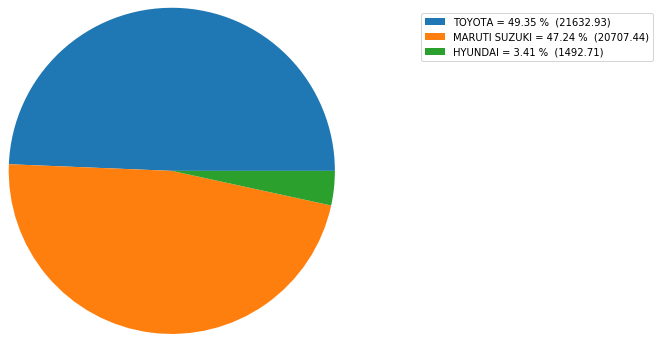

Total Spend per Car (Make) ownership distribution for the State of Megalaya


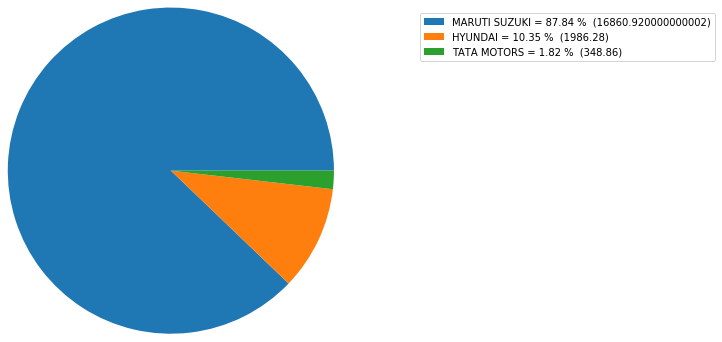

Total Spend per Car (Make) ownership distribution for the State of Mizoram


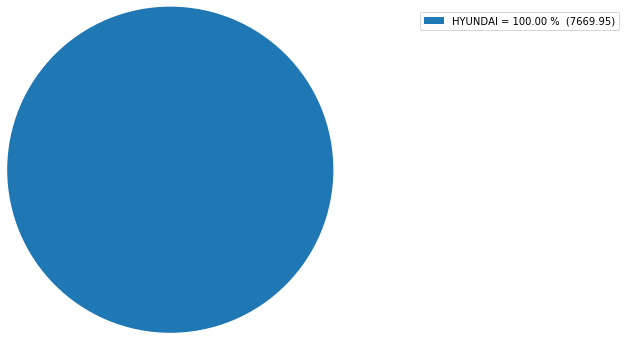

Total Spend per Car (Make) ownership distribution for the State of Lakshadweep


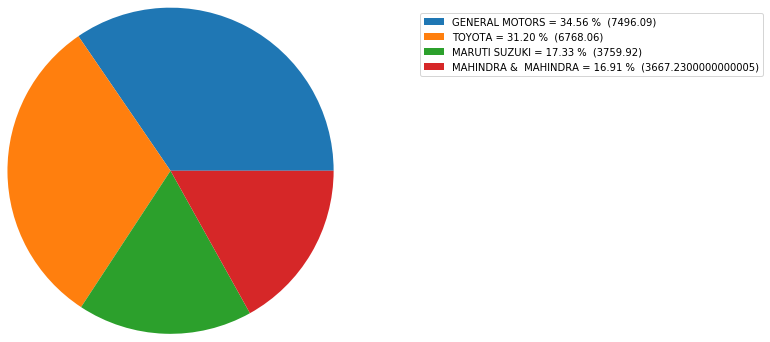

Total Spend per Car (Make) ownership distribution for the State of Sikkim


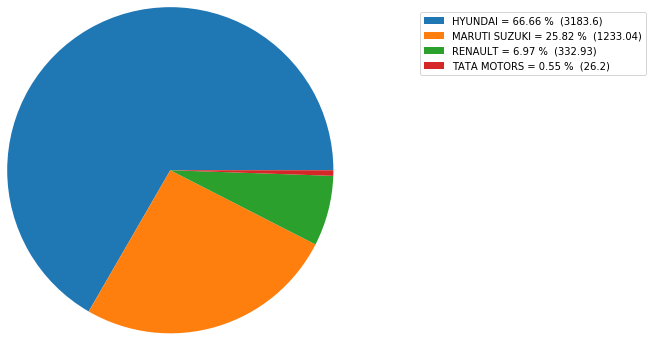

Total Spend per Car (Make) ownership distribution for the State of Tripura


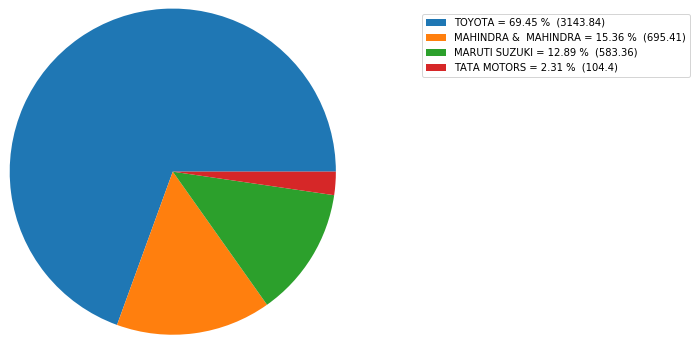

In [39]:
for i in e['District'].unique():
    state = i
    mk_cnt = list(e[e['District']== i]['mk_revenue'].values)
    mk_percent = list(mk_cnt/e[e['District']== i]['mk_revenue'].values.sum()*100)
    mk_lable = list(e[e['District']== i]['Make'].values)
    print('Total Spend per Car (Make) ownership distribution for the State of '+state)
    pie_chart(mk_percent,mk_lable,mk_cnt)

In [40]:
f = pd.DataFrame(cust_inv_data.groupby(['District'])['Total Amt Wtd Tax.'].sum()).reset_index()
f.columns = ['District','mk_revenue']
f.sort_values(['mk_revenue'], ascending=0, inplace=True)

Total Spend distribution for all the states


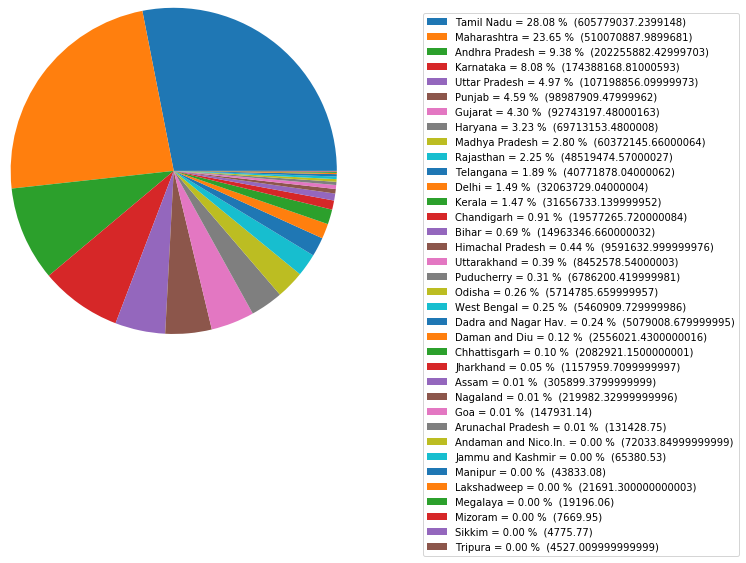

In [41]:
mk_cnt = list(f['mk_revenue'].values)
mk_percent = list(mk_cnt/f['mk_revenue'].values.sum()*100)
mk_lable = list(f['District'].values)
print('Total Spend distribution for all the states')
pie_chart(mk_percent,mk_lable,mk_cnt)

# From revenue genartion against each car (make) in state we could gather below insights


1) MH and TN are most revenue generating states from MFC perspective. This on the other way round could be seen as customers in these areas are more alert about car care and do not hesitate to visit workshop whenever essential.


2) A lot of potential is waiting to be tapped in all other states. Especially expansion towards NE, top North, central India. (This study could be backed by income-spending data for these states.)


3) Workshop expenditure on premier class cars at MFC is comparatively less basis avaialable data.


4) In terms of revenue generation for MFC or spending of a customer basis car (Make) we could see majority of M&M, Maruti Suzuki, TATA Motors and Hyundai in most of the states.

# State and Type of Order to build inventory basis season

In [42]:
g = pd.DataFrame(cust_inv_data.groupby(['District','JobCard Date','Order Type'])['Order Type'].count())
g.columns = ['order_cnt']
g.head()

order_cnt
District             JobCard Date Order Type                
Andaman and Nico.In. 2015-Q3      Running Repairs          1
                     2015-Q4      Accidental               1
                                  Running Repairs          2
                     2016-Q3      Accidental               1
                                  Paid Service             1

In [43]:
h = g.copy().reset_index()
h.sort_values(['order_cnt','District','JobCard Date'], ascending=[0,1,1], inplace=True)
h.head()

,District,JobCard Date,Order Type,order_cnt
1424,Tamil Nadu,2016-Q3,Running Repairs,11816
1411,Tamil Nadu,2016-Q1,Running Repairs,8320
1397,Tamil Nadu,2015-Q3,Running Repairs,7255
1404,Tamil Nadu,2015-Q4,Running Repairs,6556
841,Karnataka,2016-Q3,Running Repairs,6418


Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2016-Q3


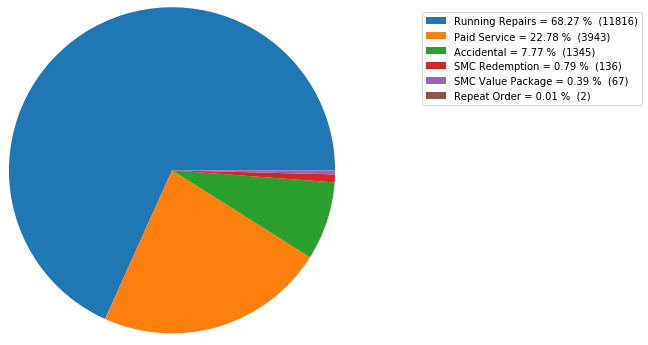

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2016-Q1


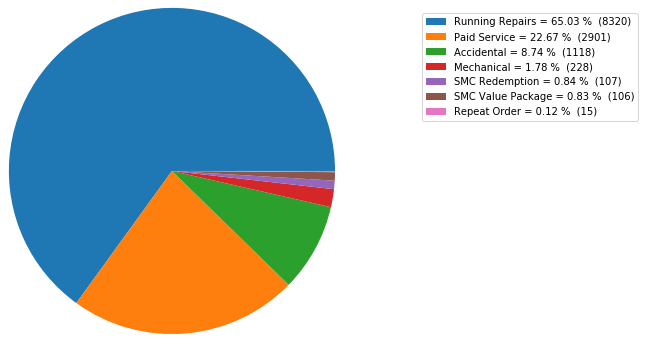

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2015-Q3


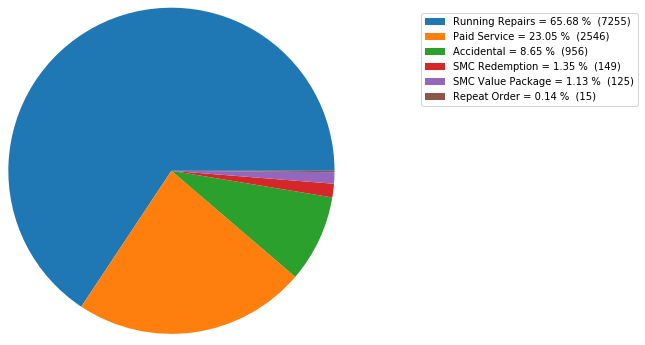

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2015-Q4


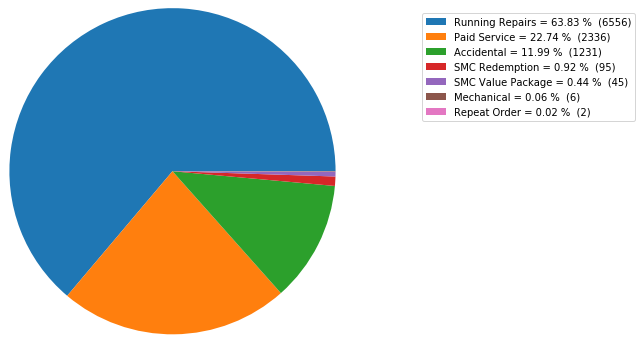

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2016-Q2


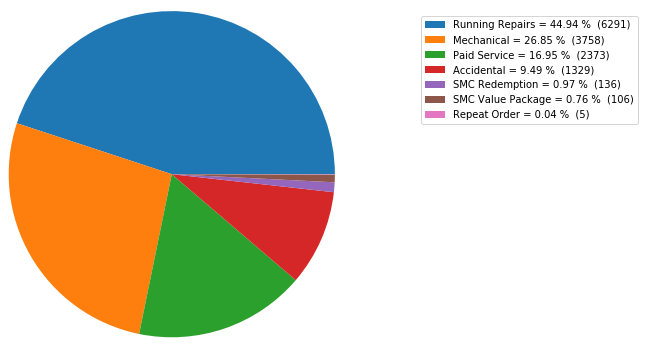

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2015-Q2


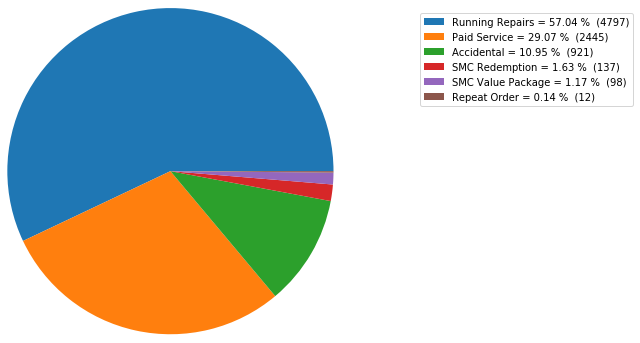

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2015-Q1


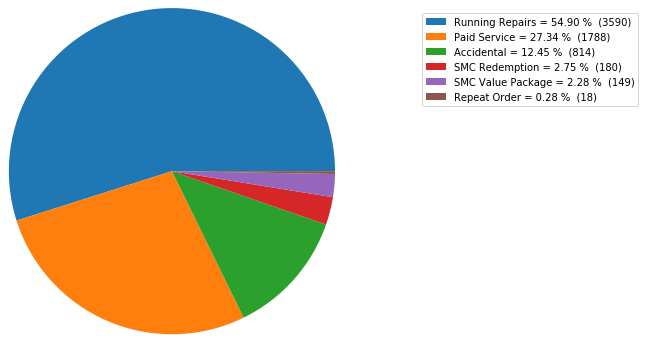

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2016-Q4


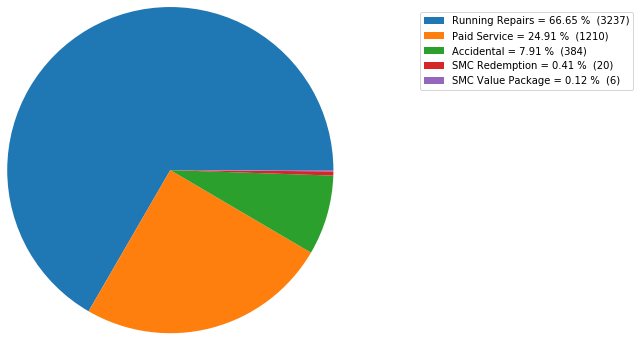

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2014-Q4


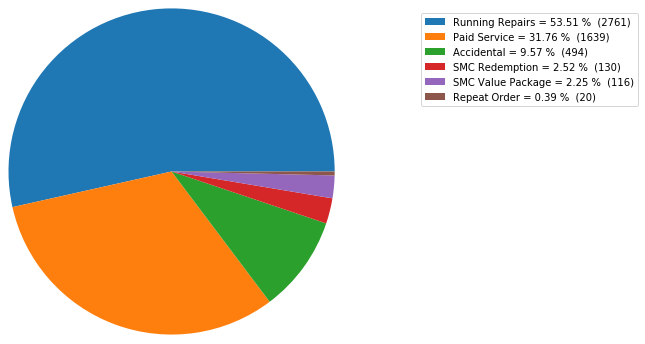

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2014-Q1


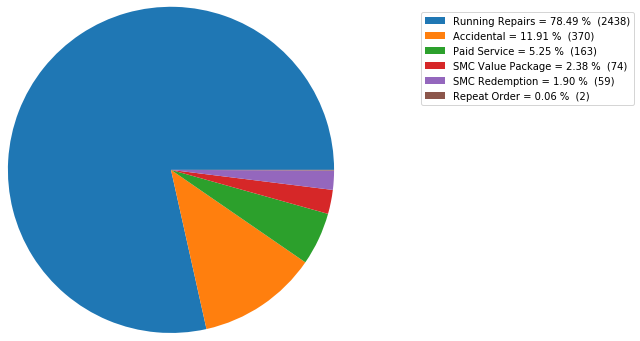

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2014-Q2


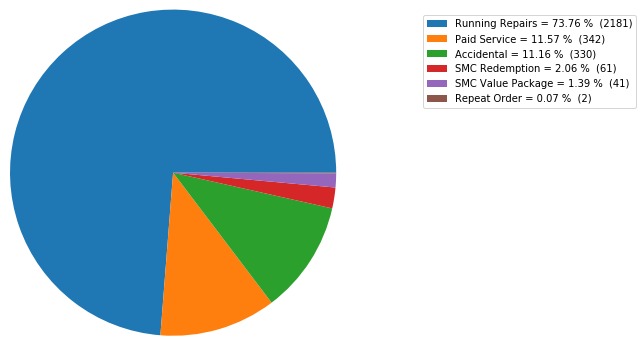

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2014-Q3


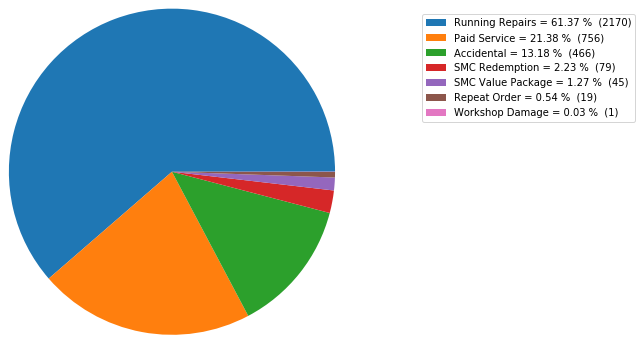

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2013-Q4


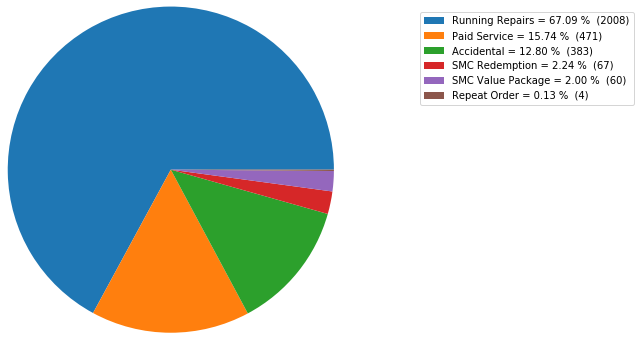

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2013-Q3


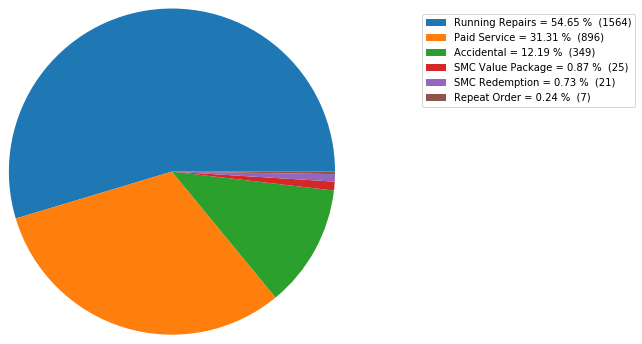

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2012-Q2


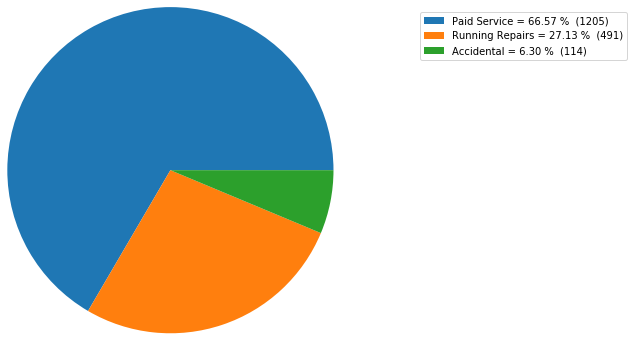

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2013-Q2


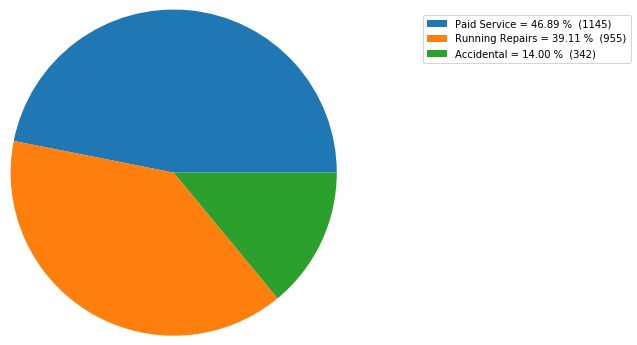

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2012-Q4


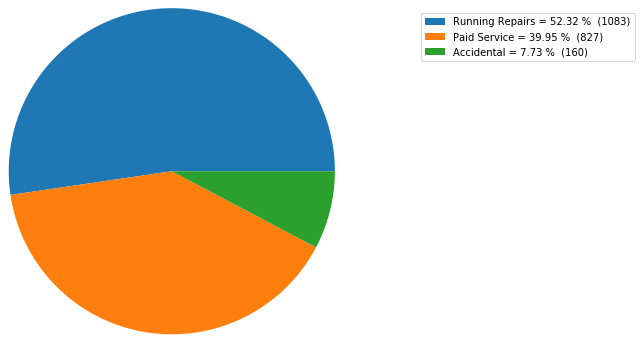

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2013-Q1


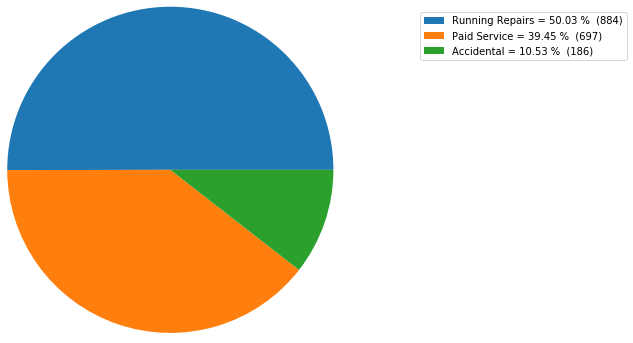

Countwise Distribution of Order Type for the State of Tamil Nadu and for the season 2012-Q3


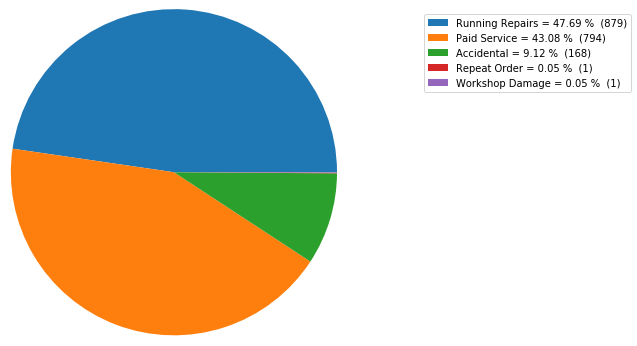

Countwise Distribution of Order Type for the State of Karnataka and for the season 2016-Q3


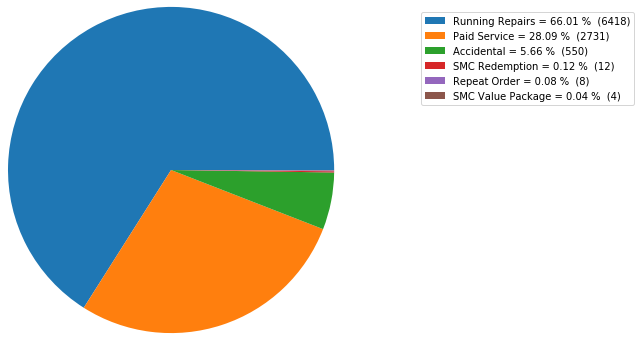

Countwise Distribution of Order Type for the State of Karnataka and for the season 2016-Q1


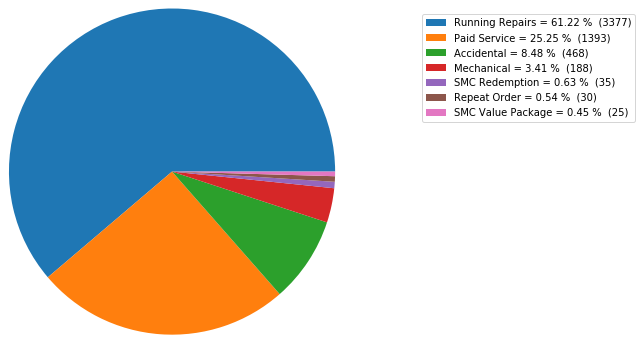

Countwise Distribution of Order Type for the State of Karnataka and for the season 2016-Q2


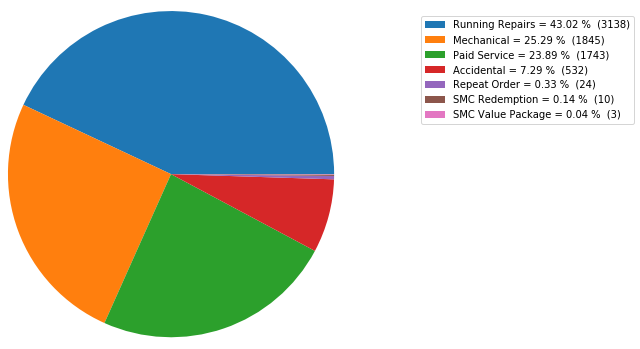

Countwise Distribution of Order Type for the State of Karnataka and for the season 2015-Q4


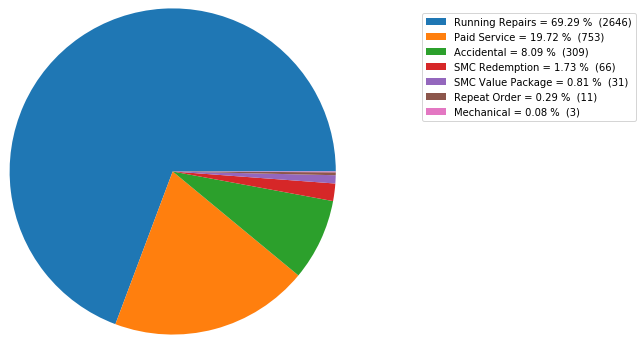

Countwise Distribution of Order Type for the State of Karnataka and for the season 2016-Q4


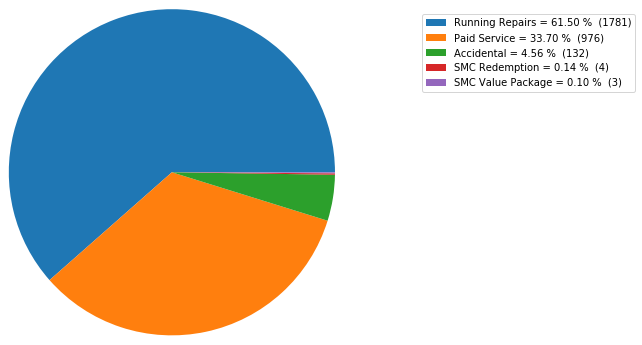

Countwise Distribution of Order Type for the State of Karnataka and for the season 2015-Q3


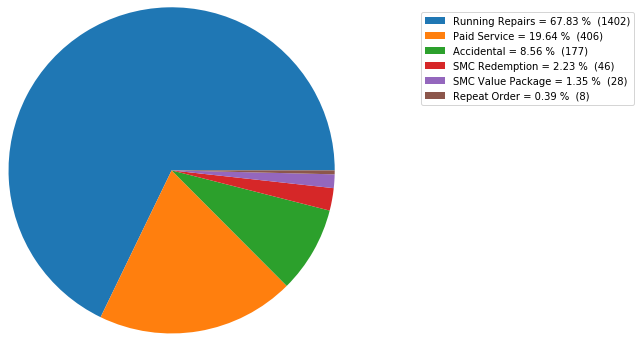

Countwise Distribution of Order Type for the State of Karnataka and for the season 2015-Q2


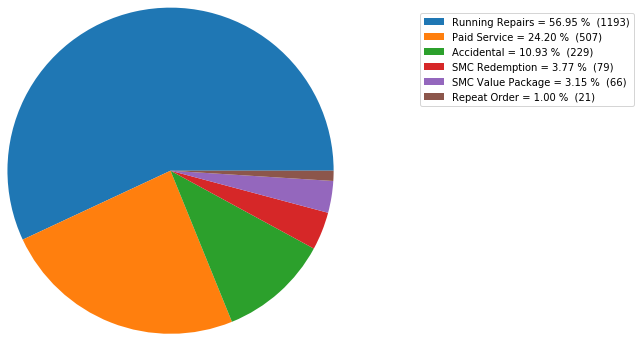

Countwise Distribution of Order Type for the State of Karnataka and for the season 2014-Q4


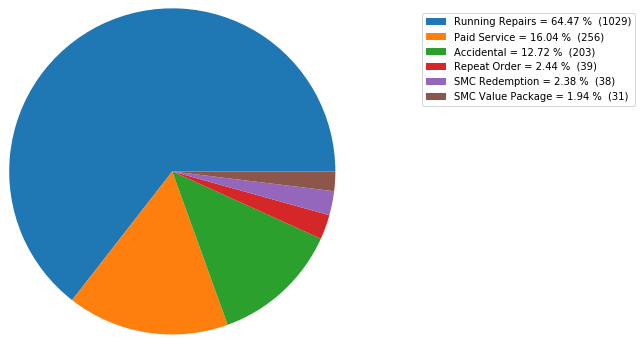

Countwise Distribution of Order Type for the State of Karnataka and for the season 2014-Q1


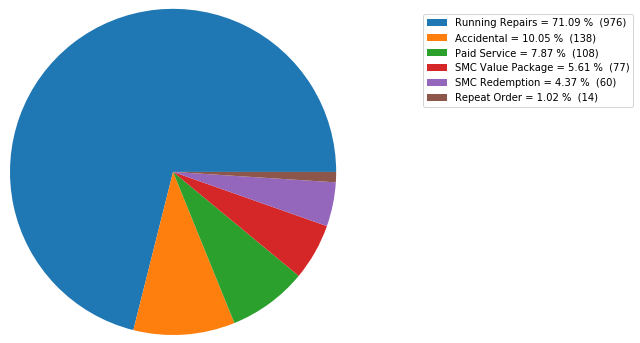

Countwise Distribution of Order Type for the State of Karnataka and for the season 2015-Q1


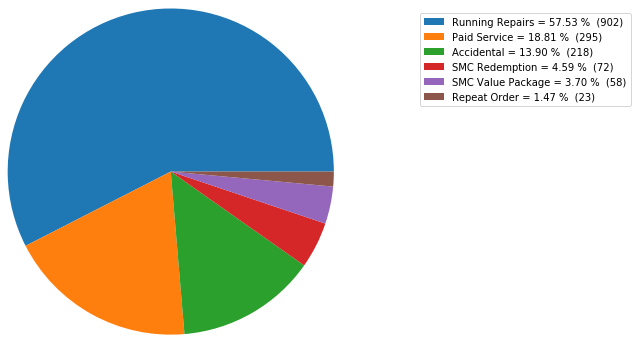

Countwise Distribution of Order Type for the State of Karnataka and for the season 2014-Q2


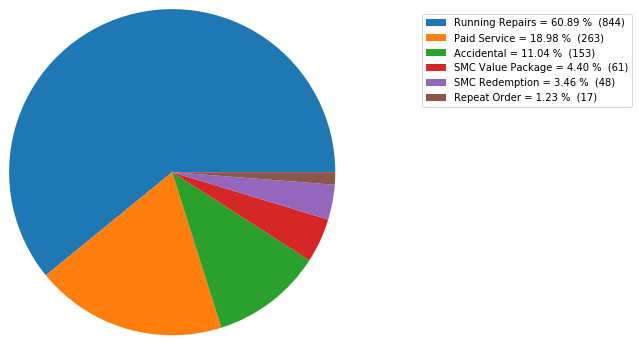

Countwise Distribution of Order Type for the State of Karnataka and for the season 2013-Q4


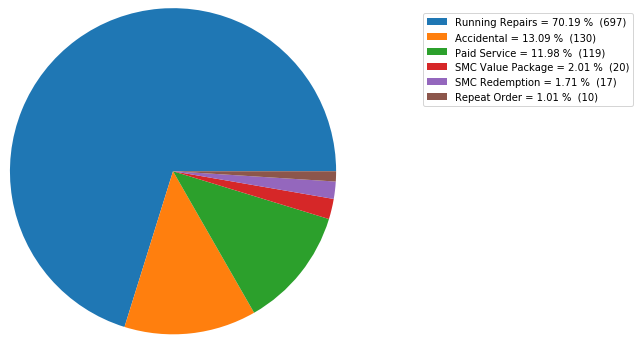

Countwise Distribution of Order Type for the State of Karnataka and for the season 2014-Q3


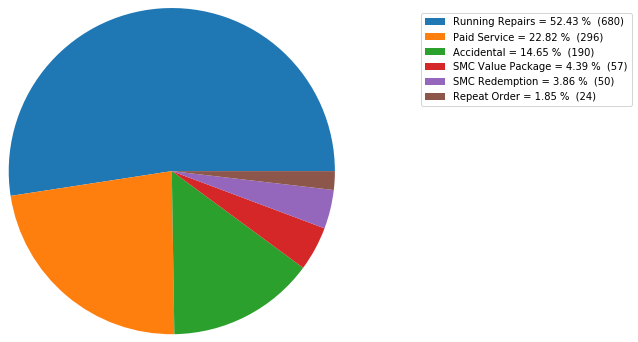

Countwise Distribution of Order Type for the State of Karnataka and for the season 2013-Q3


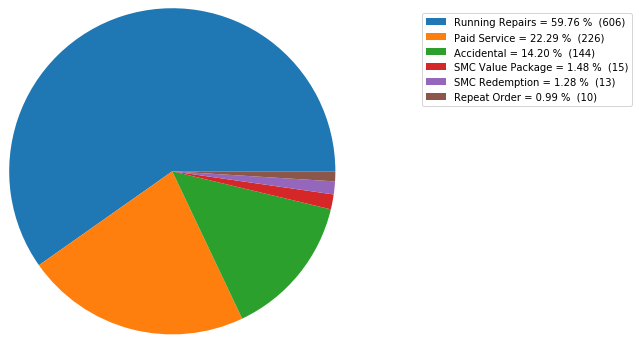

Countwise Distribution of Order Type for the State of Karnataka and for the season 2013-Q2


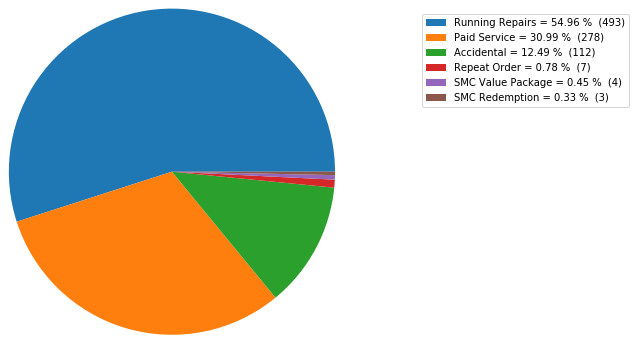

Countwise Distribution of Order Type for the State of Karnataka and for the season 2013-Q1


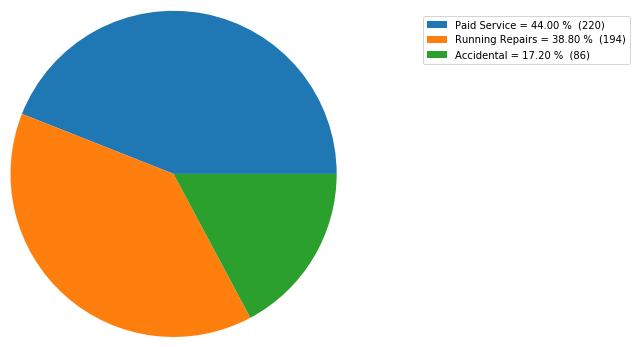

Countwise Distribution of Order Type for the State of Karnataka and for the season 2012-Q3


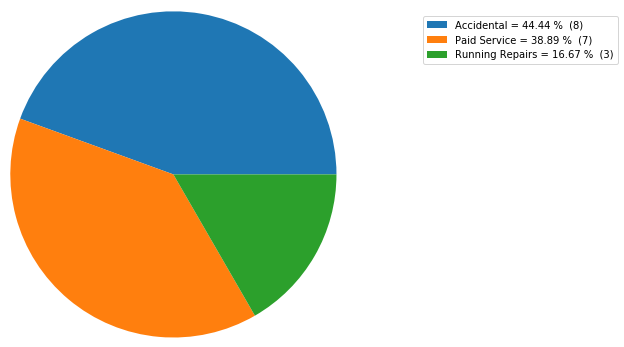

Countwise Distribution of Order Type for the State of Karnataka and for the season 2012-Q2


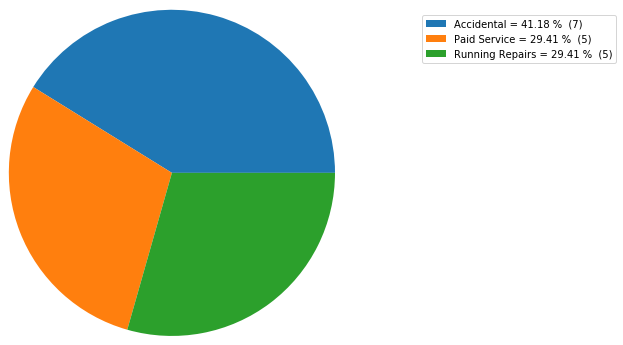

Countwise Distribution of Order Type for the State of Karnataka and for the season 2012-Q4


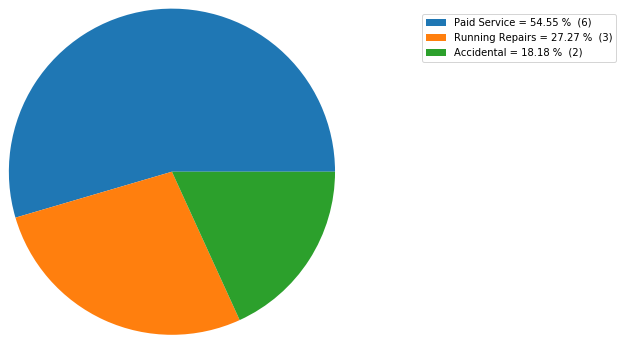

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2016-Q3


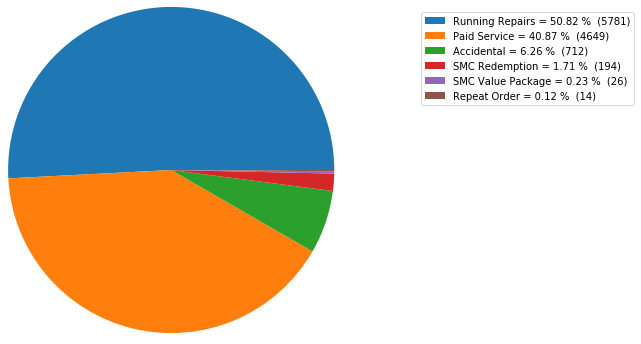

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2016-Q1


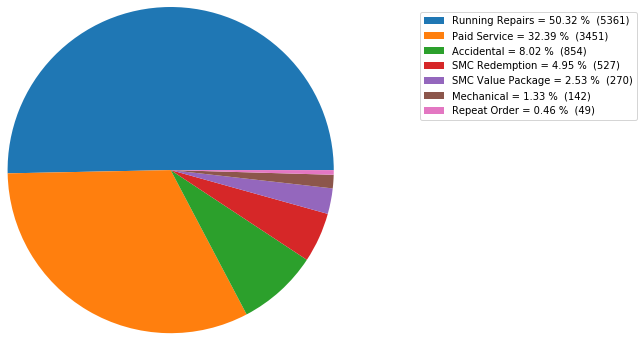

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2013-Q4


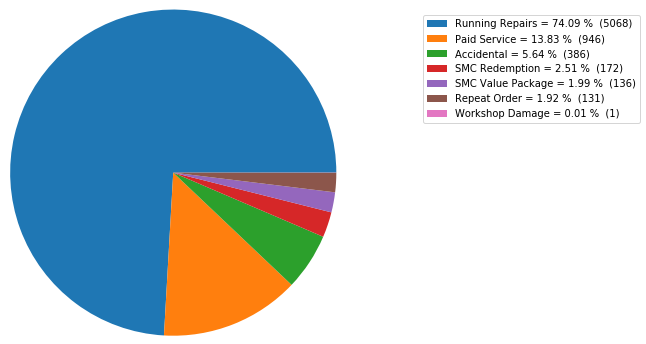

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2014-Q1


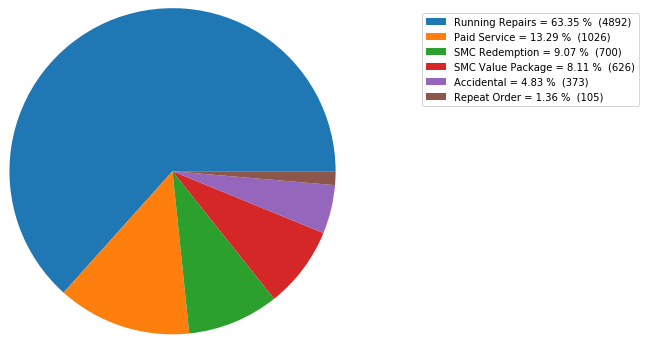

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2015-Q4


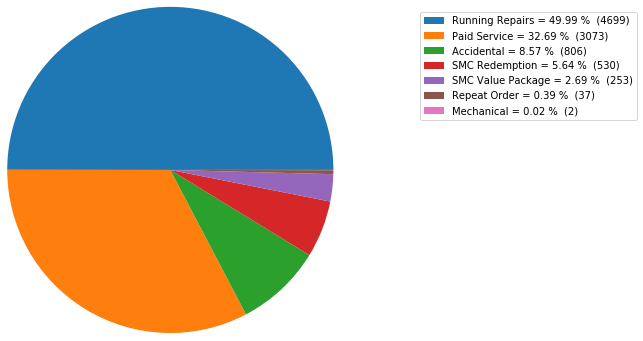

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2014-Q2


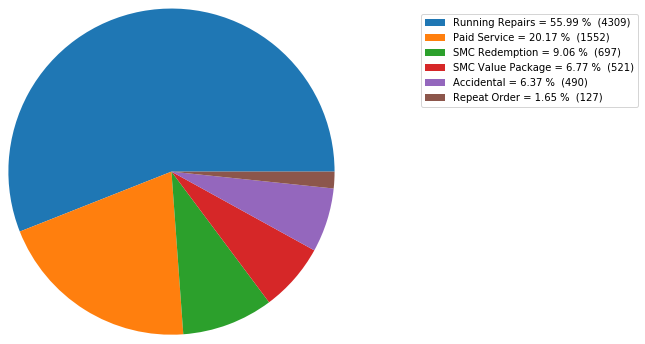

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2015-Q3


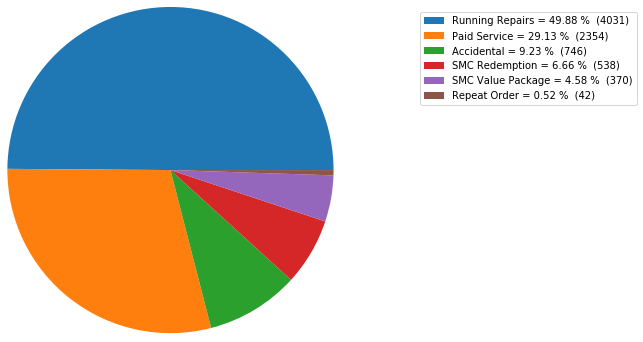

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2016-Q2


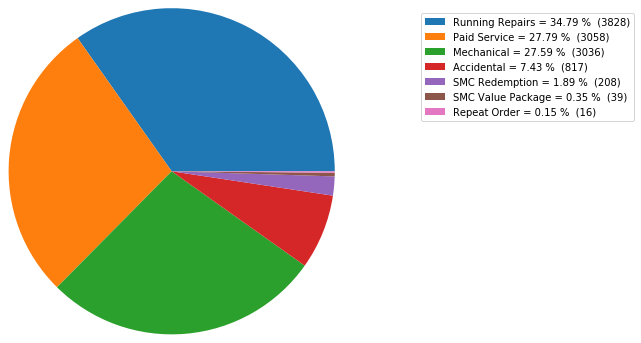

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2015-Q2


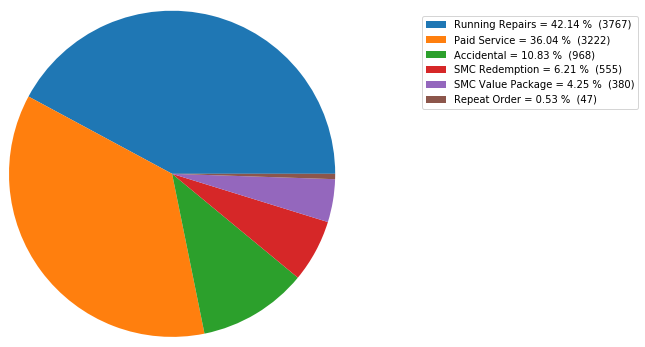

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2014-Q3


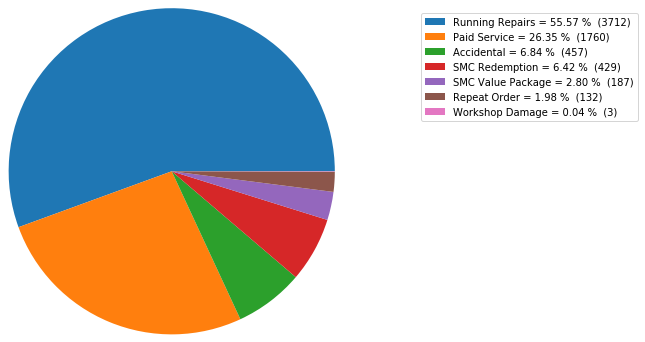

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2015-Q1


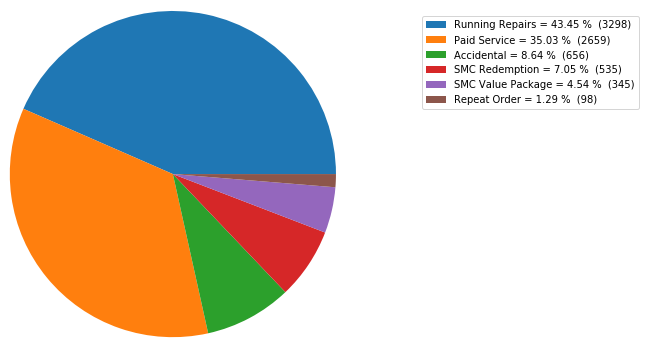

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2014-Q4


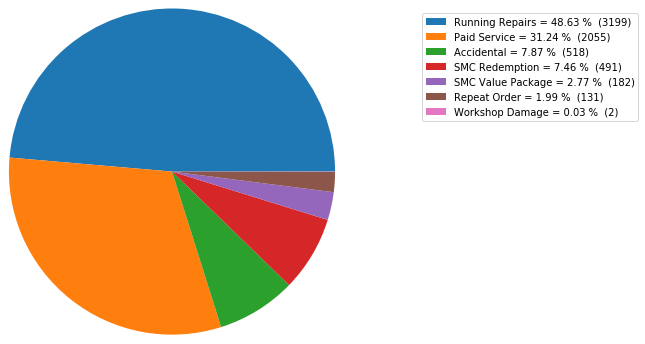

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2013-Q3


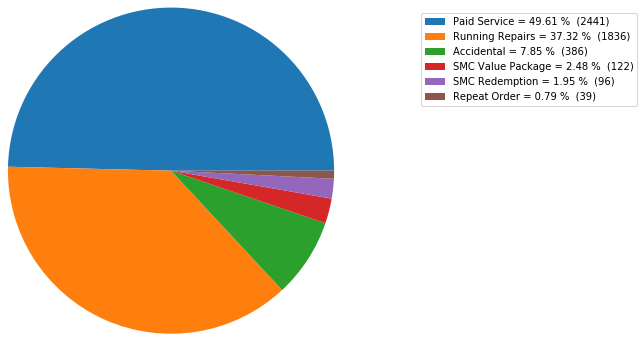

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2013-Q2


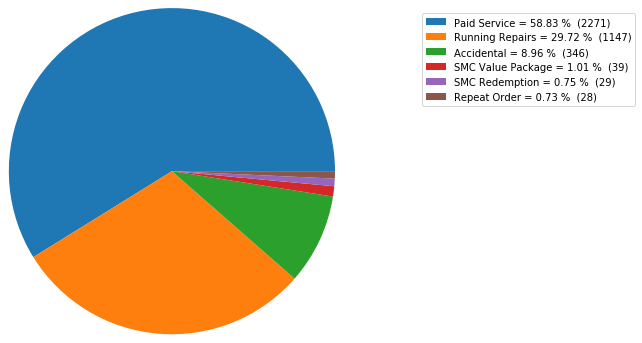

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2012-Q4


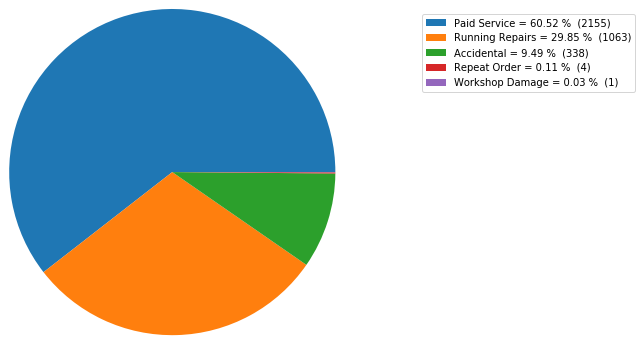

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2013-Q1


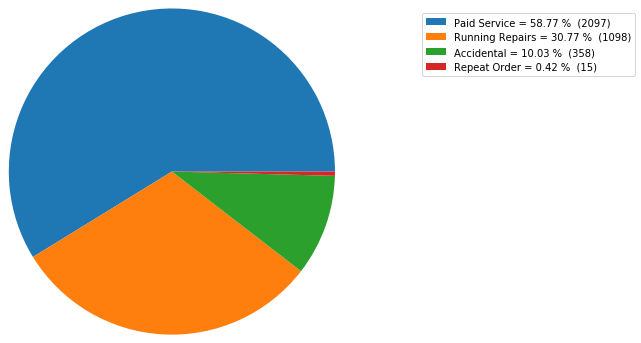

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2016-Q4


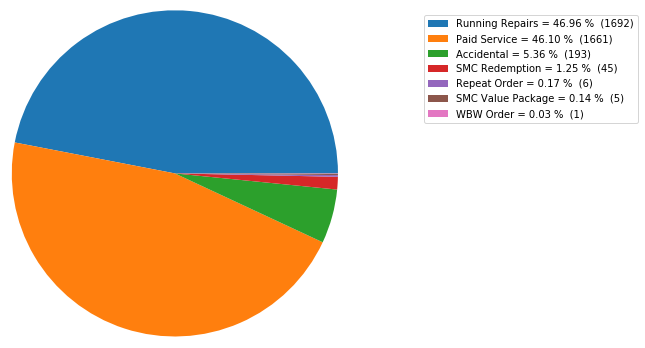

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2012-Q3


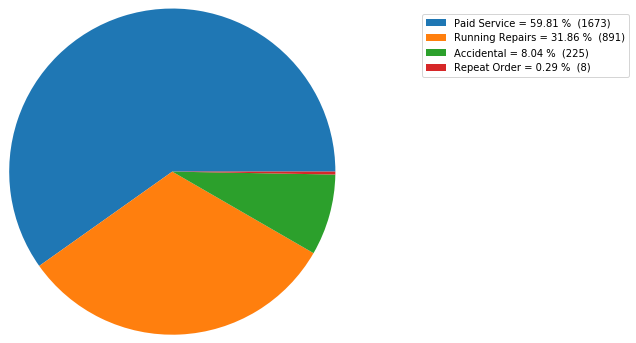

Countwise Distribution of Order Type for the State of Maharashtra and for the season 2012-Q2


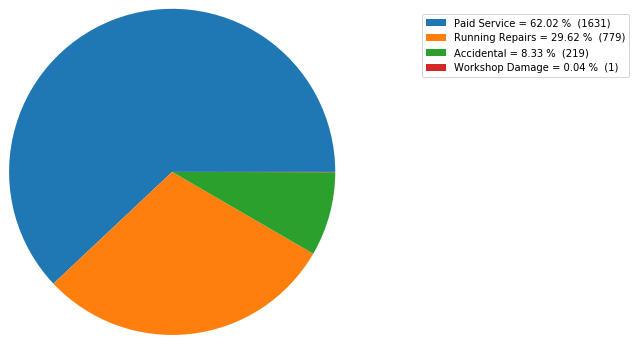

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2016-Q3


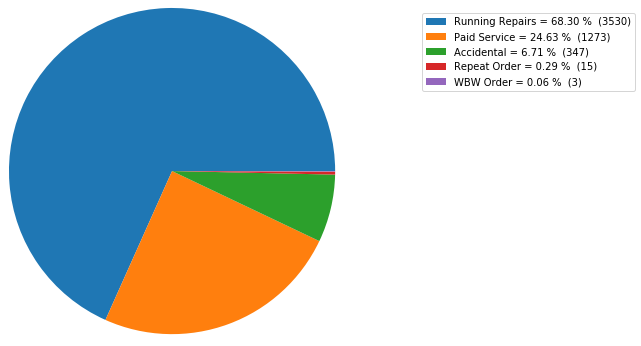

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2016-Q2


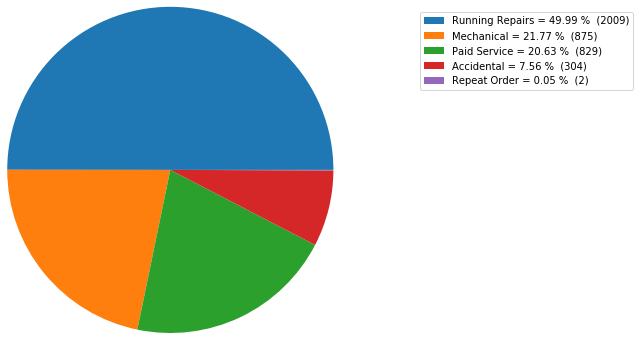

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2016-Q4


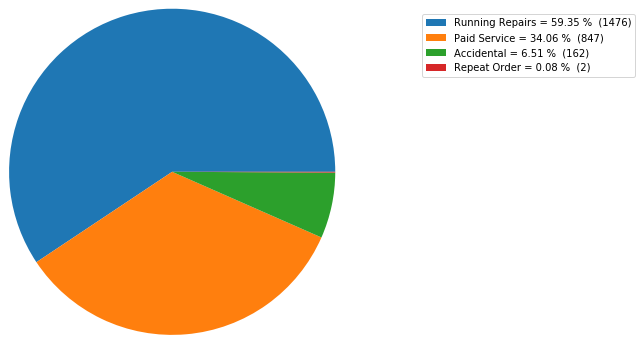

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2016-Q1


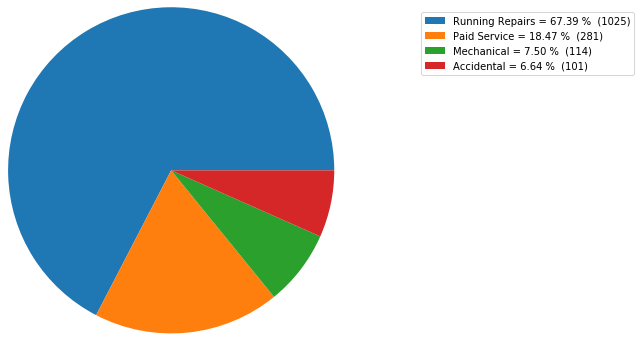

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2015-Q4


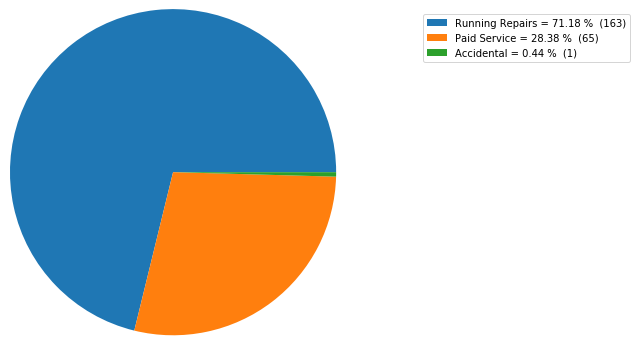

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2015-Q3


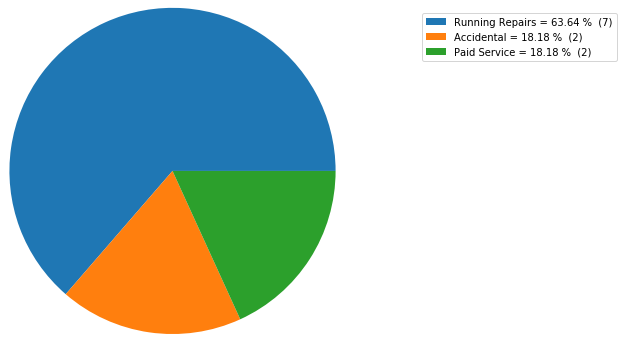

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2015-Q1


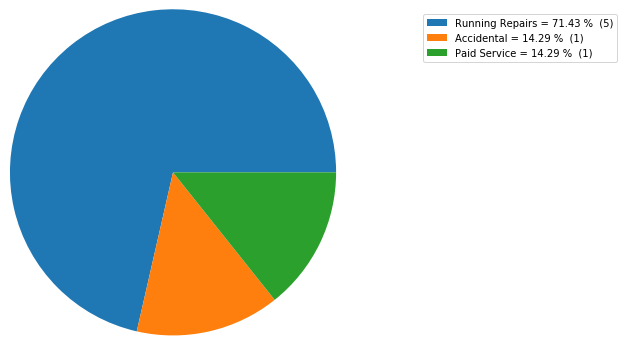

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2015-Q2


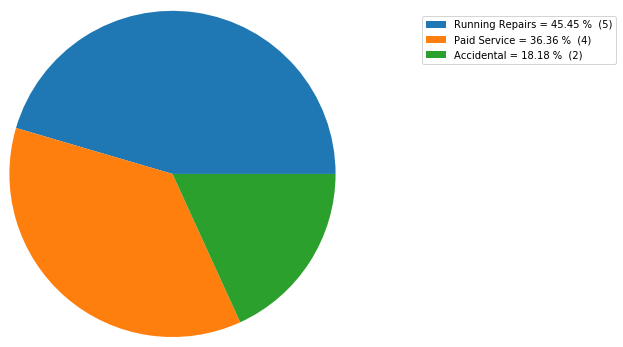

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2013-Q3


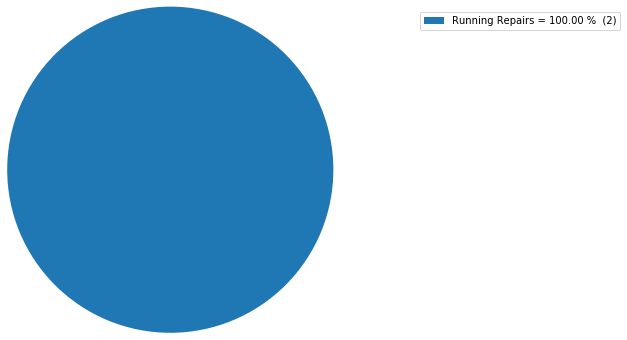

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2013-Q4


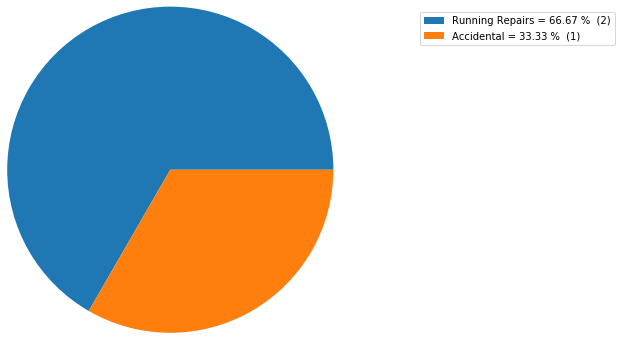

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2014-Q1


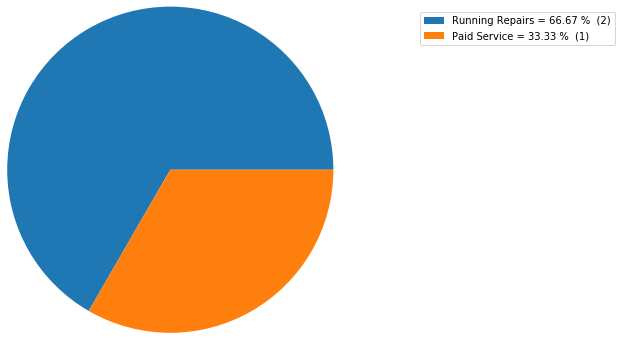

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2014-Q2


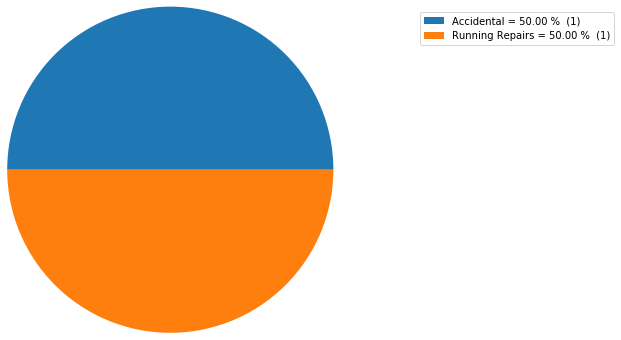

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2014-Q3


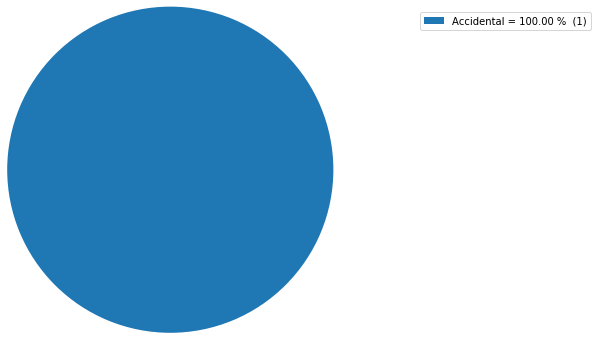

Countwise Distribution of Order Type for the State of Rajasthan and for the season 2014-Q4


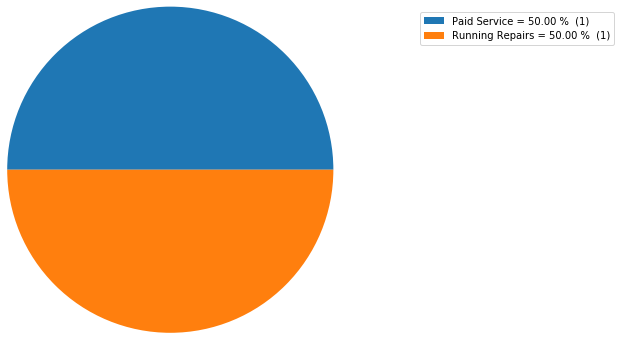

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2014-Q1


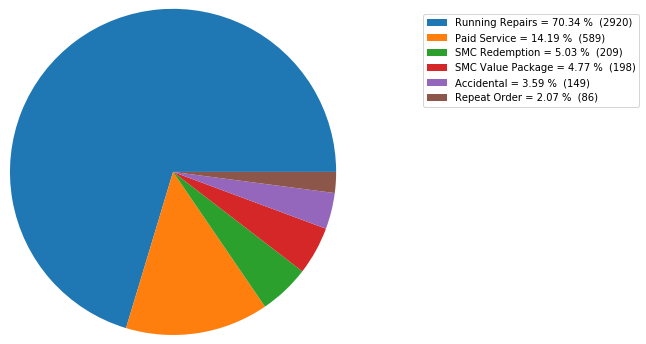

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2016-Q3


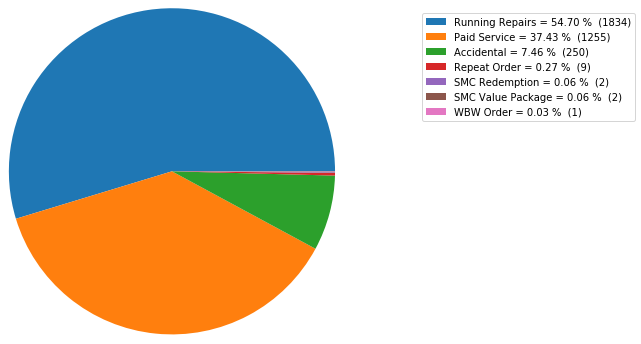

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2013-Q4


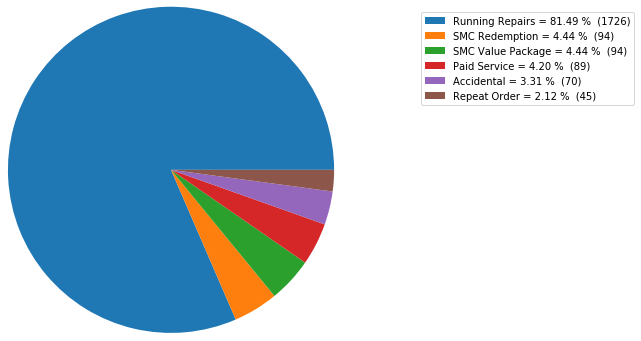

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2014-Q2


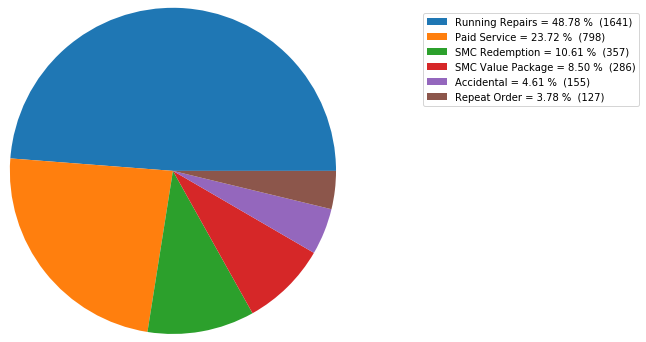

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2015-Q2


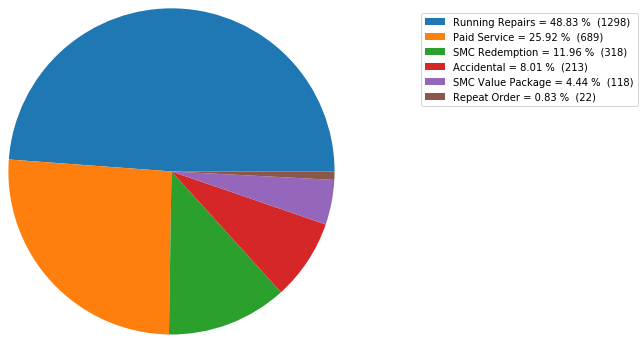

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2014-Q3


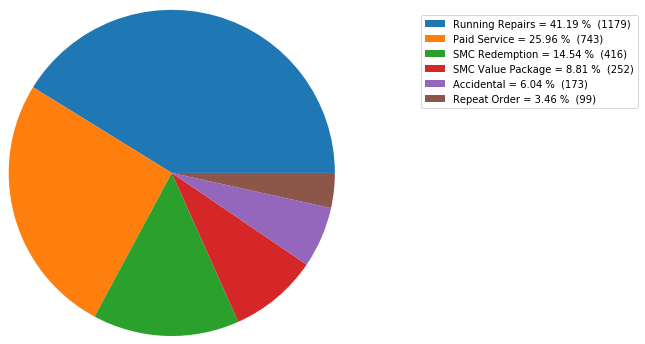

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2015-Q1


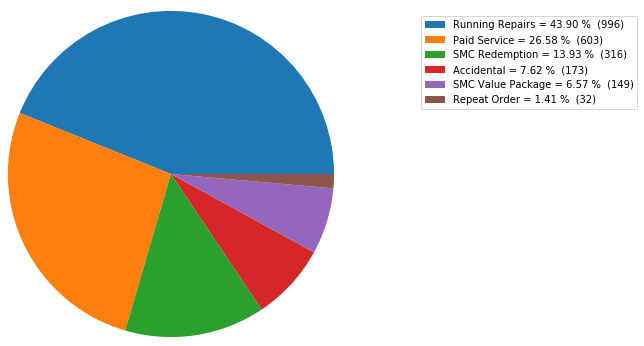

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2014-Q4


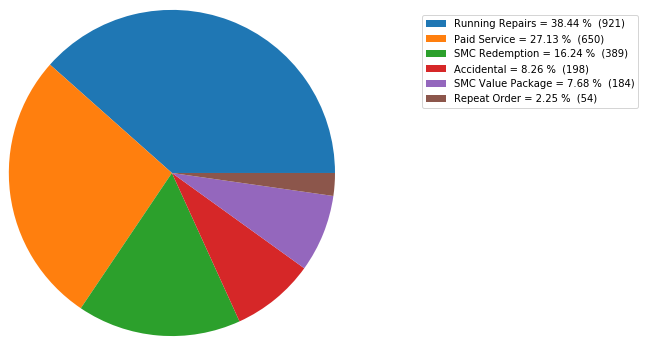

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2016-Q1


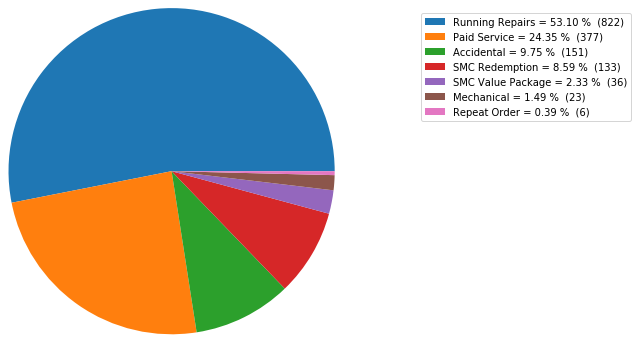

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2015-Q4


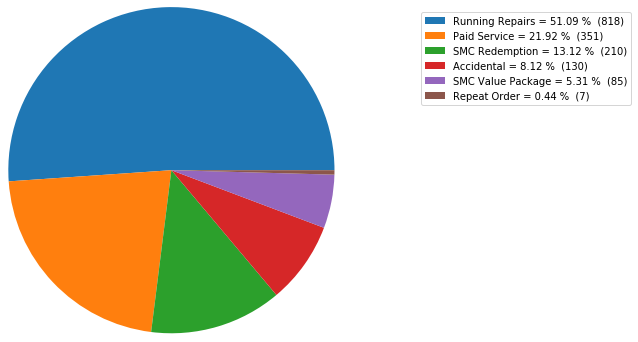

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2015-Q3


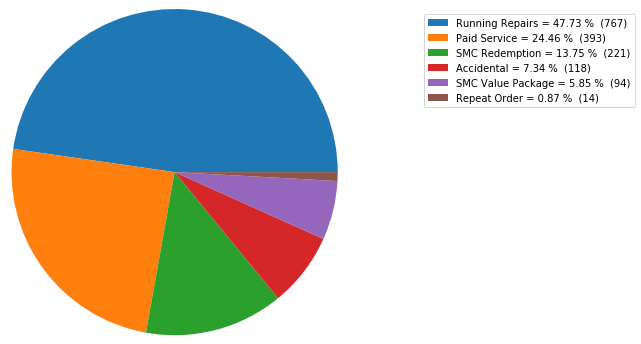

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2016-Q4


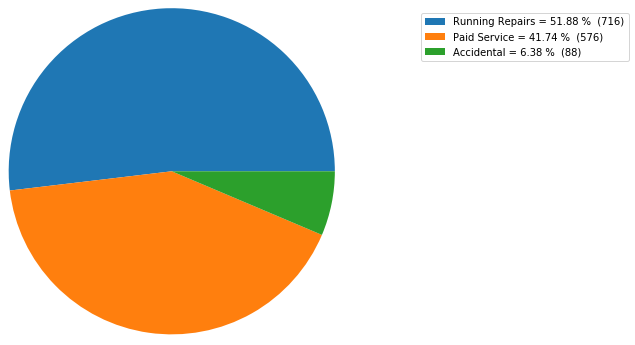

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2016-Q2


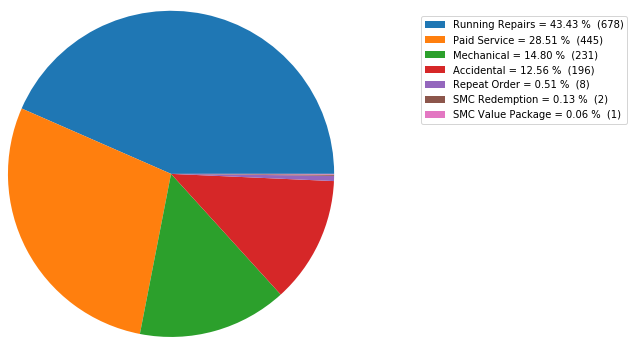

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2013-Q3


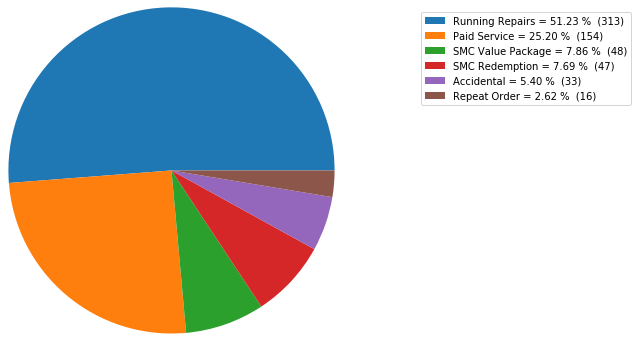

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2013-Q1


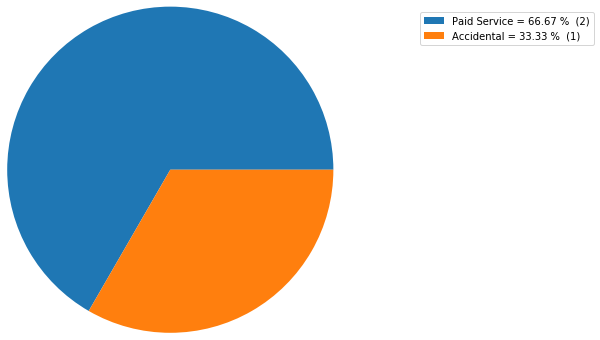

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2012-Q2


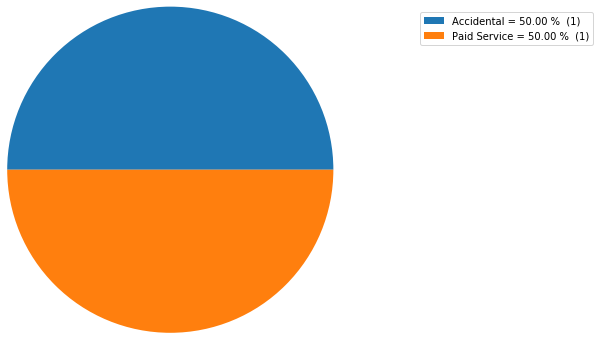

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2012-Q3


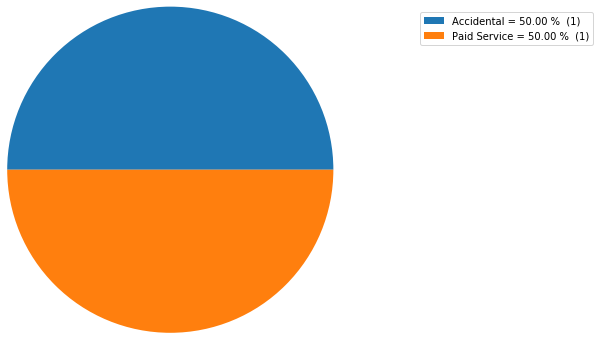

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2012-Q4


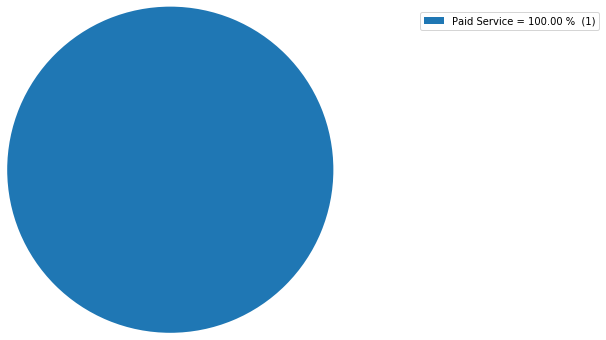

Countwise Distribution of Order Type for the State of Uttar Pradesh and for the season 2013-Q2


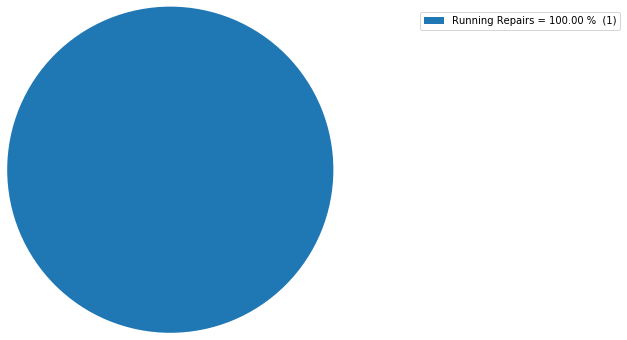

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2016-Q3


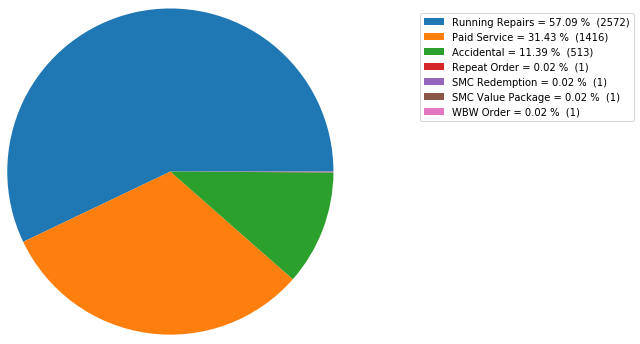

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2016-Q2


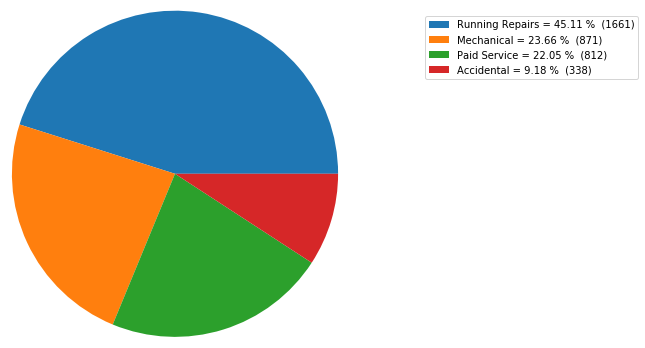

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2016-Q1


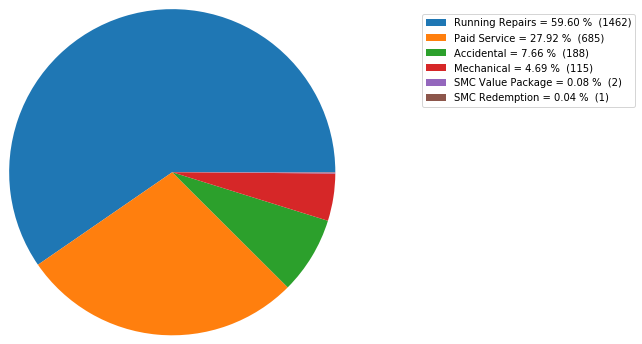

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2016-Q4


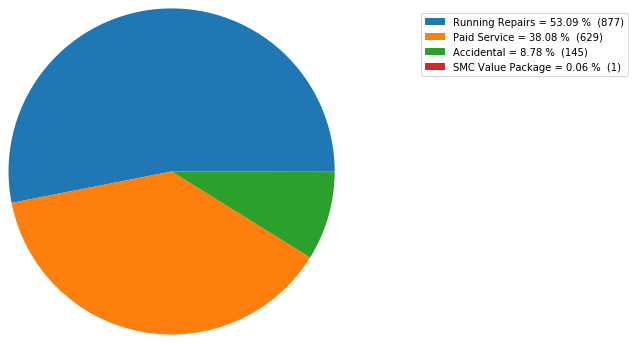

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2015-Q4


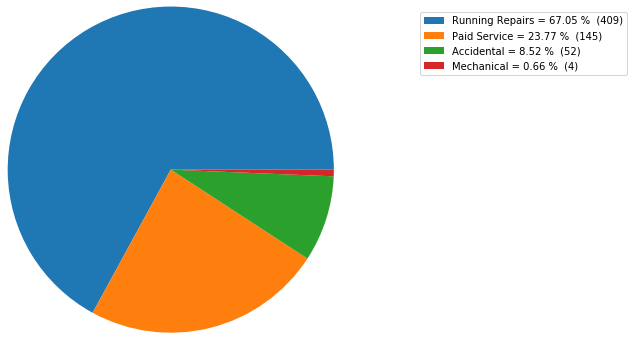

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2015-Q3


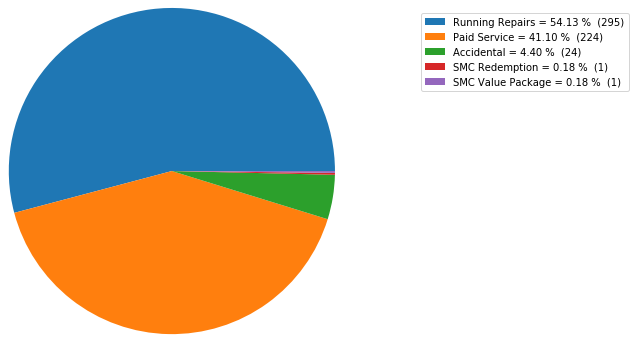

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2015-Q2


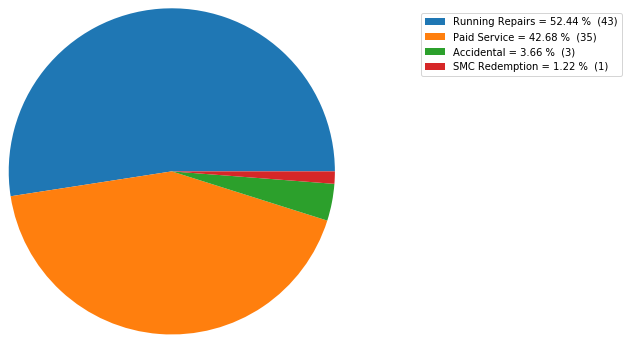

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2015-Q1


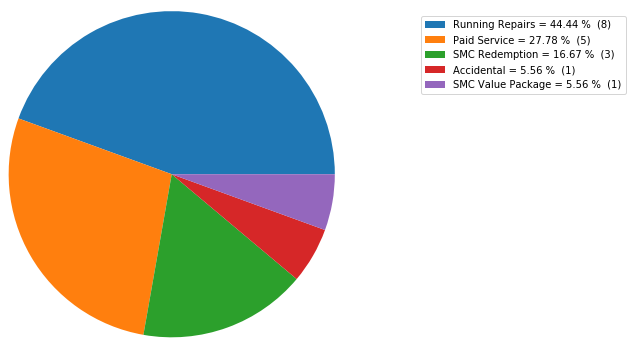

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2014-Q1


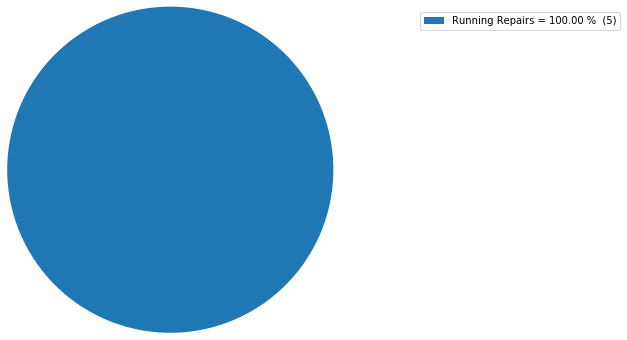

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2013-Q4


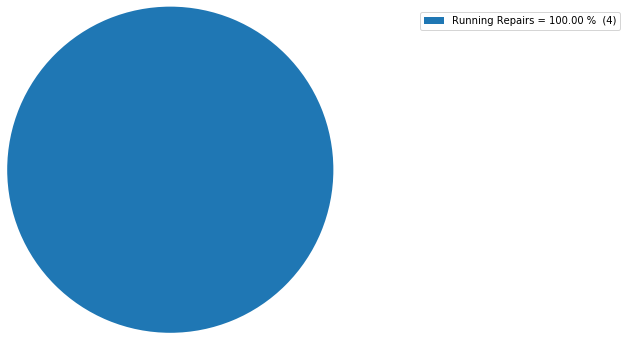

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2014-Q4


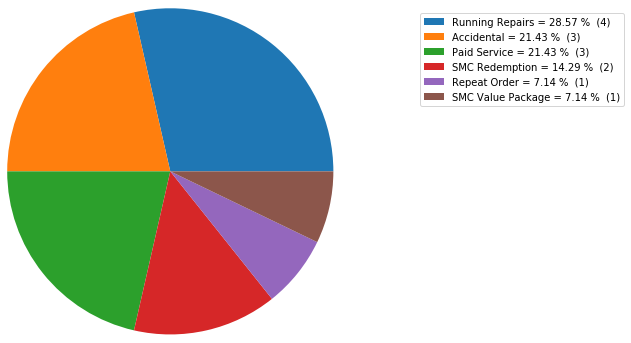

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2014-Q2


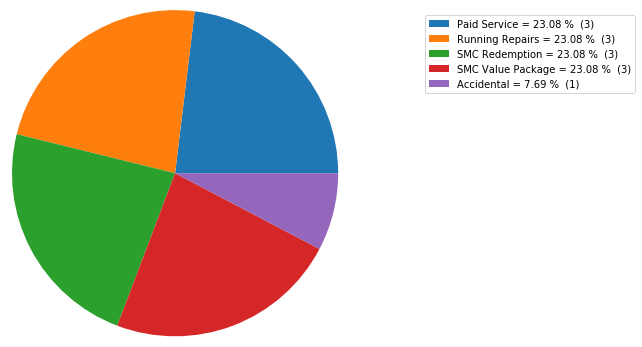

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2012-Q3


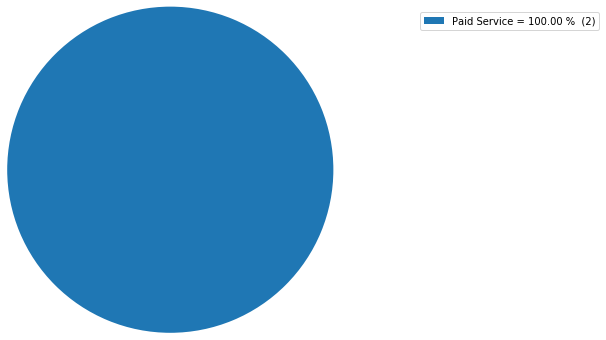

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2013-Q1


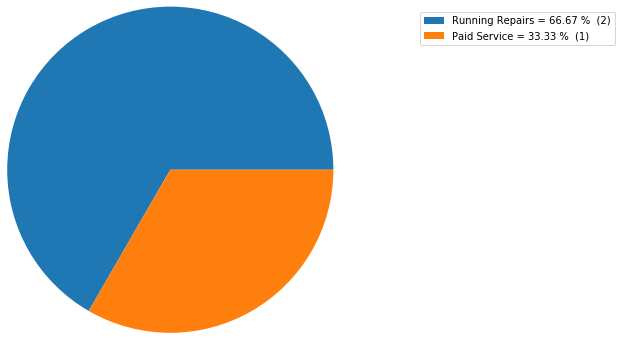

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2012-Q2


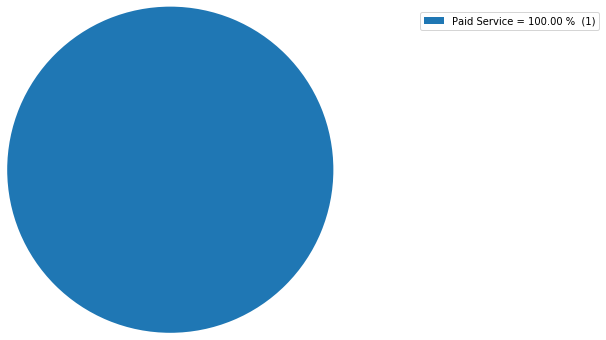

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2012-Q4


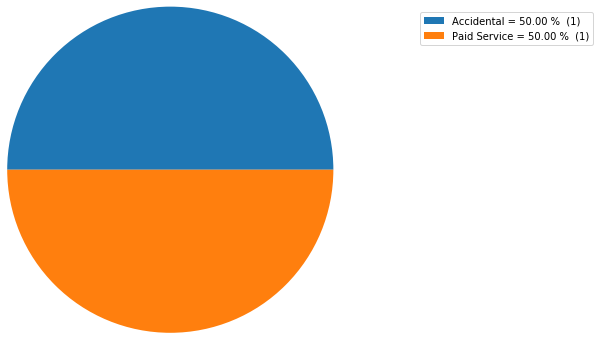

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2013-Q2


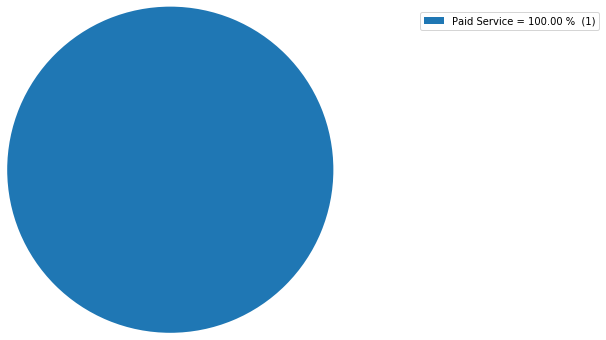

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2013-Q3


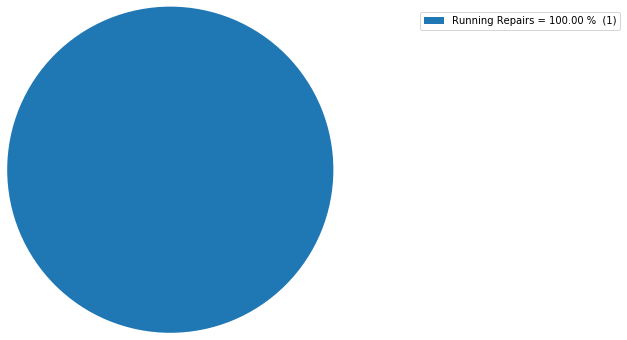

Countwise Distribution of Order Type for the State of Madhya Pradesh and for the season 2014-Q3


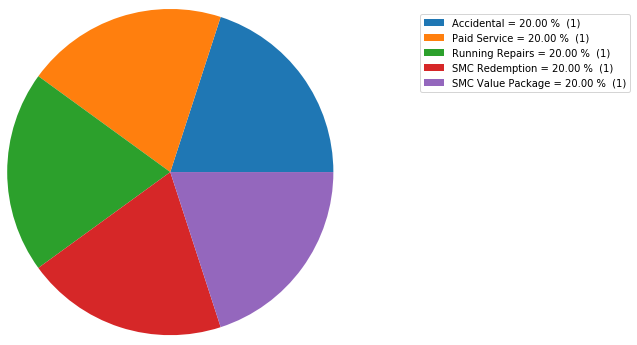

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2013-Q4


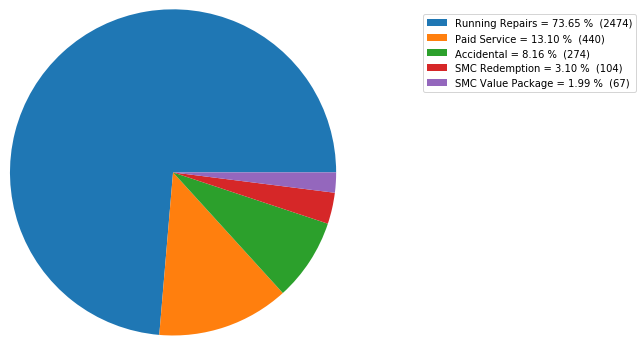

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2014-Q1


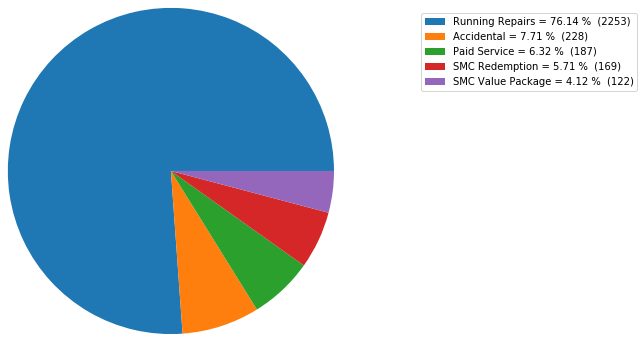

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2016-Q3


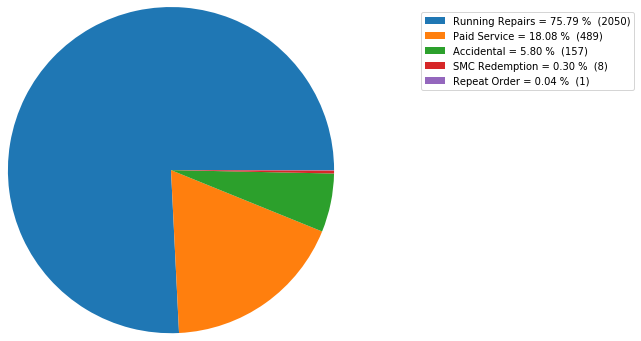

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2014-Q2


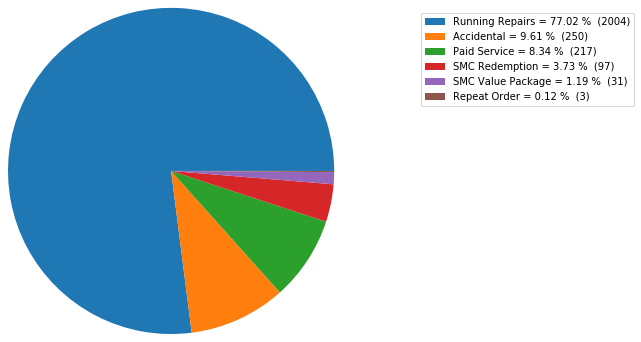

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2013-Q3


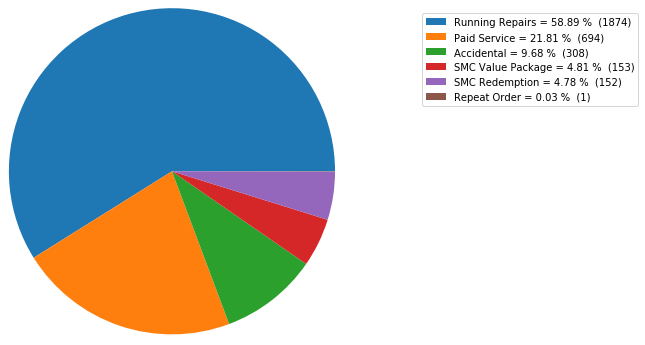

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2016-Q1


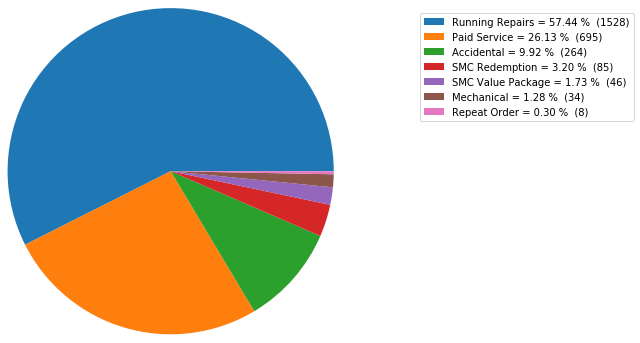

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2014-Q3


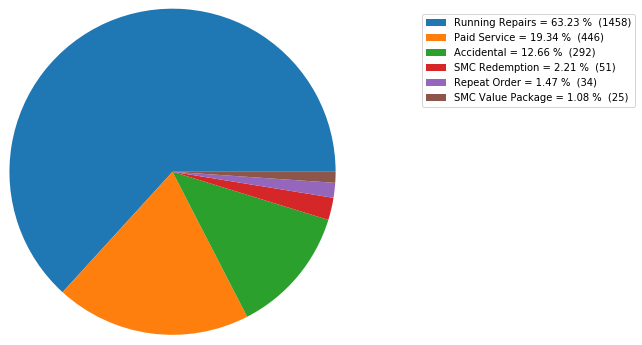

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2013-Q2


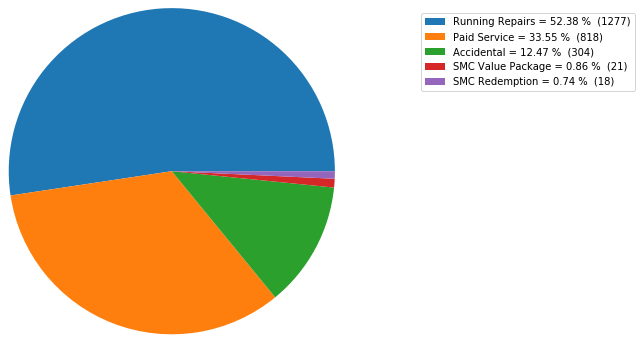

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2016-Q2


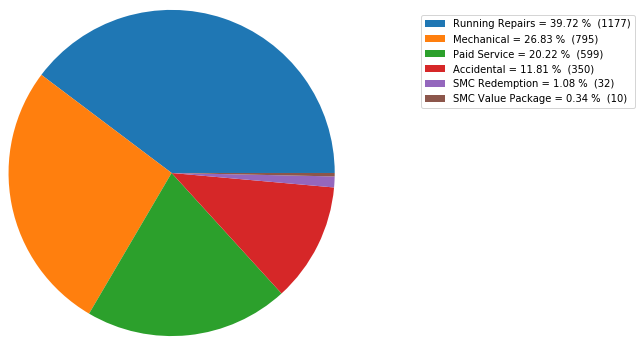

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2015-Q4


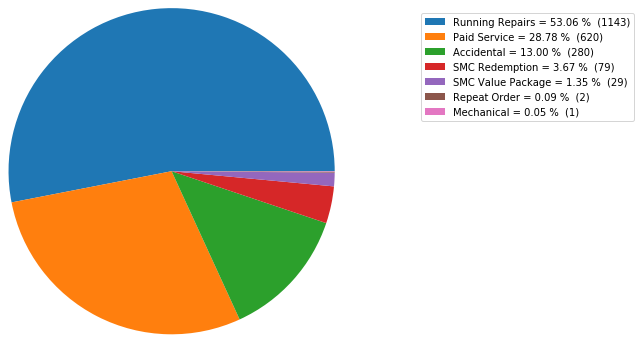

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2015-Q3


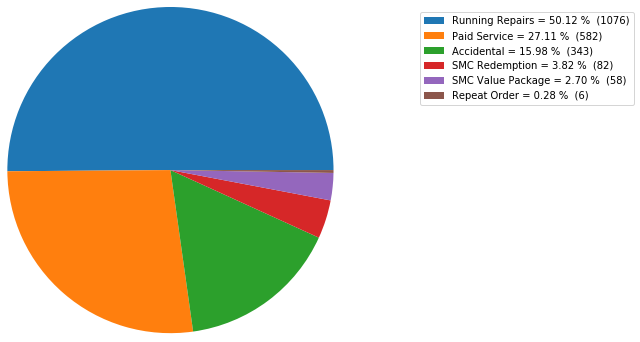

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2014-Q4


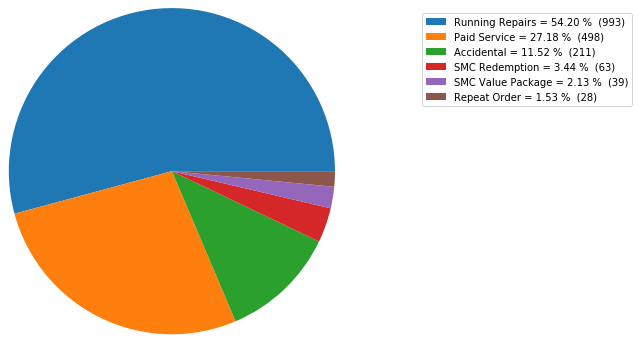

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2015-Q2


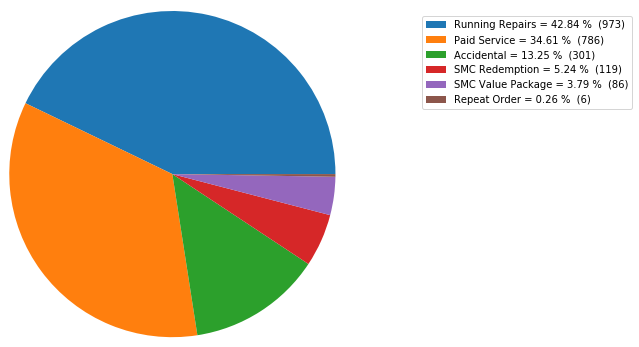

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2015-Q1


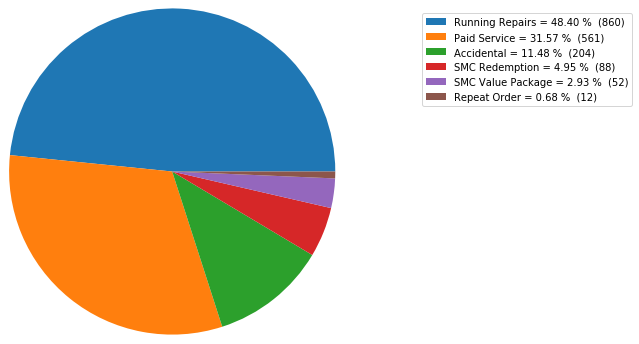

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2012-Q4


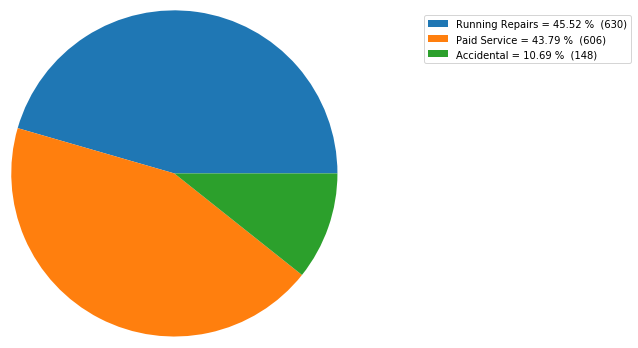

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2016-Q4


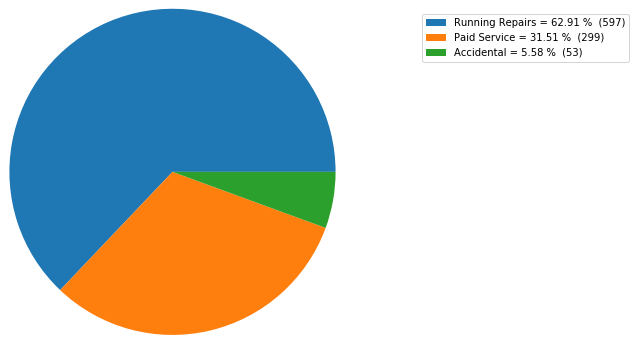

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2013-Q1


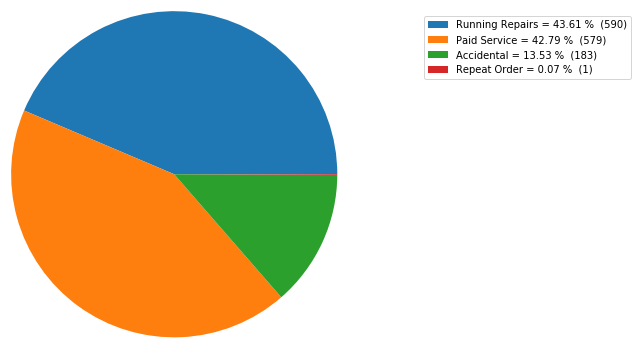

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2012-Q3


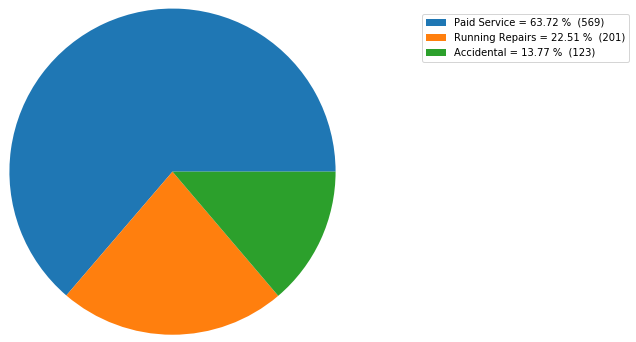

Countwise Distribution of Order Type for the State of Andhra Pradesh and for the season 2012-Q2


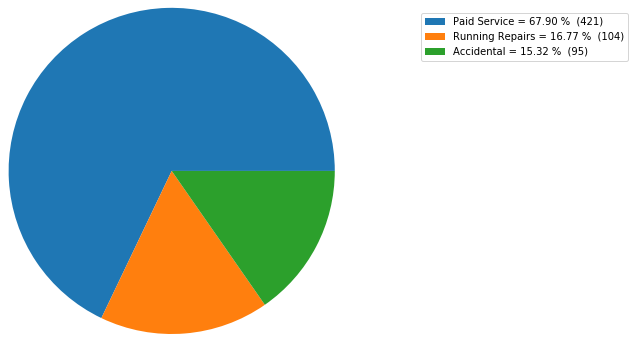

Countwise Distribution of Order Type for the State of Gujarat and for the season 2016-Q3


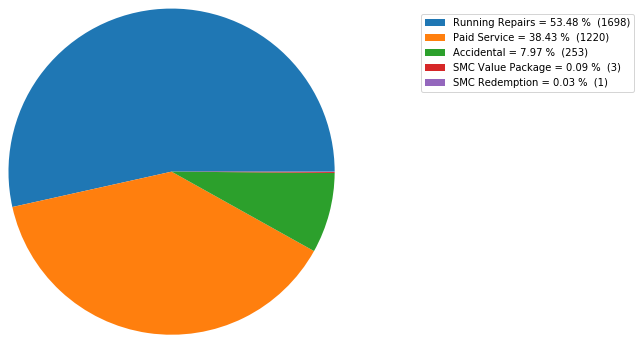

Countwise Distribution of Order Type for the State of Gujarat and for the season 2013-Q4


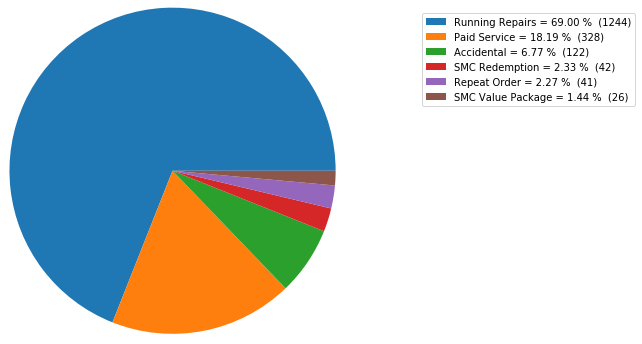

Countwise Distribution of Order Type for the State of Gujarat and for the season 2014-Q1


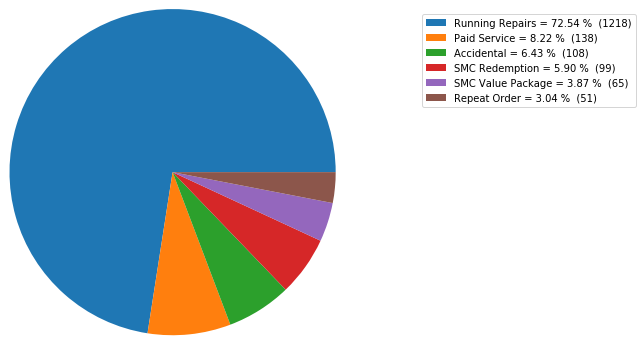

Countwise Distribution of Order Type for the State of Gujarat and for the season 2014-Q2


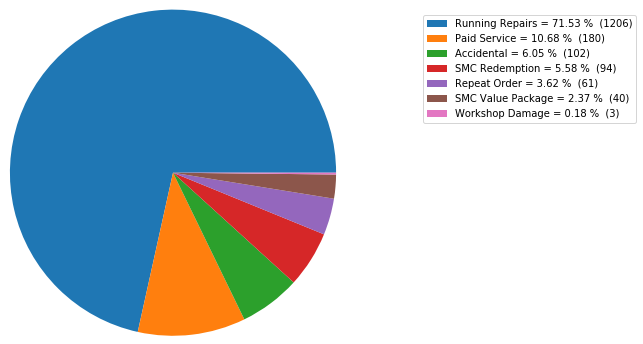

Countwise Distribution of Order Type for the State of Gujarat and for the season 2013-Q3


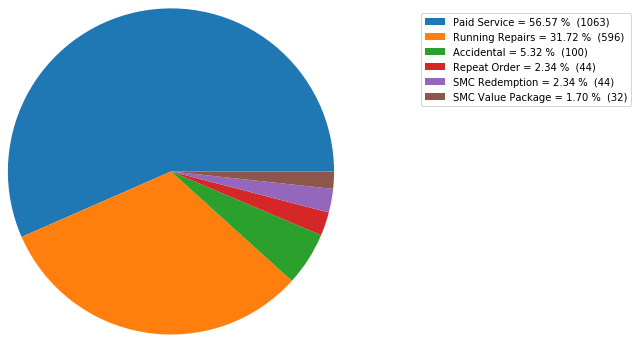

Countwise Distribution of Order Type for the State of Gujarat and for the season 2015-Q4


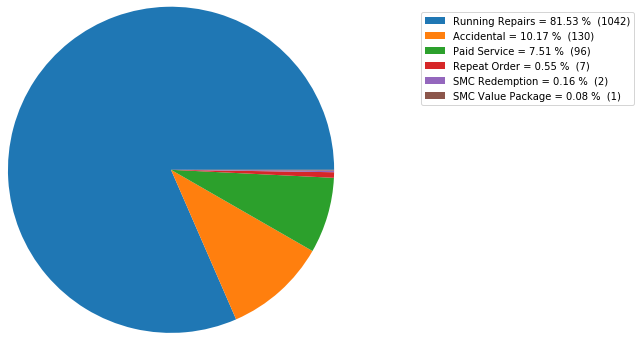

Countwise Distribution of Order Type for the State of Gujarat and for the season 2015-Q3


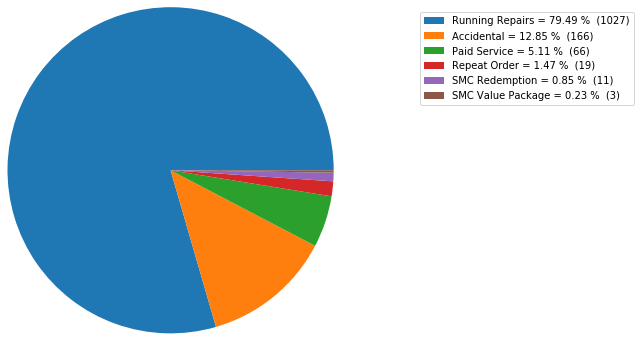

Countwise Distribution of Order Type for the State of Gujarat and for the season 2014-Q4


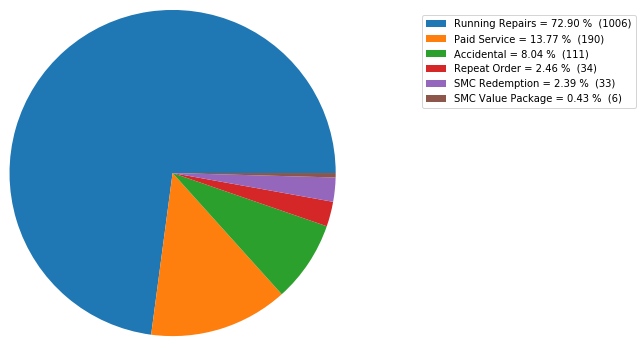

Countwise Distribution of Order Type for the State of Gujarat and for the season 2014-Q3


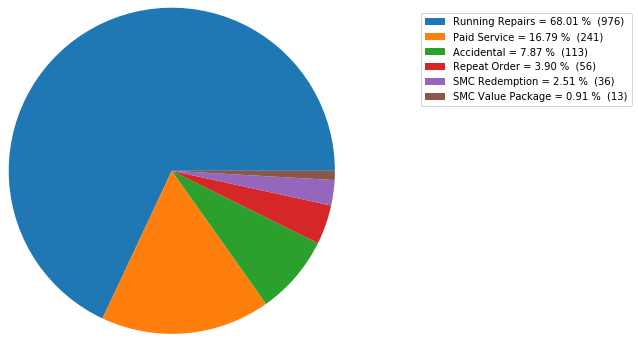

Countwise Distribution of Order Type for the State of Gujarat and for the season 2013-Q2


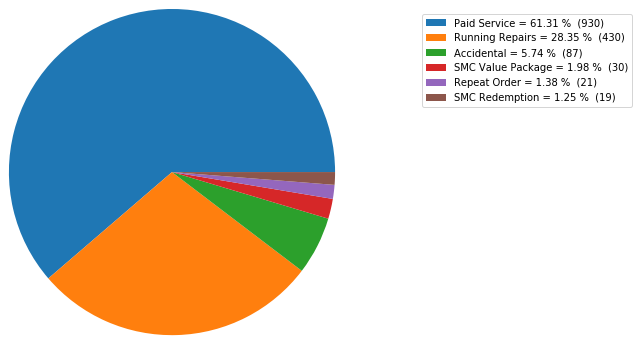

Countwise Distribution of Order Type for the State of Gujarat and for the season 2015-Q2


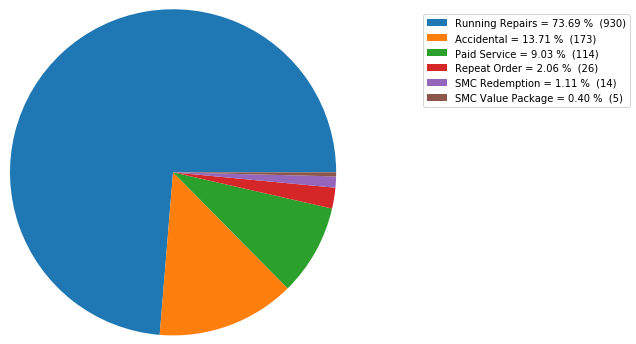

Countwise Distribution of Order Type for the State of Gujarat and for the season 2015-Q1


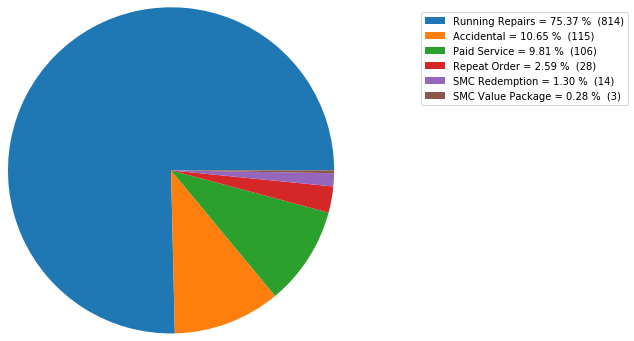

Countwise Distribution of Order Type for the State of Gujarat and for the season 2016-Q2


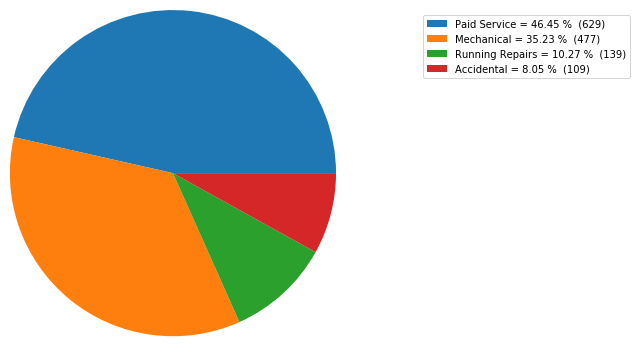

Countwise Distribution of Order Type for the State of Gujarat and for the season 2013-Q1


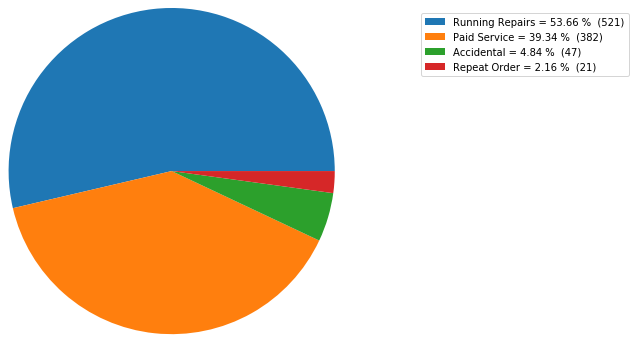

Countwise Distribution of Order Type for the State of Gujarat and for the season 2016-Q4


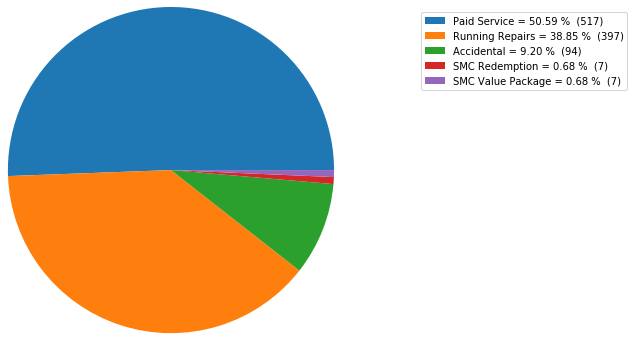

Countwise Distribution of Order Type for the State of Gujarat and for the season 2016-Q1


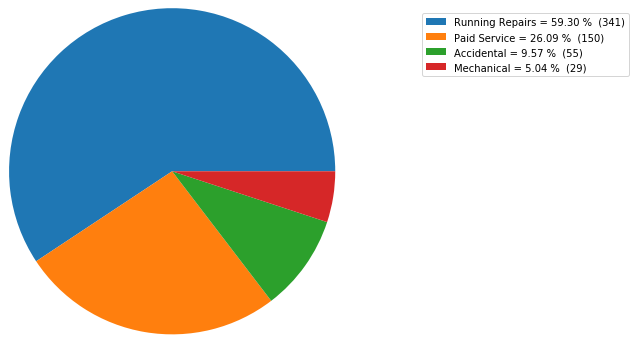

Countwise Distribution of Order Type for the State of Gujarat and for the season 2012-Q3


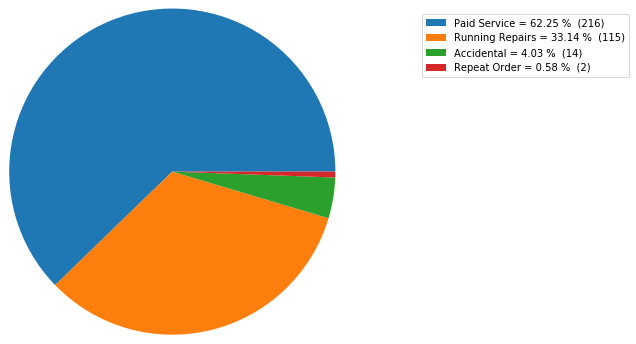

Countwise Distribution of Order Type for the State of Gujarat and for the season 2012-Q4


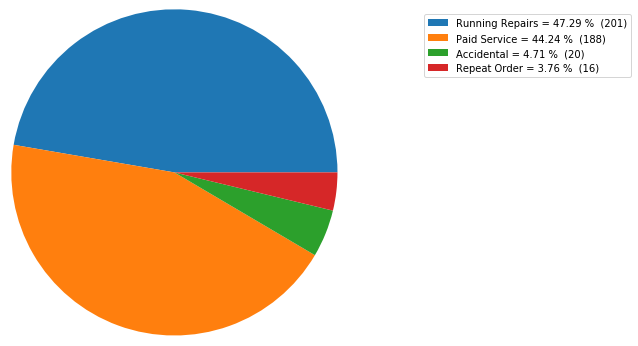

Countwise Distribution of Order Type for the State of Gujarat and for the season 2012-Q2


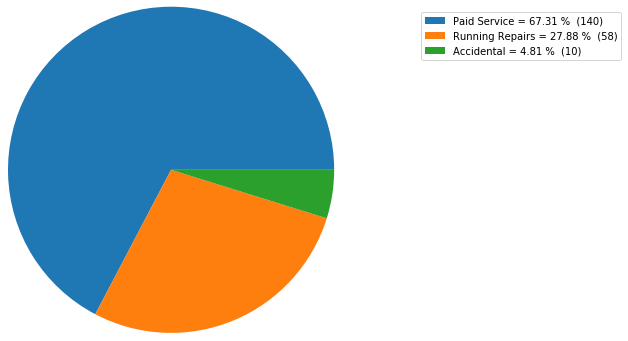

Countwise Distribution of Order Type for the State of Punjab and for the season 2016-Q1


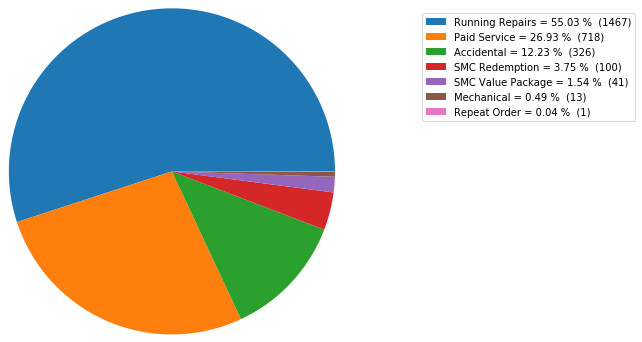

Countwise Distribution of Order Type for the State of Punjab and for the season 2015-Q1


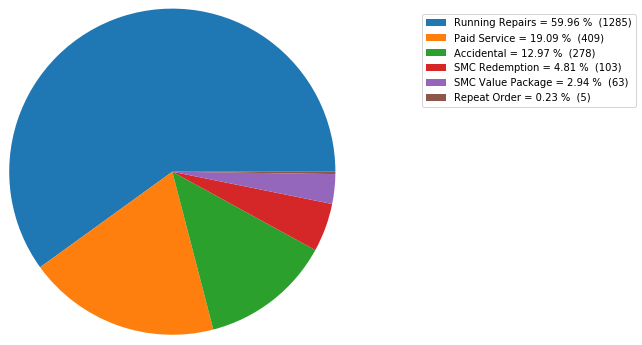

Countwise Distribution of Order Type for the State of Punjab and for the season 2015-Q4


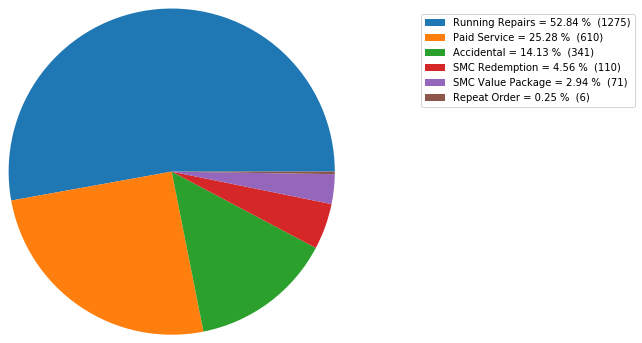

Countwise Distribution of Order Type for the State of Punjab and for the season 2015-Q2


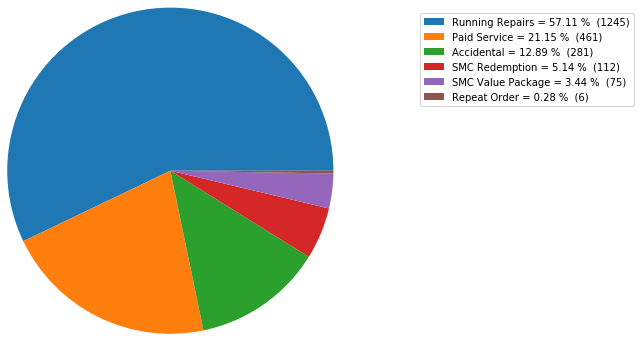

Countwise Distribution of Order Type for the State of Punjab and for the season 2015-Q3


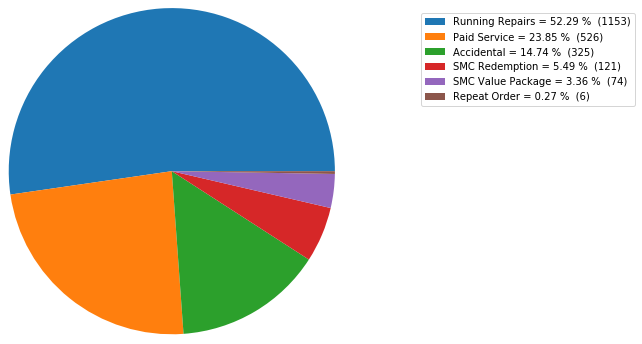

Countwise Distribution of Order Type for the State of Punjab and for the season 2016-Q3


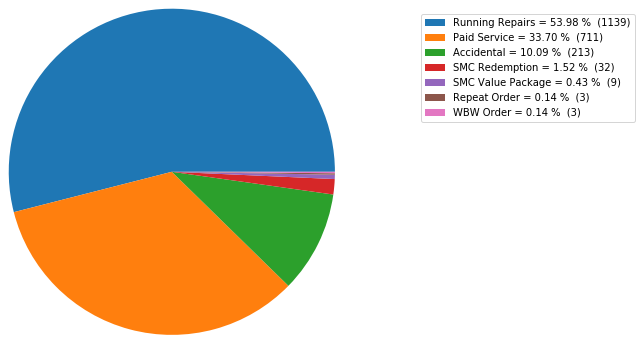

Countwise Distribution of Order Type for the State of Punjab and for the season 2014-Q4


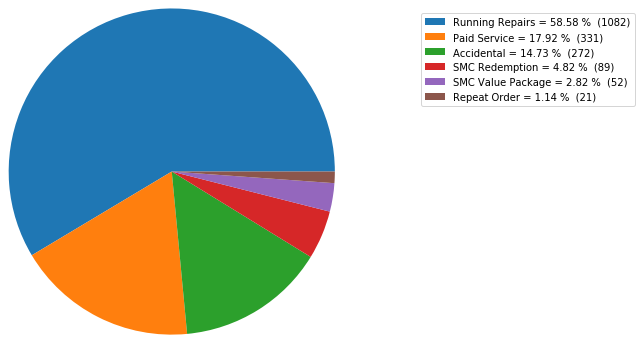

Countwise Distribution of Order Type for the State of Punjab and for the season 2014-Q1


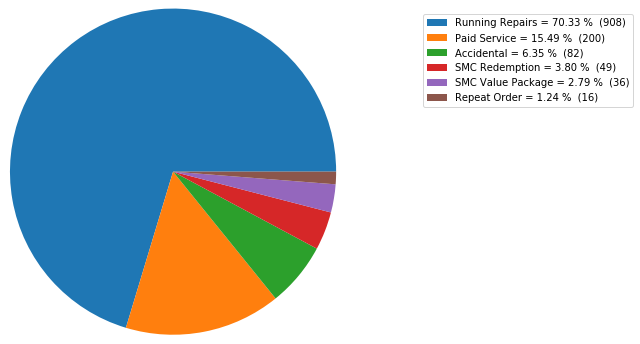

Countwise Distribution of Order Type for the State of Punjab and for the season 2016-Q2


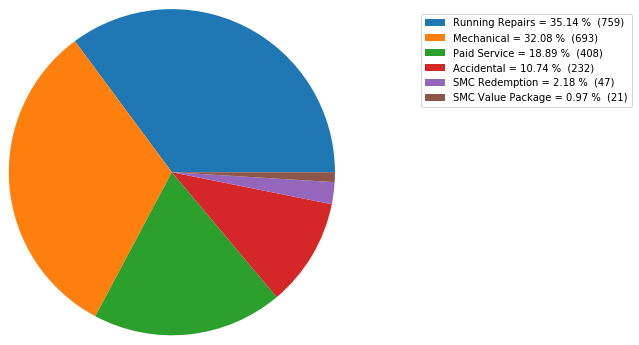

Countwise Distribution of Order Type for the State of Punjab and for the season 2014-Q2


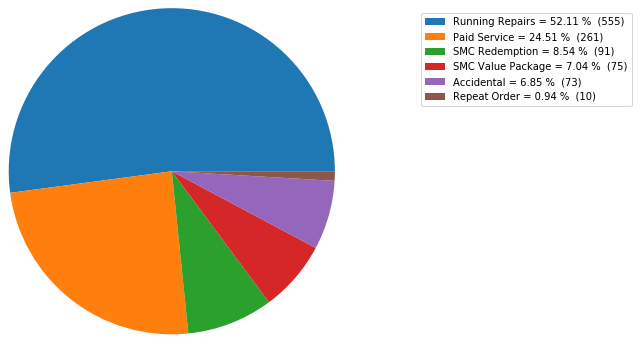

Countwise Distribution of Order Type for the State of Punjab and for the season 2014-Q3


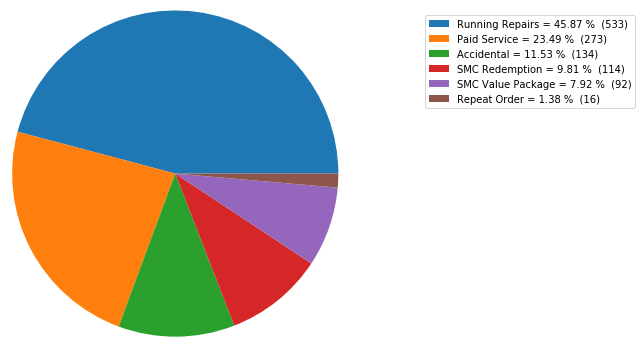

Countwise Distribution of Order Type for the State of Punjab and for the season 2016-Q4


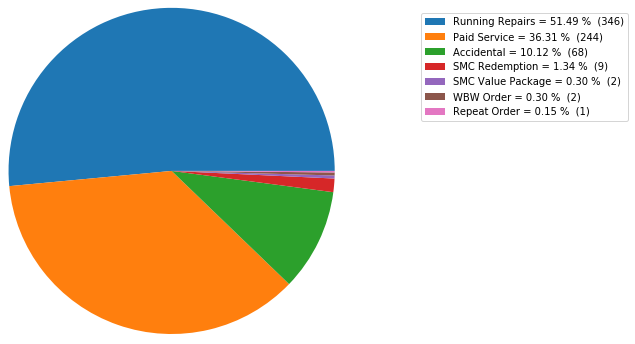

Countwise Distribution of Order Type for the State of Punjab and for the season 2013-Q4


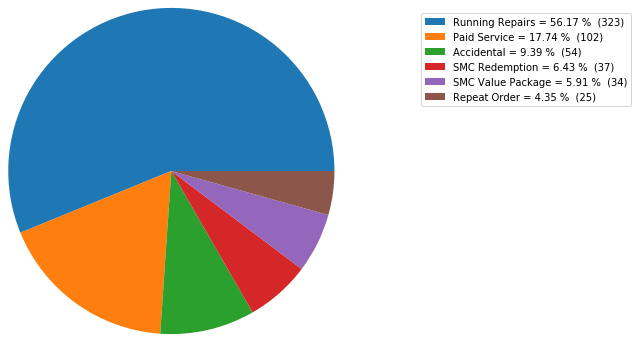

Countwise Distribution of Order Type for the State of Punjab and for the season 2013-Q3


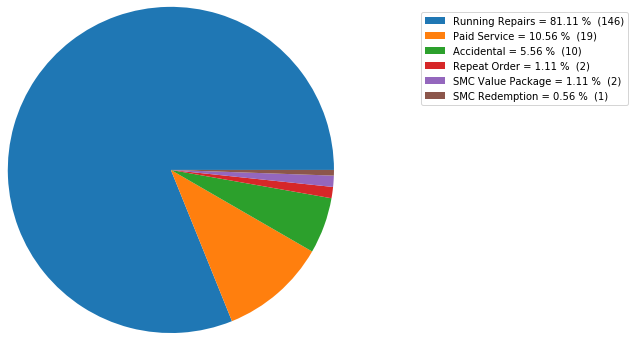

Countwise Distribution of Order Type for the State of Punjab and for the season 2012-Q2


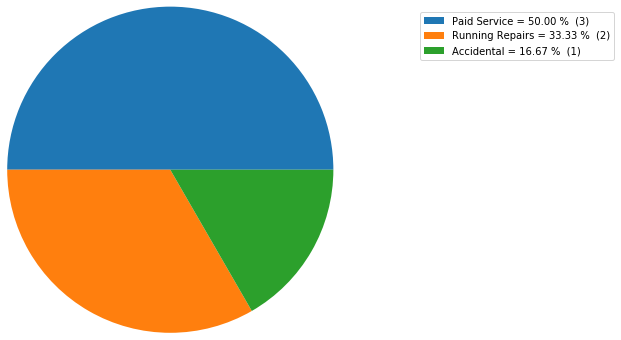

Countwise Distribution of Order Type for the State of Punjab and for the season 2012-Q3


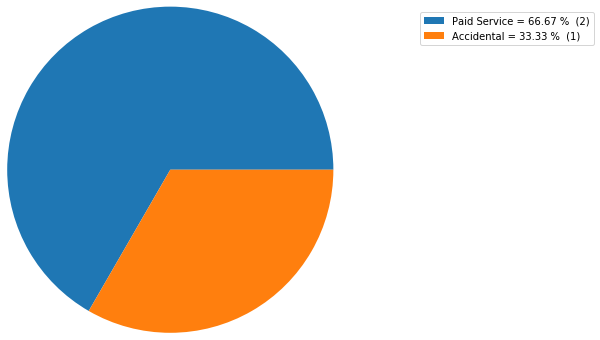

Countwise Distribution of Order Type for the State of Haryana and for the season 2016-Q3


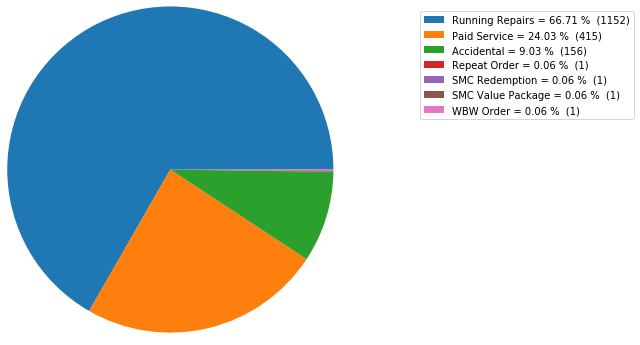

Countwise Distribution of Order Type for the State of Haryana and for the season 2014-Q1


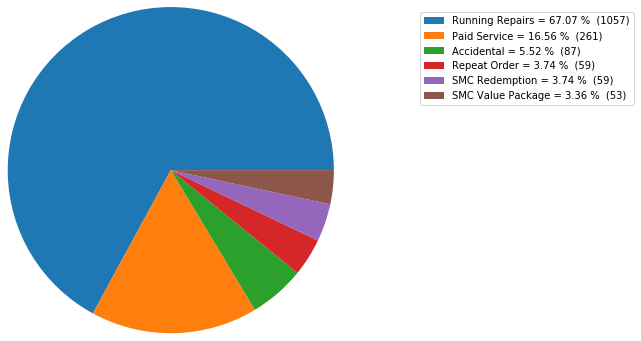

Countwise Distribution of Order Type for the State of Haryana and for the season 2016-Q1


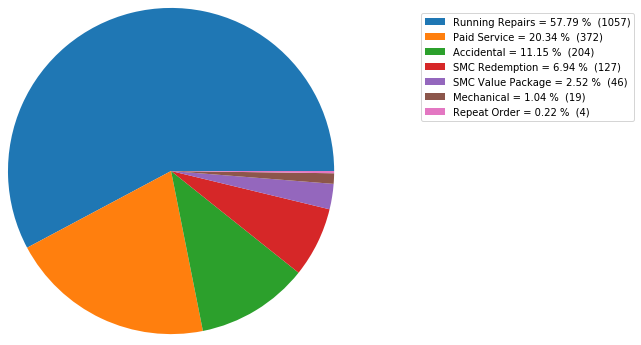

Countwise Distribution of Order Type for the State of Haryana and for the season 2013-Q4


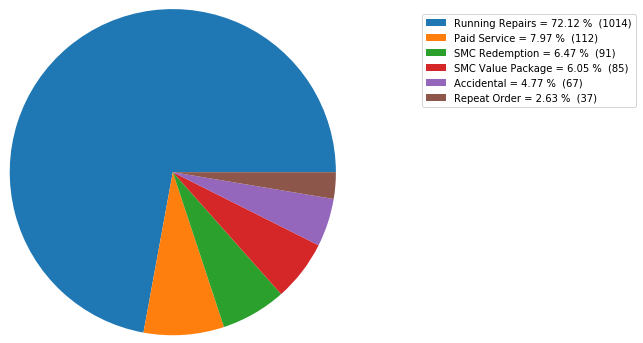

Countwise Distribution of Order Type for the State of Haryana and for the season 2015-Q4


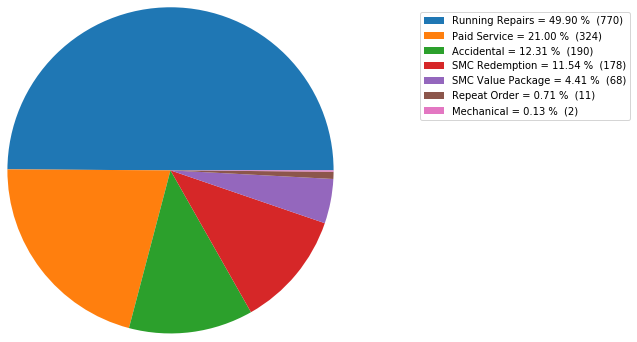

Countwise Distribution of Order Type for the State of Haryana and for the season 2016-Q2


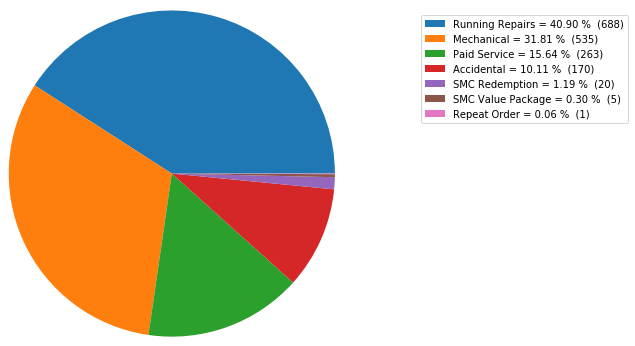

Countwise Distribution of Order Type for the State of Haryana and for the season 2015-Q3


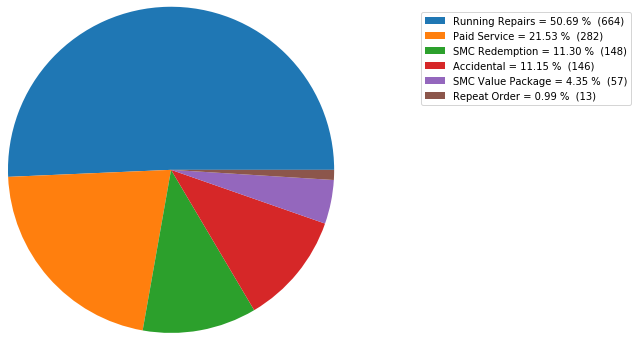

Countwise Distribution of Order Type for the State of Haryana and for the season 2014-Q2


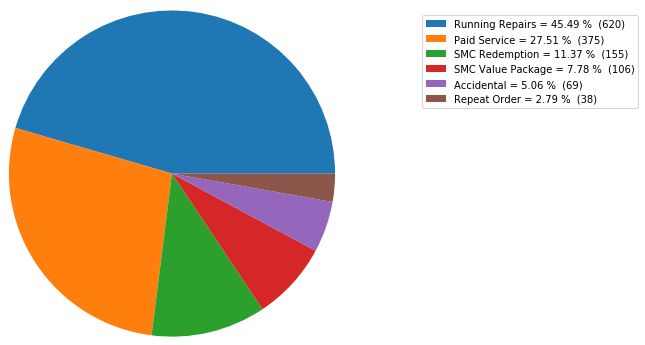

Countwise Distribution of Order Type for the State of Haryana and for the season 2015-Q2


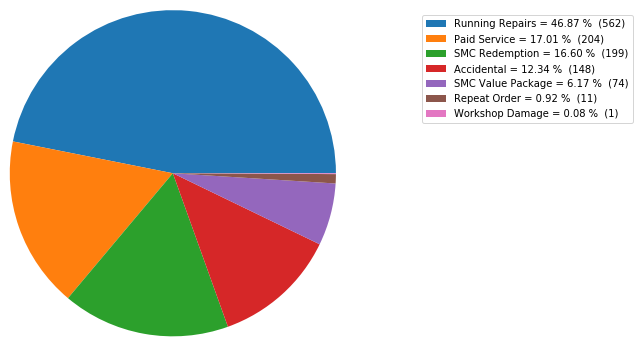

Countwise Distribution of Order Type for the State of Haryana and for the season 2014-Q4


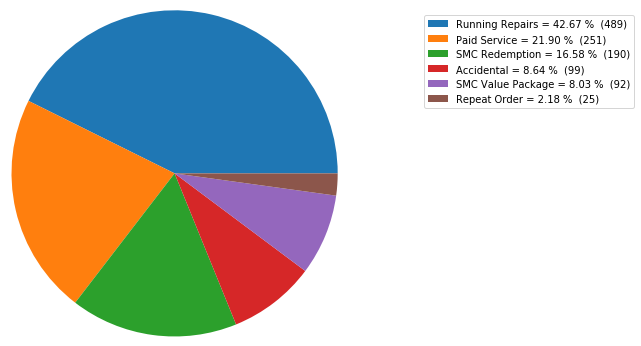

Countwise Distribution of Order Type for the State of Haryana and for the season 2014-Q3


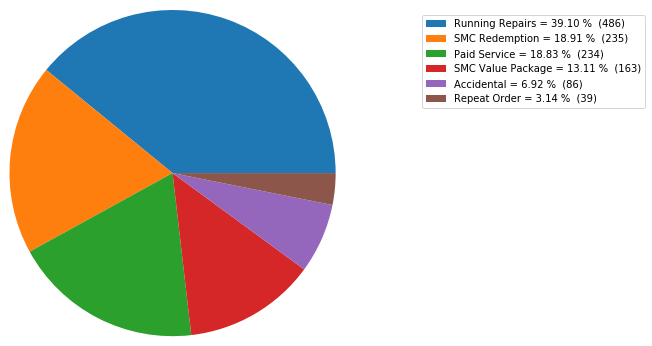

Countwise Distribution of Order Type for the State of Haryana and for the season 2015-Q1


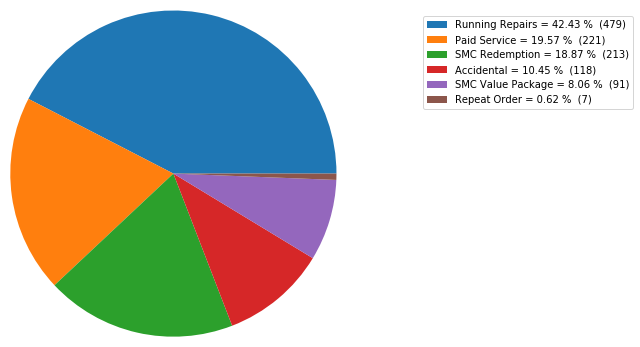

Countwise Distribution of Order Type for the State of Haryana and for the season 2016-Q4


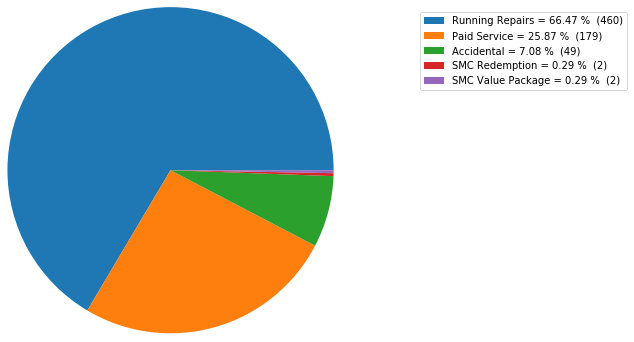

Countwise Distribution of Order Type for the State of Haryana and for the season 2013-Q3


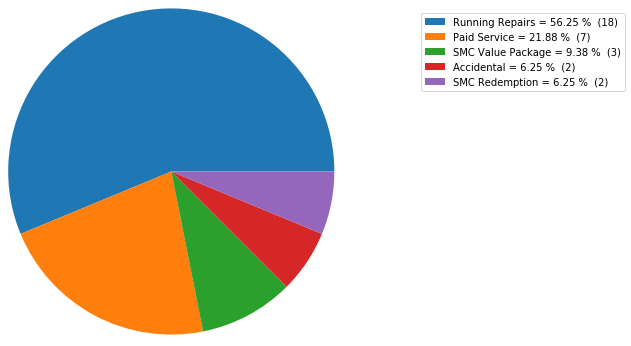

Countwise Distribution of Order Type for the State of Haryana and for the season 2013-Q2


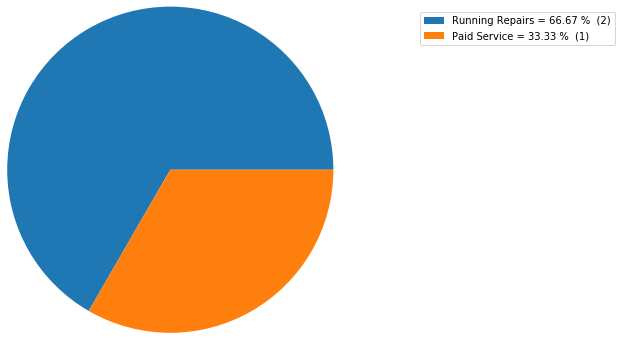

Countwise Distribution of Order Type for the State of Haryana and for the season 2012-Q4


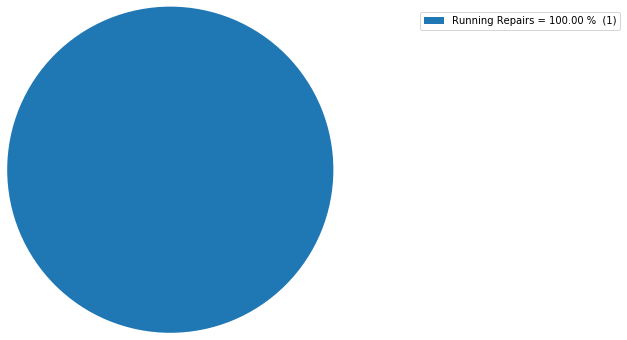

Countwise Distribution of Order Type for the State of Odisha and for the season 2016-Q3


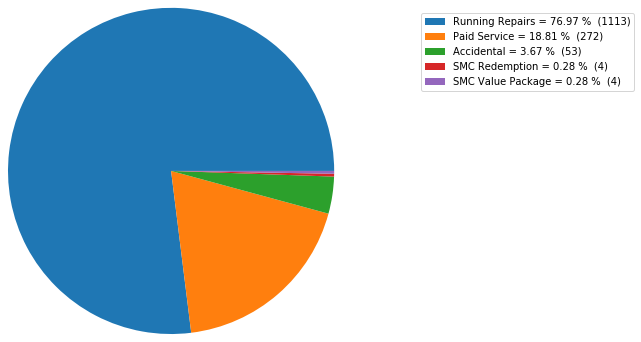

Countwise Distribution of Order Type for the State of Odisha and for the season 2016-Q4


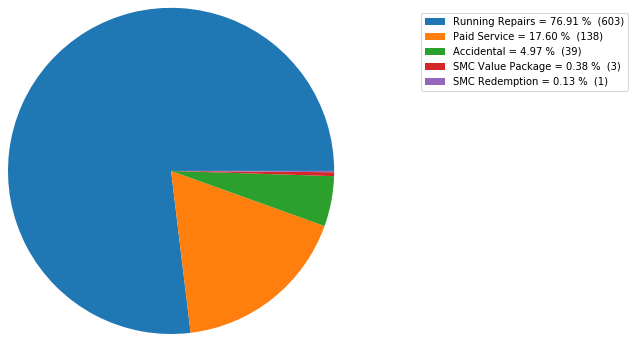

Countwise Distribution of Order Type for the State of Odisha and for the season 2016-Q2


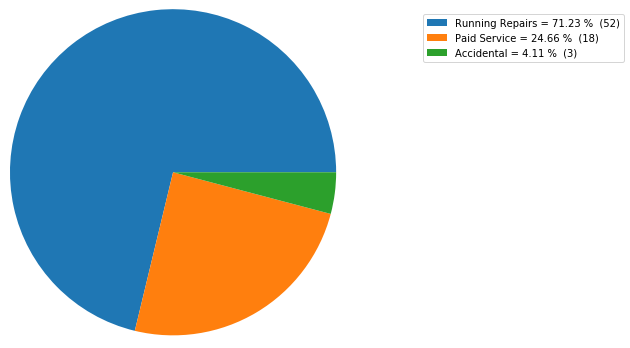

Countwise Distribution of Order Type for the State of Odisha and for the season 2014-Q4


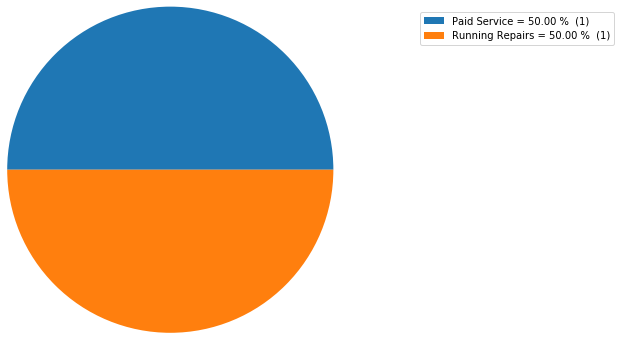

Countwise Distribution of Order Type for the State of Telangana and for the season 2016-Q3


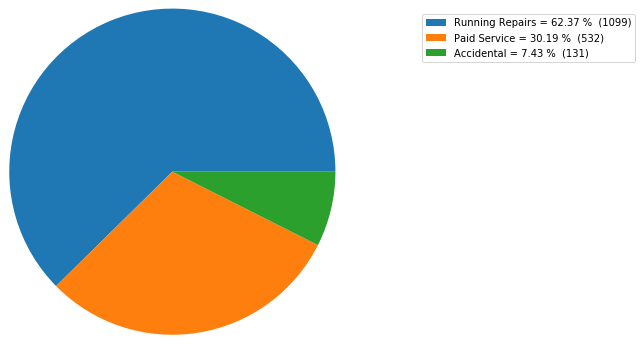

Countwise Distribution of Order Type for the State of Telangana and for the season 2016-Q1


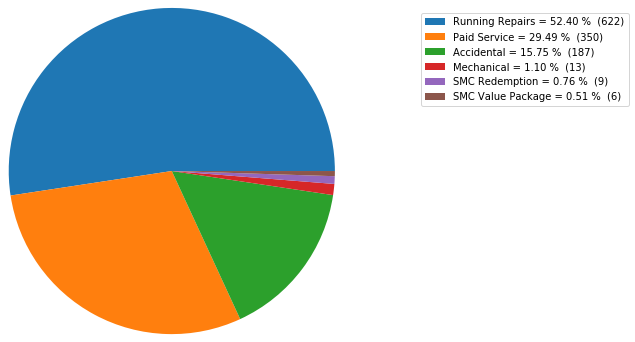

Countwise Distribution of Order Type for the State of Telangana and for the season 2016-Q2


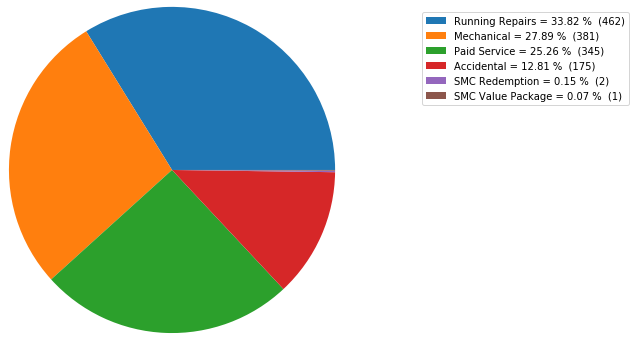

Countwise Distribution of Order Type for the State of Telangana and for the season 2015-Q1


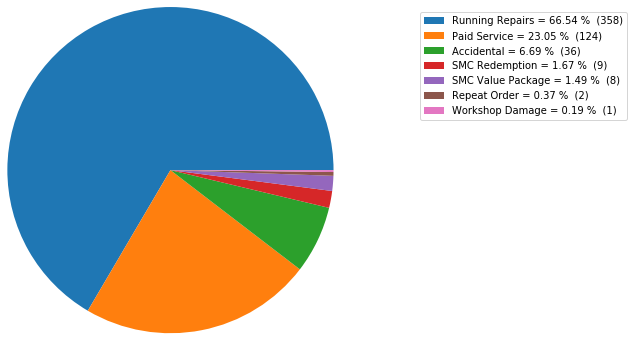

Countwise Distribution of Order Type for the State of Telangana and for the season 2015-Q4


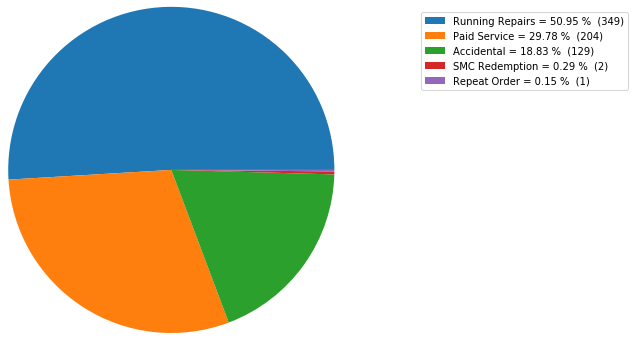

Countwise Distribution of Order Type for the State of Telangana and for the season 2016-Q4


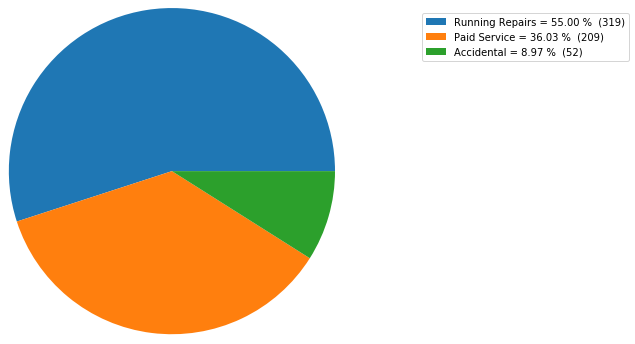

Countwise Distribution of Order Type for the State of Telangana and for the season 2015-Q3


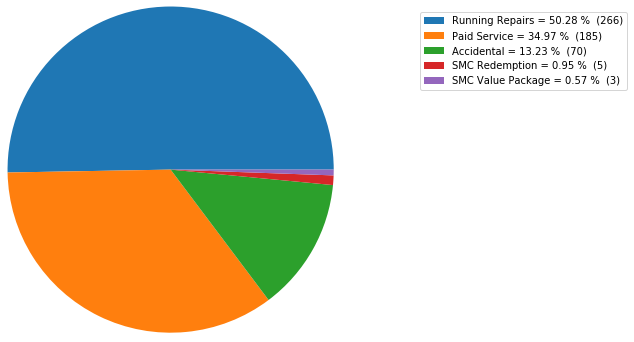

Countwise Distribution of Order Type for the State of Telangana and for the season 2014-Q4


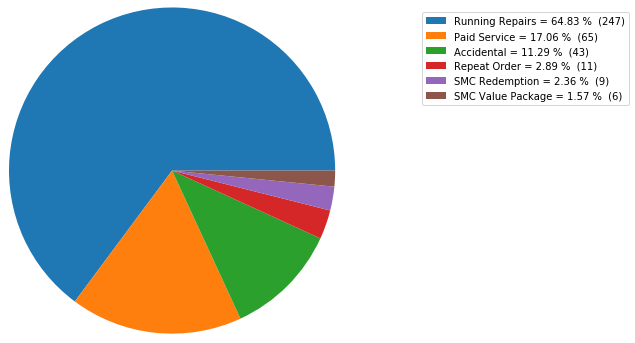

Countwise Distribution of Order Type for the State of Telangana and for the season 2015-Q2


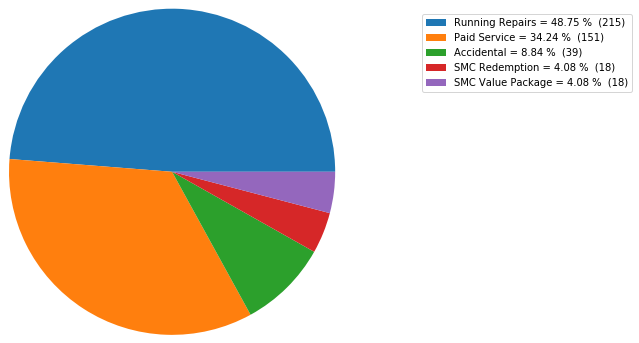

Countwise Distribution of Order Type for the State of Telangana and for the season 2014-Q3


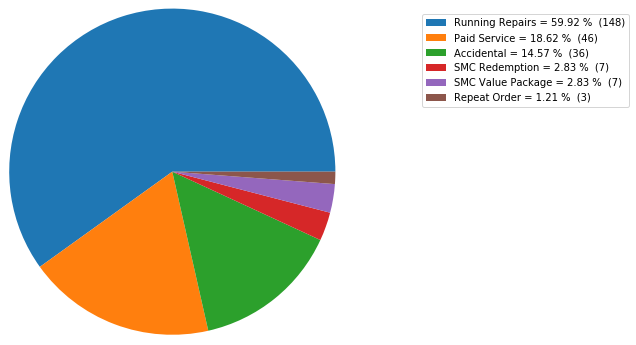

Countwise Distribution of Order Type for the State of Telangana and for the season 2013-Q4


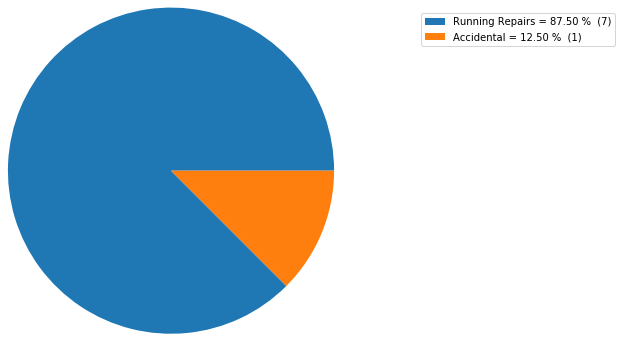

Countwise Distribution of Order Type for the State of Telangana and for the season 2013-Q2


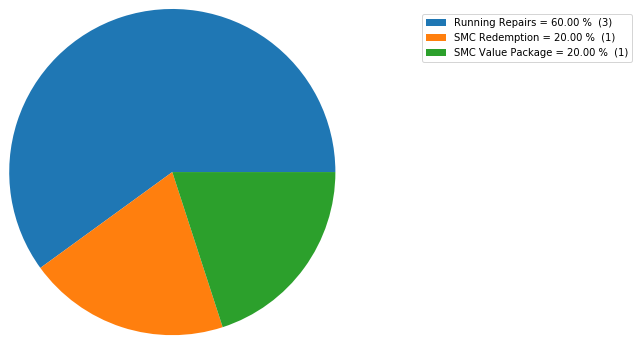

Countwise Distribution of Order Type for the State of Telangana and for the season 2013-Q3


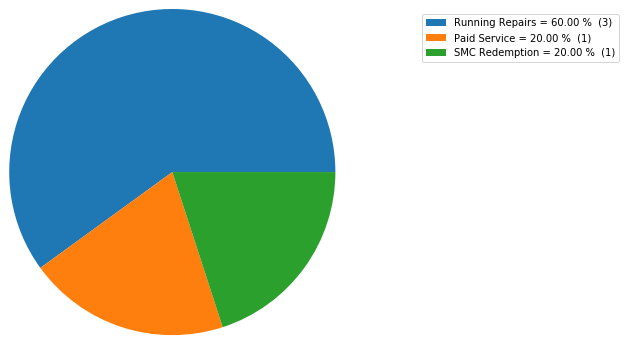

Countwise Distribution of Order Type for the State of Telangana and for the season 2014-Q2


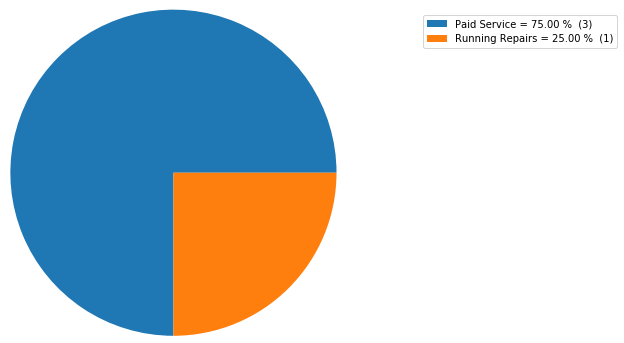

Countwise Distribution of Order Type for the State of Telangana and for the season 2014-Q1


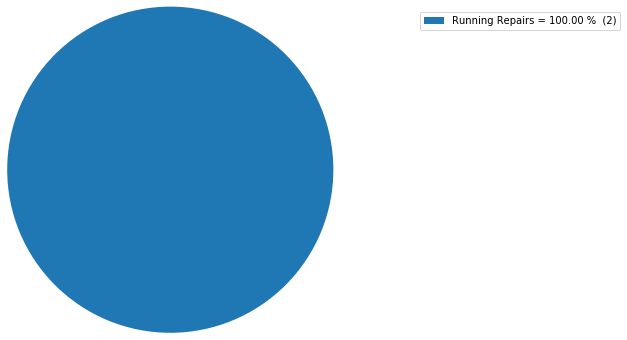

Countwise Distribution of Order Type for the State of Telangana and for the season 2013-Q1


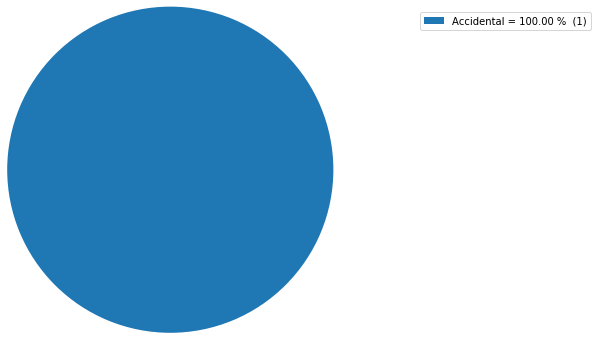

Countwise Distribution of Order Type for the State of Bihar and for the season 2016-Q3


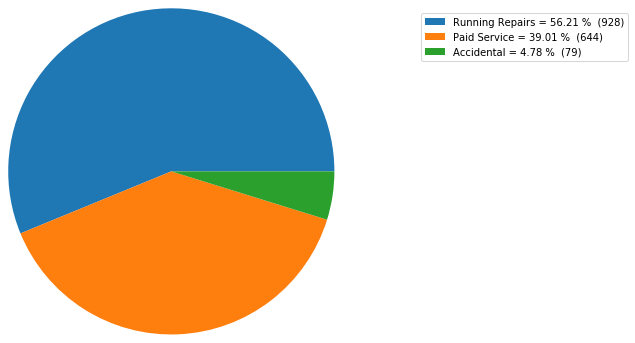

Countwise Distribution of Order Type for the State of Bihar and for the season 2016-Q2


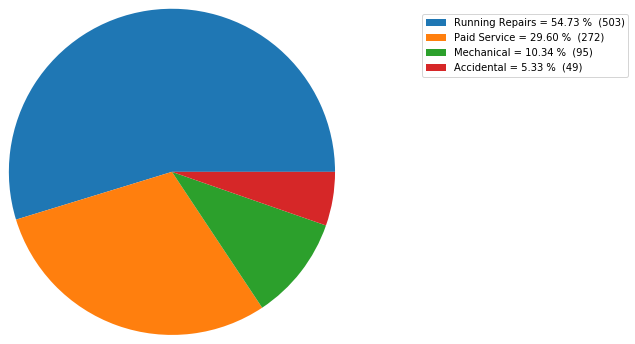

Countwise Distribution of Order Type for the State of Bihar and for the season 2016-Q4


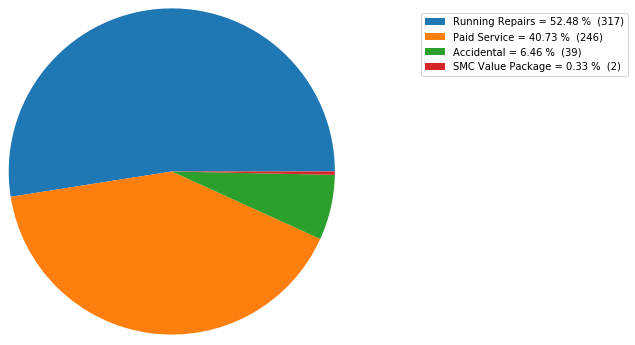

Countwise Distribution of Order Type for the State of Bihar and for the season 2016-Q1


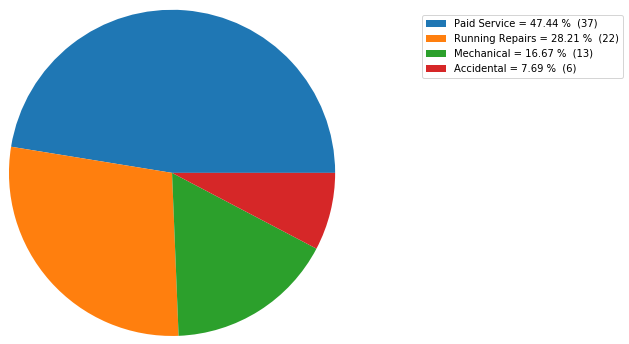

Countwise Distribution of Order Type for the State of Bihar and for the season 2015-Q1


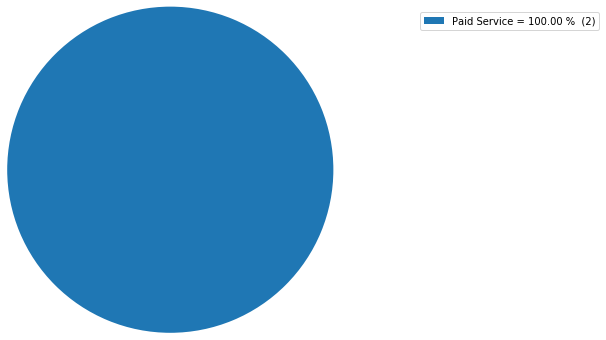

Countwise Distribution of Order Type for the State of Bihar and for the season 2013-Q4


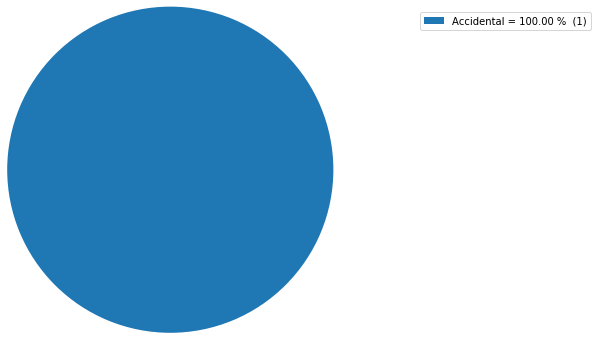

Countwise Distribution of Order Type for the State of Bihar and for the season 2014-Q1


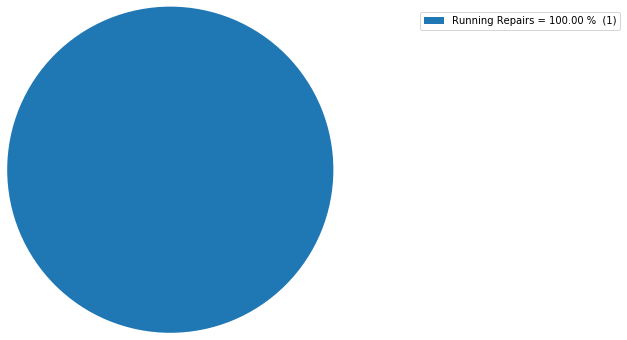

Countwise Distribution of Order Type for the State of Bihar and for the season 2014-Q3


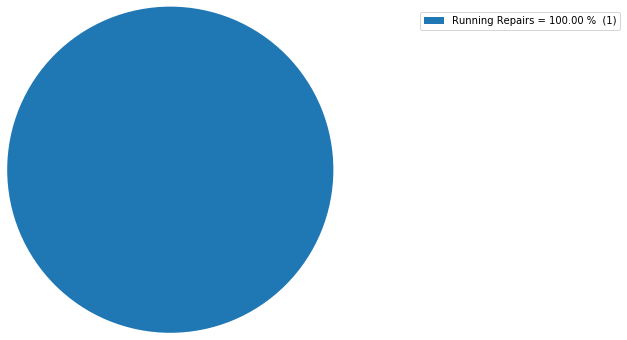

Countwise Distribution of Order Type for the State of Bihar and for the season 2015-Q4


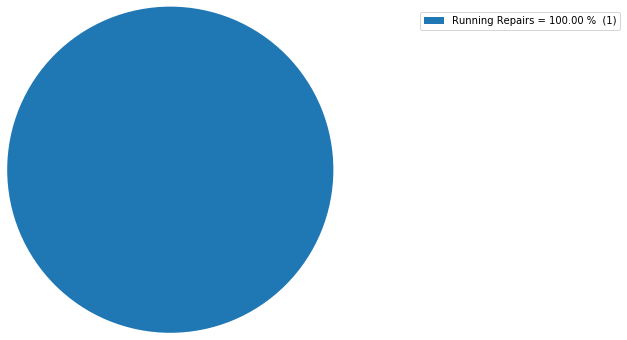

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2016-Q3


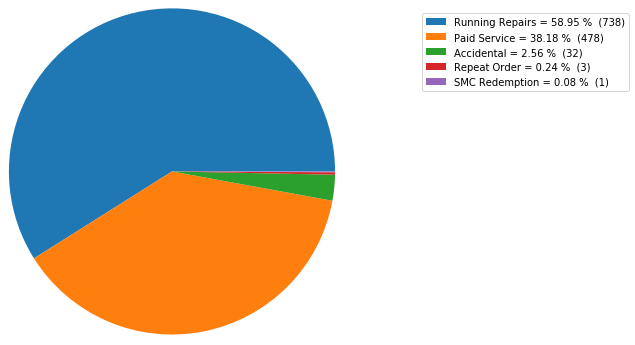

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2016-Q4


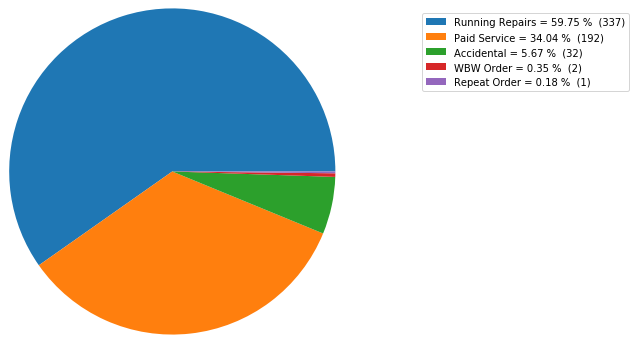

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2016-Q2


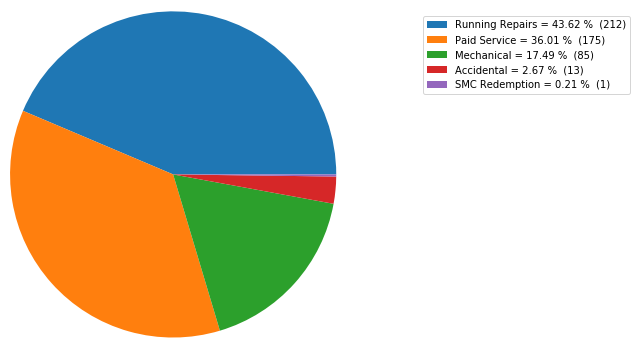

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2016-Q1


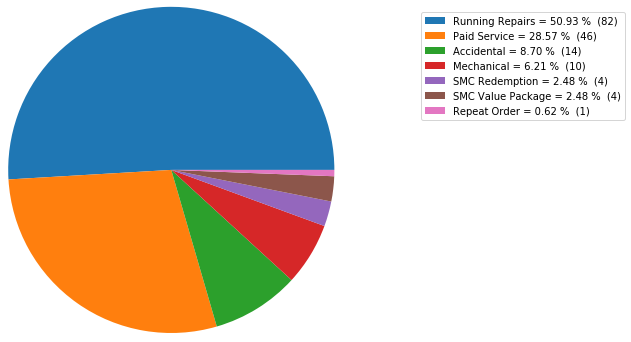

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2015-Q2


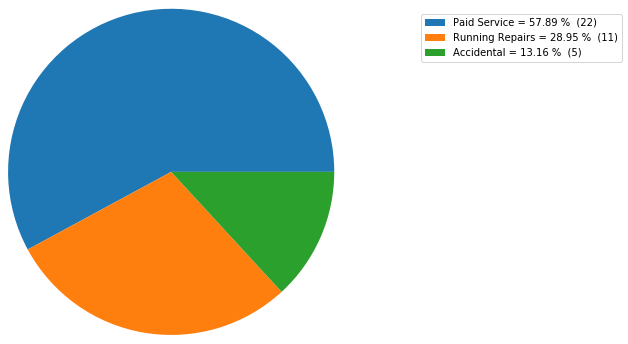

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2015-Q3


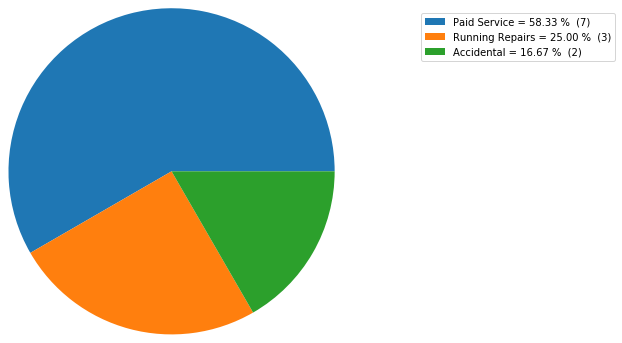

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2015-Q1


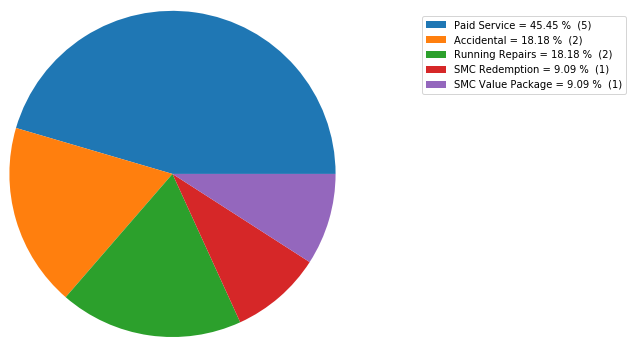

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2015-Q4


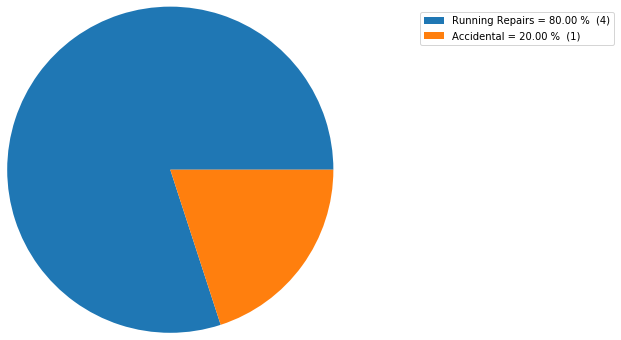

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2014-Q2


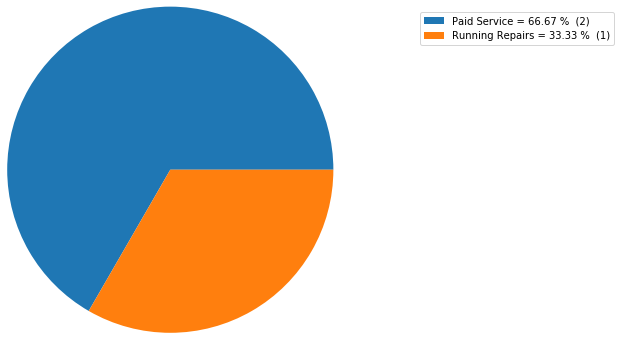

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2014-Q3


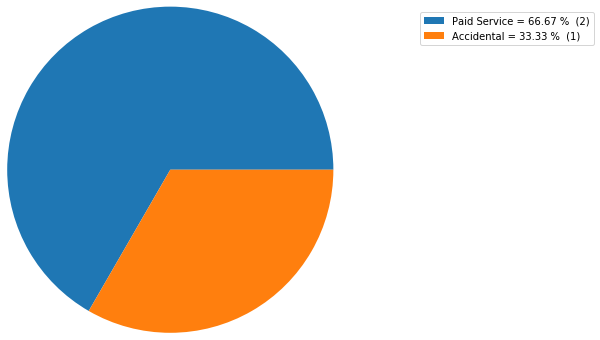

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2014-Q4


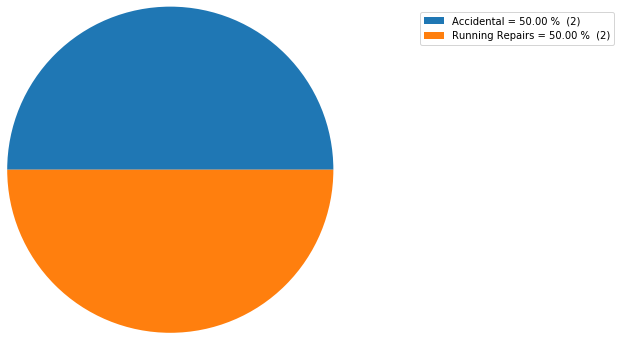

Countwise Distribution of Order Type for the State of Uttarakhand and for the season 2013-Q4


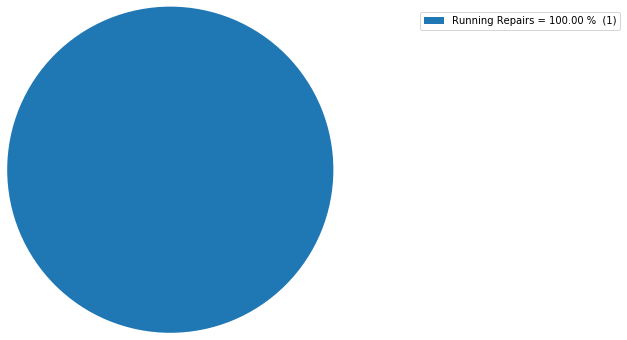

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2016-Q3


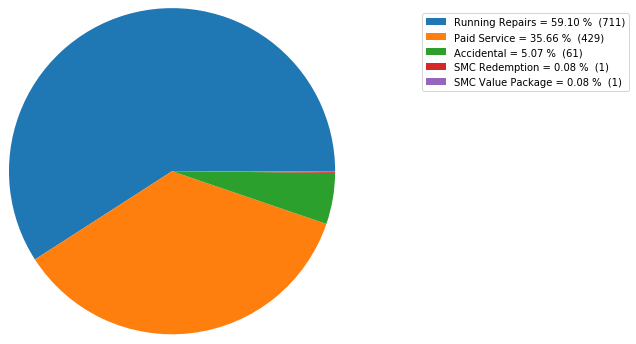

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2016-Q2


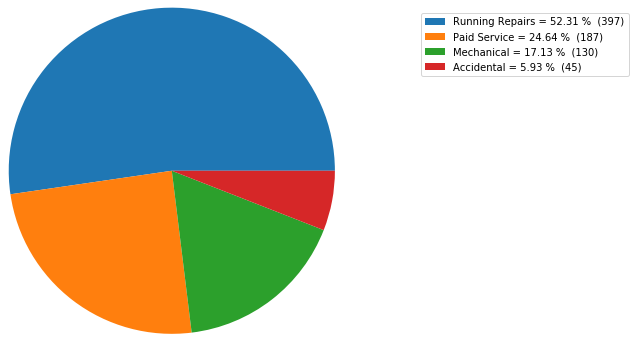

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2016-Q4


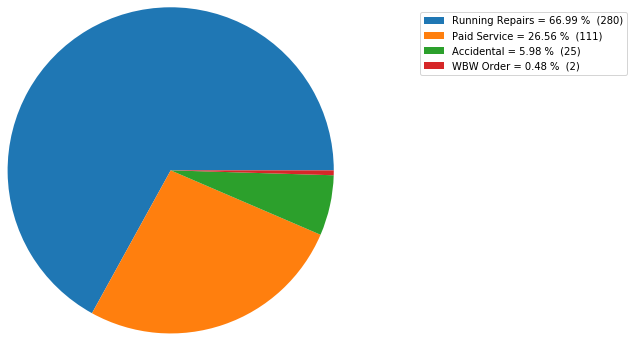

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2016-Q1


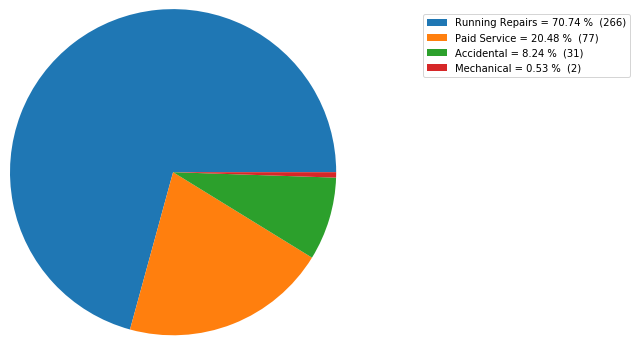

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2015-Q4


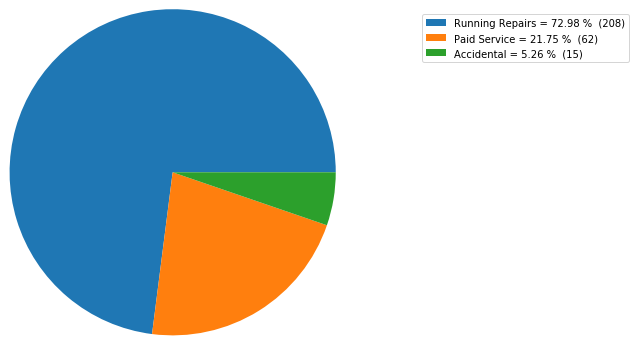

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2015-Q3


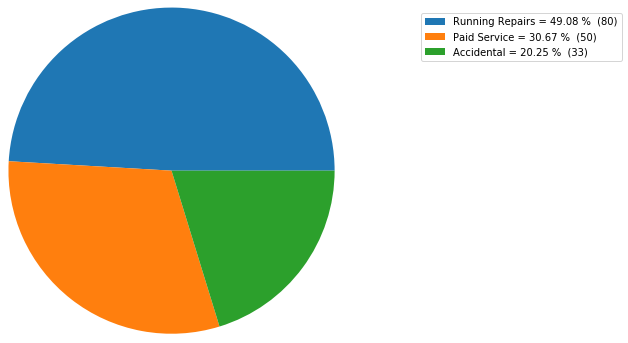

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2015-Q2


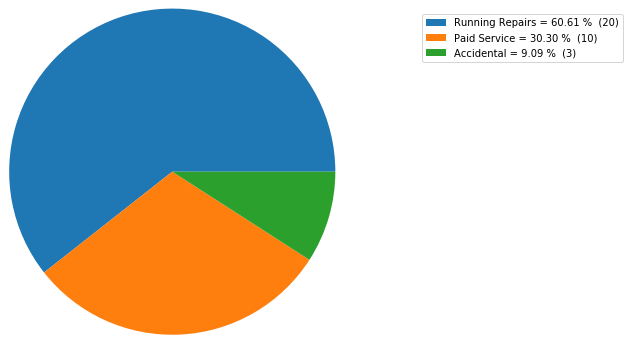

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2014-Q4


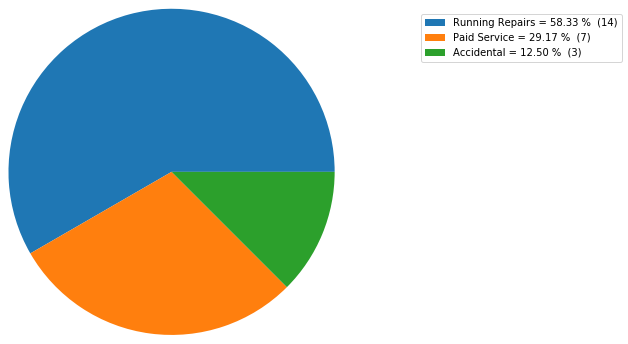

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2015-Q1


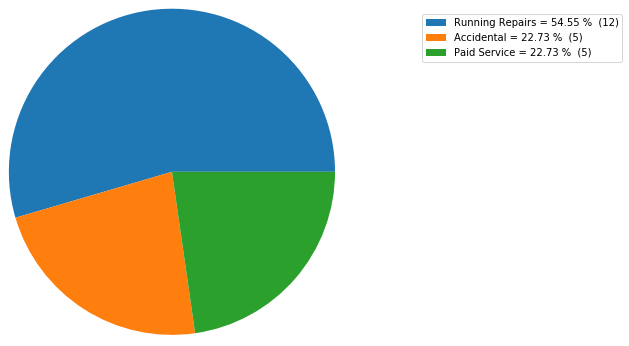

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2014-Q1


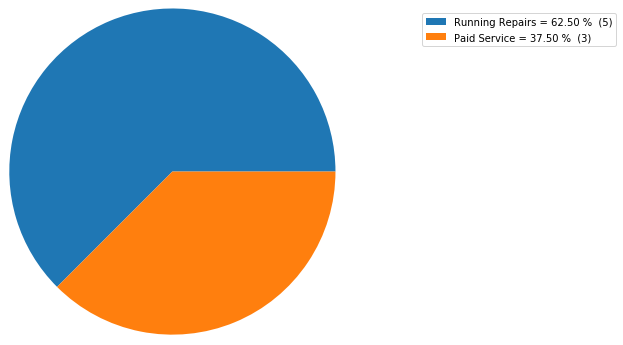

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2014-Q3


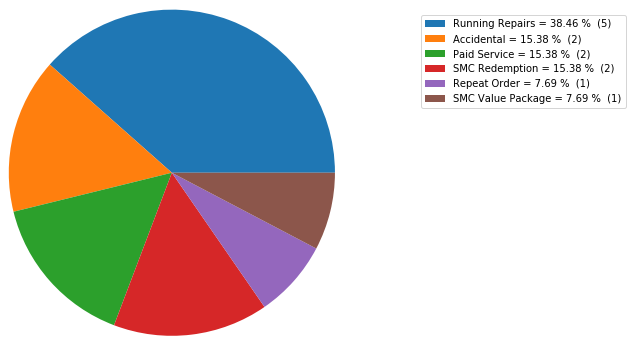

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2013-Q4


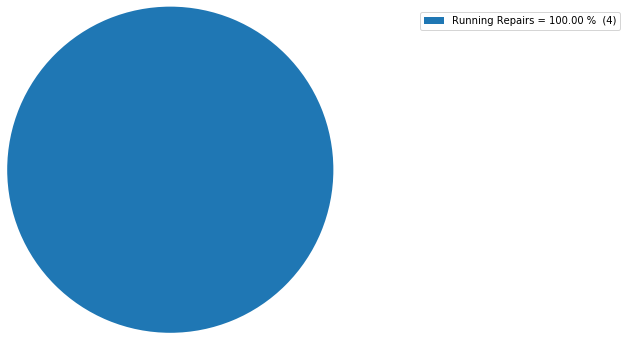

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2014-Q2


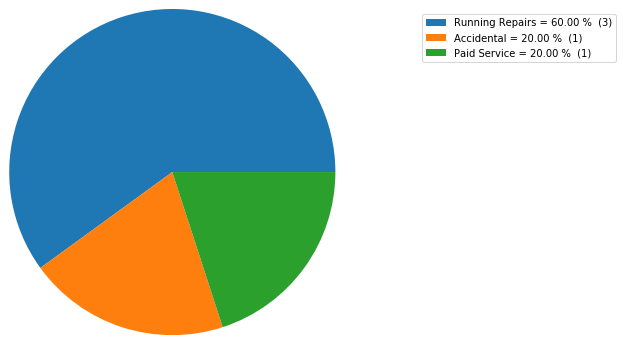

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2013-Q3


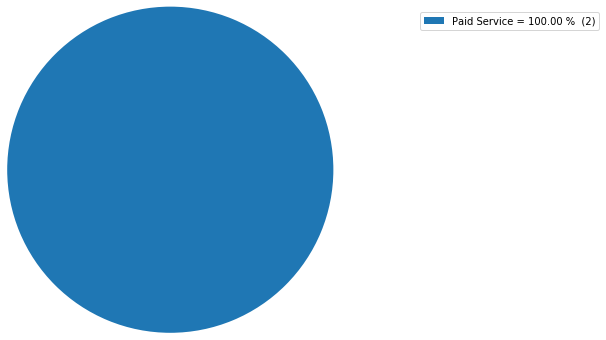

Countwise Distribution of Order Type for the State of Himachal Pradesh and for the season 2012-Q2


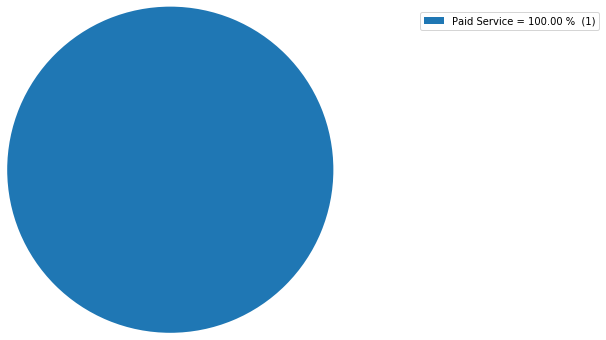

Countwise Distribution of Order Type for the State of West Bengal and for the season 2016-Q3


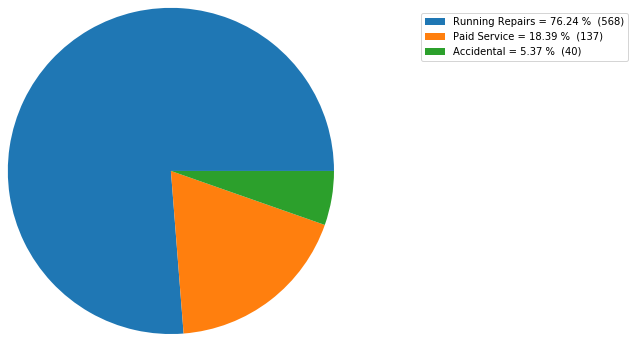

Countwise Distribution of Order Type for the State of West Bengal and for the season 2016-Q4


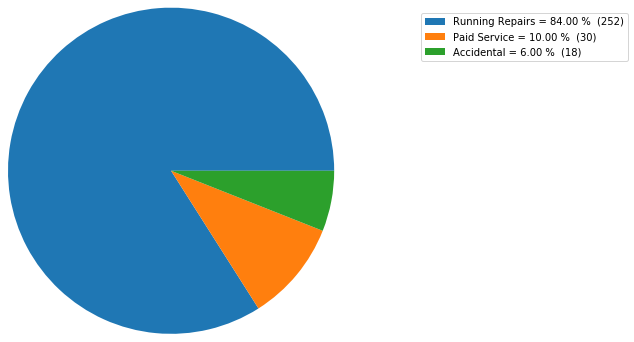

Countwise Distribution of Order Type for the State of West Bengal and for the season 2016-Q2


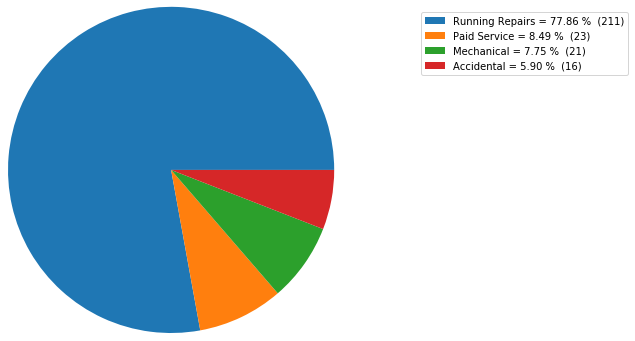

Countwise Distribution of Order Type for the State of West Bengal and for the season 2016-Q1


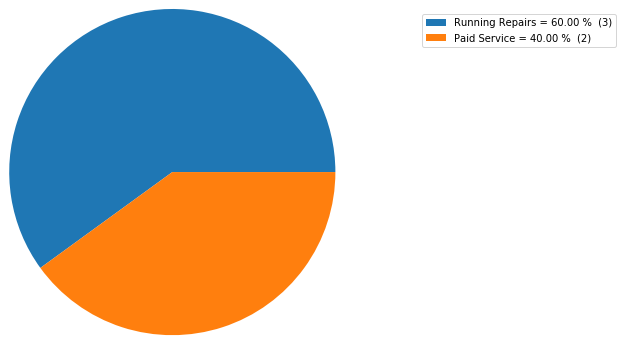

Countwise Distribution of Order Type for the State of West Bengal and for the season 2015-Q4


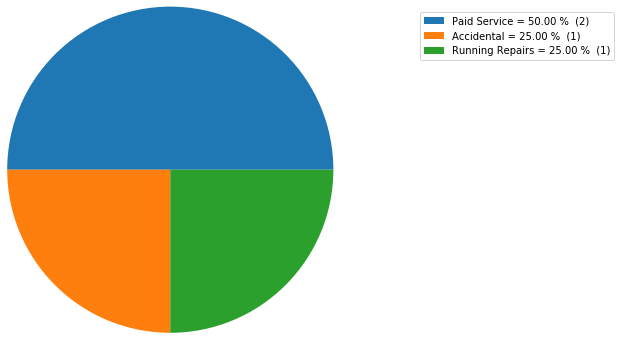

Countwise Distribution of Order Type for the State of West Bengal and for the season 2014-Q2


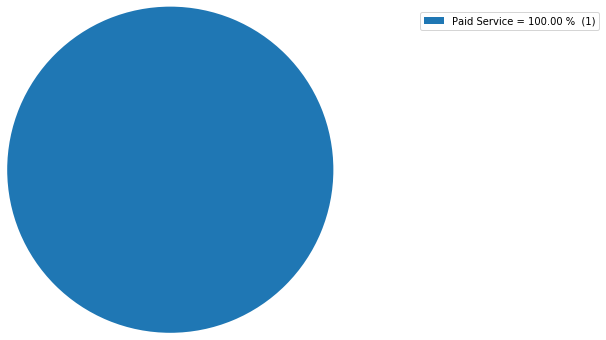

Countwise Distribution of Order Type for the State of West Bengal and for the season 2014-Q3


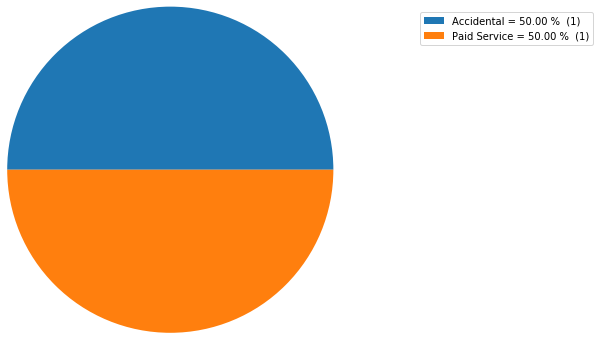

Countwise Distribution of Order Type for the State of West Bengal and for the season 2014-Q4


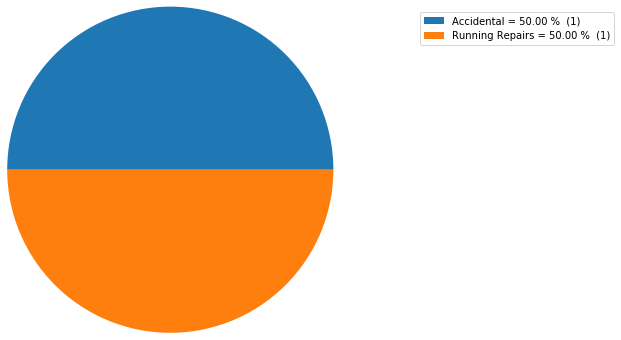

Countwise Distribution of Order Type for the State of West Bengal and for the season 2015-Q2


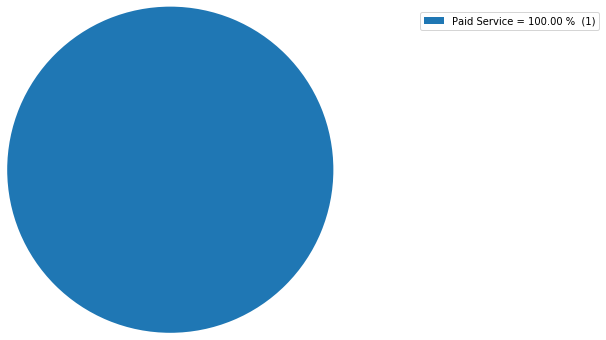

Countwise Distribution of Order Type for the State of West Bengal and for the season 2015-Q3


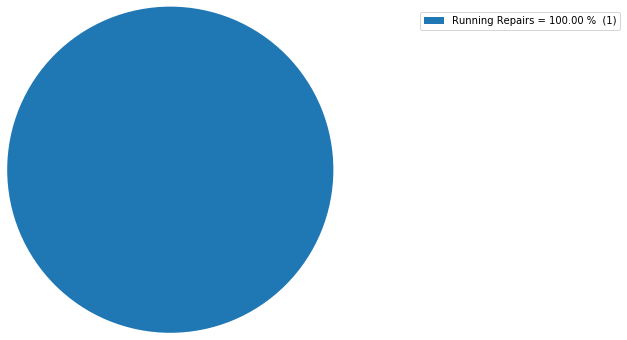

Countwise Distribution of Order Type for the State of Delhi and for the season 2014-Q1


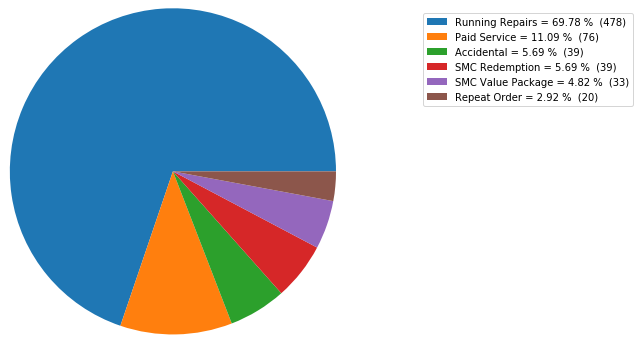

Countwise Distribution of Order Type for the State of Delhi and for the season 2014-Q2


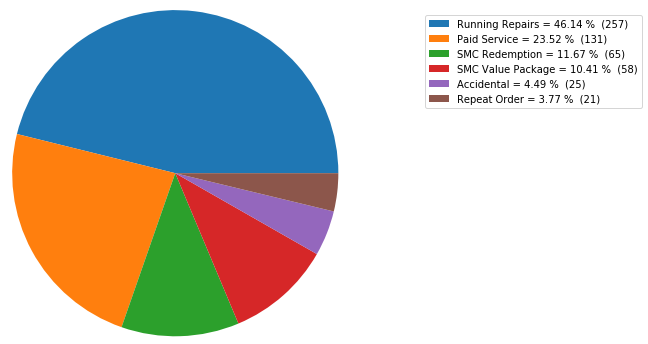

Countwise Distribution of Order Type for the State of Delhi and for the season 2013-Q4


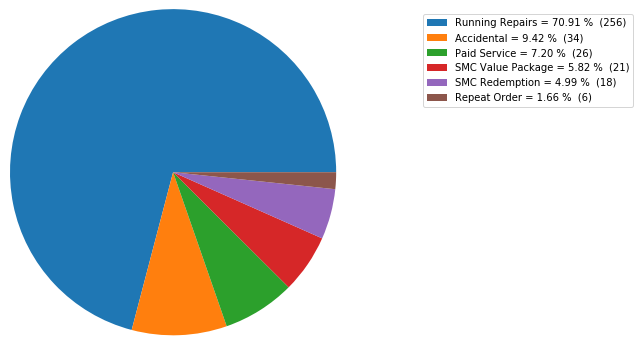

Countwise Distribution of Order Type for the State of Delhi and for the season 2014-Q3


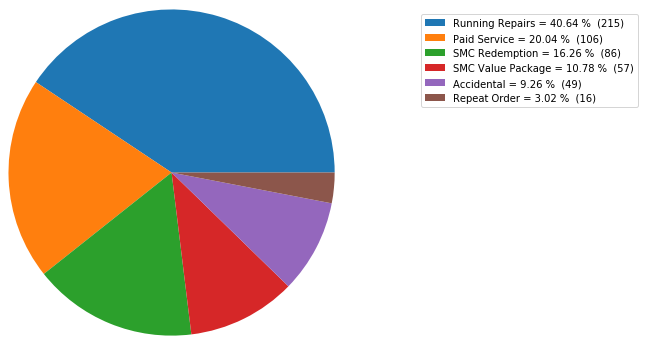

Countwise Distribution of Order Type for the State of Delhi and for the season 2015-Q2


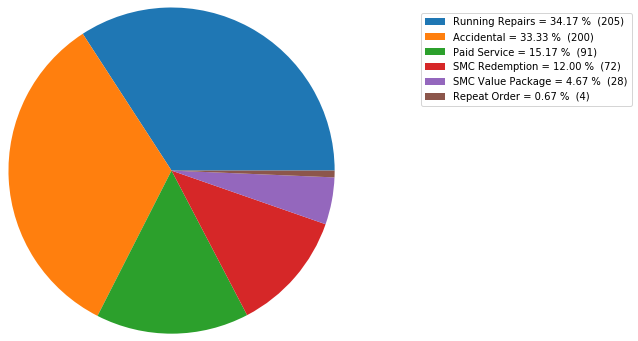

Countwise Distribution of Order Type for the State of Delhi and for the season 2015-Q4


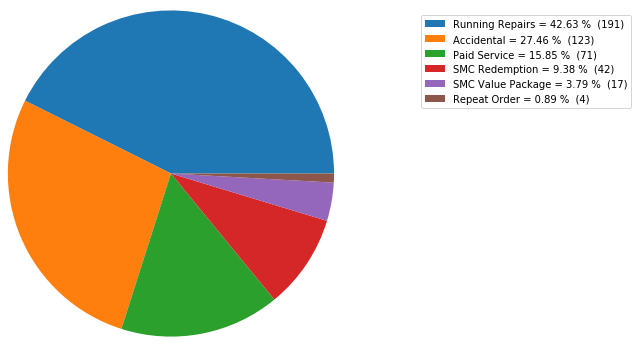

Countwise Distribution of Order Type for the State of Delhi and for the season 2016-Q1


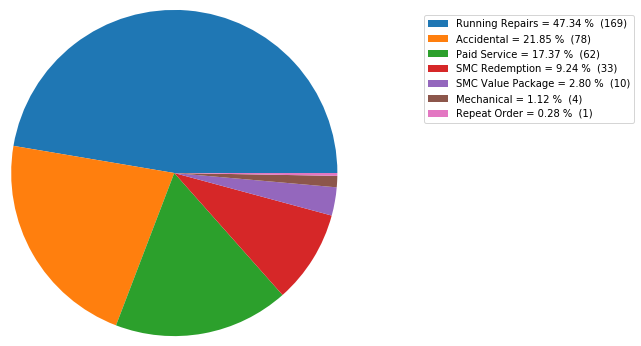

Countwise Distribution of Order Type for the State of Delhi and for the season 2015-Q1


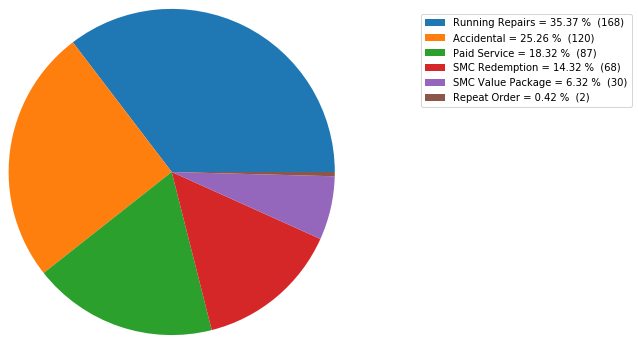

Countwise Distribution of Order Type for the State of Delhi and for the season 2014-Q4


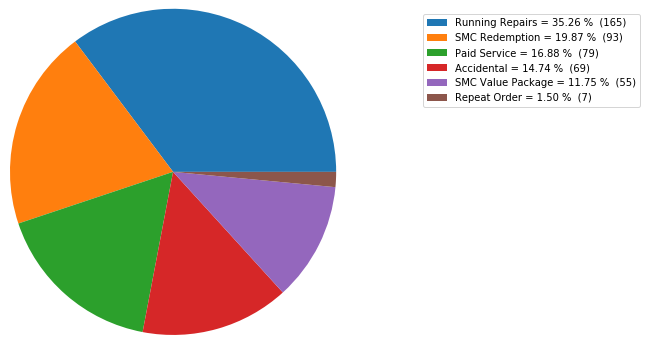

Countwise Distribution of Order Type for the State of Delhi and for the season 2015-Q3


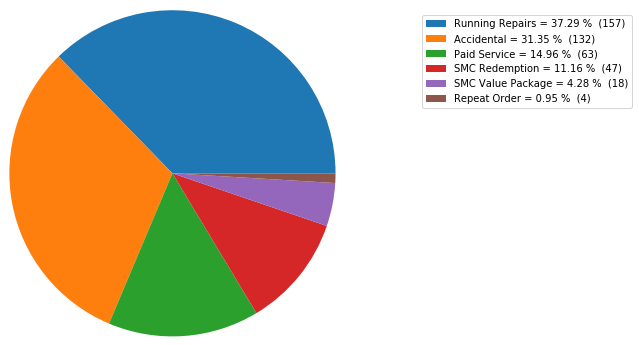

Countwise Distribution of Order Type for the State of Delhi and for the season 2016-Q3


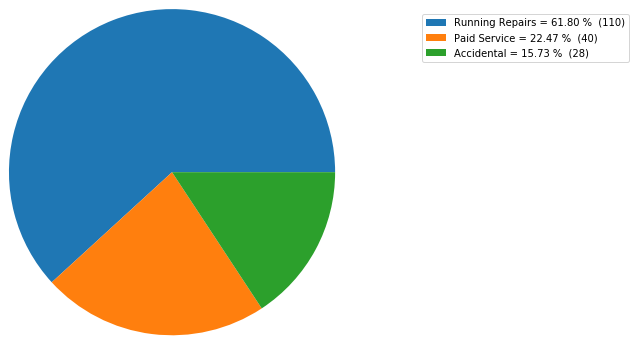

Countwise Distribution of Order Type for the State of Delhi and for the season 2016-Q2


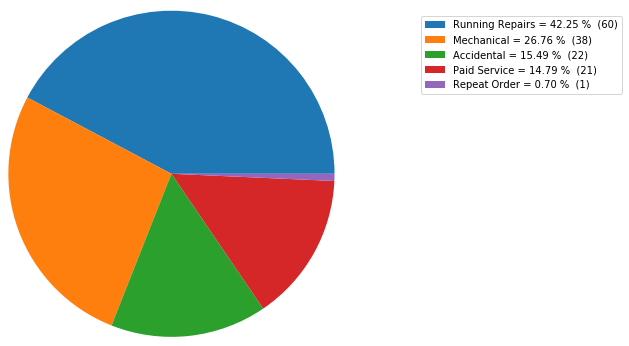

Countwise Distribution of Order Type for the State of Delhi and for the season 2013-Q3


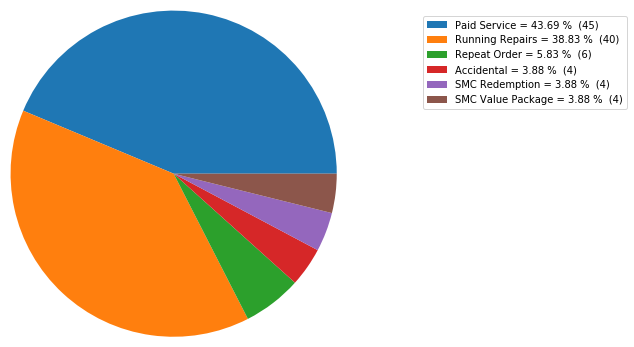

Countwise Distribution of Order Type for the State of Delhi and for the season 2016-Q4


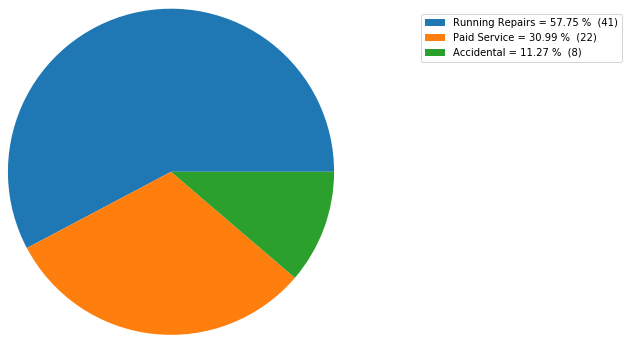

Countwise Distribution of Order Type for the State of Delhi and for the season 2012-Q4


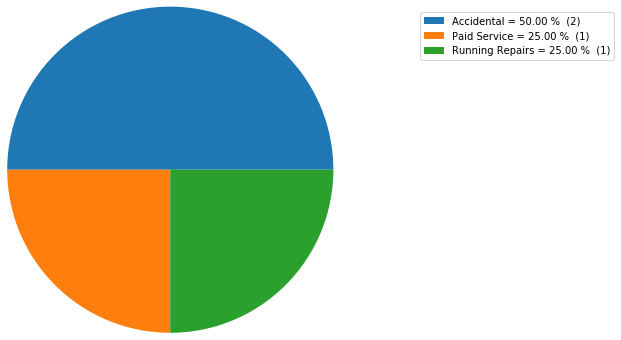

Countwise Distribution of Order Type for the State of Delhi and for the season 2012-Q2


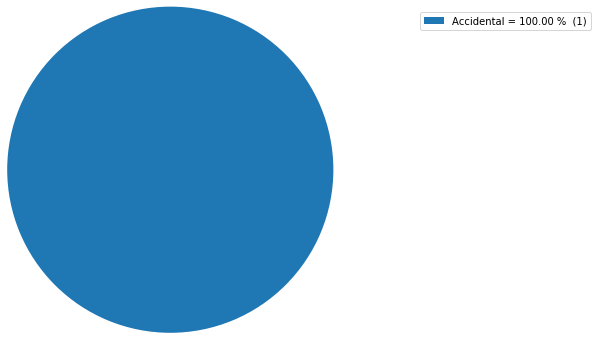

Countwise Distribution of Order Type for the State of Delhi and for the season 2012-Q3


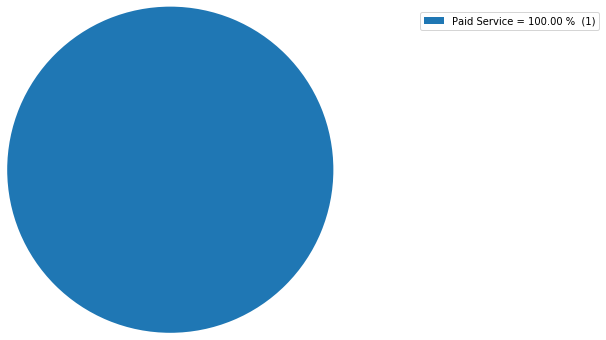

Countwise Distribution of Order Type for the State of Delhi and for the season 2013-Q1


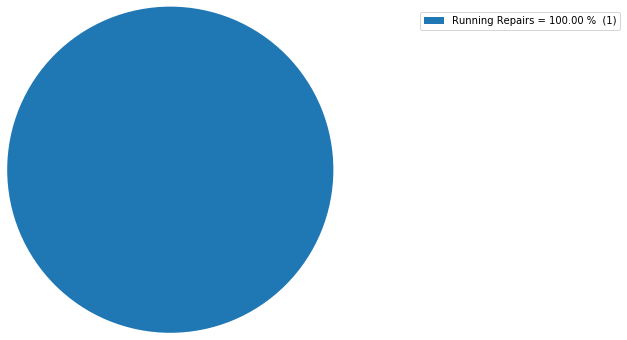

Countwise Distribution of Order Type for the State of Kerala and for the season 2016-Q2


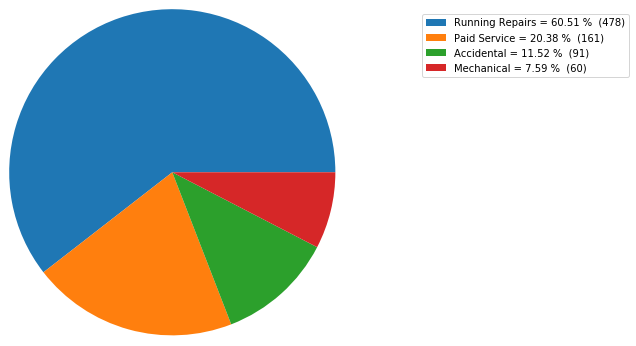

Countwise Distribution of Order Type for the State of Kerala and for the season 2013-Q4


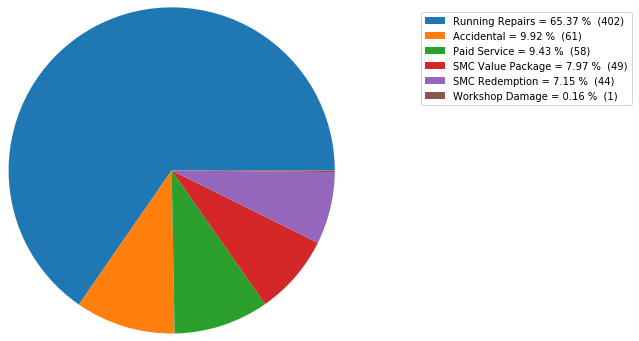

Countwise Distribution of Order Type for the State of Kerala and for the season 2014-Q2


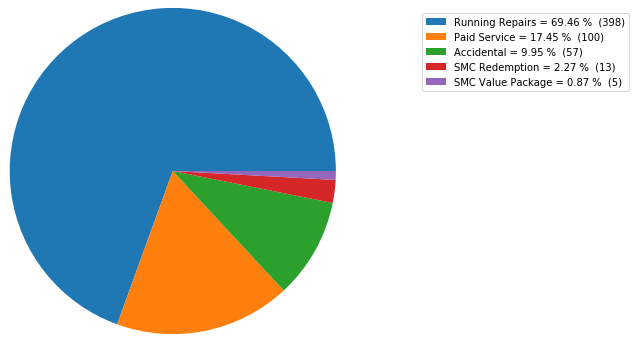

Countwise Distribution of Order Type for the State of Kerala and for the season 2014-Q3


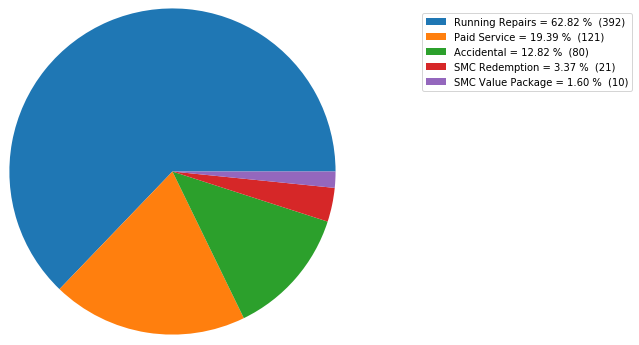

Countwise Distribution of Order Type for the State of Kerala and for the season 2016-Q3


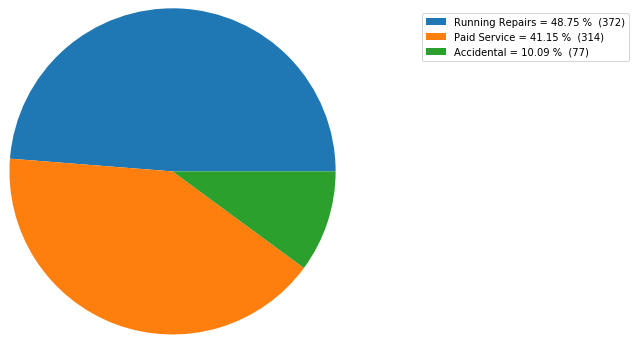

Countwise Distribution of Order Type for the State of Kerala and for the season 2014-Q1


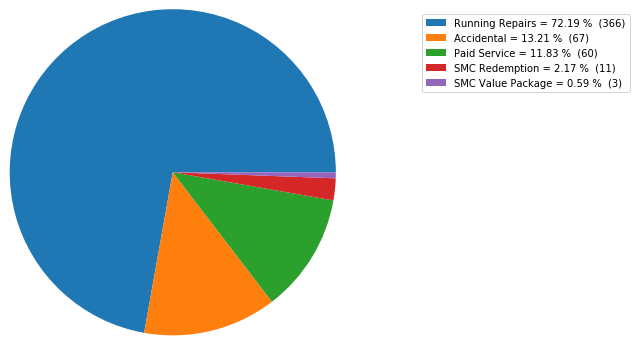

Countwise Distribution of Order Type for the State of Kerala and for the season 2014-Q4


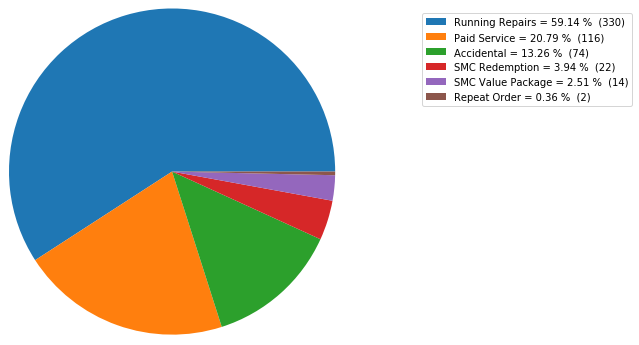

Countwise Distribution of Order Type for the State of Kerala and for the season 2015-Q1


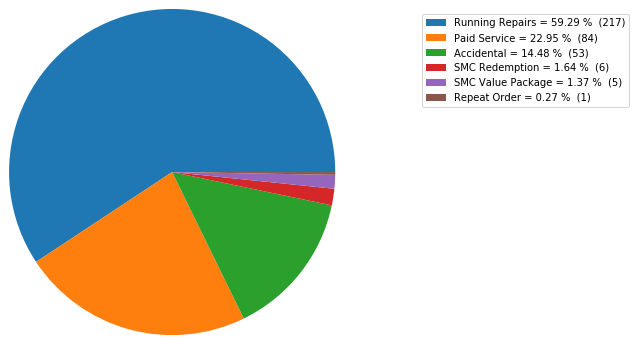

Countwise Distribution of Order Type for the State of Kerala and for the season 2016-Q4


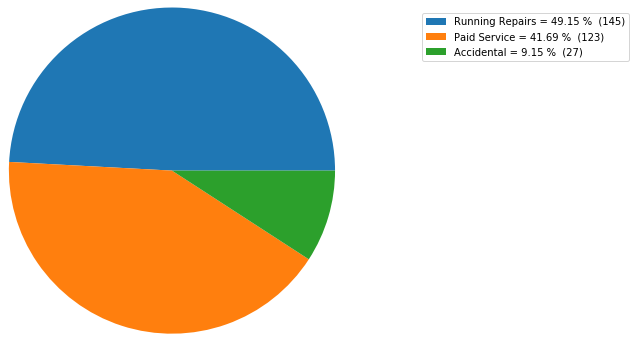

Countwise Distribution of Order Type for the State of Kerala and for the season 2015-Q4


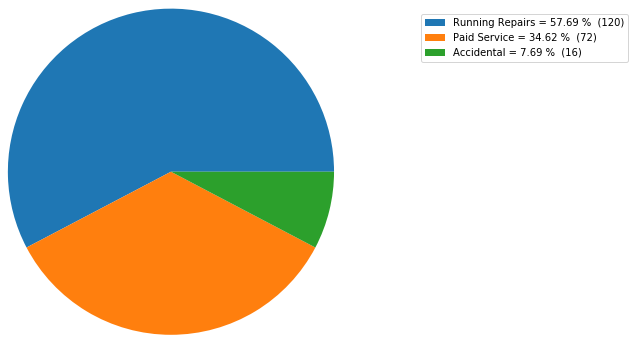

Countwise Distribution of Order Type for the State of Kerala and for the season 2016-Q1


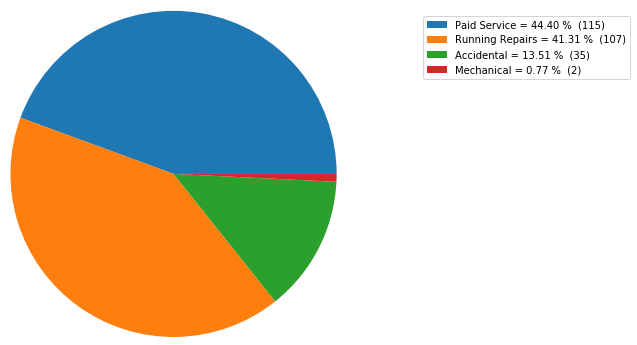

Countwise Distribution of Order Type for the State of Kerala and for the season 2015-Q3


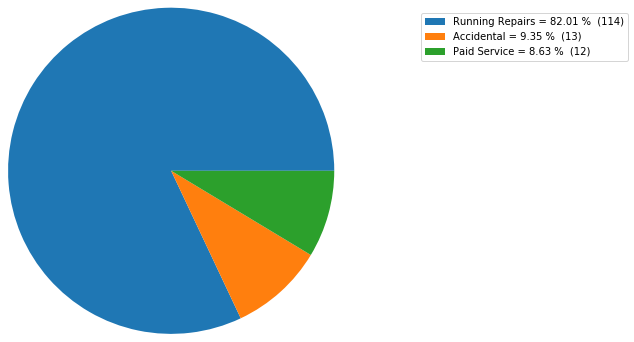

Countwise Distribution of Order Type for the State of Kerala and for the season 2013-Q3


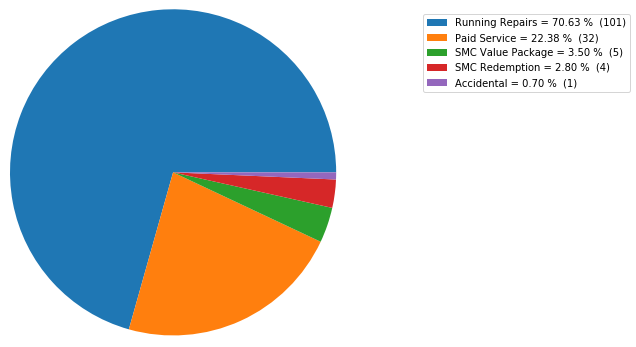

Countwise Distribution of Order Type for the State of Kerala and for the season 2015-Q2


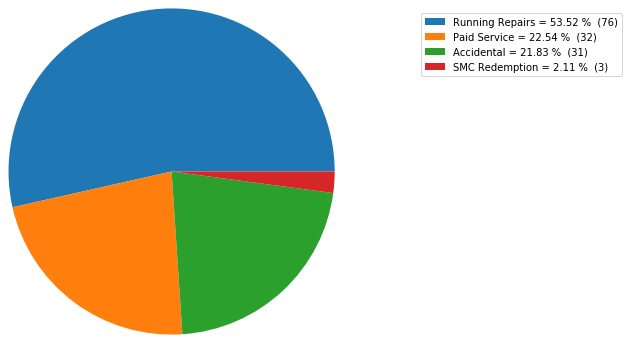

Countwise Distribution of Order Type for the State of Kerala and for the season 2012-Q2


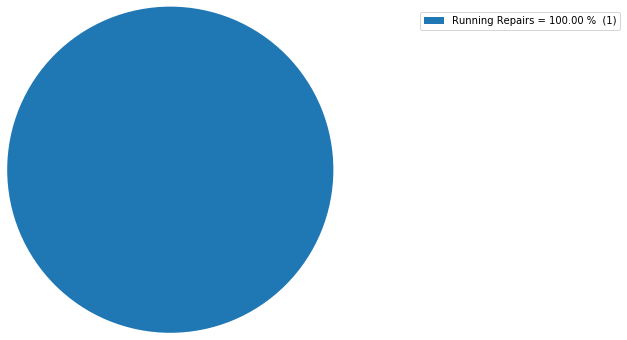

Countwise Distribution of Order Type for the State of Kerala and for the season 2012-Q3


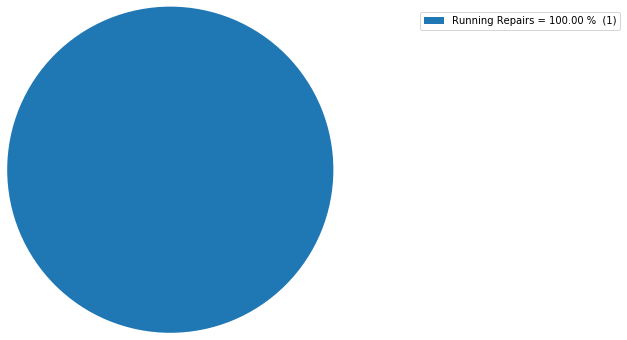

Countwise Distribution of Order Type for the State of Kerala and for the season 2013-Q1


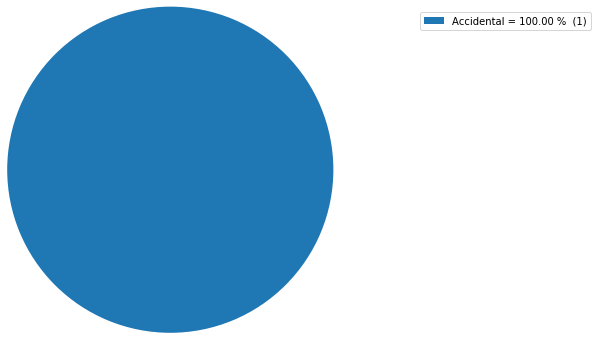

Countwise Distribution of Order Type for the State of Kerala and for the season 2013-Q2


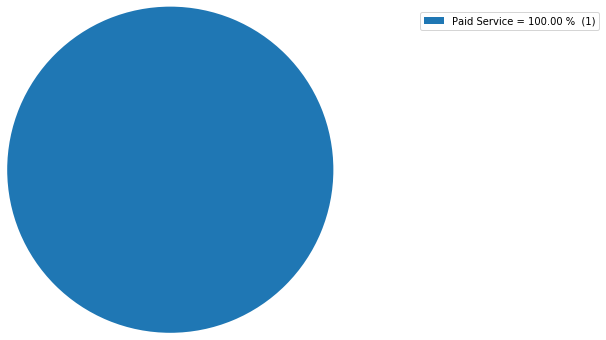

Countwise Distribution of Order Type for the State of Puducherry and for the season 2016-Q1


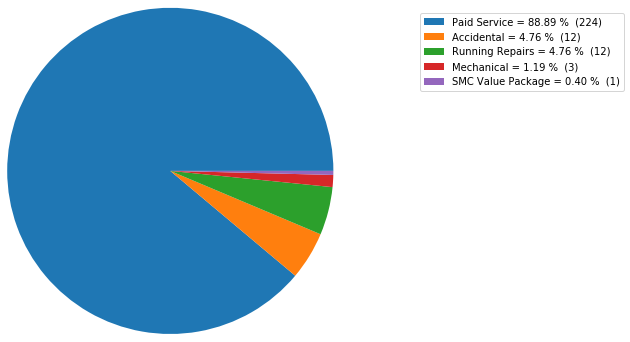

Countwise Distribution of Order Type for the State of Puducherry and for the season 2015-Q4


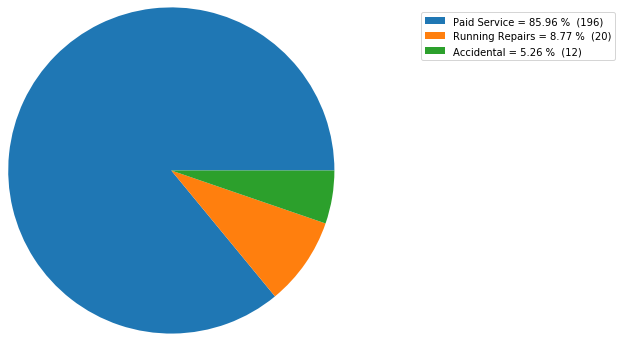

Countwise Distribution of Order Type for the State of Puducherry and for the season 2015-Q3


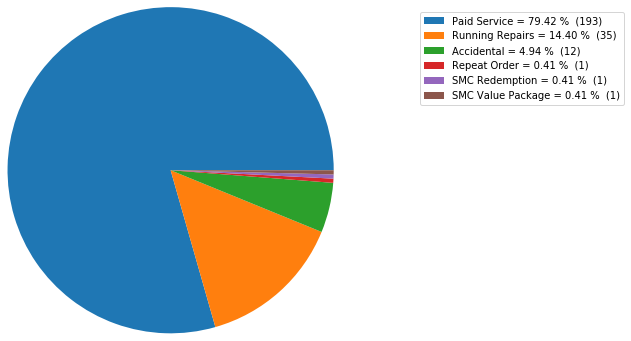

Countwise Distribution of Order Type for the State of Puducherry and for the season 2016-Q3


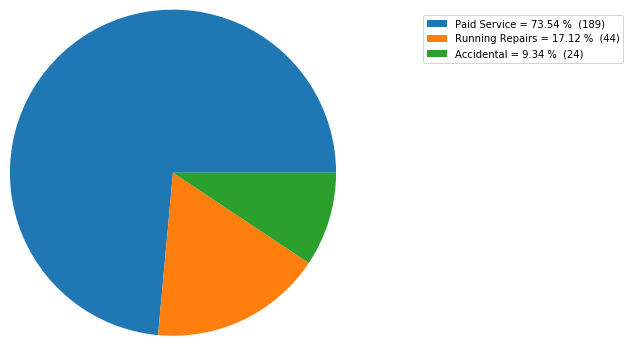

Countwise Distribution of Order Type for the State of Puducherry and for the season 2016-Q2


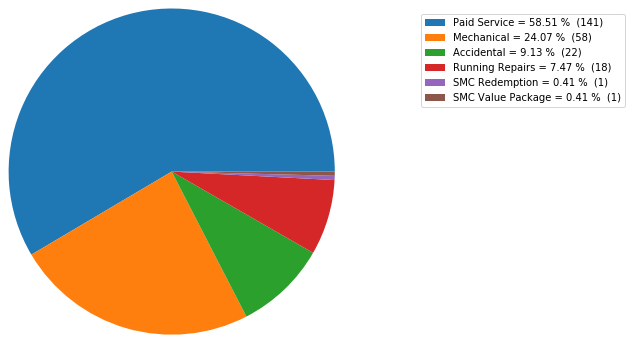

Countwise Distribution of Order Type for the State of Puducherry and for the season 2015-Q1


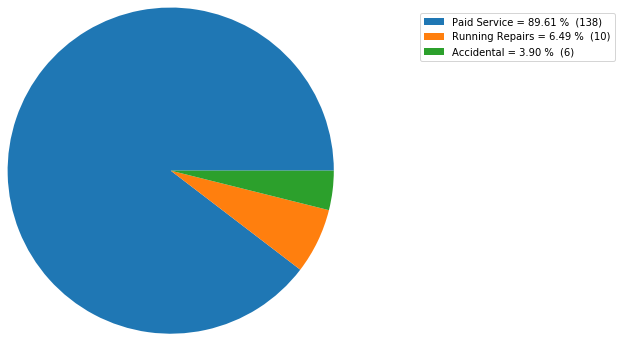

Countwise Distribution of Order Type for the State of Puducherry and for the season 2015-Q2


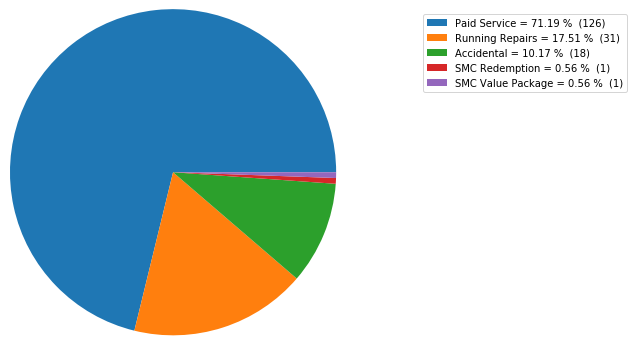

Countwise Distribution of Order Type for the State of Puducherry and for the season 2014-Q4


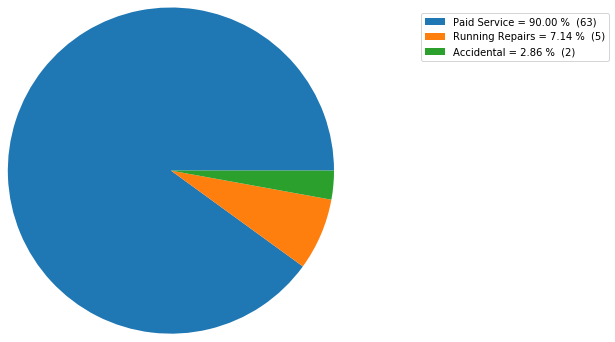

Countwise Distribution of Order Type for the State of Puducherry and for the season 2016-Q4


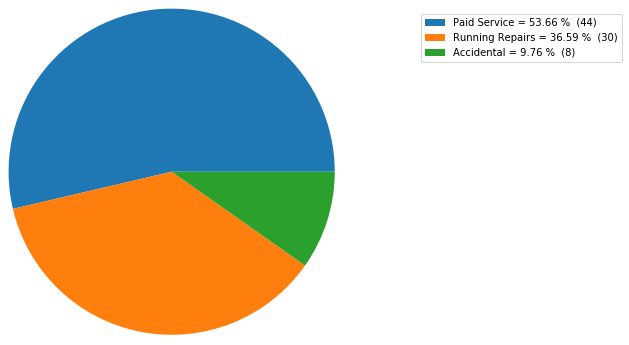

Countwise Distribution of Order Type for the State of Puducherry and for the season 2014-Q1


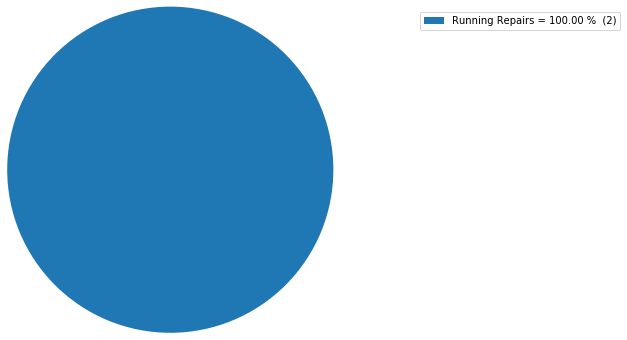

Countwise Distribution of Order Type for the State of Puducherry and for the season 2014-Q3


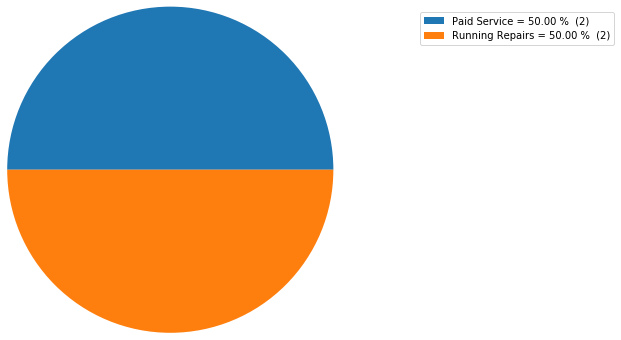

Countwise Distribution of Order Type for the State of Puducherry and for the season 2012-Q3


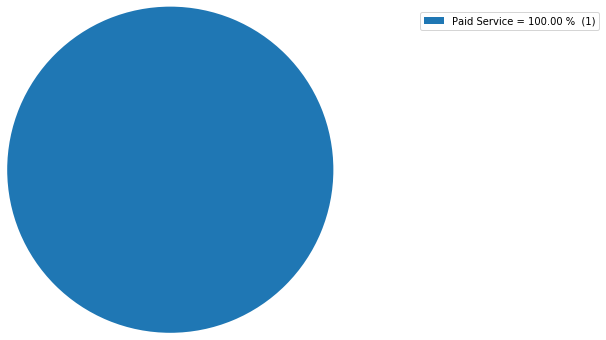

Countwise Distribution of Order Type for the State of Puducherry and for the season 2012-Q4


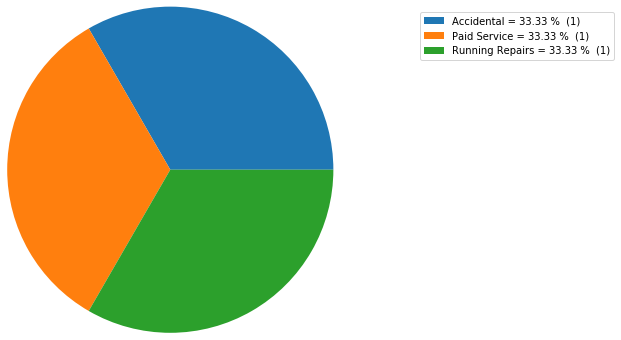

Countwise Distribution of Order Type for the State of Puducherry and for the season 2013-Q2


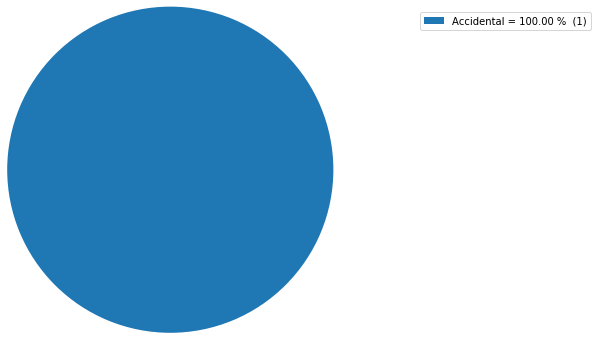

Countwise Distribution of Order Type for the State of Puducherry and for the season 2013-Q4


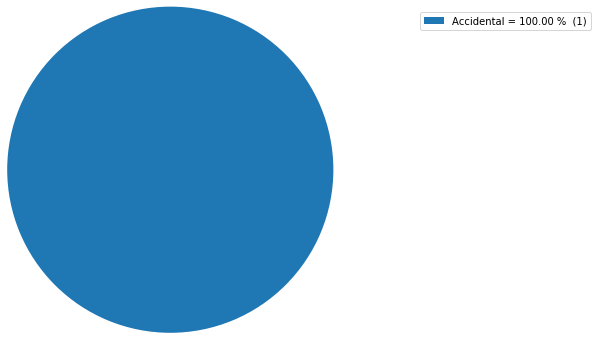

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2016-Q3


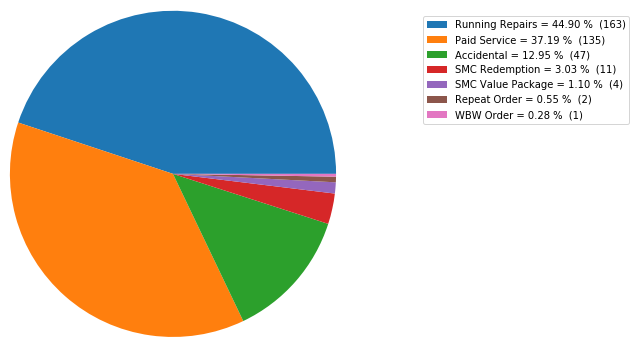

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2016-Q1


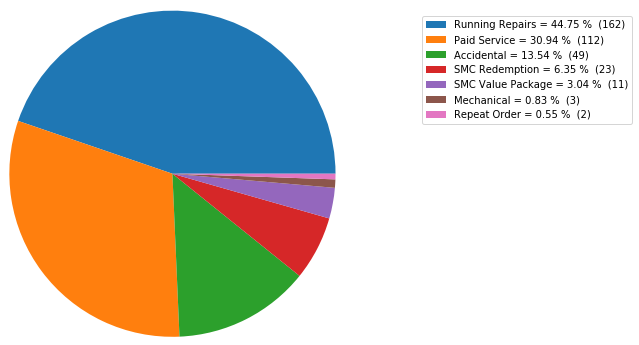

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2015-Q3


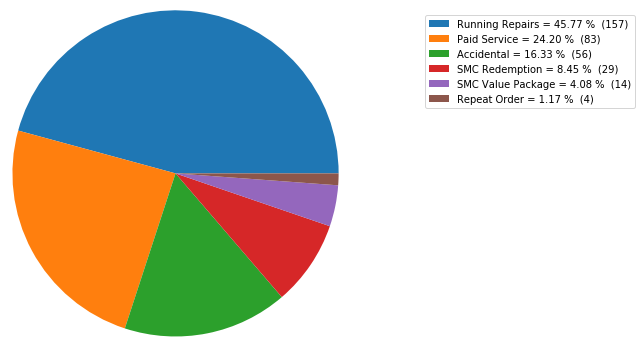

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2014-Q1


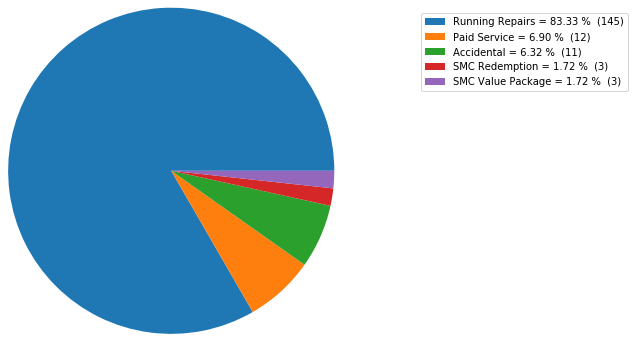

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2015-Q4


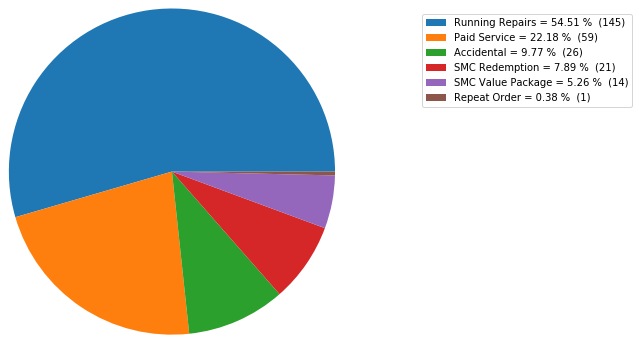

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2015-Q2


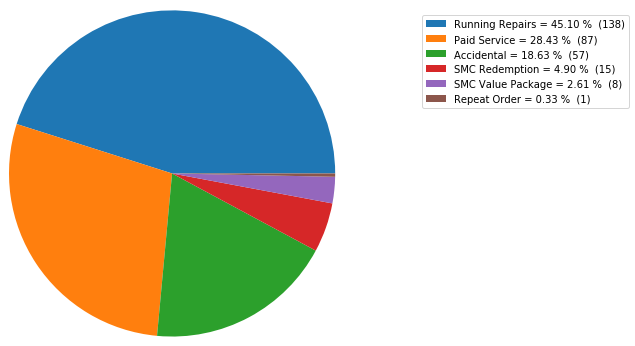

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2016-Q2


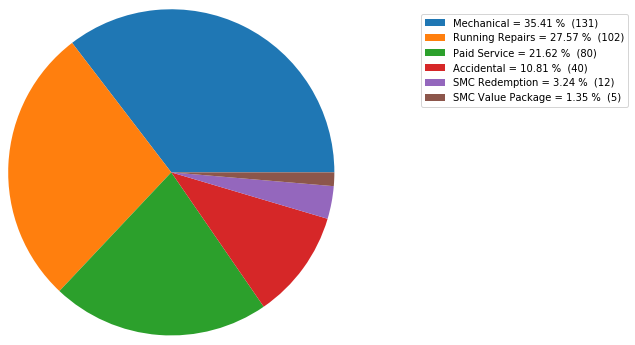

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2015-Q1


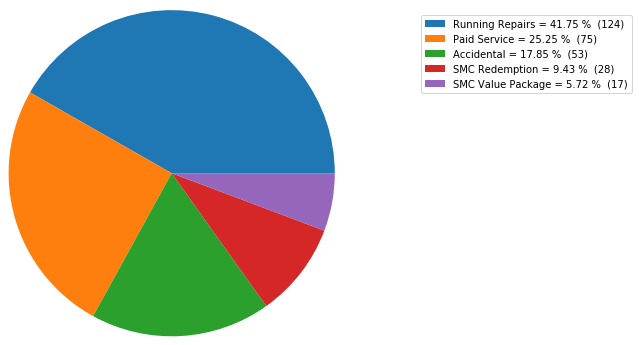

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2014-Q4


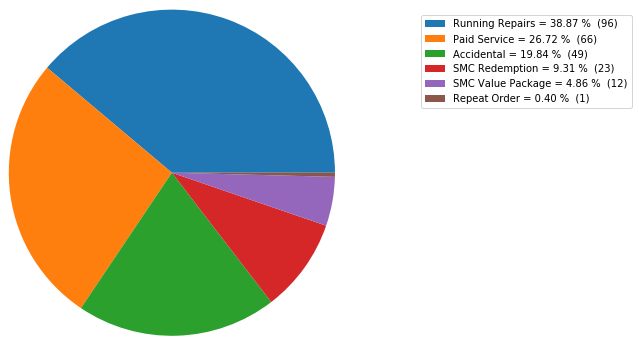

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2016-Q4


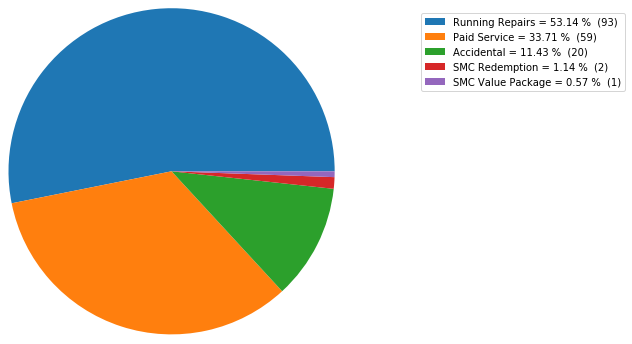

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2014-Q2


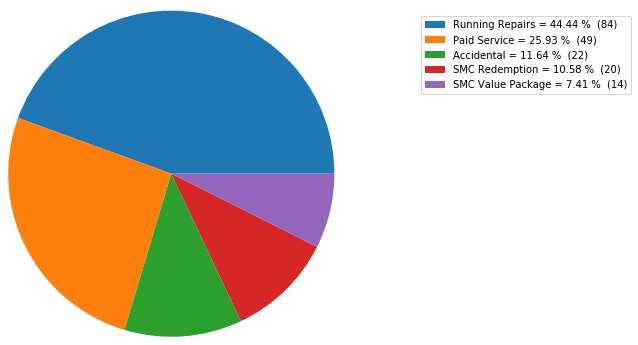

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2014-Q3


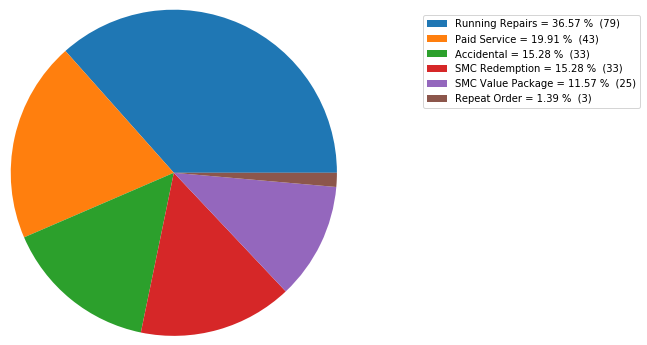

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2013-Q4


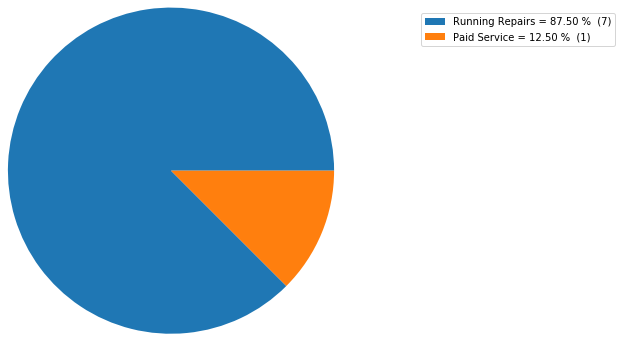

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2012-Q2


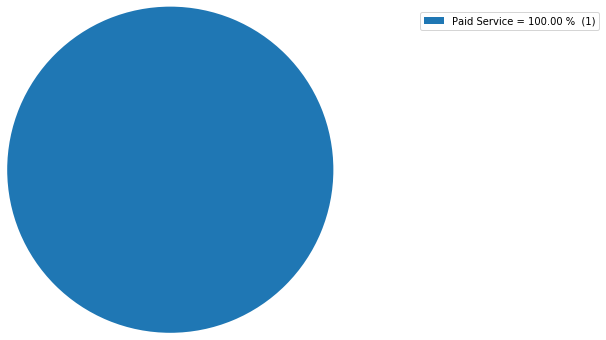

Countwise Distribution of Order Type for the State of Chandigarh and for the season 2013-Q3


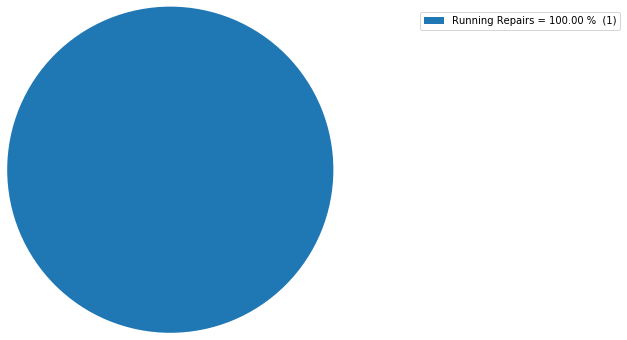

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2016-Q4


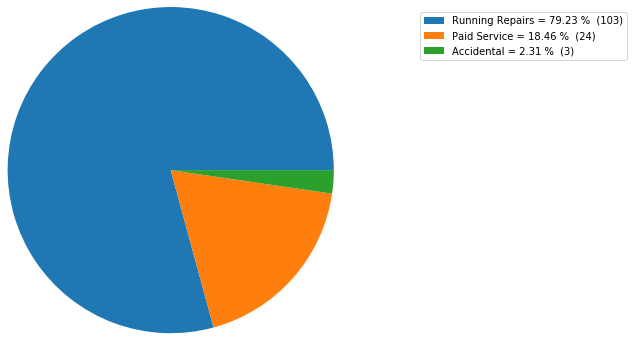

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2016-Q3


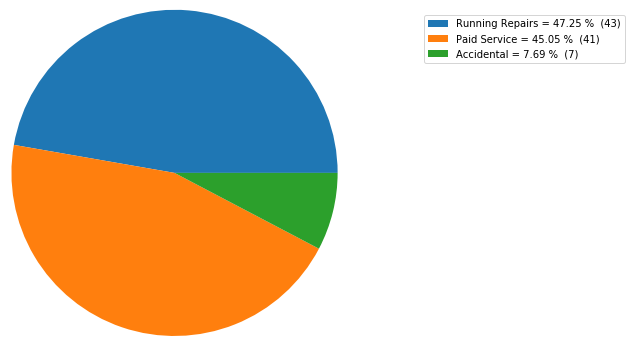

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2016-Q2


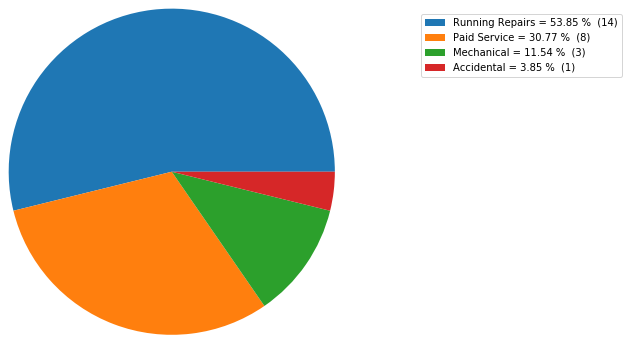

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2015-Q2


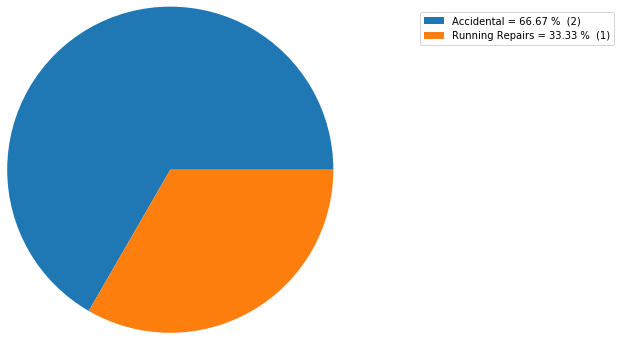

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2015-Q3


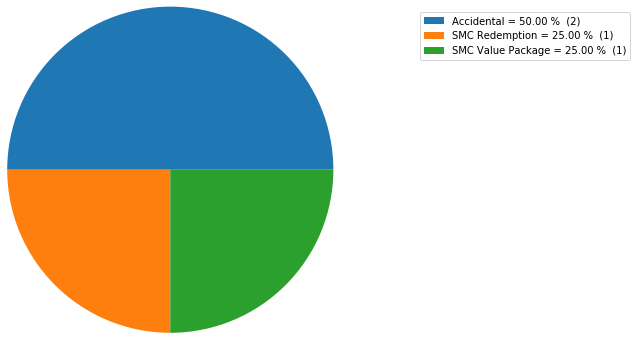

Countwise Distribution of Order Type for the State of Jharkhand and for the season 2016-Q1


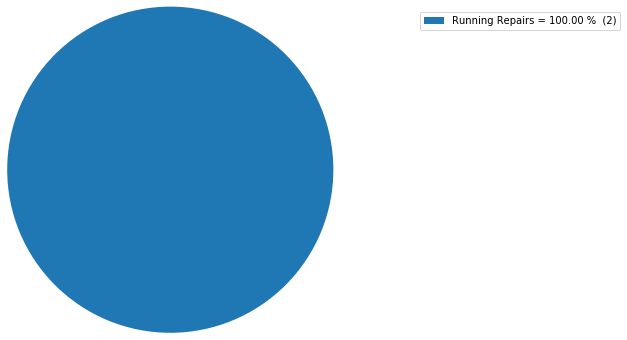

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2016-Q4


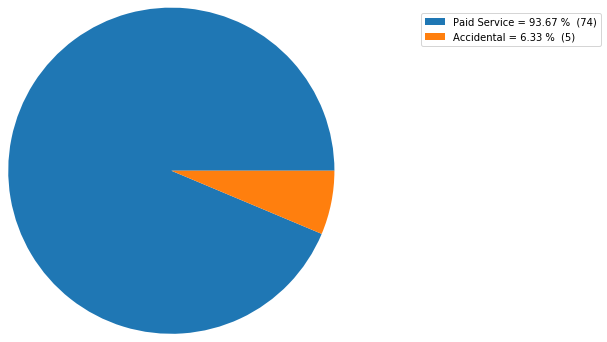

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2016-Q3


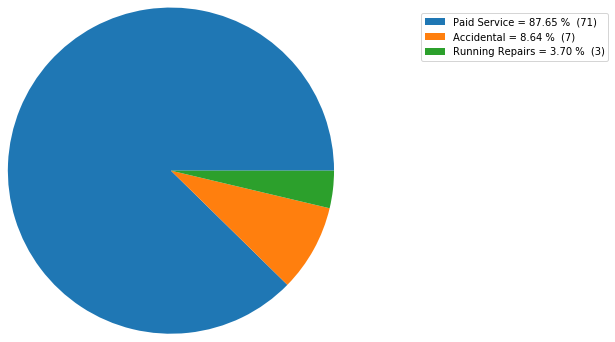

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2015-Q2


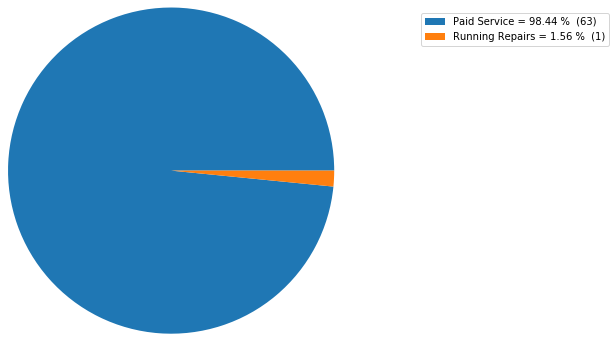

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2015-Q3


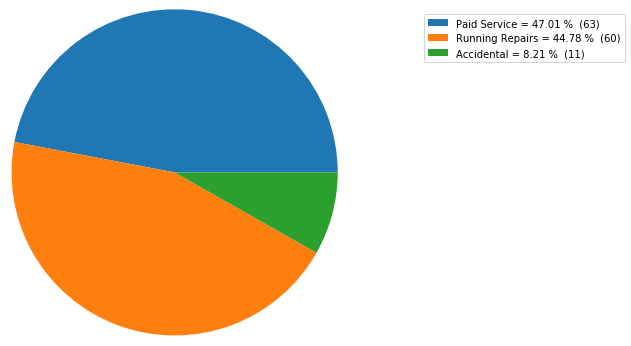

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2015-Q4


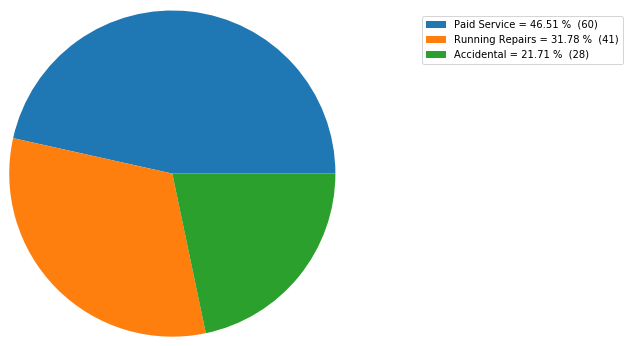

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2016-Q1


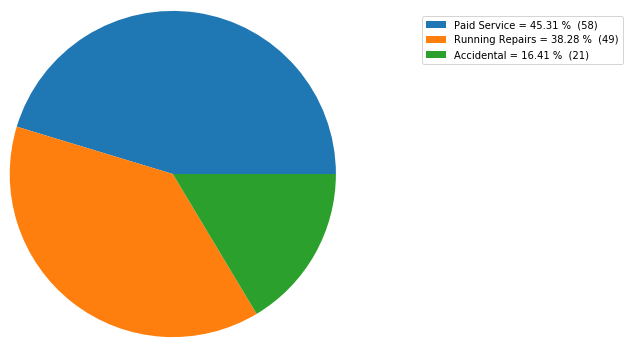

Countwise Distribution of Order Type for the State of Chhattisgarh and for the season 2016-Q2


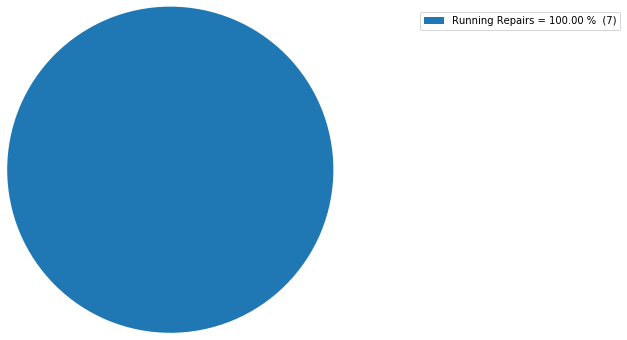

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2014-Q2


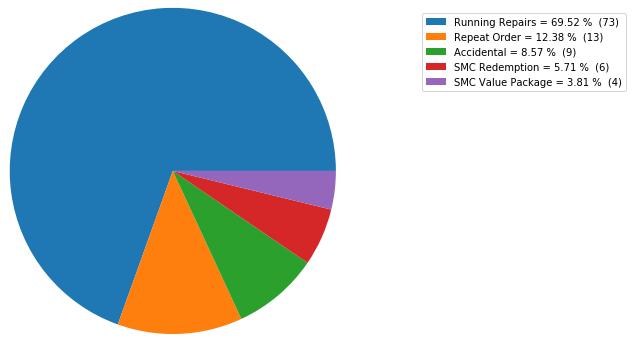

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2014-Q3


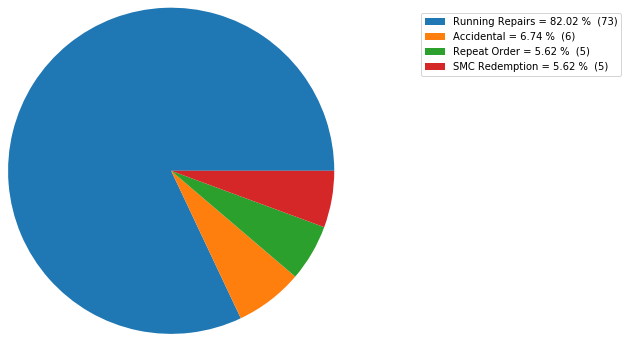

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2015-Q4


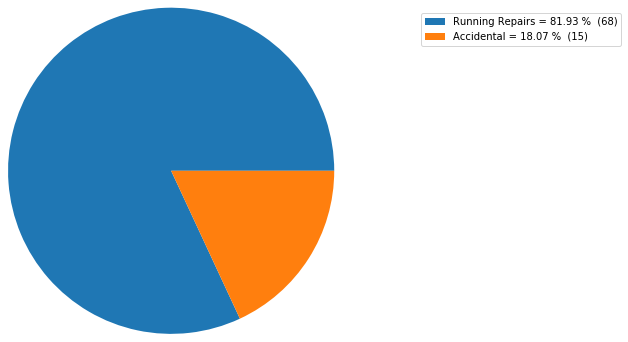

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2014-Q1


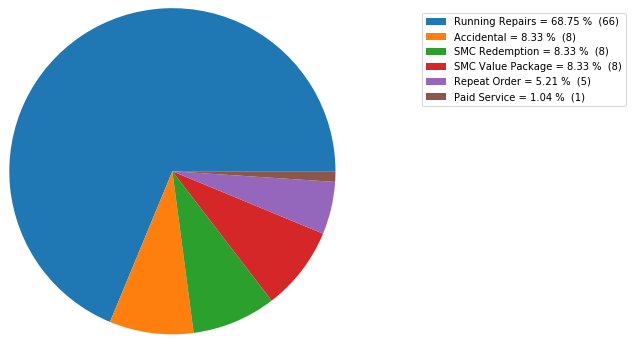

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2014-Q4


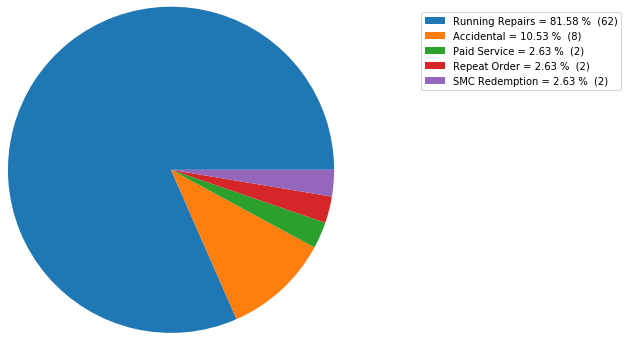

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2015-Q1


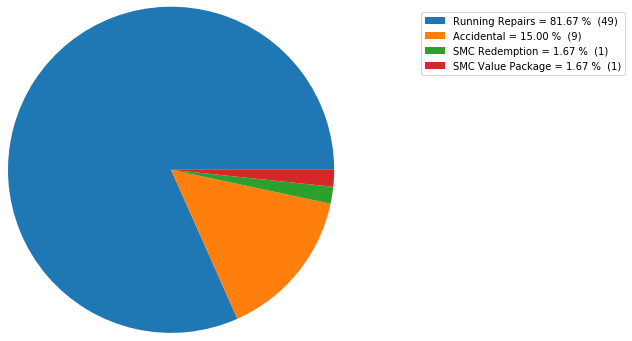

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2013-Q4


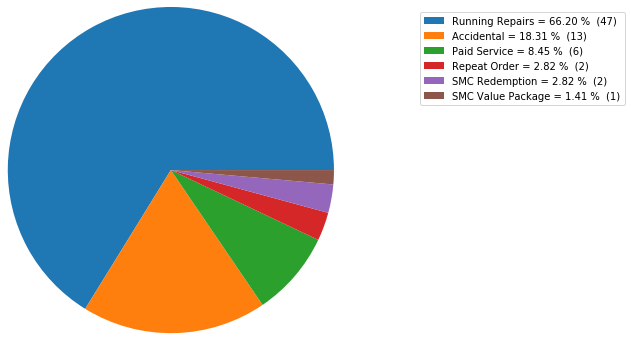

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2015-Q3


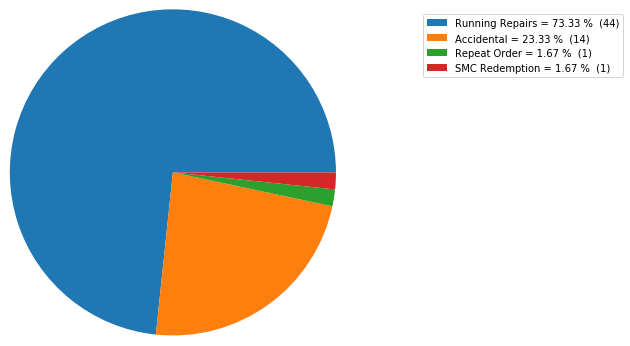

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2016-Q1


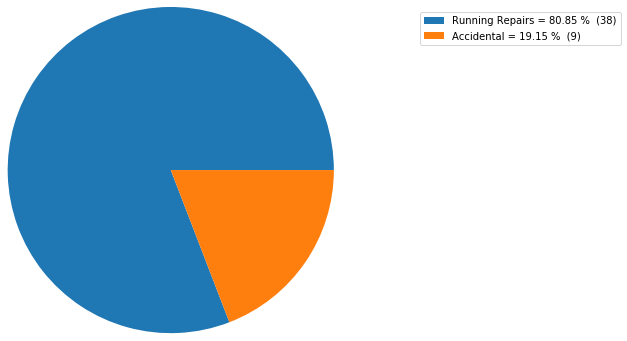

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2015-Q2


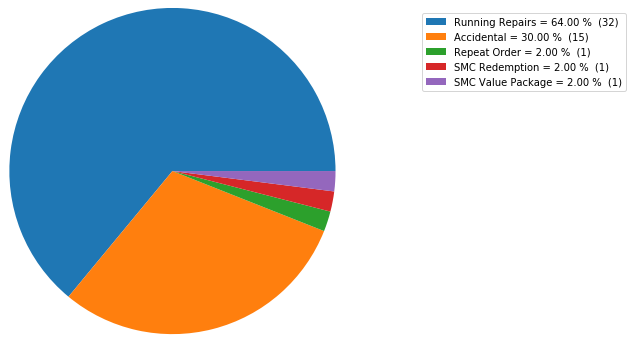

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2013-Q3


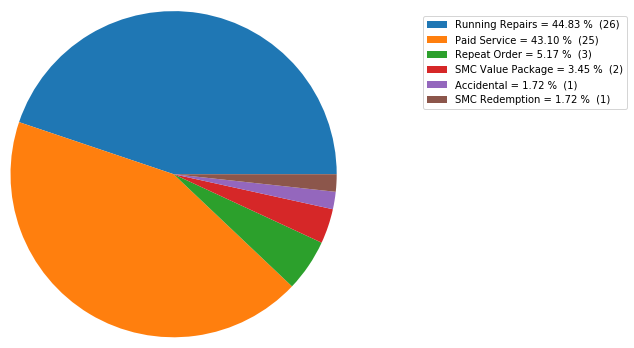

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2013-Q2


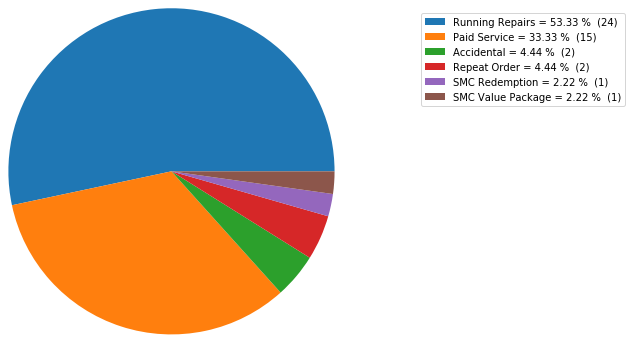

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2016-Q3


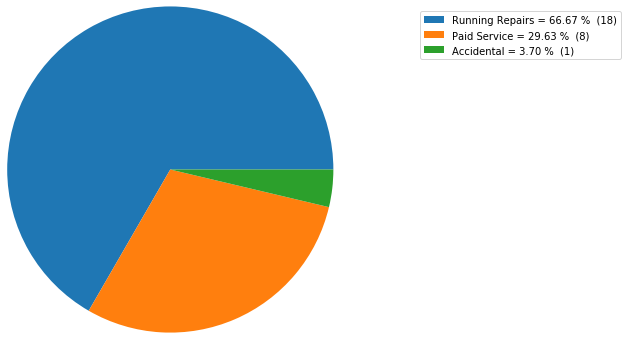

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2012-Q3


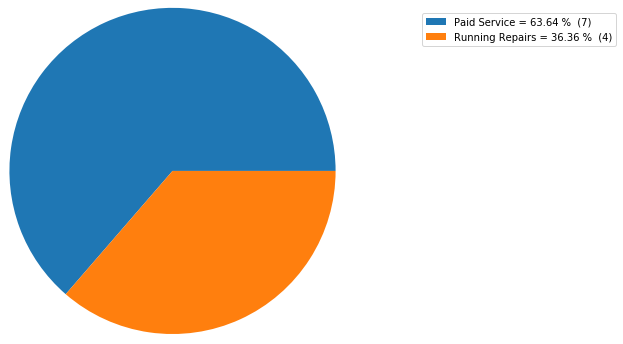

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2013-Q1


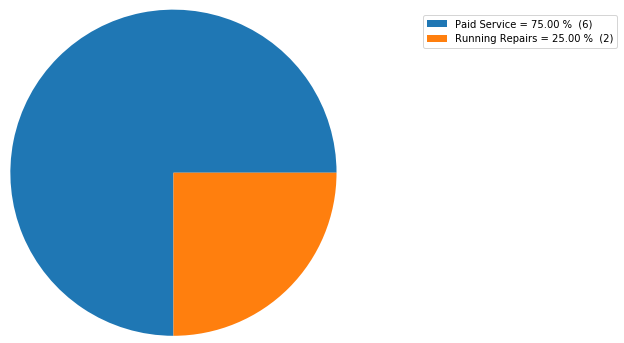

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2016-Q4


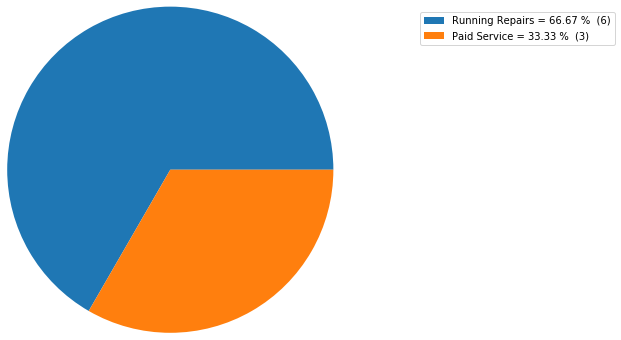

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2012-Q4


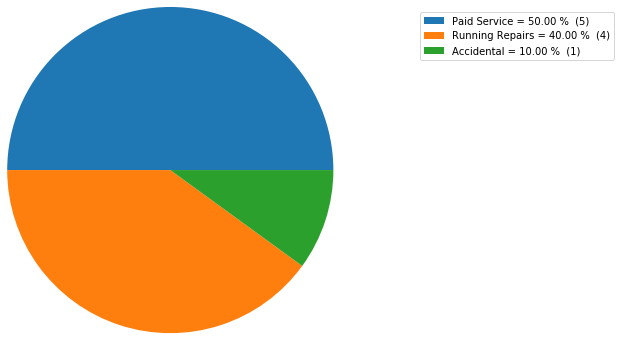

Countwise Distribution of Order Type for the State of Dadra and Nagar Hav. and for the season 2012-Q2


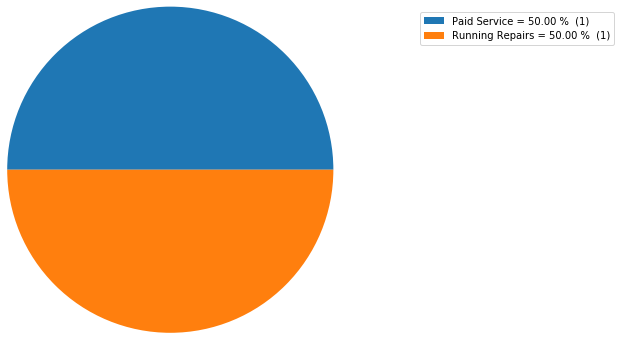

Countwise Distribution of Order Type for the State of Assam and for the season 2016-Q4


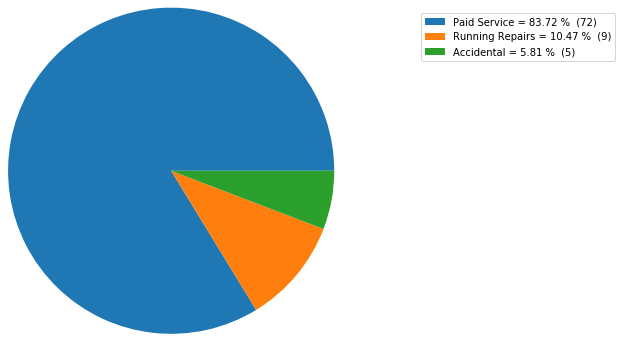

Countwise Distribution of Order Type for the State of Assam and for the season 2016-Q3


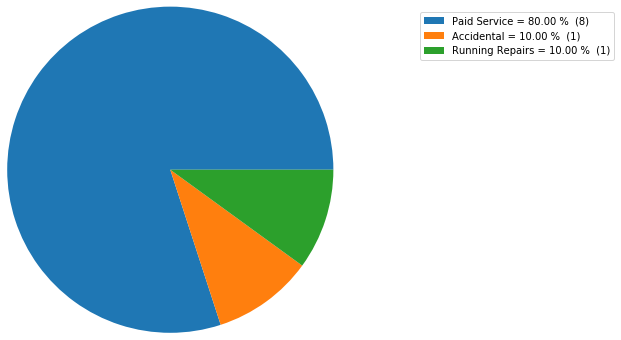

Countwise Distribution of Order Type for the State of Assam and for the season 2016-Q2


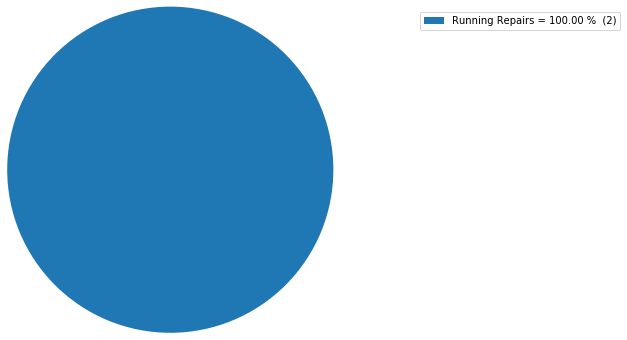

Countwise Distribution of Order Type for the State of Assam and for the season 2013-Q2


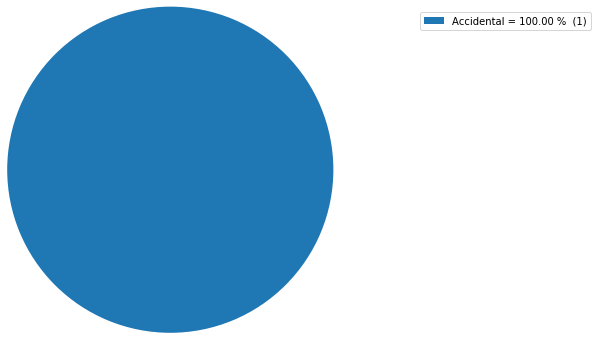

Countwise Distribution of Order Type for the State of Assam and for the season 2013-Q3


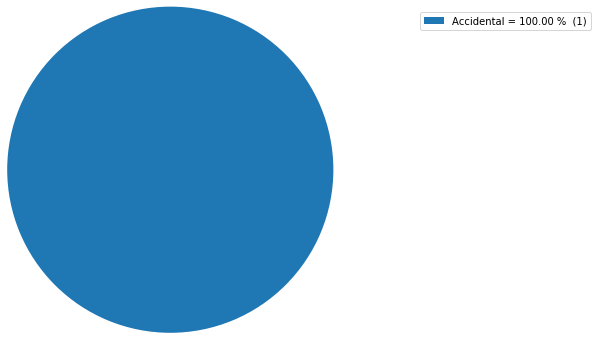

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2015-Q4


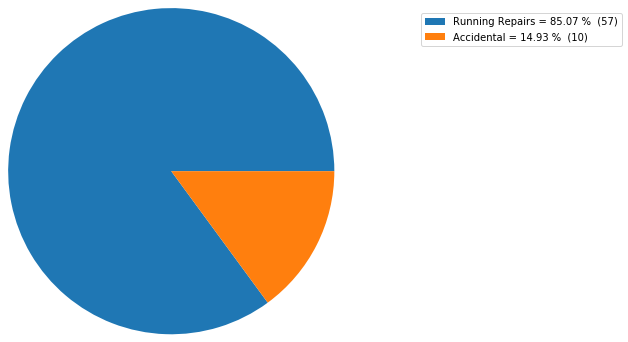

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2014-Q3


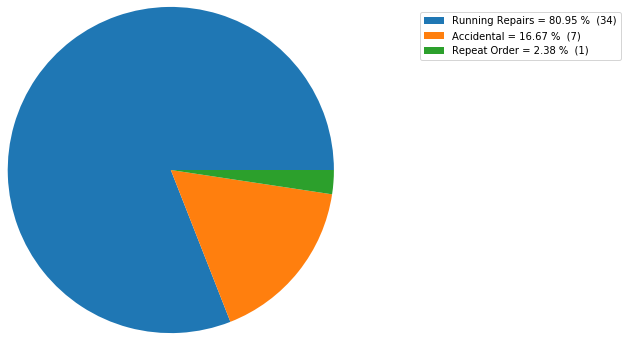

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2014-Q4


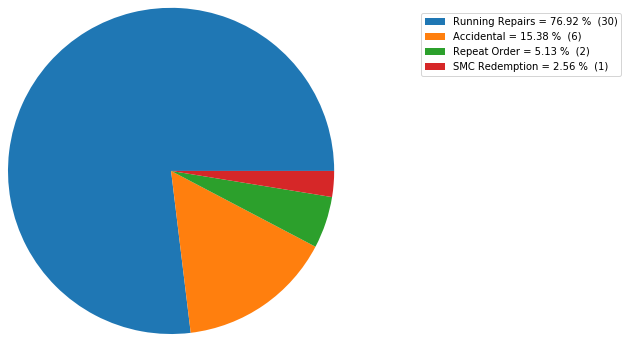

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2013-Q4


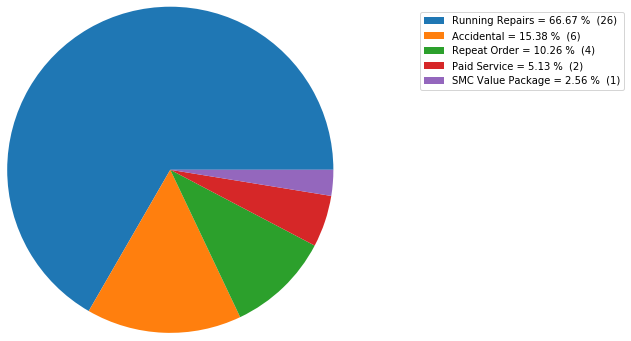

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2014-Q2


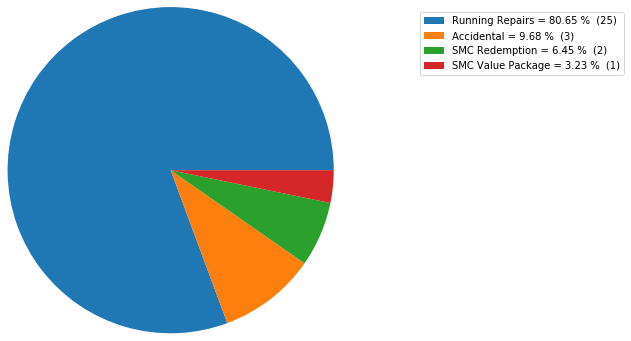

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2014-Q1


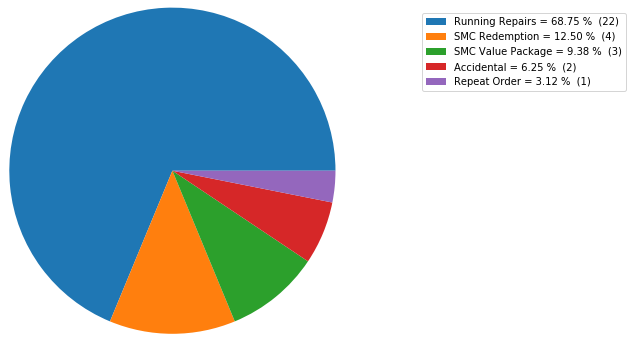

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2015-Q2


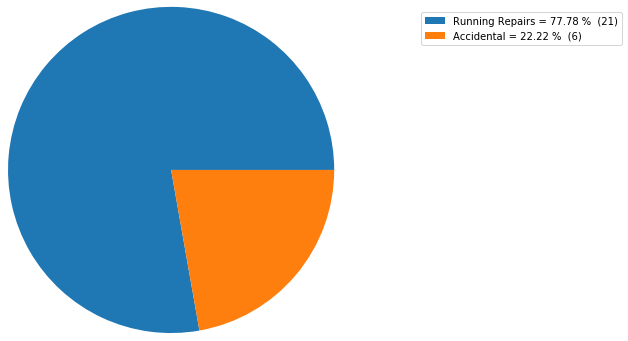

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2016-Q1


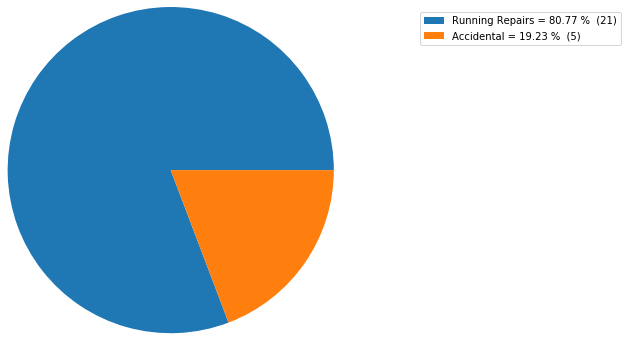

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2015-Q3


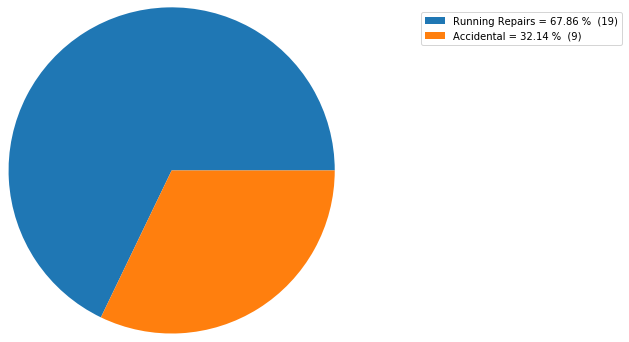

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2015-Q1


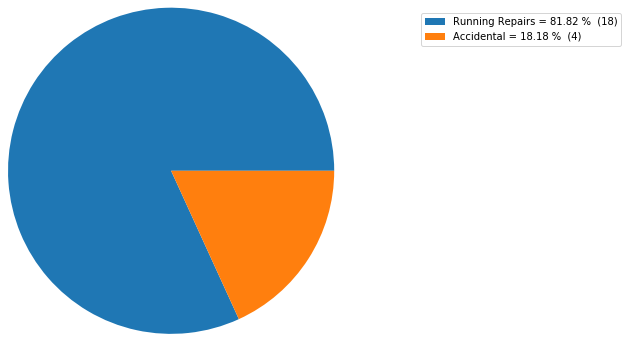

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2013-Q3


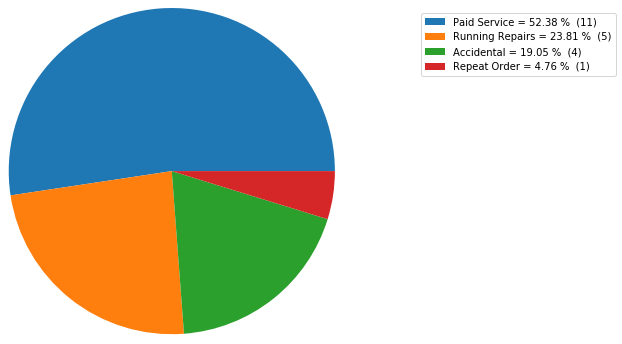

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2012-Q4


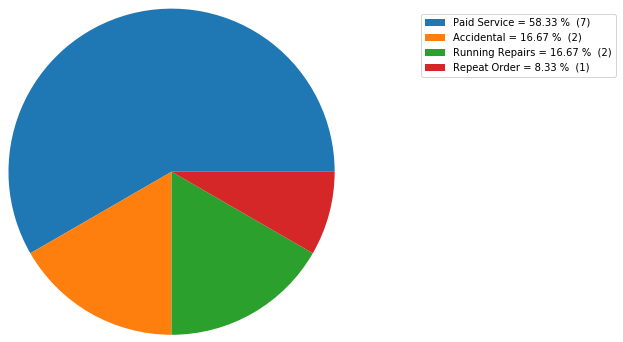

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2016-Q3


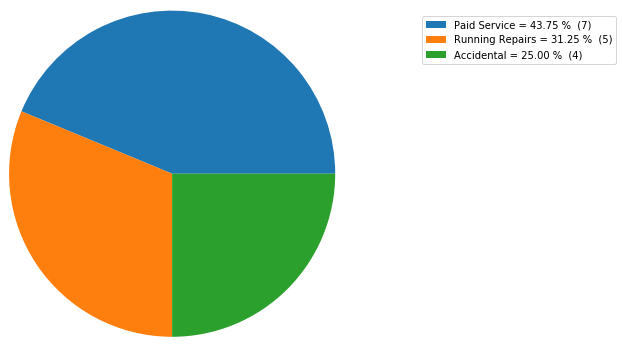

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2013-Q1


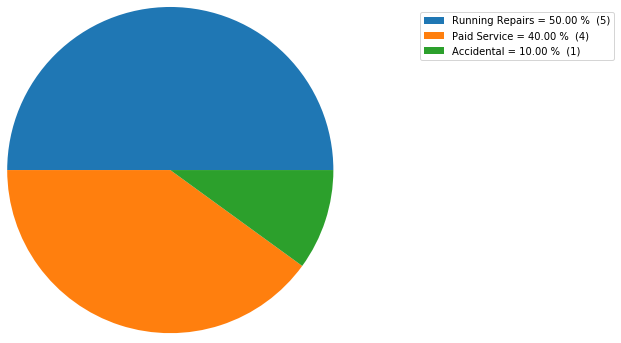

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2016-Q4


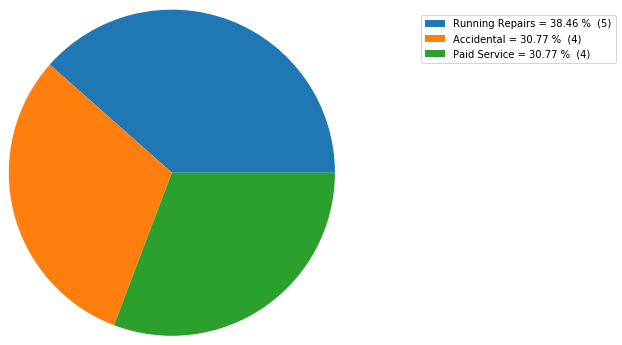

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2012-Q2


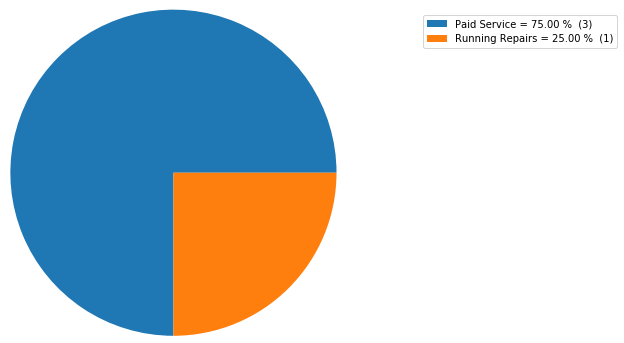

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2013-Q2


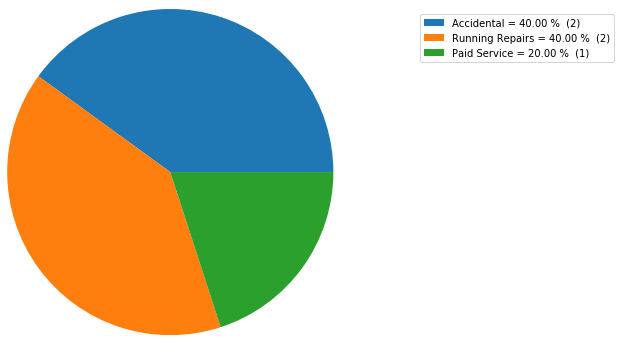

Countwise Distribution of Order Type for the State of Daman and Diu and for the season 2012-Q3


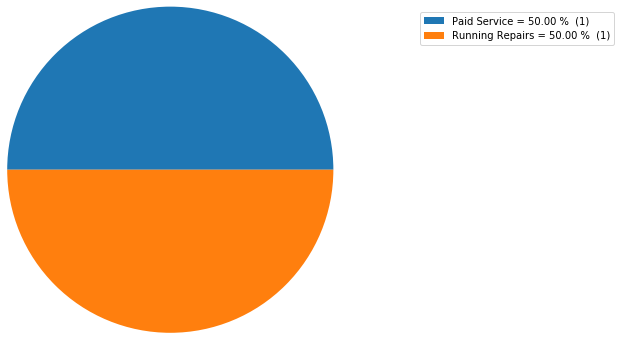

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2016-Q2


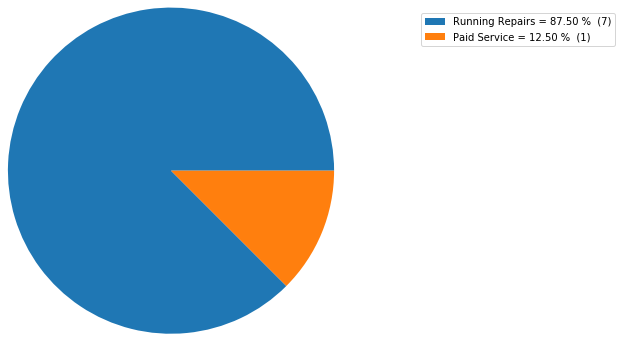

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2014-Q2


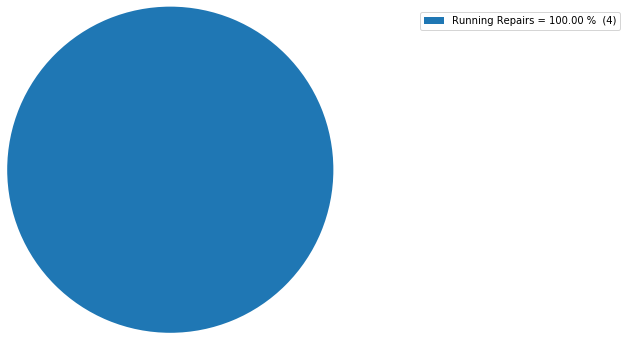

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2015-Q2


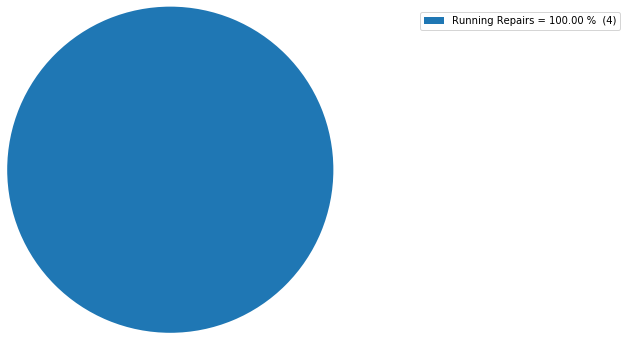

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2016-Q1


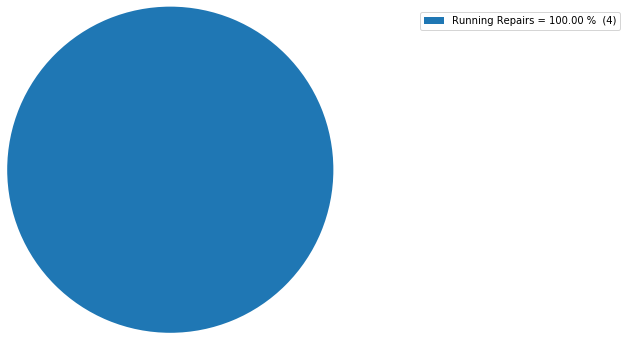

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2016-Q3


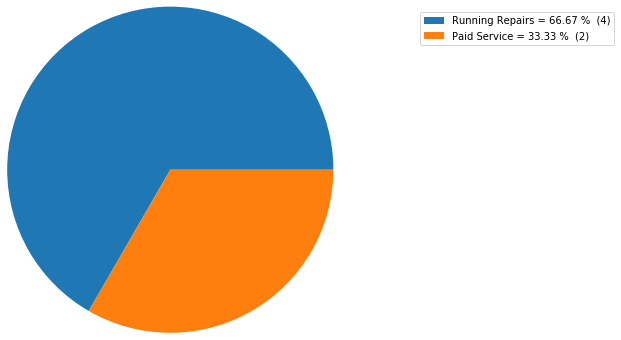

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2013-Q4


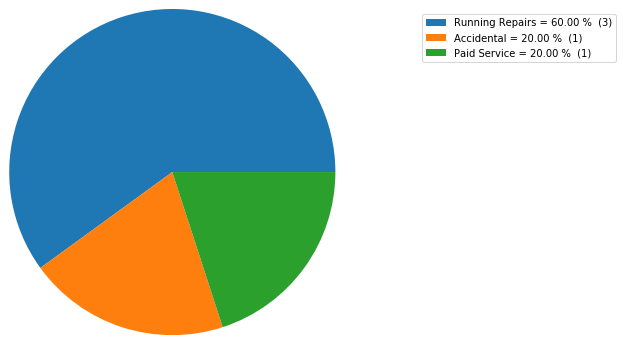

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2014-Q1


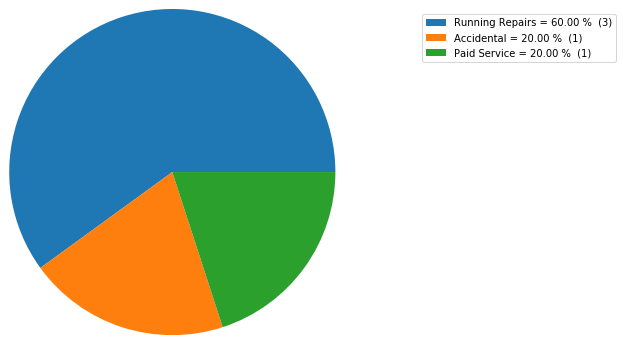

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2014-Q4


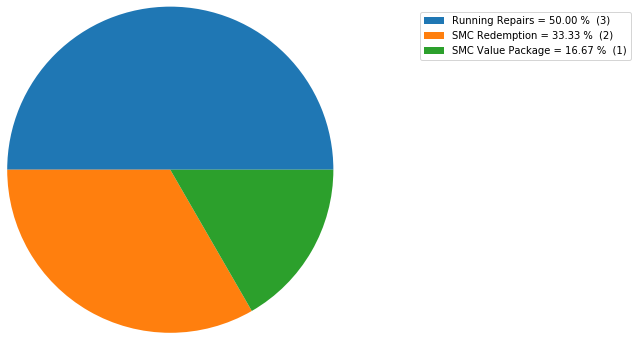

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2015-Q1


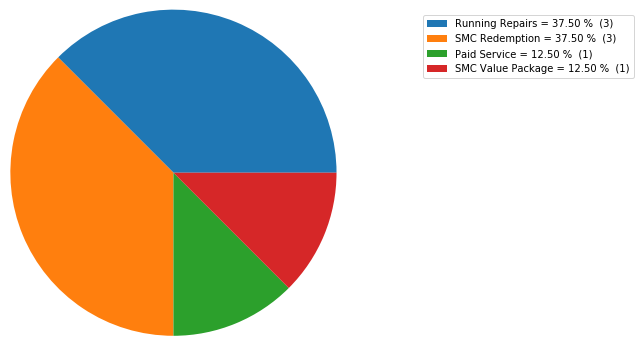

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2013-Q3


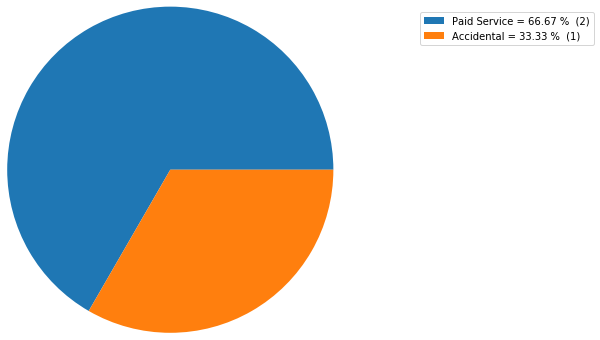

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2015-Q3


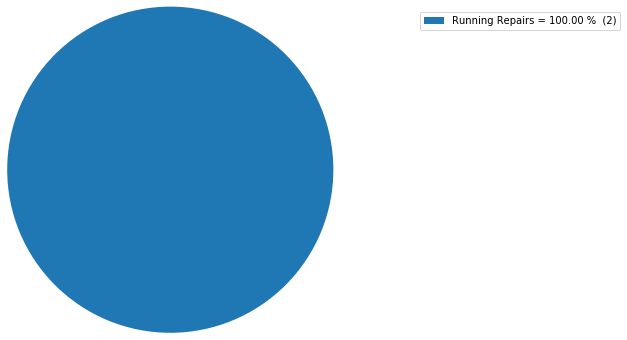

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2016-Q4


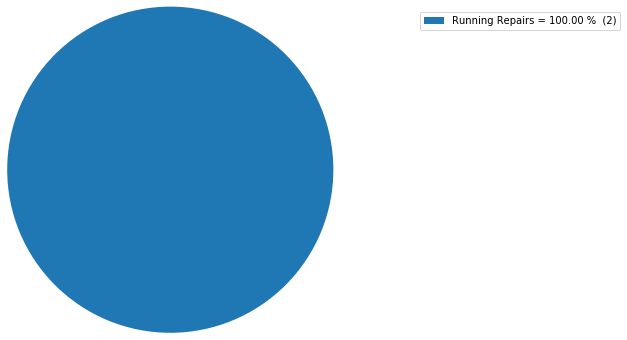

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2012-Q3


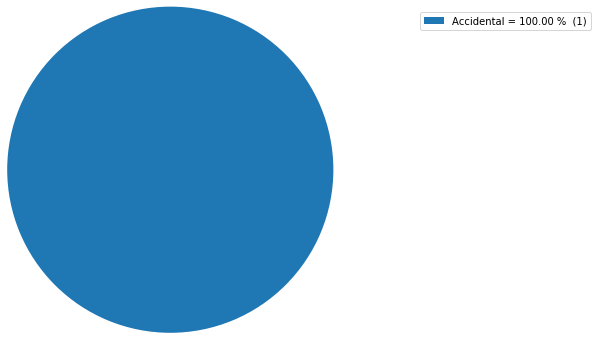

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2014-Q3


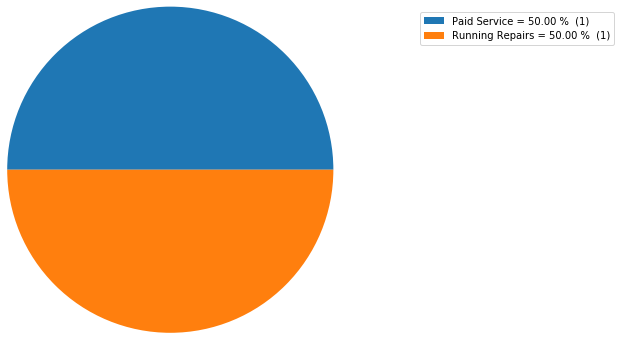

Countwise Distribution of Order Type for the State of Arunachal Pradesh and for the season 2015-Q4


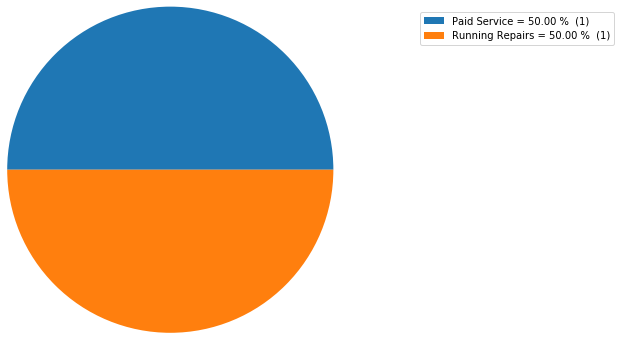

Countwise Distribution of Order Type for the State of Goa and for the season 2016-Q3


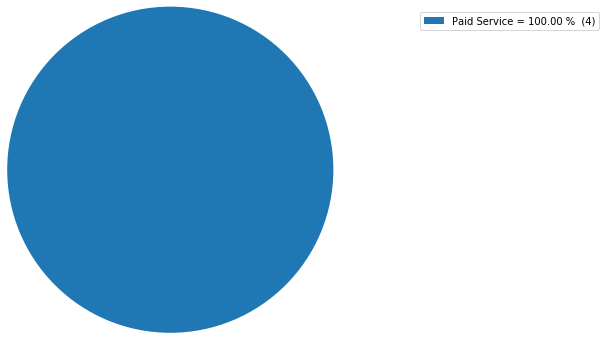

Countwise Distribution of Order Type for the State of Goa and for the season 2014-Q1


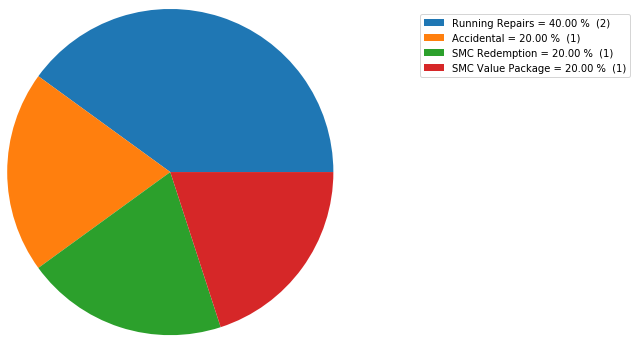

Countwise Distribution of Order Type for the State of Goa and for the season 2014-Q2


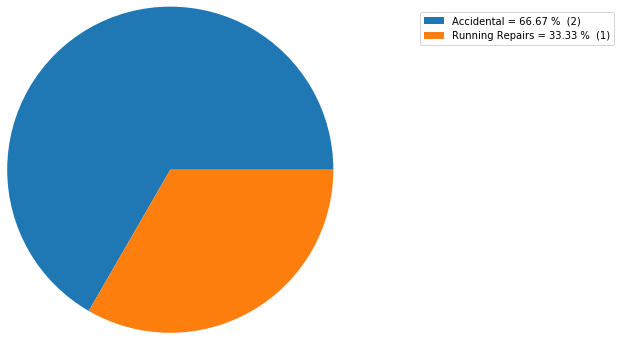

Countwise Distribution of Order Type for the State of Goa and for the season 2016-Q2


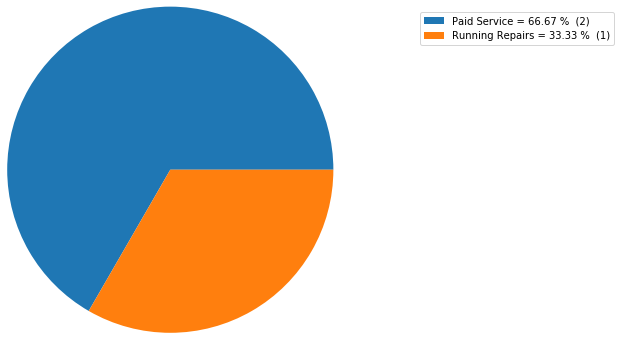

Countwise Distribution of Order Type for the State of Goa and for the season 2016-Q4


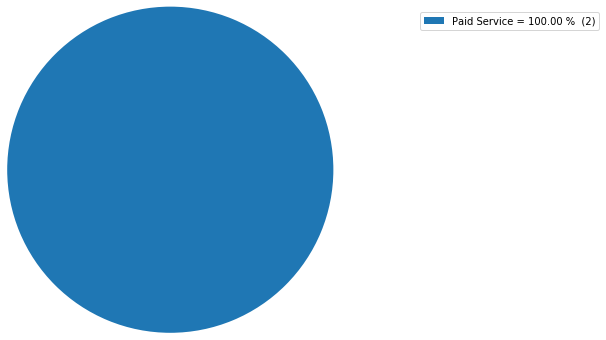

Countwise Distribution of Order Type for the State of Goa and for the season 2014-Q3


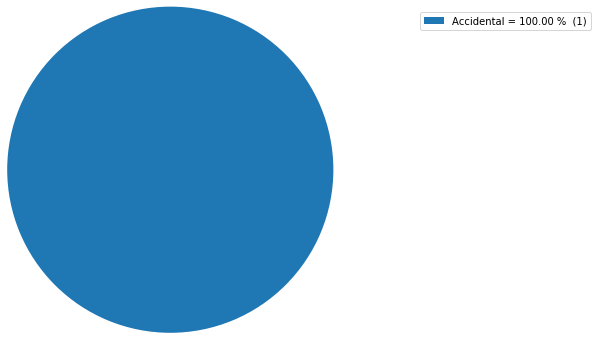

Countwise Distribution of Order Type for the State of Goa and for the season 2014-Q4


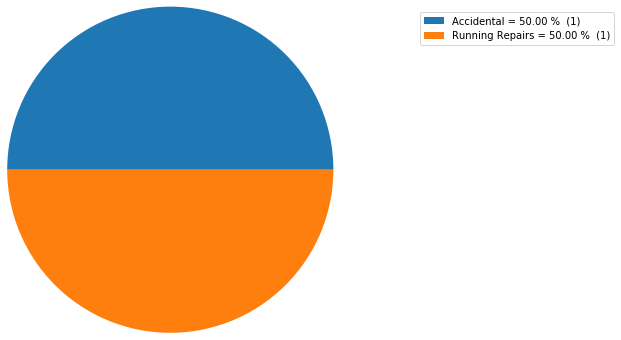

Countwise Distribution of Order Type for the State of Goa and for the season 2015-Q3


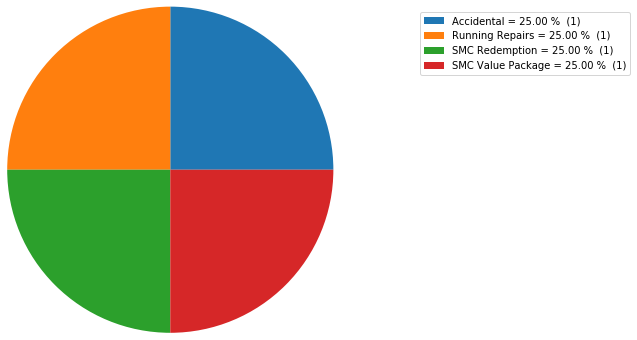

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2016-Q4


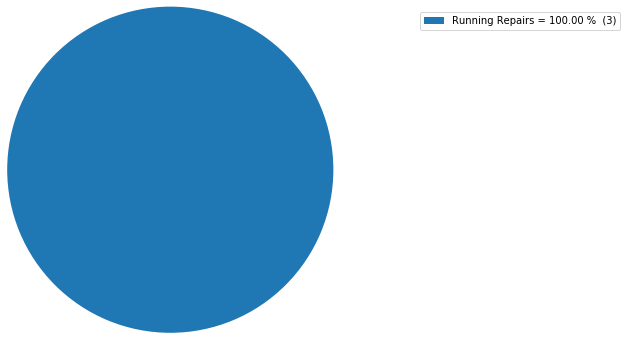

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2014-Q3


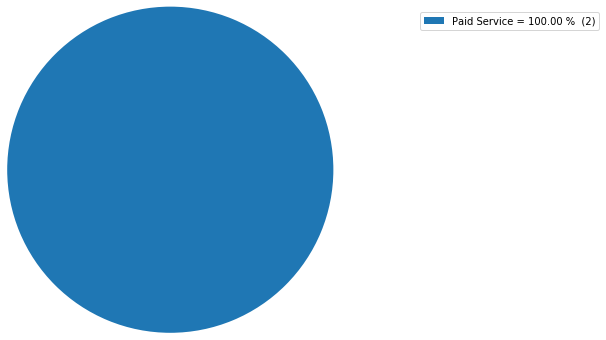

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2015-Q3


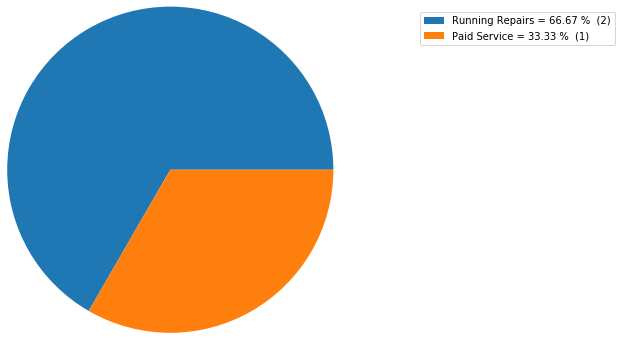

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2016-Q3


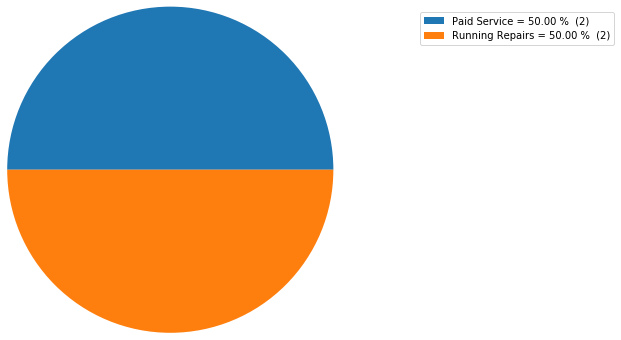

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2013-Q3


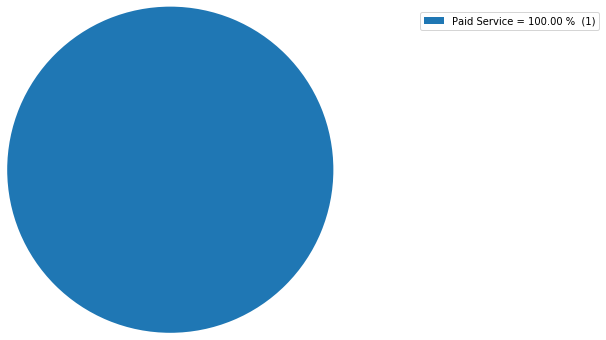

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2014-Q4


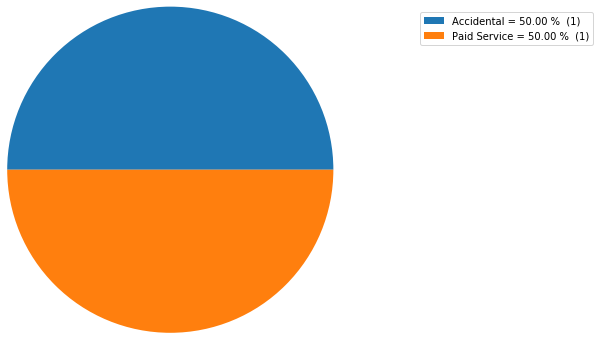

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2015-Q1


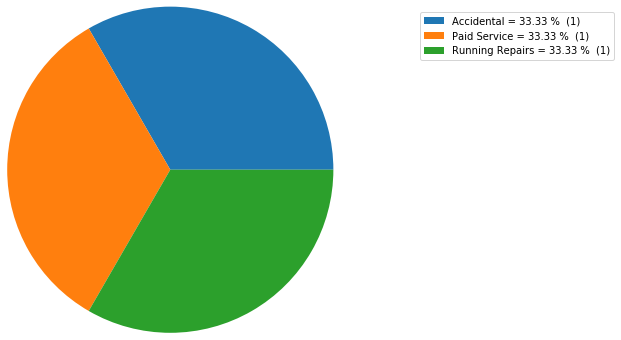

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2016-Q1


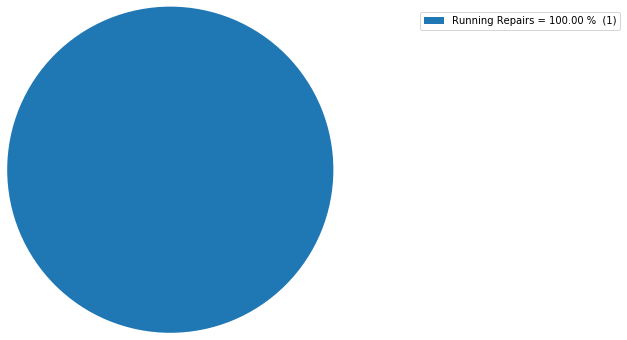

Countwise Distribution of Order Type for the State of Jammu and Kashmir and for the season 2016-Q2


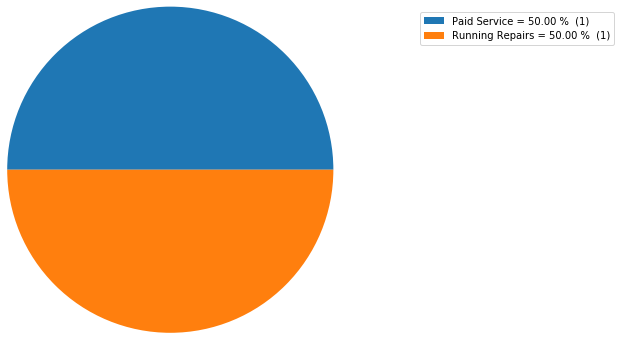

Countwise Distribution of Order Type for the State of Nagaland and for the season 2016-Q3


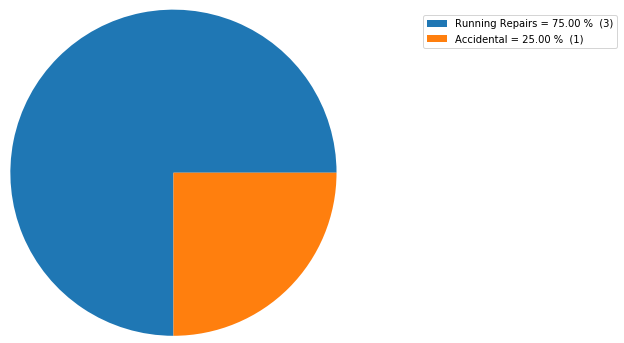

Countwise Distribution of Order Type for the State of Nagaland and for the season 2012-Q3


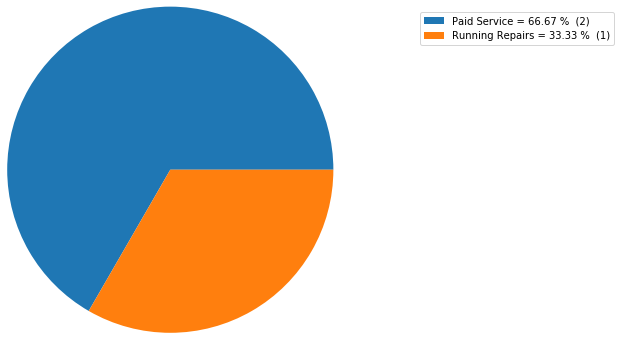

Countwise Distribution of Order Type for the State of Nagaland and for the season 2013-Q1


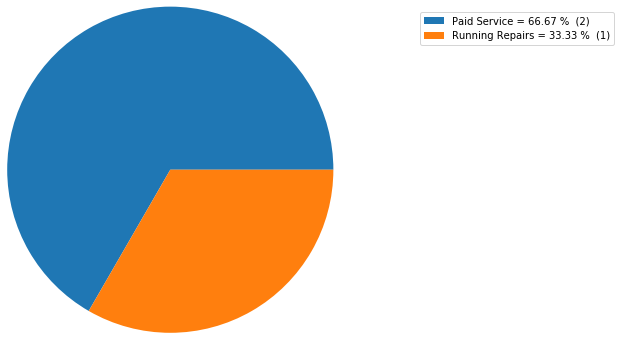

Countwise Distribution of Order Type for the State of Nagaland and for the season 2012-Q2


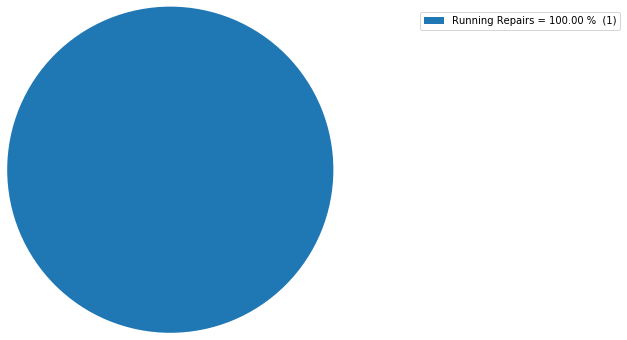

Countwise Distribution of Order Type for the State of Nagaland and for the season 2013-Q2


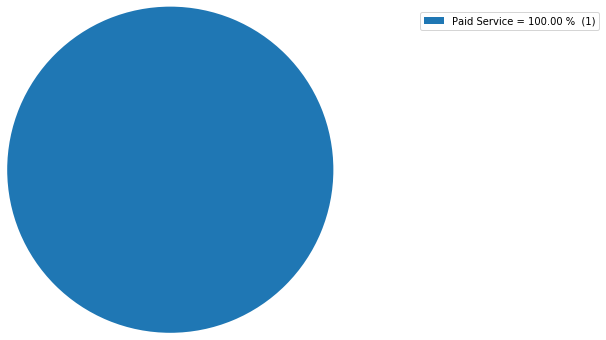

Countwise Distribution of Order Type for the State of Nagaland and for the season 2013-Q4


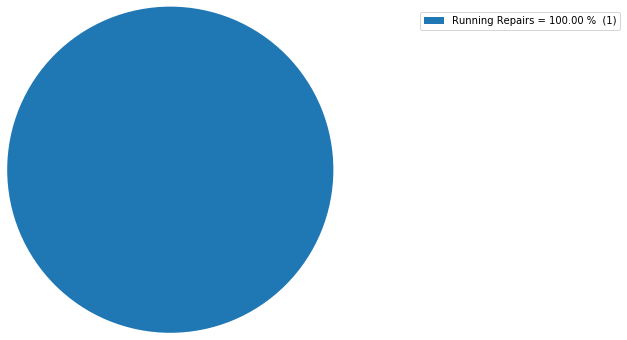

Countwise Distribution of Order Type for the State of Nagaland and for the season 2014-Q1


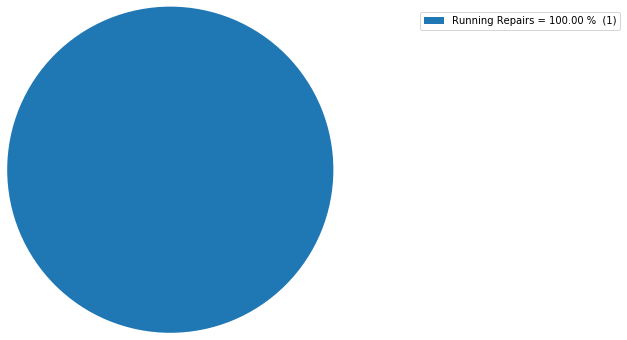

Countwise Distribution of Order Type for the State of Nagaland and for the season 2014-Q2


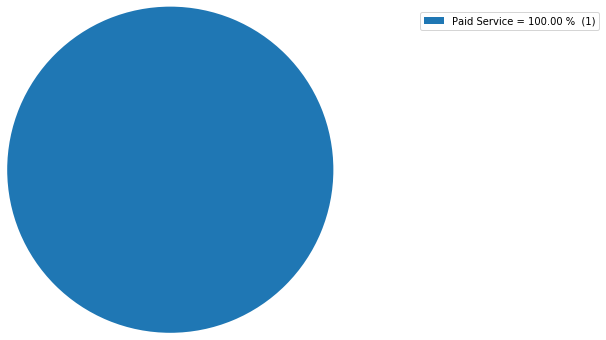

Countwise Distribution of Order Type for the State of Nagaland and for the season 2014-Q4


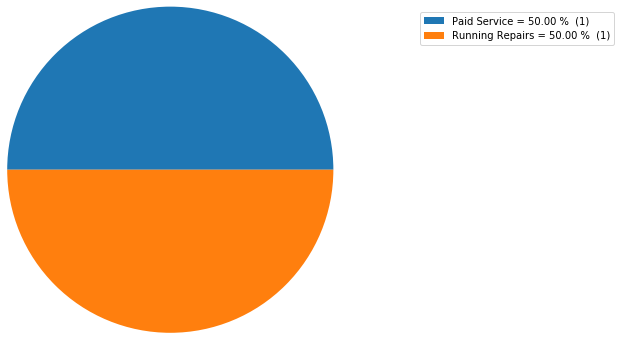

Countwise Distribution of Order Type for the State of Nagaland and for the season 2015-Q3


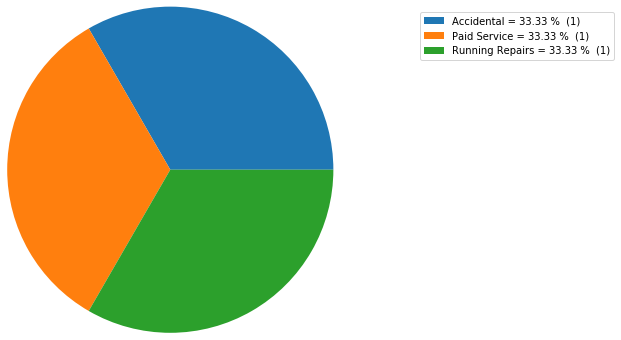

Countwise Distribution of Order Type for the State of Nagaland and for the season 2015-Q4


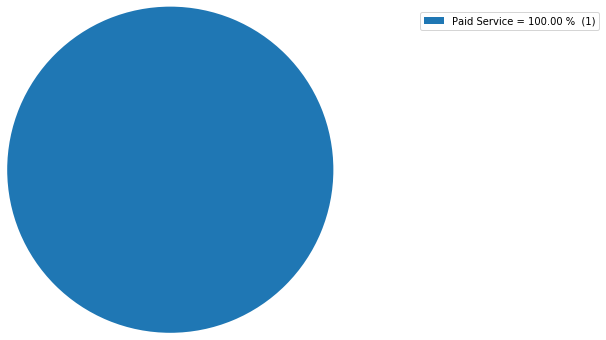

Countwise Distribution of Order Type for the State of Nagaland and for the season 2016-Q1


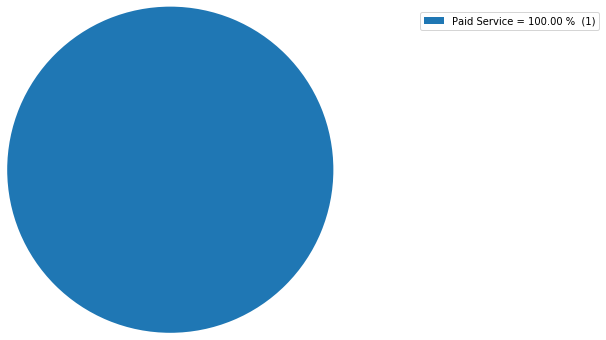

Countwise Distribution of Order Type for the State of Nagaland and for the season 2016-Q2


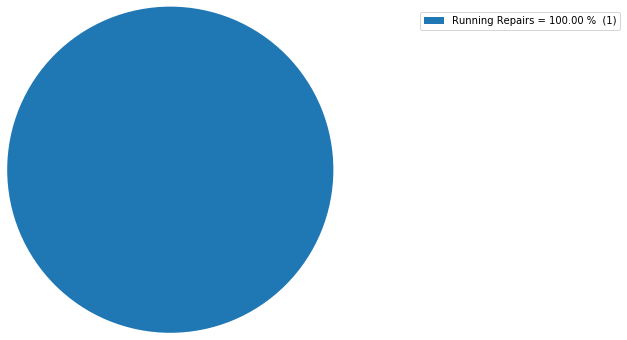

Countwise Distribution of Order Type for the State of Nagaland and for the season 2016-Q4


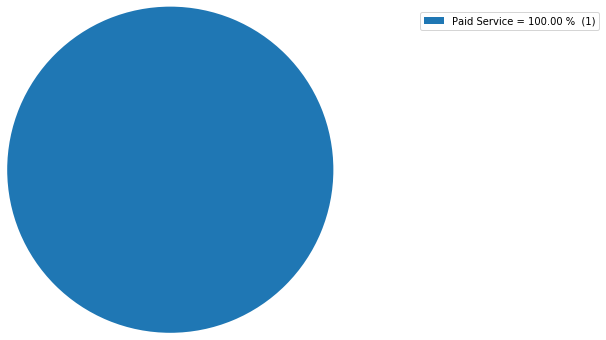

Countwise Distribution of Order Type for the State of Andaman and Nico.In. and for the season 2015-Q4


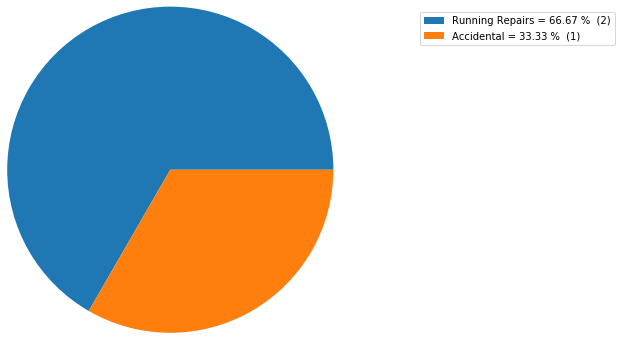

Countwise Distribution of Order Type for the State of Andaman and Nico.In. and for the season 2016-Q3


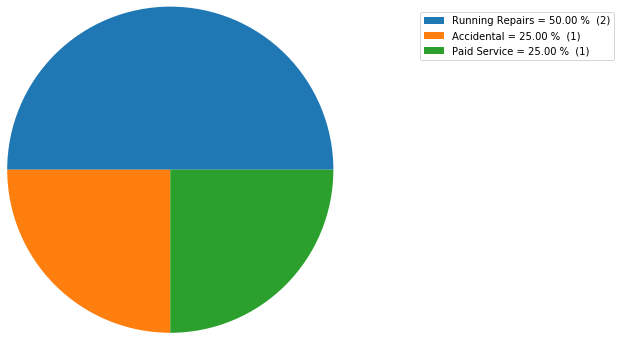

Countwise Distribution of Order Type for the State of Andaman and Nico.In. and for the season 2015-Q3


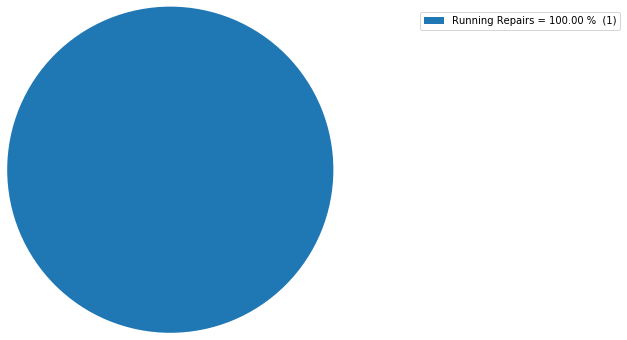

Countwise Distribution of Order Type for the State of Manipur and for the season 2016-Q3


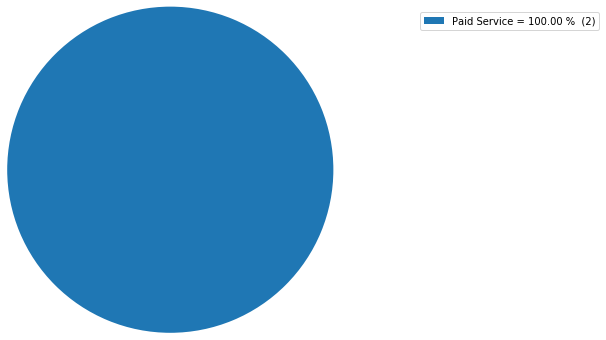

Countwise Distribution of Order Type for the State of Manipur and for the season 2015-Q1


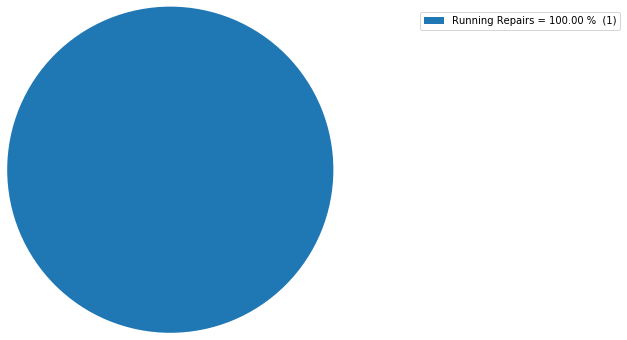

Countwise Distribution of Order Type for the State of Megalaya and for the season 2015-Q3


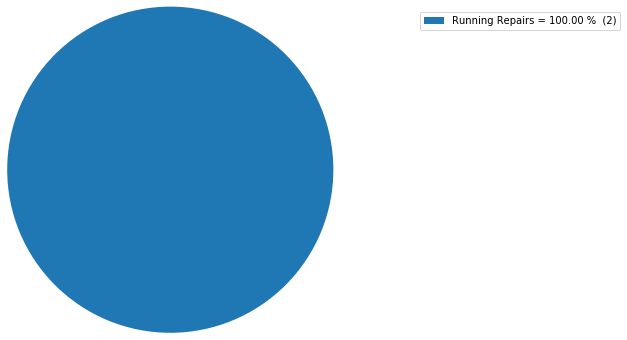

Countwise Distribution of Order Type for the State of Megalaya and for the season 2016-Q3


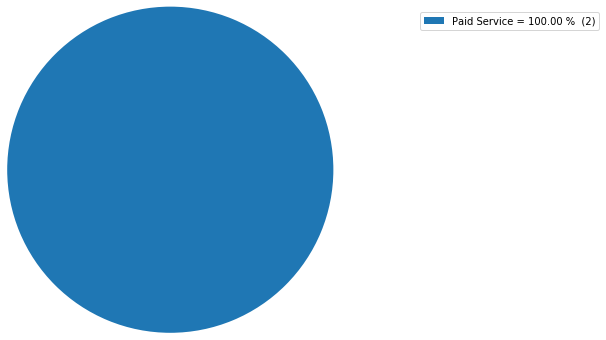

Countwise Distribution of Order Type for the State of Megalaya and for the season 2014-Q3


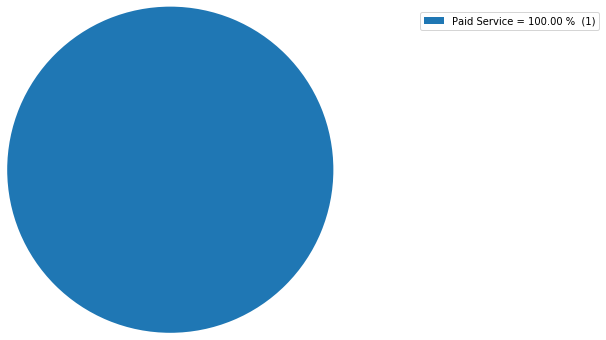

Countwise Distribution of Order Type for the State of Megalaya and for the season 2015-Q1


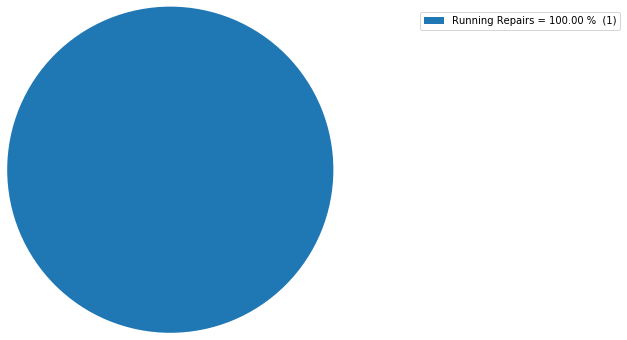

Countwise Distribution of Order Type for the State of Megalaya and for the season 2015-Q2


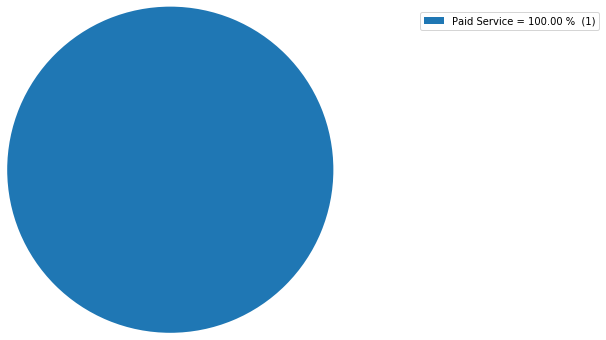

Countwise Distribution of Order Type for the State of Sikkim and for the season 2016-Q3


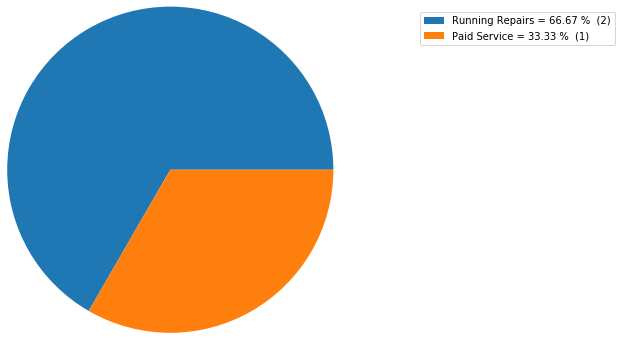

Countwise Distribution of Order Type for the State of Sikkim and for the season 2015-Q3


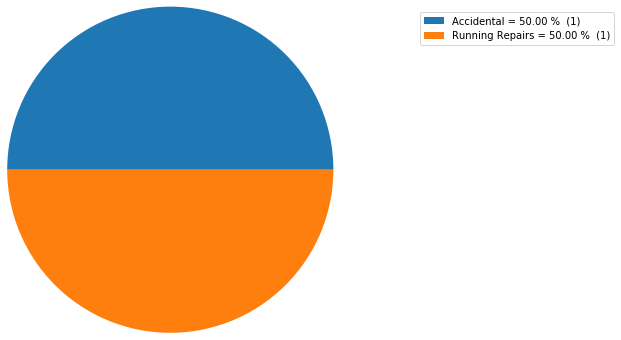

Countwise Distribution of Order Type for the State of Sikkim and for the season 2016-Q1


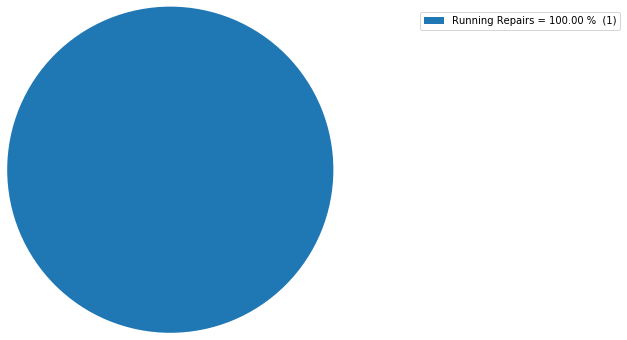

Countwise Distribution of Order Type for the State of Tripura and for the season 2016-Q4


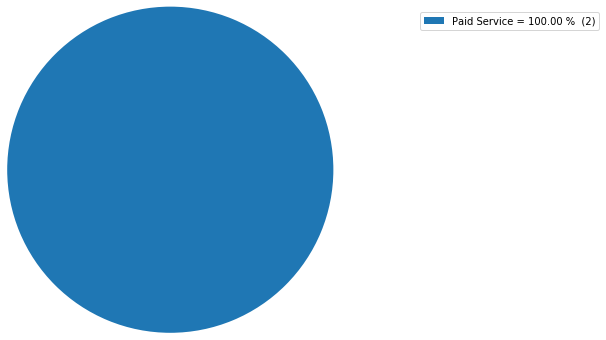

Countwise Distribution of Order Type for the State of Tripura and for the season 2015-Q1


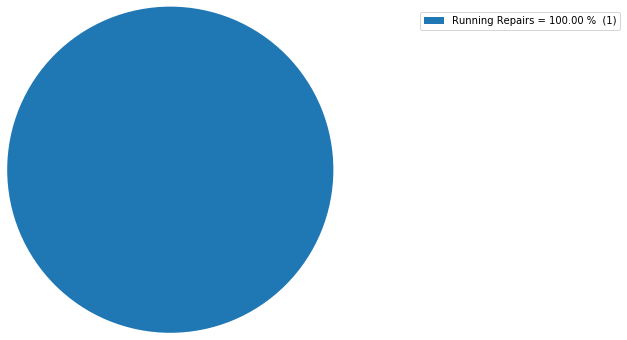

Countwise Distribution of Order Type for the State of Tripura and for the season 2015-Q2


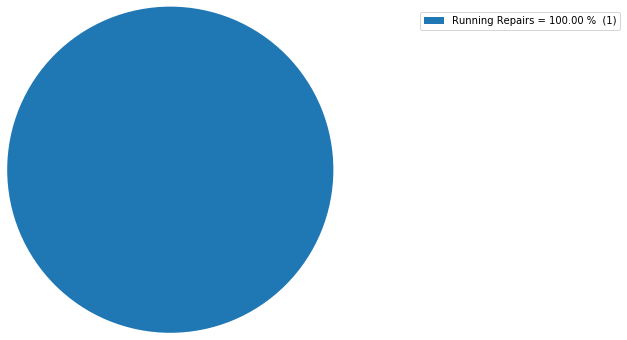

Countwise Distribution of Order Type for the State of Tripura and for the season 2015-Q4


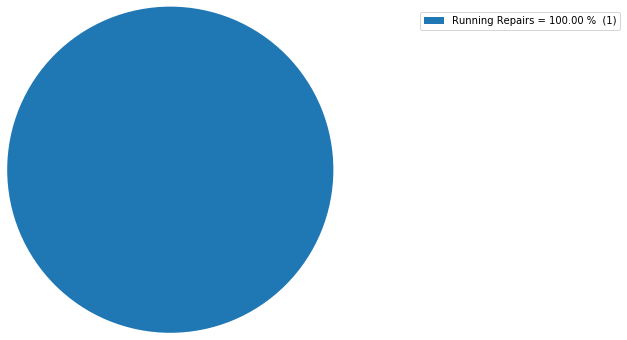

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2013-Q3


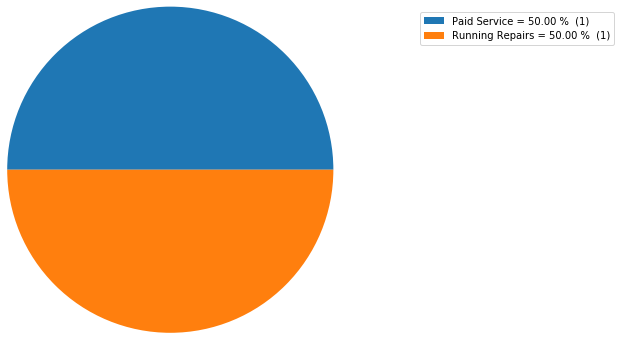

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2013-Q4


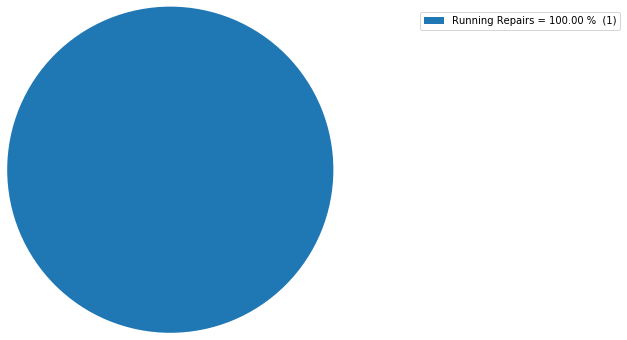

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2014-Q2


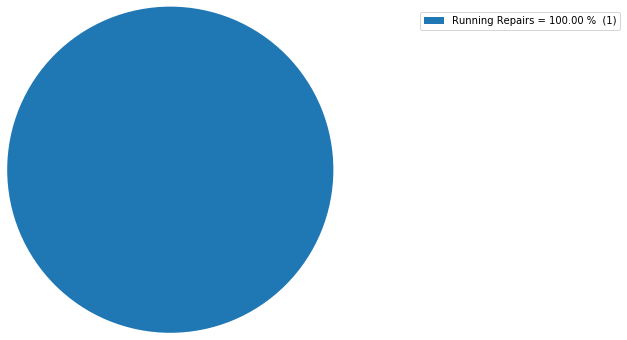

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2014-Q3


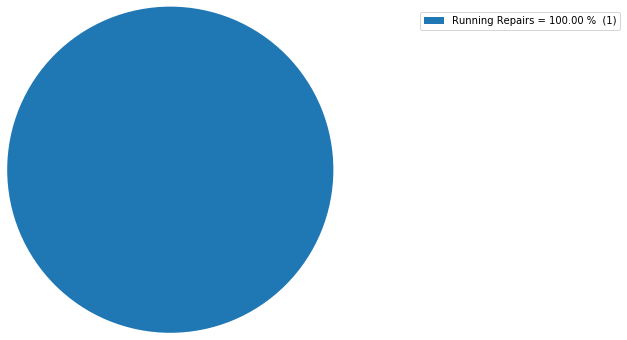

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2014-Q4


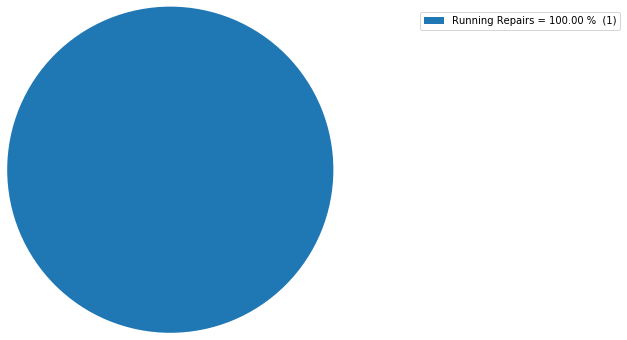

Countwise Distribution of Order Type for the State of Lakshadweep and for the season 2015-Q3


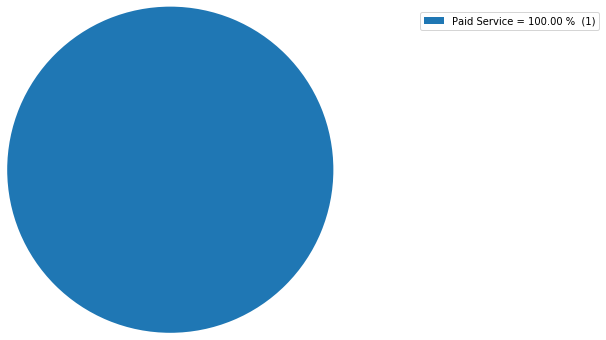

Countwise Distribution of Order Type for the State of Mizoram and for the season 2012-Q2


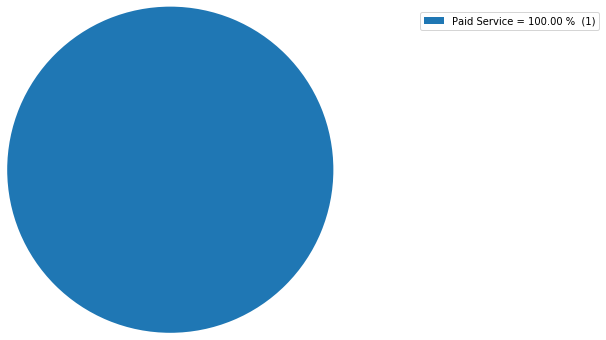

Countwise Distribution of Order Type for the State of Mizoram and for the season 2016-Q3


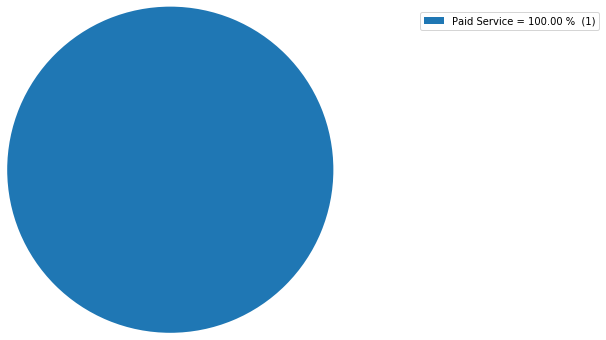

In [44]:
for i in h['District'].unique():
    for j in h[(h['District']== i)]['JobCard Date'].unique():
        state = i
        season = j
        len_season = len(list(h[h['District']== i]['JobCard Date'].unique()))
        mk_cnt = list(h[(h['District']== i) & (h['JobCard Date']== j)]['order_cnt'].values)
        mk_percent = list(mk_cnt/h[(h['District']== i) & (h['JobCard Date']== j)]['order_cnt'].values.sum()*100)
        mk_lable = list(h[(h['District']== i) & (h['JobCard Date']== j)]['Order Type'].values)
        print('Countwise Distribution of Order Type for the State of '+state+' and for the season '+season)
        pie_chart(mk_percent,mk_lable,mk_cnt)

# From Type of Order per season per State we could see following insights to build invetory for workshop


1) Not enough data available for J&K/NE States to conclude on. If improved on record keeping and data capturing, this will surely help on getting insights and serving customer needs of these area through MFC workshops.


2) In most of the states Running Repairs dominates the order type. After Runnig Repairs and Paid Services, Accident is one of the major reason for which customers visit MFC workshops.


3) For TN in the season 2012/13-Q2, we could people preferring Paid Services. The reason could be preparedness for some extreme weather or a natural calamity which has caused customers to go for paid service. Similar is the observation for MH in 2013-Q2/Q3, 2014-Q4, 2013-Q1, 2012-Q2/Q3.


4) KA is a state with consistent reporting Order Type for Accident. Reson could be higher density of vehicles on road or overall lack of traffic sense.

# Revenue trend per state per quarter

In [45]:
m = pd.DataFrame(cust_inv_data.groupby(['District','JobCard Date'])['Total Amt Wtd Tax.'].sum()).reset_index()
m.columns = ['District','JobCard Date','Quart_revenue']
m.head()

,District,JobCard Date,Quart_revenue
0,Andaman and Nico.In.,2015-Q3,628.13
1,Andaman and Nico.In.,2015-Q4,38461.29
2,Andaman and Nico.In.,2016-Q3,32944.43
3,Andhra Pradesh,2012-Q2,3865314.39
4,Andhra Pradesh,2012-Q3,5420563.65


In [46]:
def scatter_plot(quart_cnt,quart_lable,xlabel,ylabel):
    plt.figure(figsize=(20,5), frameon=True)
    plt.grid(color='black')
    plt.plot(quart_lable,quart_cnt,linewidth=2)
    plt.xticks(rotation=60)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.show()    

Quarterly revenue trend for the State of Andaman and Nico.In.


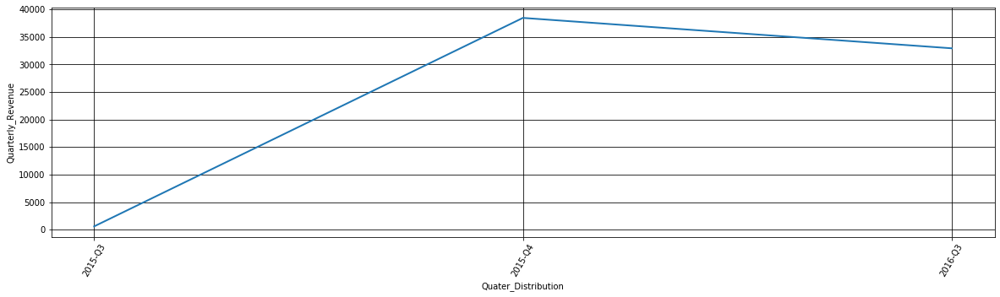

Quarterly revenue trend for the State of Andhra Pradesh


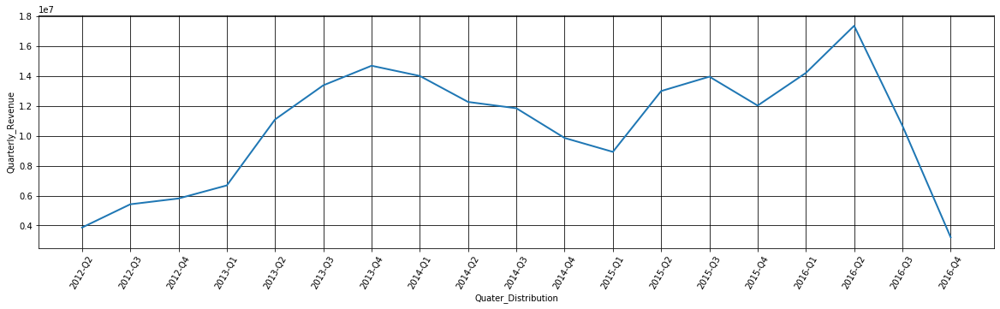

Quarterly revenue trend for the State of Arunachal Pradesh


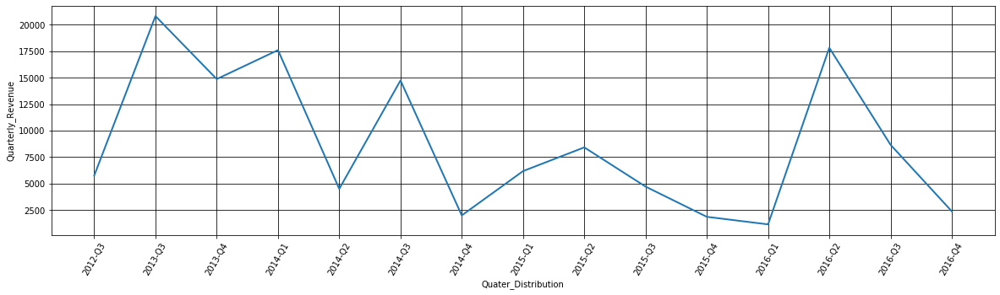

Quarterly revenue trend for the State of Assam


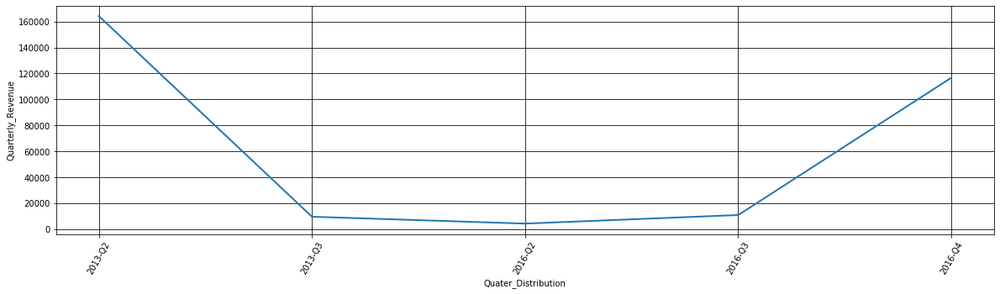

Quarterly revenue trend for the State of Bihar


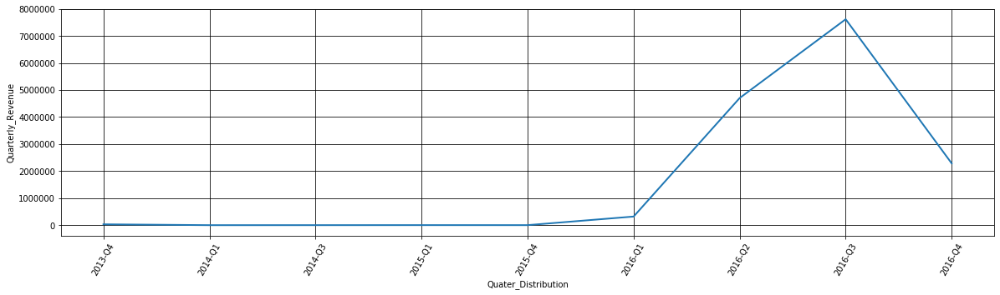

Quarterly revenue trend for the State of Chandigarh


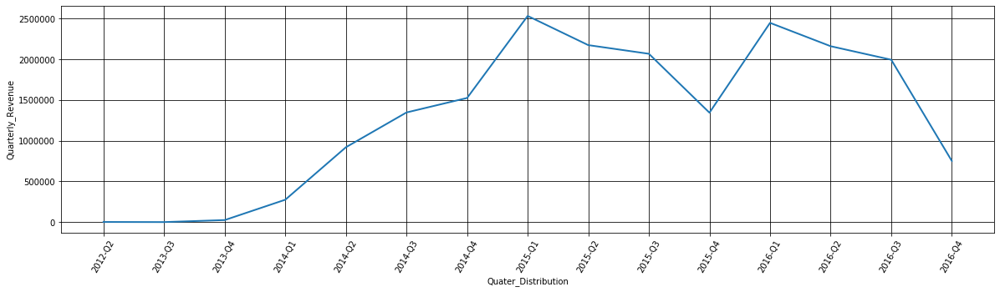

Quarterly revenue trend for the State of Chhattisgarh


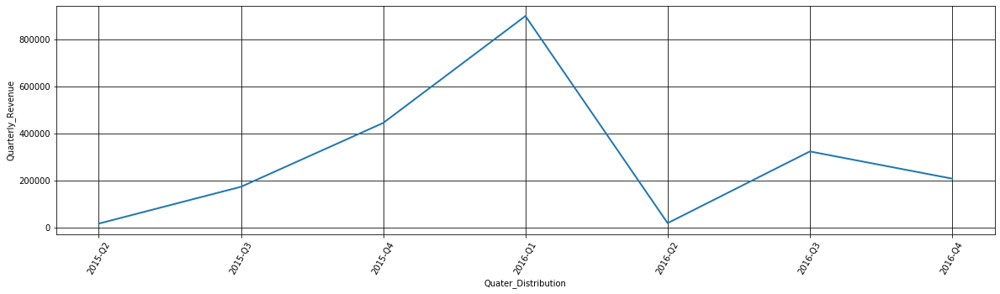

Quarterly revenue trend for the State of Dadra and Nagar Hav.


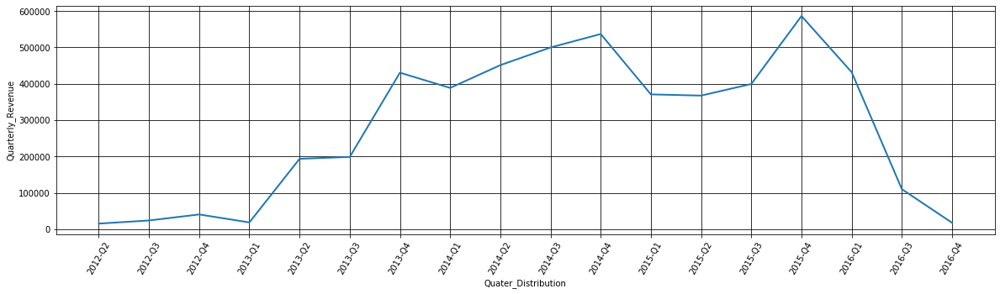

Quarterly revenue trend for the State of Daman and Diu


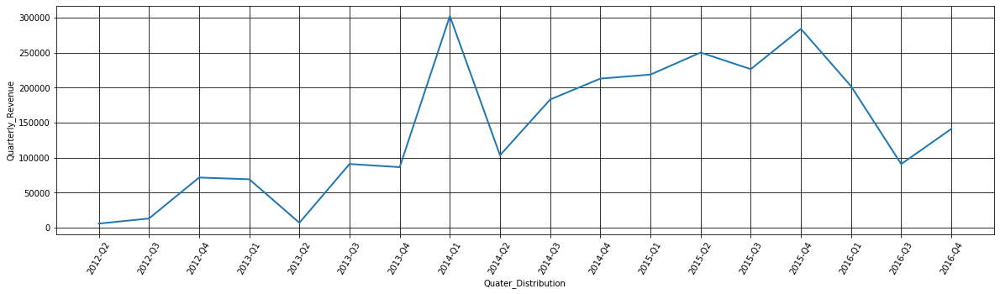

Quarterly revenue trend for the State of Delhi


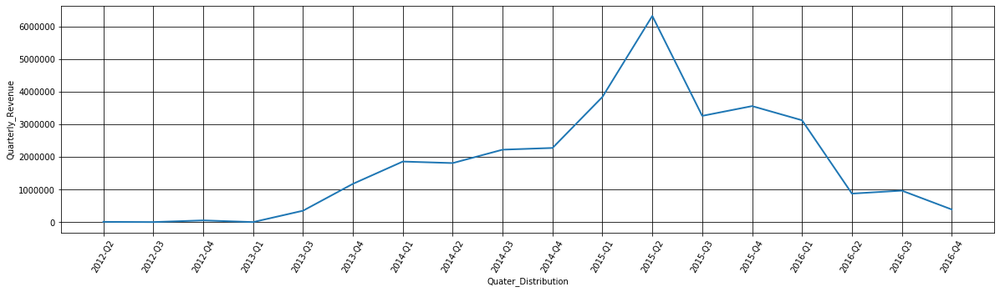

Quarterly revenue trend for the State of Goa


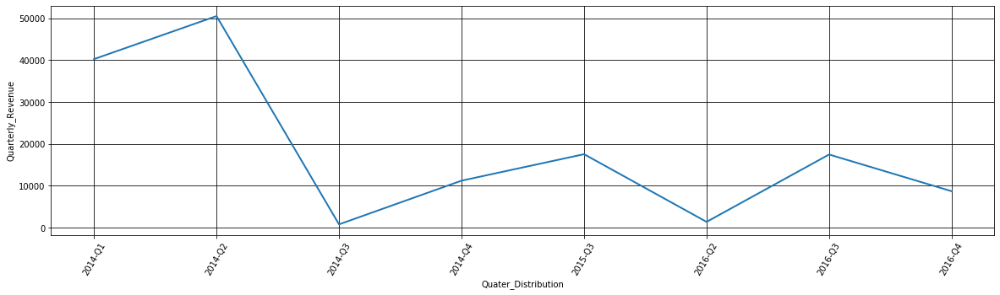

Quarterly revenue trend for the State of Gujarat


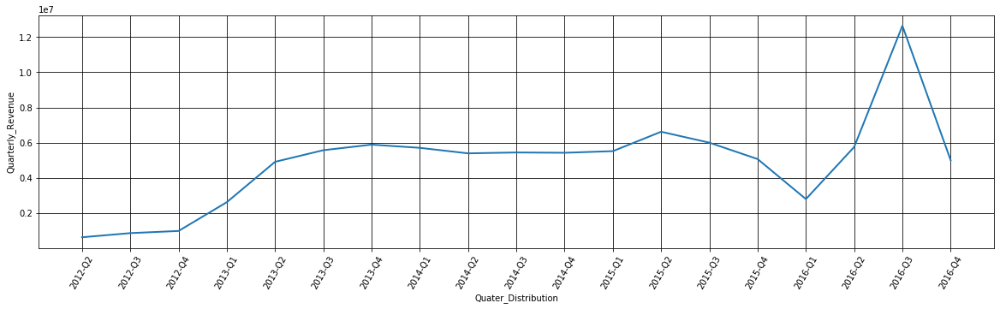

Quarterly revenue trend for the State of Haryana


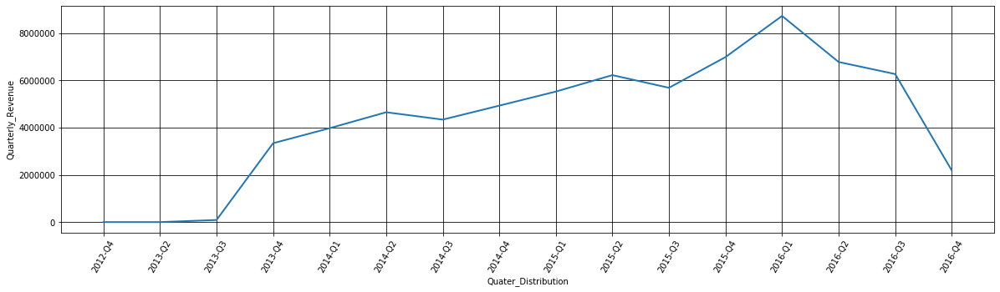

Quarterly revenue trend for the State of Himachal Pradesh


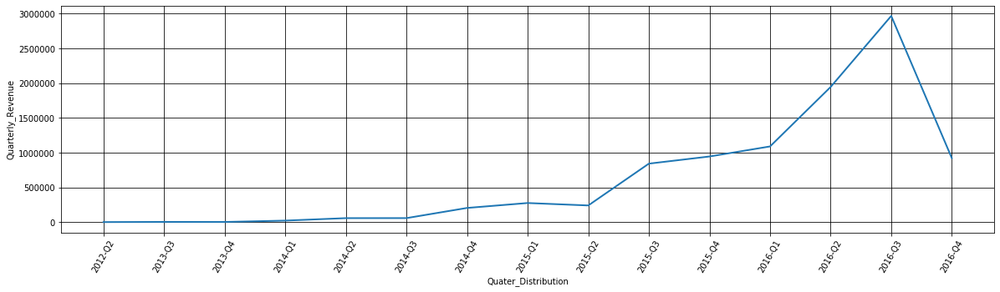

Quarterly revenue trend for the State of Jammu and Kashmir


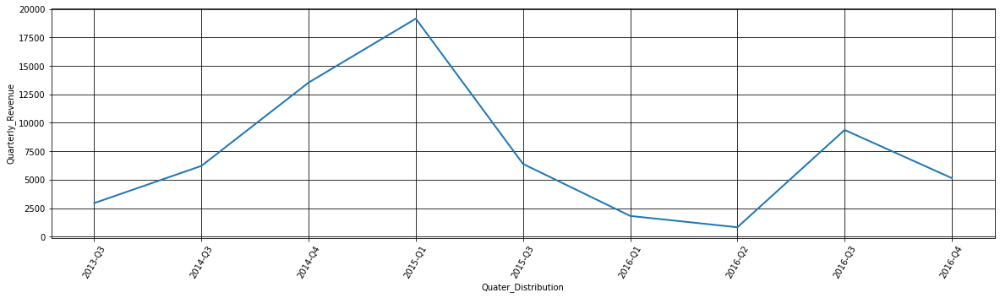

Quarterly revenue trend for the State of Jharkhand


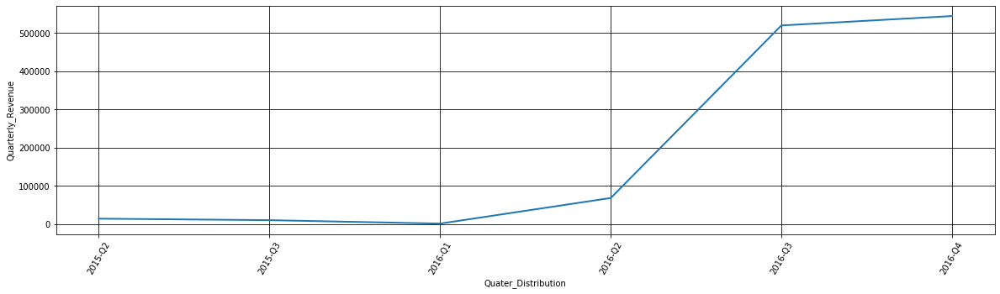

Quarterly revenue trend for the State of Karnataka


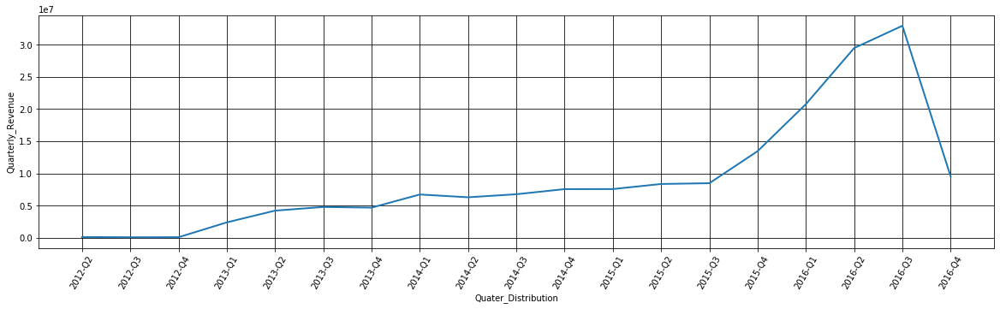

Quarterly revenue trend for the State of Kerala


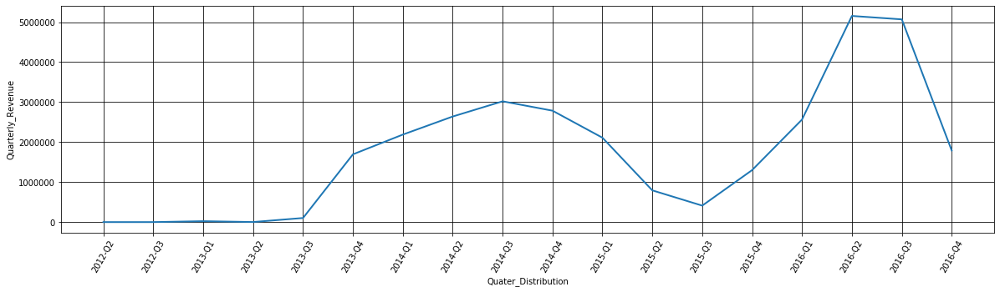

Quarterly revenue trend for the State of Lakshadweep


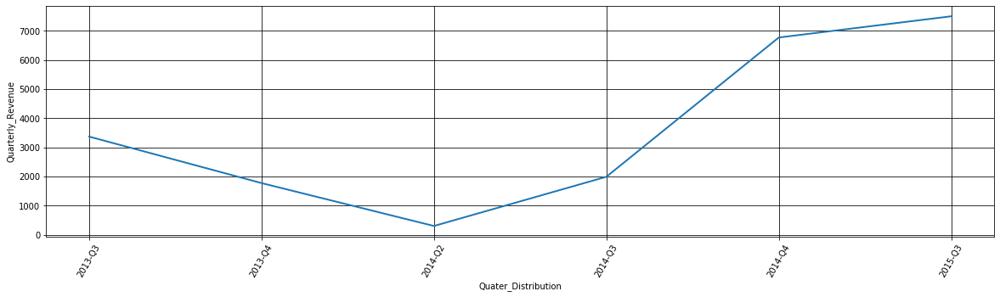

Quarterly revenue trend for the State of Madhya Pradesh


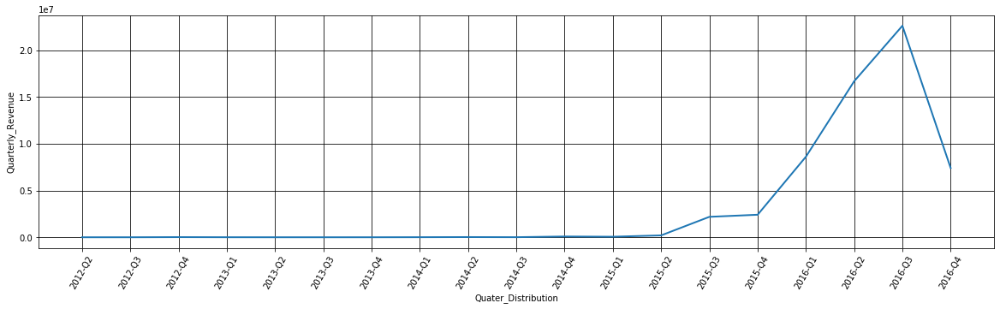

Quarterly revenue trend for the State of Maharashtra


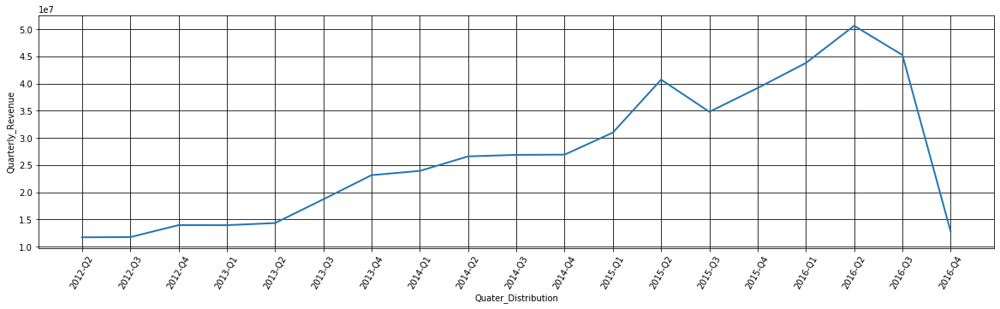

Quarterly revenue trend for the State of Manipur


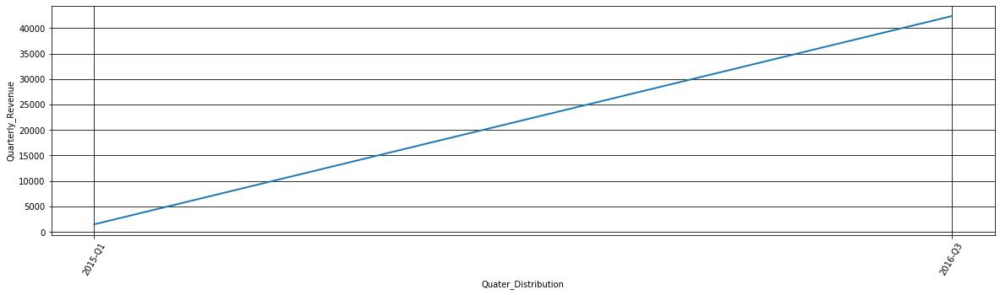

Quarterly revenue trend for the State of Megalaya


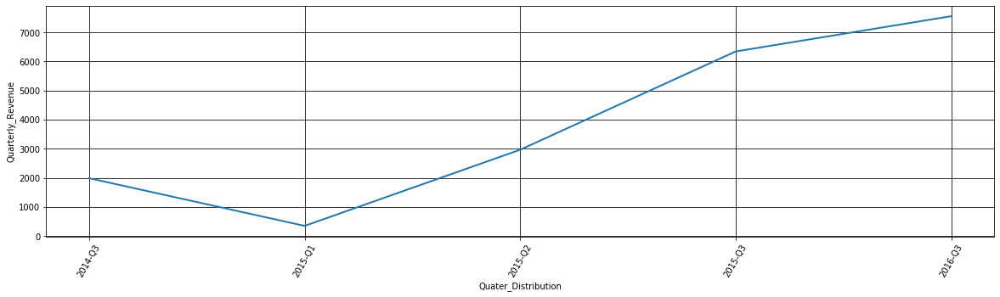

Quarterly revenue trend for the State of Mizoram


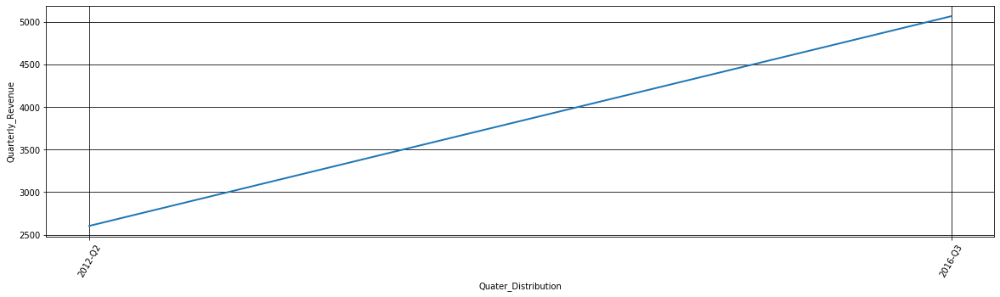

Quarterly revenue trend for the State of Nagaland


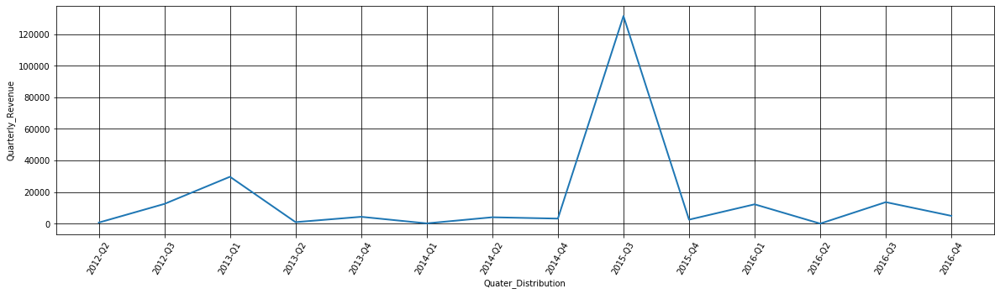

Quarterly revenue trend for the State of Odisha


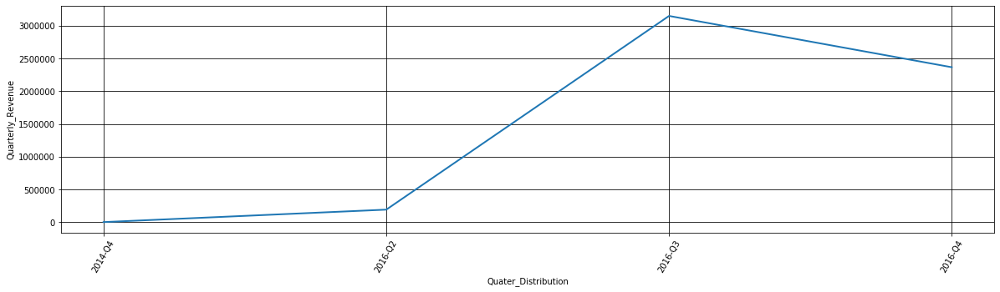

Quarterly revenue trend for the State of Puducherry


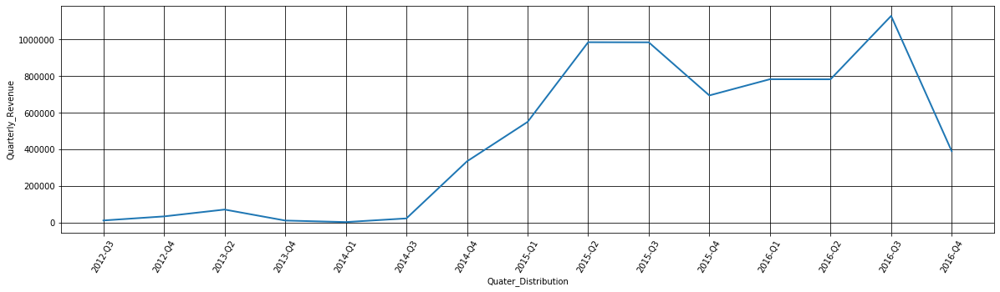

Quarterly revenue trend for the State of Punjab


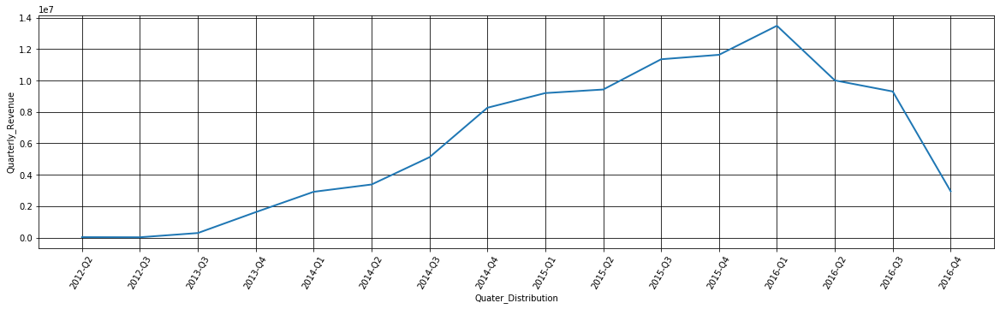

Quarterly revenue trend for the State of Rajasthan


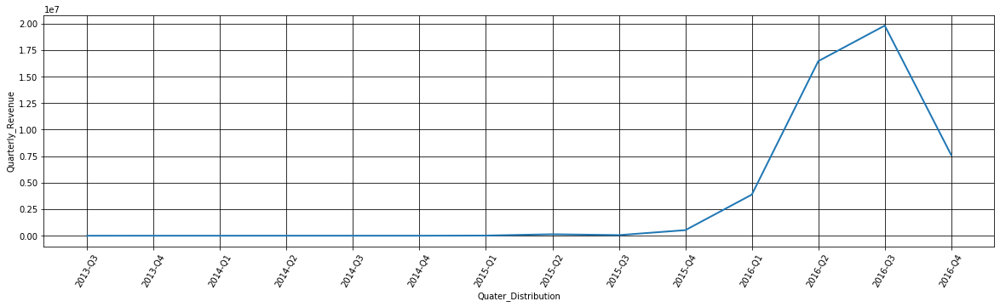

Quarterly revenue trend for the State of Sikkim


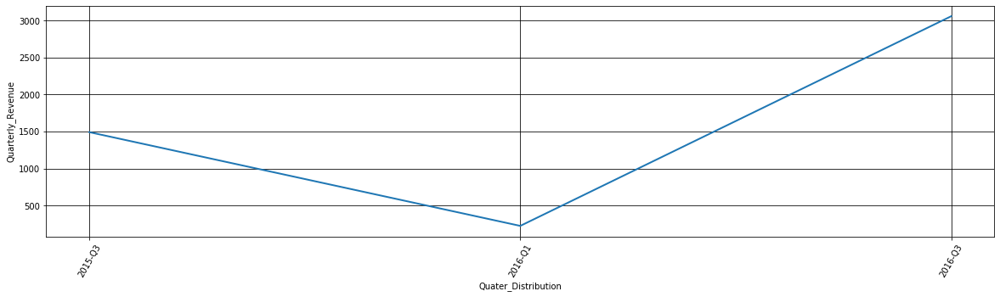

Quarterly revenue trend for the State of Tamil Nadu


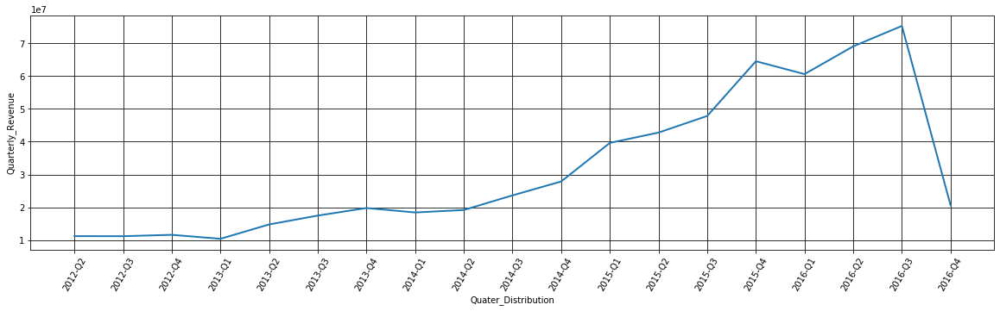

Quarterly revenue trend for the State of Telangana


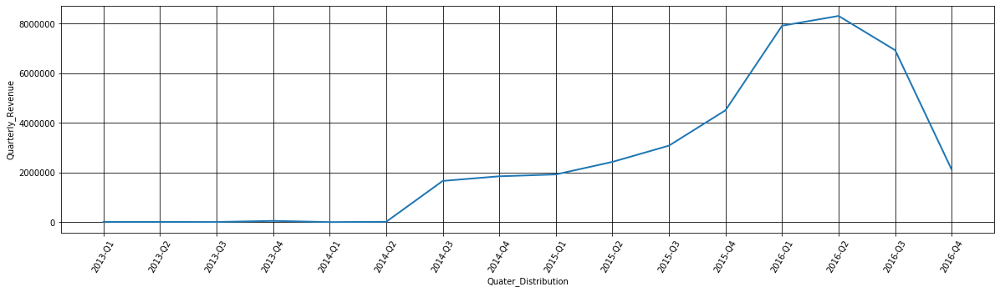

Quarterly revenue trend for the State of Tripura


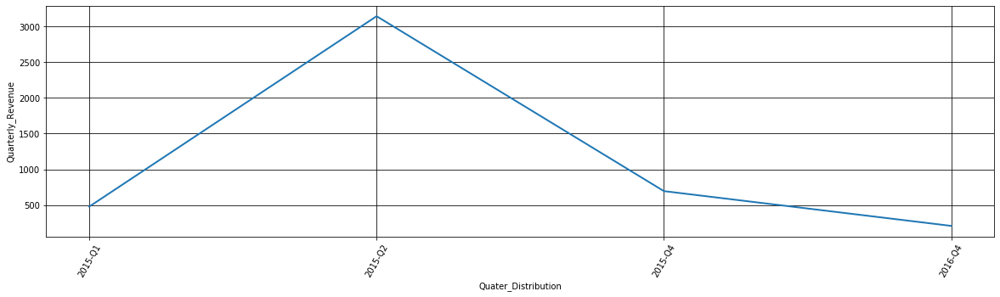

Quarterly revenue trend for the State of Uttar Pradesh


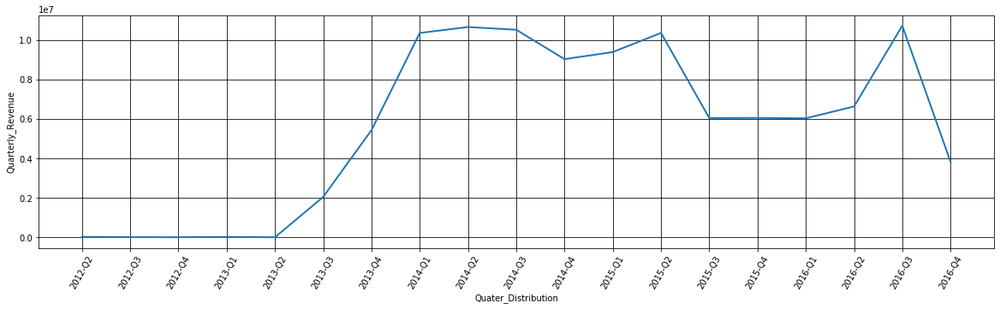

Quarterly revenue trend for the State of Uttarakhand


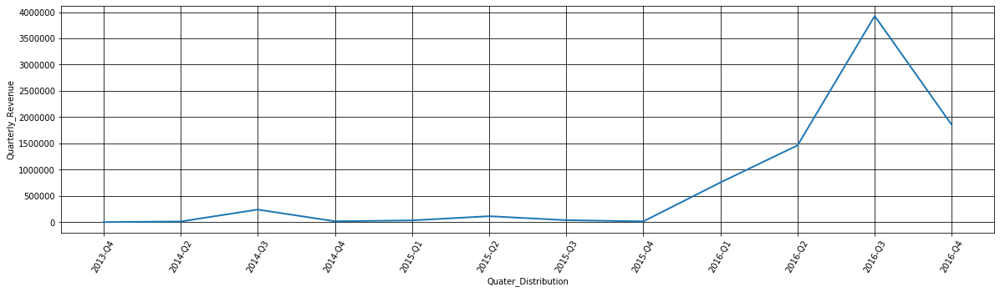

Quarterly revenue trend for the State of West Bengal


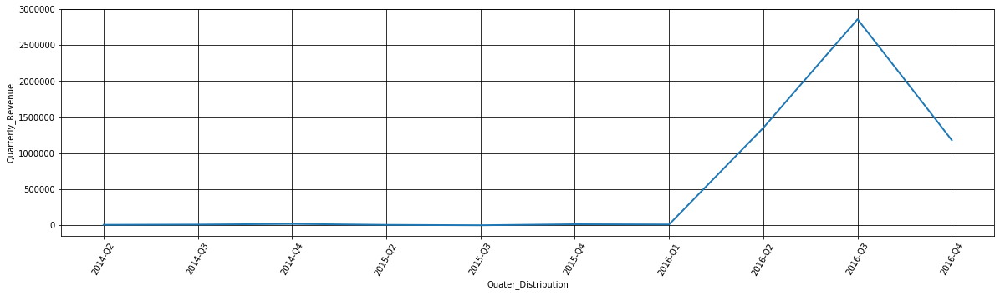

In [47]:
for i in m['District'].unique():
    state = i
    quart_cnt = list(m[m['District']== i]['Quart_revenue'].values)
    quart_lable = list(m[m['District']== i]['JobCard Date'].values)
    print('Quarterly revenue trend for the State of '+state)
    scatter_plot(quart_cnt,quart_lable,'Quater_Distribution','Quarterly_Revenue')

# From the Quarterly trend per state (Need to rectify)

1. Data seems incomplete for the states of NE India and J&K.

2. For AP, TN and MH, it's a downward trend in terms of total revenue

3. For Gujrat, Q1 to Q2 is upward trend and Q2 to Q3 to Q4 is downward trend. Trend is uniform in terms of pattern across 2014, 2015 and 2016.

4. For Haryana, 2016 Q1-Q2 and Q3 were most fruitful but trend experienced sudden fall towards 2016-Q4. There might be some reason for its rise at the start of 2016 and sudden fall at the end of 2016.

5. For KA, peak revenue was experienced once during 2015-Q2.

6. For KE, sudden drop from peak revenue was observed from 2014-Q4 to 2015-Q1.

7. For PB, peak revenue was experienced once during 2015-Q4 and then a  sudden fall in 2016-Q1. There must be some reason.

# Count of Customers spending during a quarter in each state

In [48]:
n = pd.DataFrame(cust_inv_data.groupby(['District','JobCard Date'])['Customer No.'].count()).reset_index()
n.columns = ['District','JobCard Date','Quart_cnt']
n.head()

,District,JobCard Date,Quart_cnt
0,Andaman and Nico.In.,2015-Q3,1
1,Andaman and Nico.In.,2015-Q4,3
2,Andaman and Nico.In.,2016-Q3,4
3,Andhra Pradesh,2012-Q2,620
4,Andhra Pradesh,2012-Q3,893


Quarterly customer count trend for the State of Andaman and Nico.In.


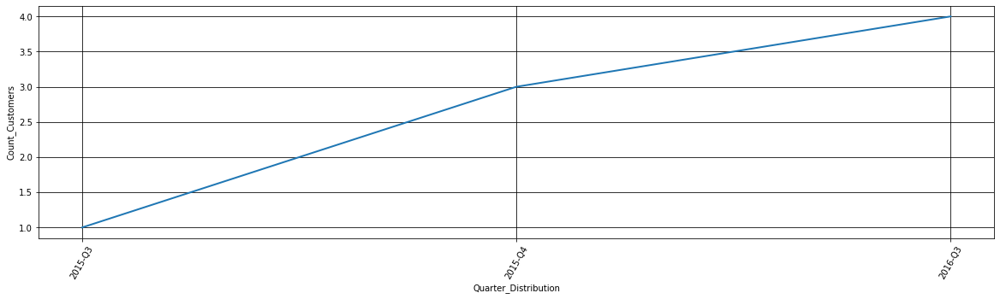

Quarterly customer count trend for the State of Andhra Pradesh


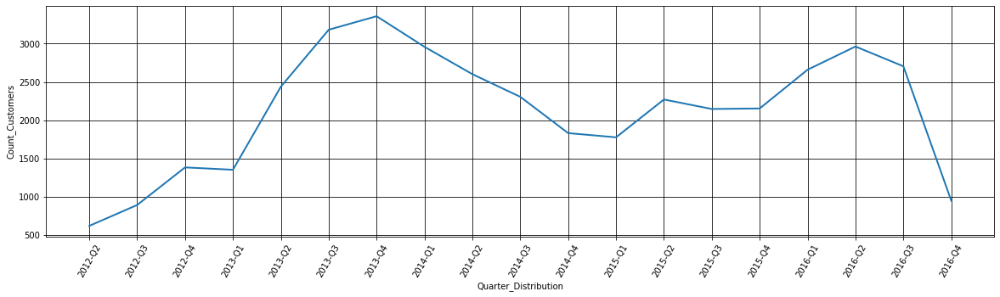

Quarterly customer count trend for the State of Arunachal Pradesh


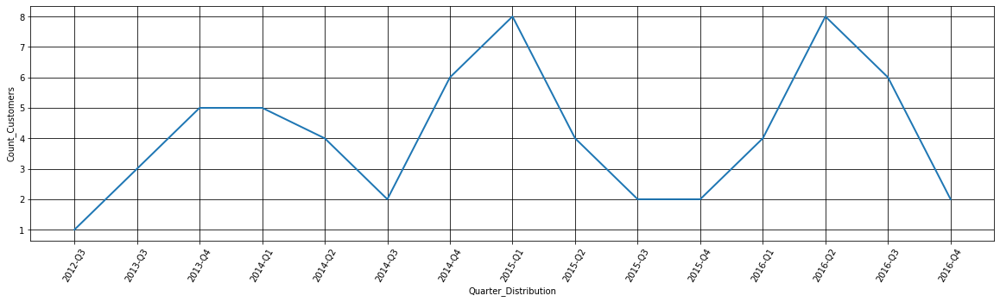

Quarterly customer count trend for the State of Assam


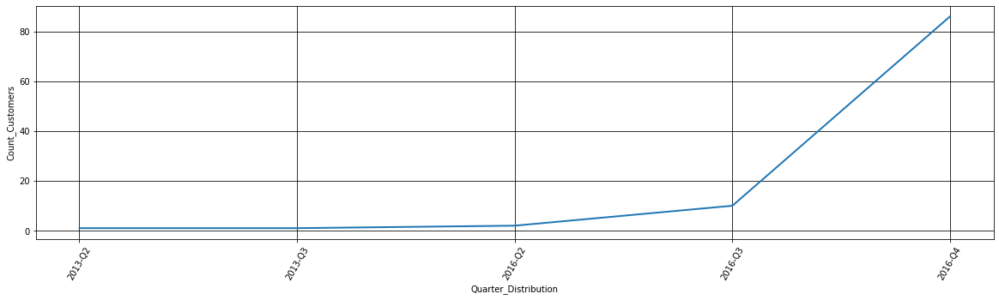

Quarterly customer count trend for the State of Bihar


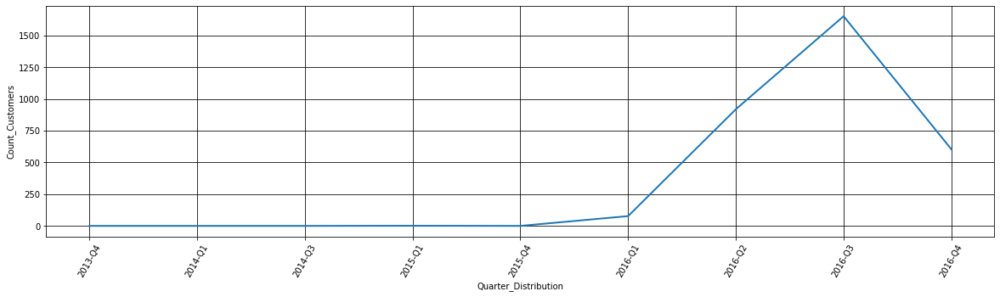

Quarterly customer count trend for the State of Chandigarh


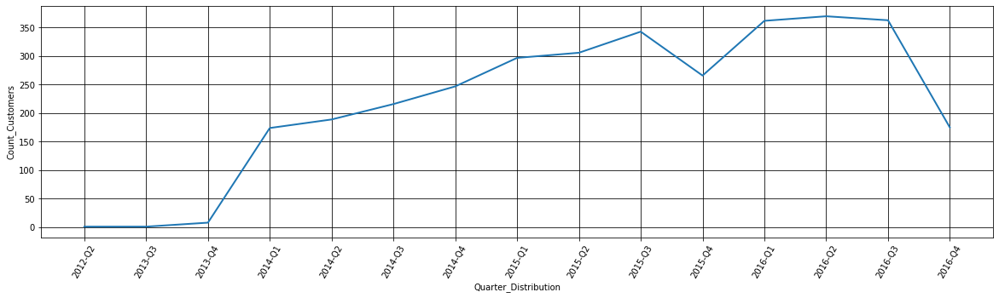

Quarterly customer count trend for the State of Chhattisgarh


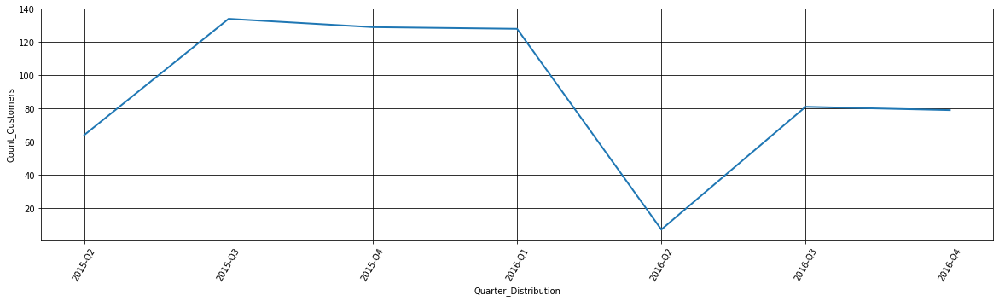

Quarterly customer count trend for the State of Dadra and Nagar Hav.


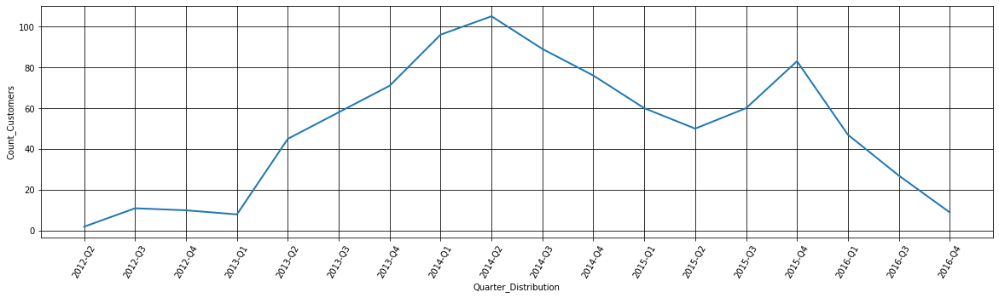

Quarterly customer count trend for the State of Daman and Diu


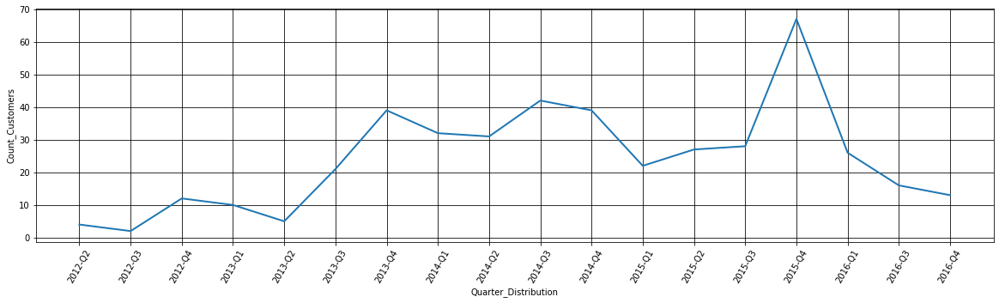

Quarterly customer count trend for the State of Delhi


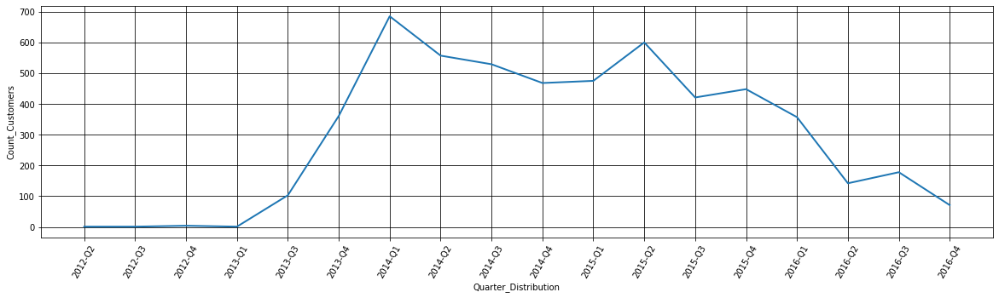

Quarterly customer count trend for the State of Goa


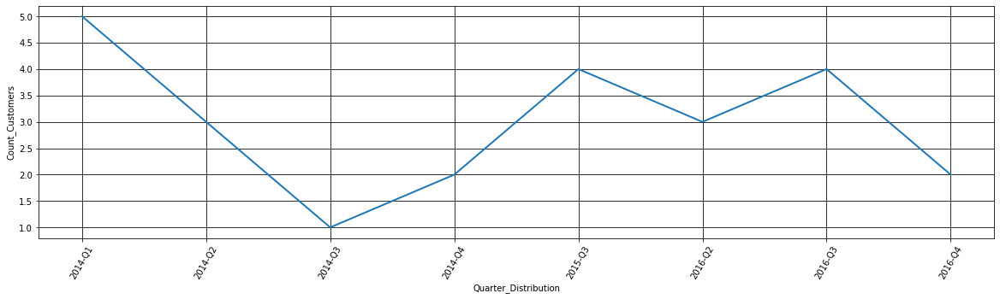

Quarterly customer count trend for the State of Gujarat


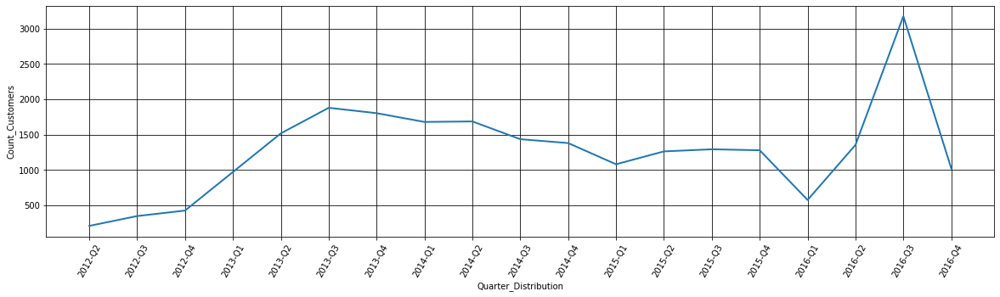

Quarterly customer count trend for the State of Haryana


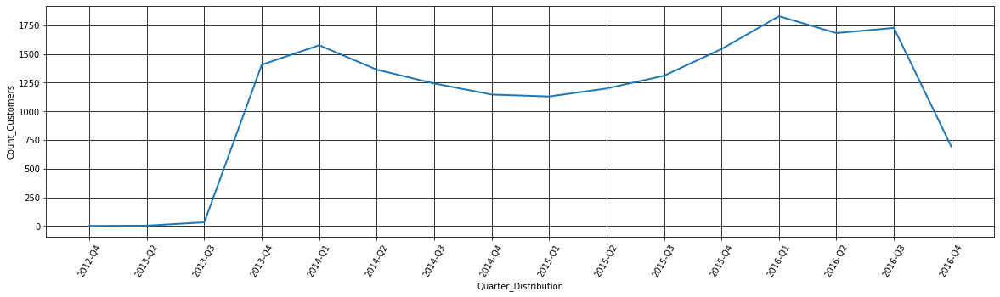

Quarterly customer count trend for the State of Himachal Pradesh


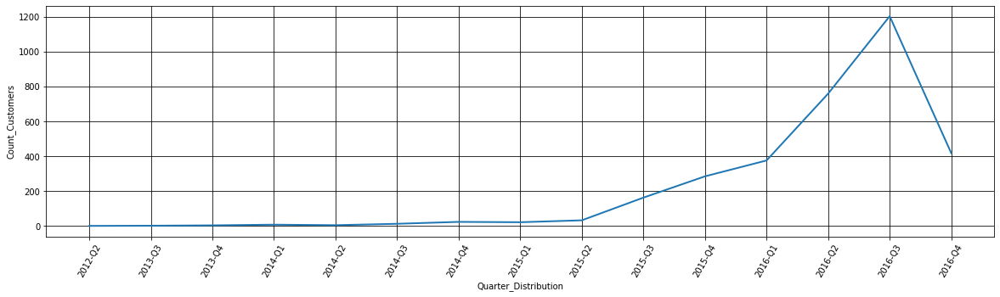

Quarterly customer count trend for the State of Jammu and Kashmir


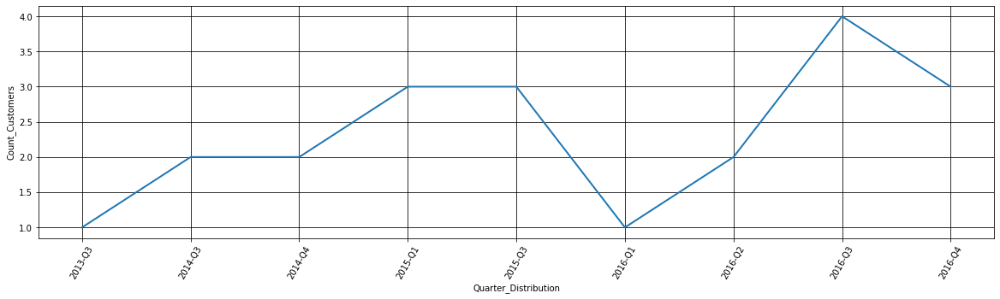

Quarterly customer count trend for the State of Jharkhand


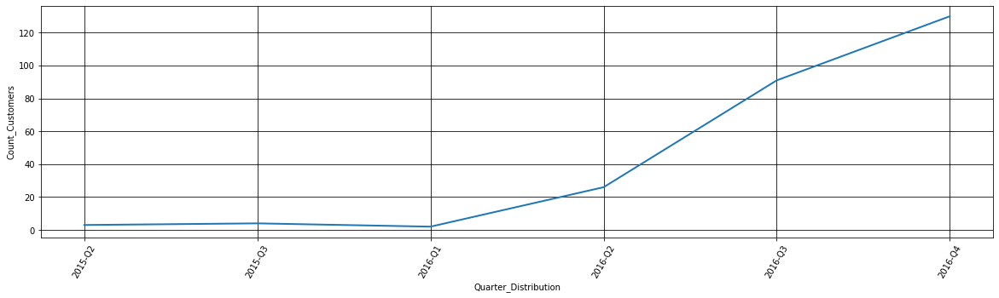

Quarterly customer count trend for the State of Karnataka


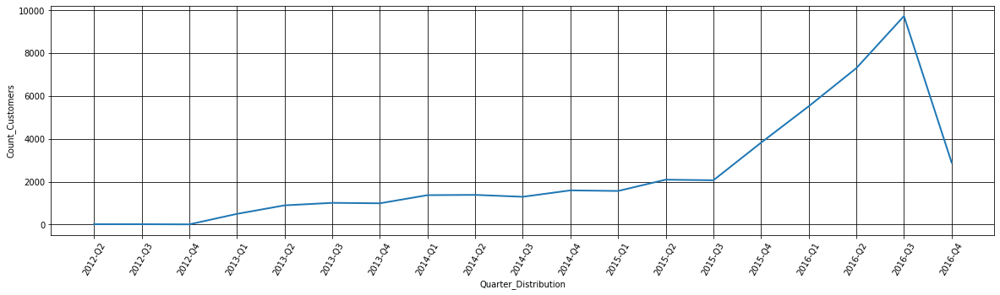

Quarterly customer count trend for the State of Kerala


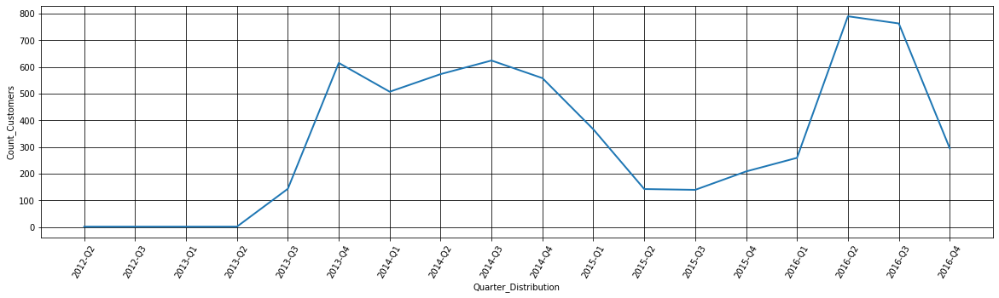

Quarterly customer count trend for the State of Lakshadweep


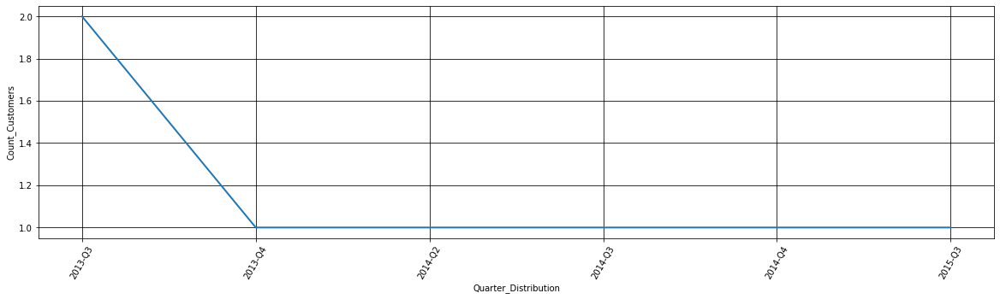

Quarterly customer count trend for the State of Madhya Pradesh


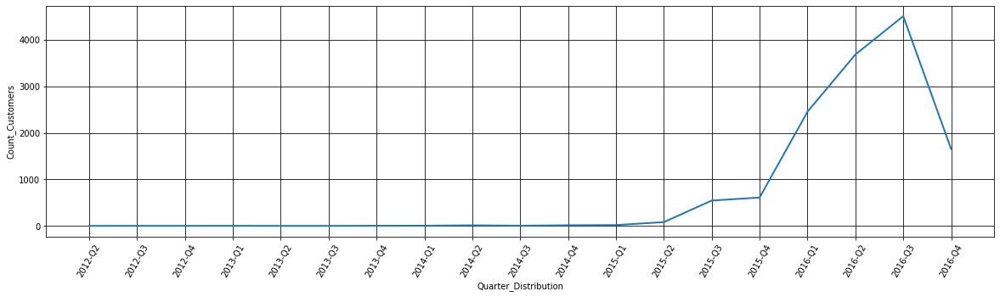

Quarterly customer count trend for the State of Maharashtra


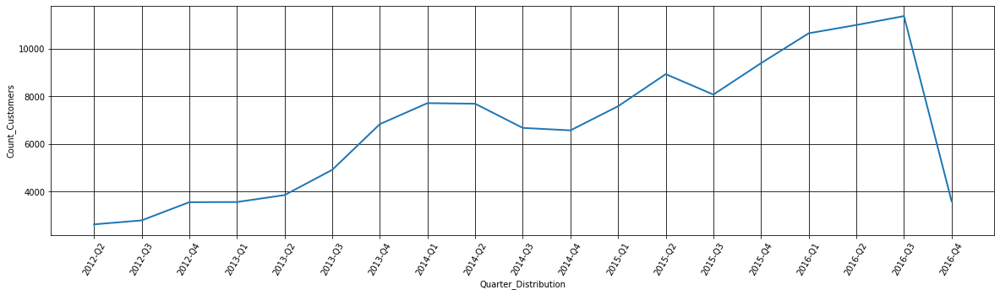

Quarterly customer count trend for the State of Manipur


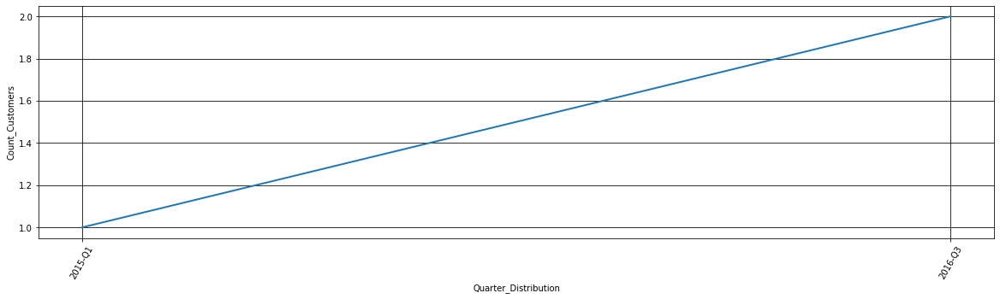

Quarterly customer count trend for the State of Megalaya


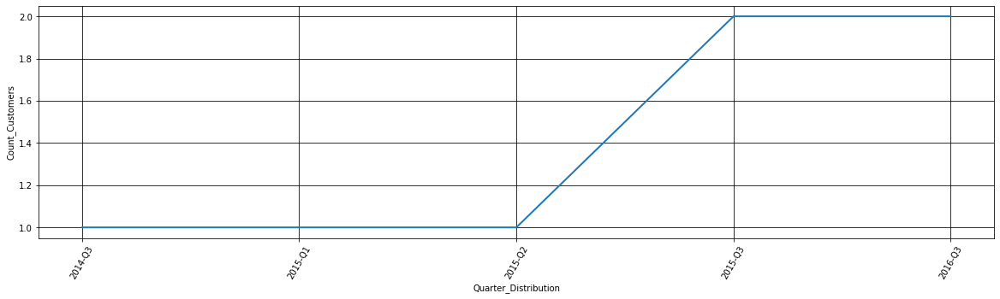

Quarterly customer count trend for the State of Mizoram


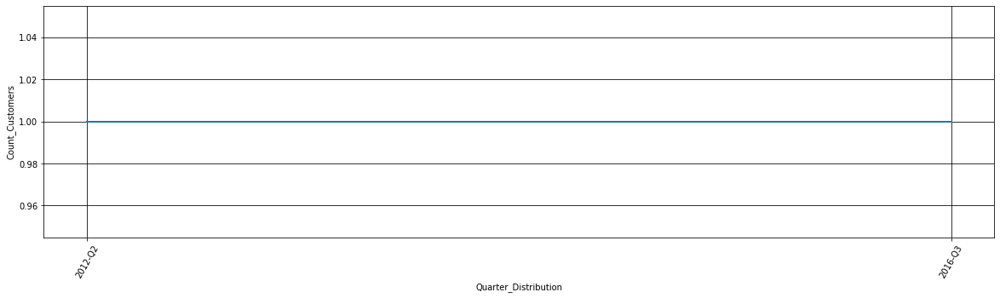

Quarterly customer count trend for the State of Nagaland


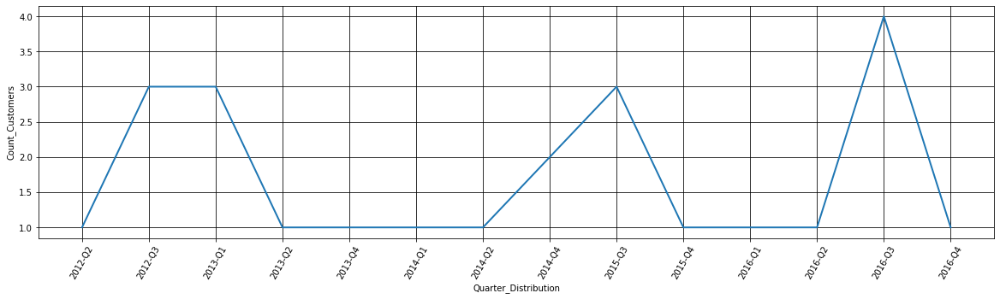

Quarterly customer count trend for the State of Odisha


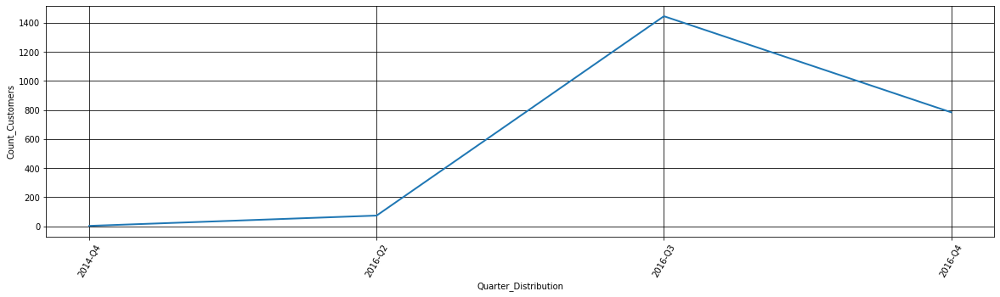

Quarterly customer count trend for the State of Puducherry


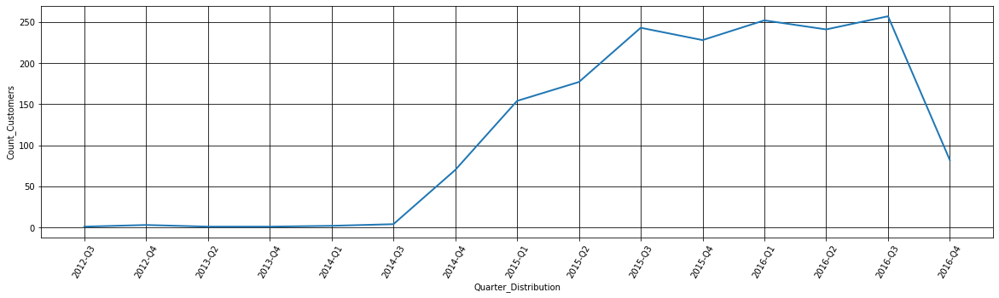

Quarterly customer count trend for the State of Punjab


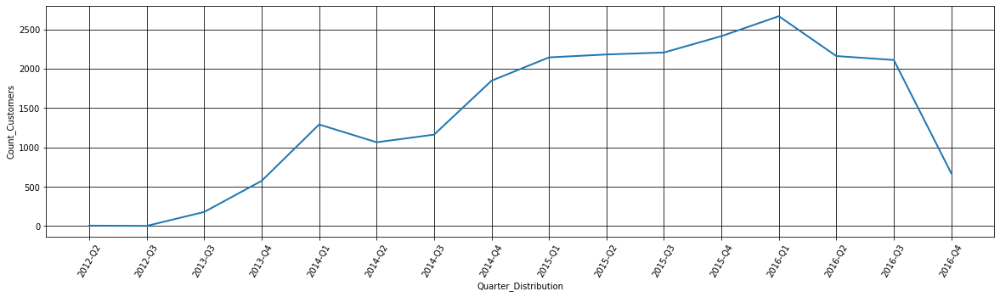

Quarterly customer count trend for the State of Rajasthan


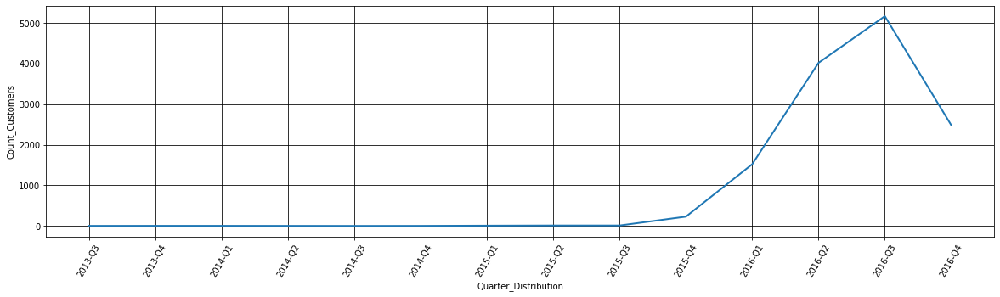

Quarterly customer count trend for the State of Sikkim


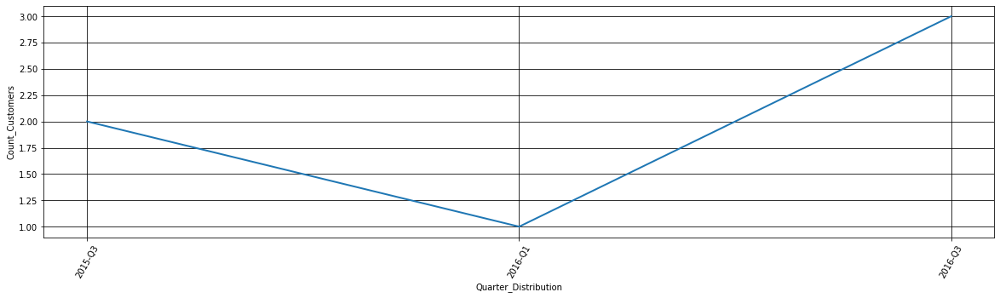

Quarterly customer count trend for the State of Tamil Nadu


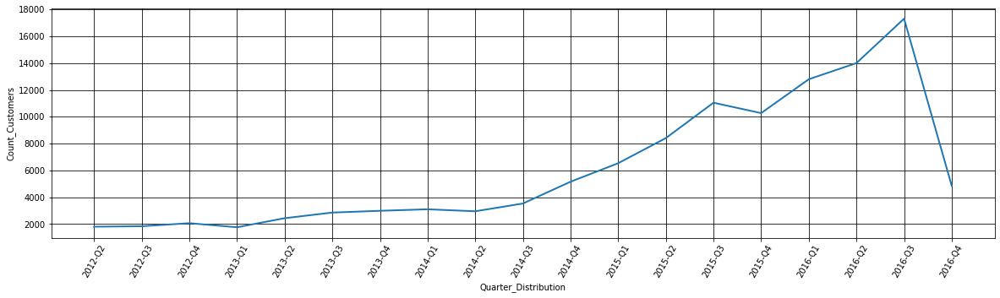

Quarterly customer count trend for the State of Telangana


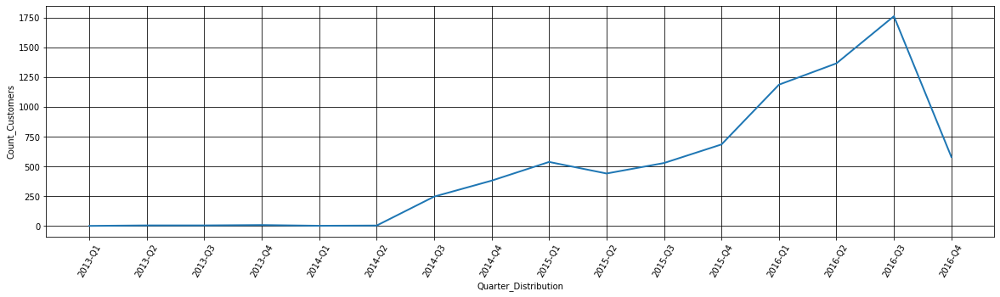

Quarterly customer count trend for the State of Tripura


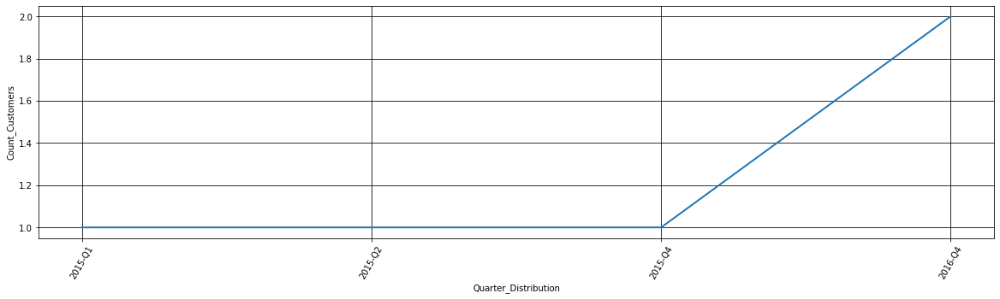

Quarterly customer count trend for the State of Uttar Pradesh


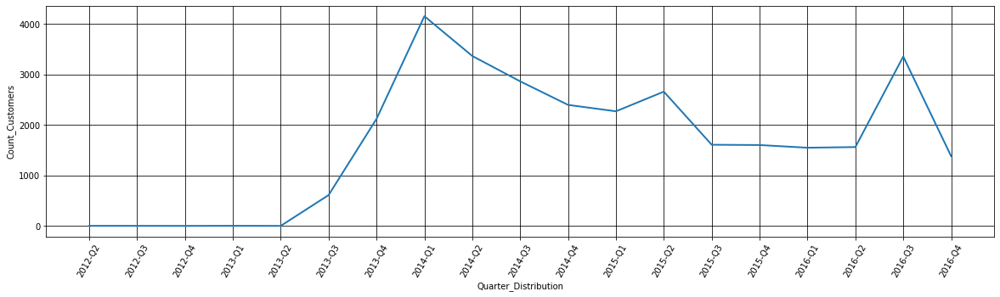

Quarterly customer count trend for the State of Uttarakhand


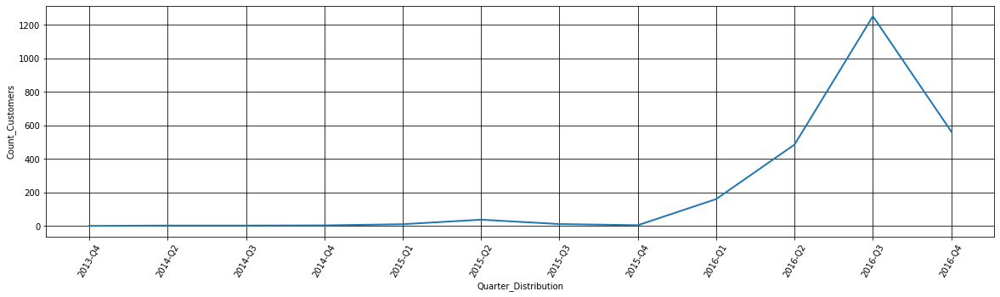

Quarterly customer count trend for the State of West Bengal


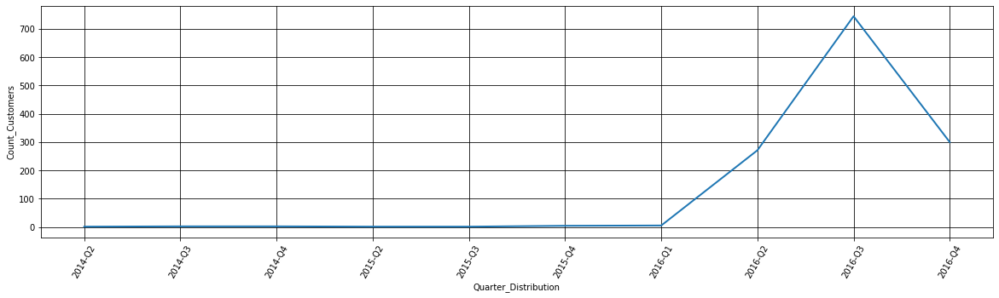

In [49]:
for i in m['District'].unique():
    state = i
    quart_cnt = list(n[n['District']== i]['Quart_cnt'].values)
    quart_lable = list(n[n['District']== i]['JobCard Date'].values)
    print('Quarterly customer count trend for the State of '+state)
    scatter_plot(quart_cnt,quart_lable,'Quarter_Distribution','Count_Customers')

# From count of customers per quarter per state (Need to rectify)

1. Data seems incomplete for the states of extreme North and North East.

2. Most of the states shows downward trend in terms of customer footfall between 2016 Q3 to Q4.

3. Nagaland typically shows complete flat tred in during odd years (2013, 2015) but sudden increase in early quarters and sudden fall in late quarters of even years (2012, 2016).

4. State of Telangana, WB, UT, TN showing exponential growth from the late 2013 and touching their peak performance once till 2016-Q3.

# Average spent per make per state and highest cost per make per state

In [50]:
o = pd.DataFrame(cust_inv_data.groupby(['District','Make'])['Total Amt Wtd Tax.'].mean()).reset_index()
o.columns = ['District','Make','Quart_rev_mean']
o.sort_values(['District','Quart_rev_mean'], ascending=[1,0], inplace=True)
o.head()

,District,Make,Quart_rev_mean
0,Andaman and Nico.In.,FIAT,14539.435000
1,Andaman and Nico.In.,MAHINDRA & MAHINDRA,12820.430000
3,Andaman and Nico.In.,TOYOTA,2094.690000
2,Andaman and Nico.In.,MARUTI SUZUKI,304.310000
4,Andhra Pradesh,AUDI,11126.576667


Average amount spent per make for the state of Andaman and Nico.In.


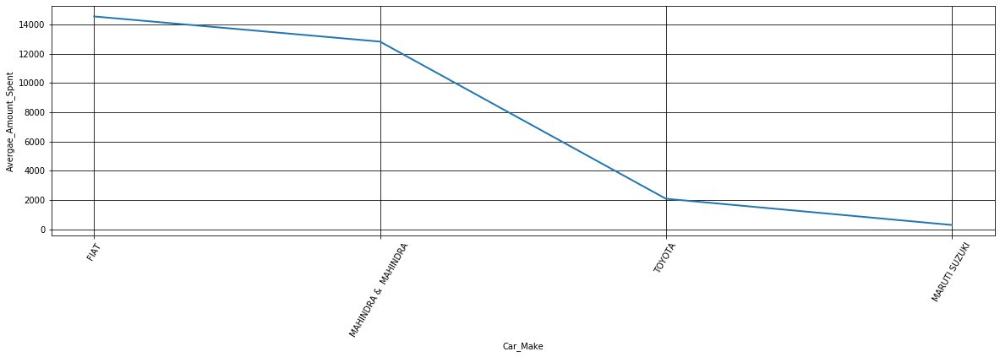

Average amount spent per make for the state of Andhra Pradesh


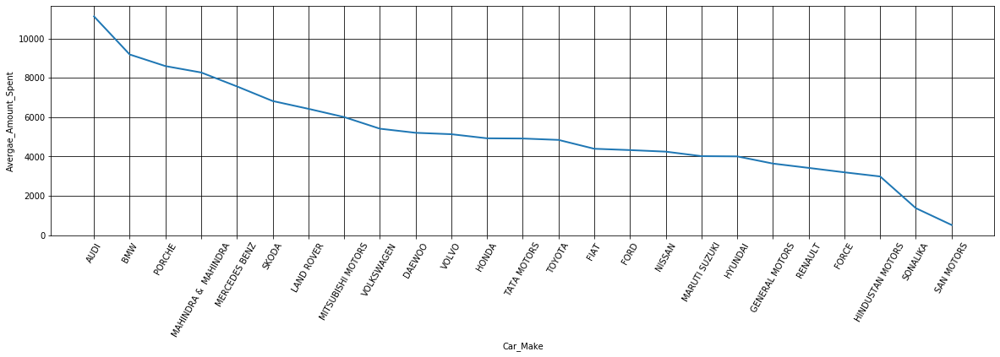

Average amount spent per make for the state of Arunachal Pradesh


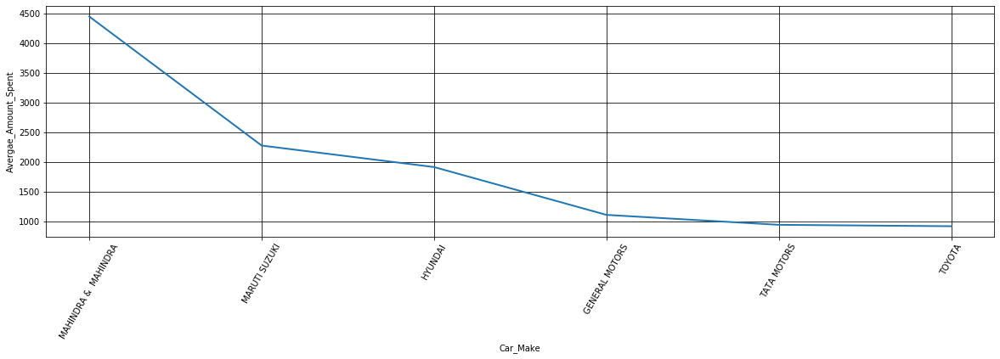

Average amount spent per make for the state of Assam


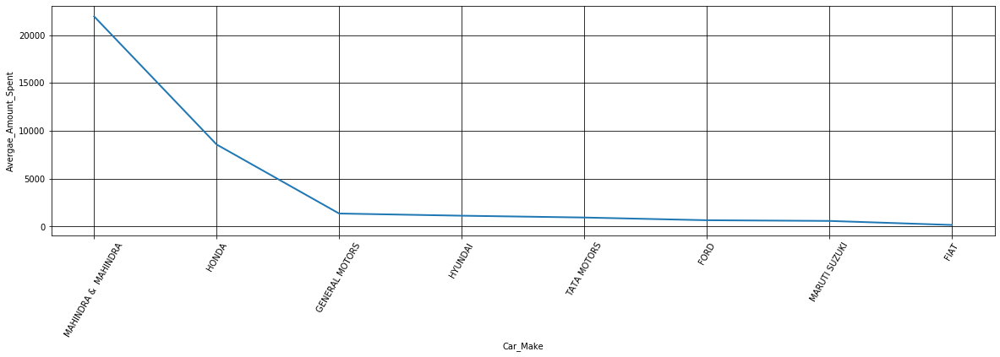

Average amount spent per make for the state of Bihar


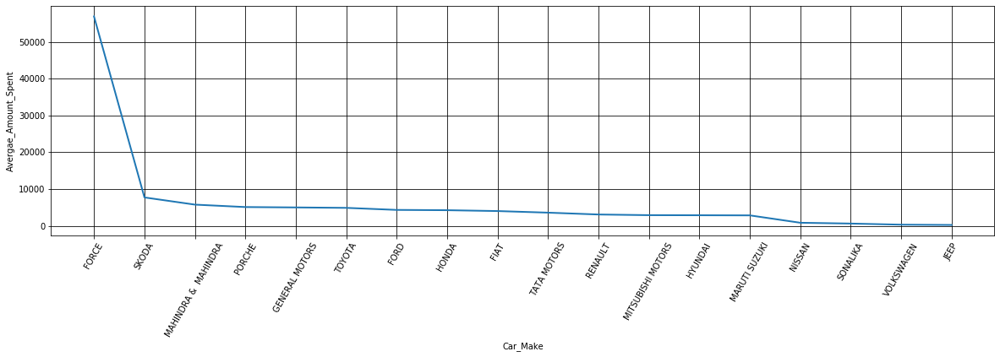

Average amount spent per make for the state of Chandigarh


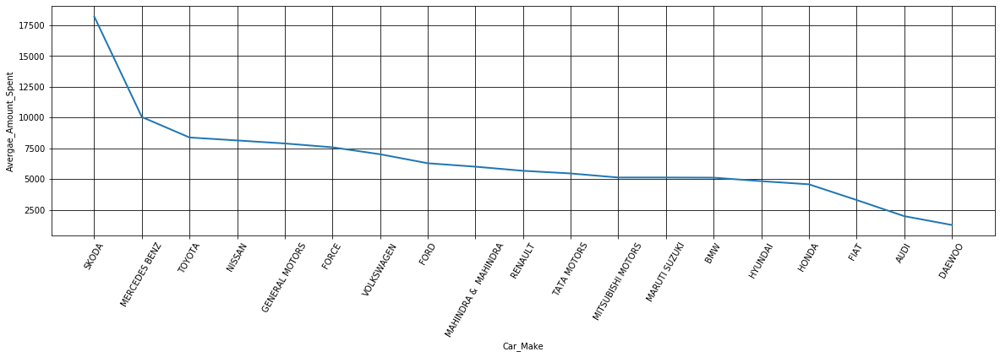

Average amount spent per make for the state of Chhattisgarh


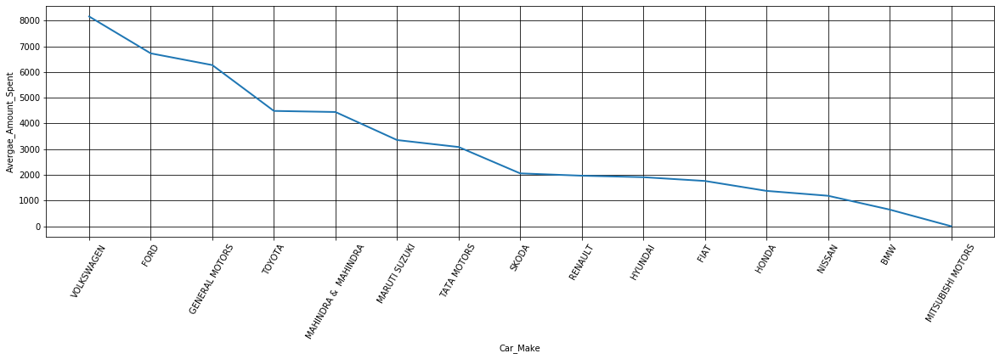

Average amount spent per make for the state of Dadra and Nagar Hav.


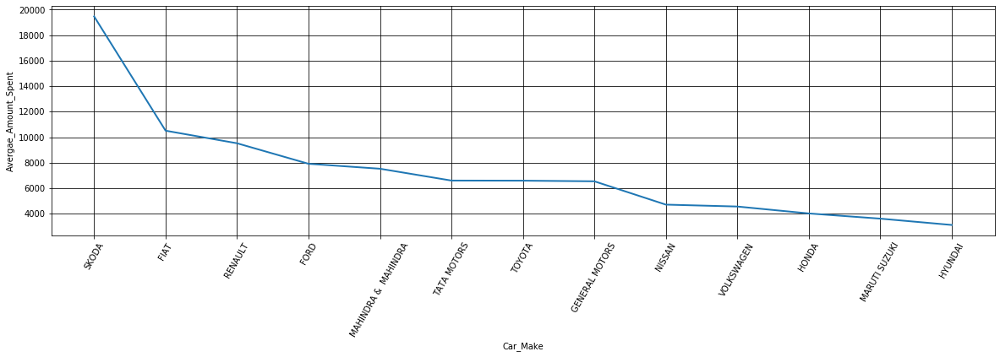

Average amount spent per make for the state of Daman and Diu


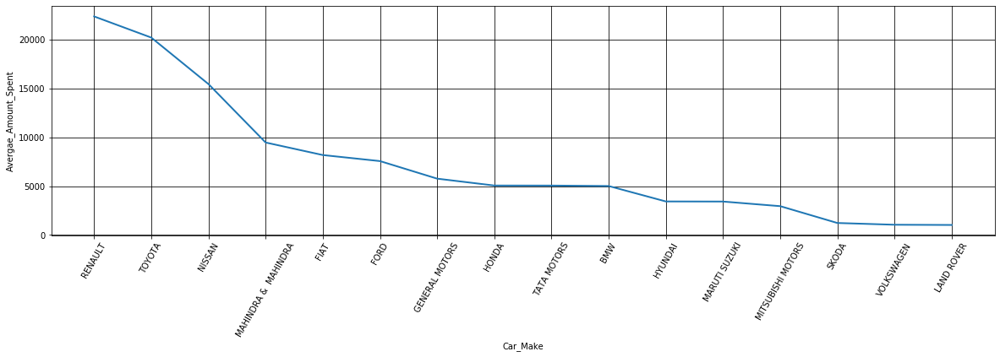

Average amount spent per make for the state of Delhi


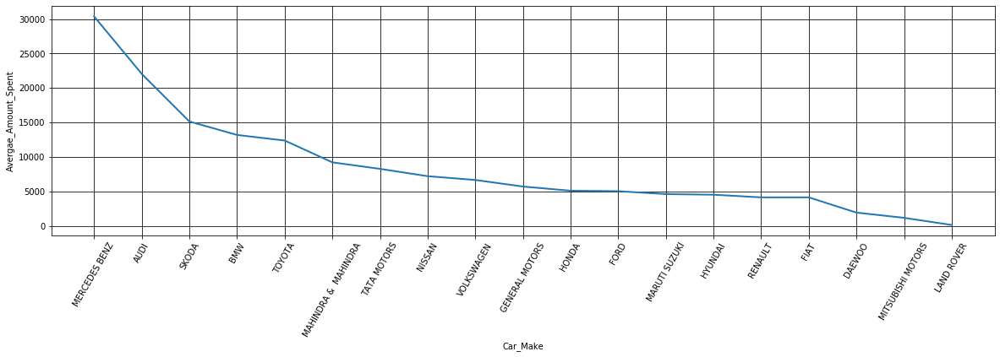

Average amount spent per make for the state of Goa


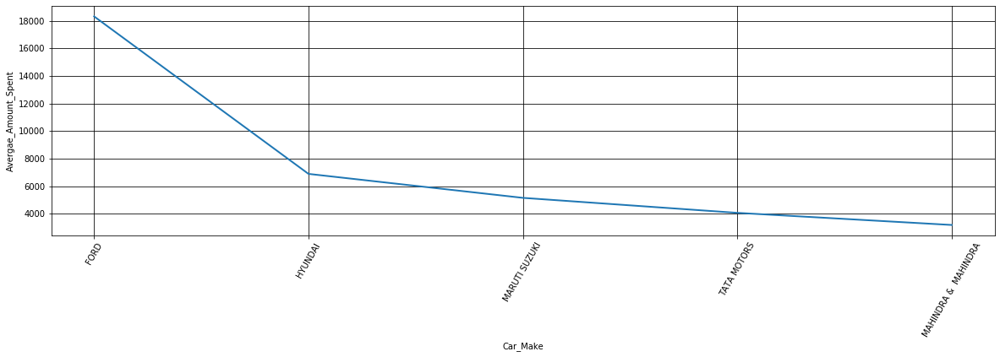

Average amount spent per make for the state of Gujarat


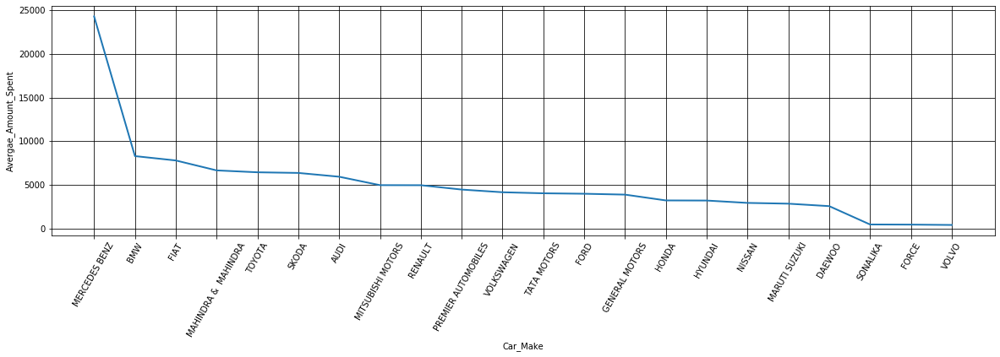

Average amount spent per make for the state of Haryana


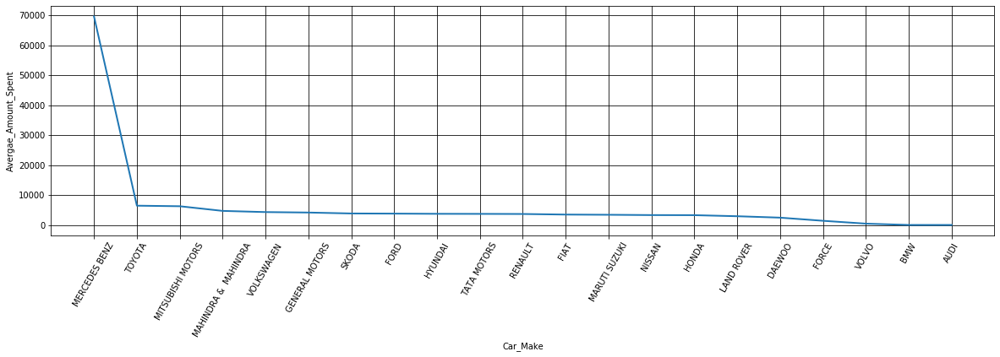

Average amount spent per make for the state of Himachal Pradesh


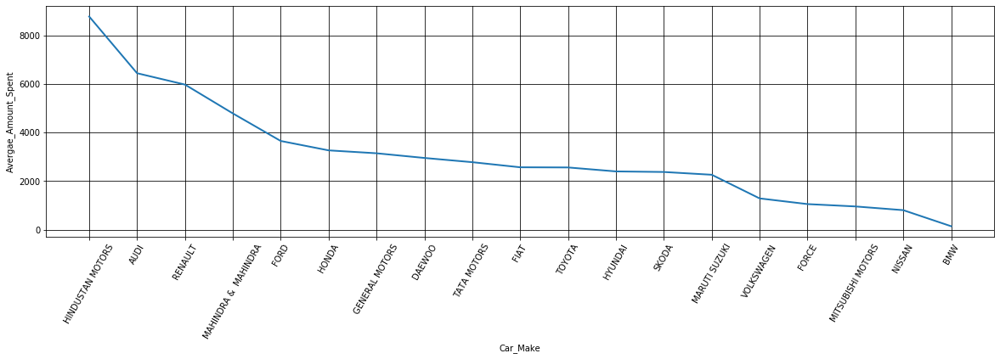

Average amount spent per make for the state of Jammu and Kashmir


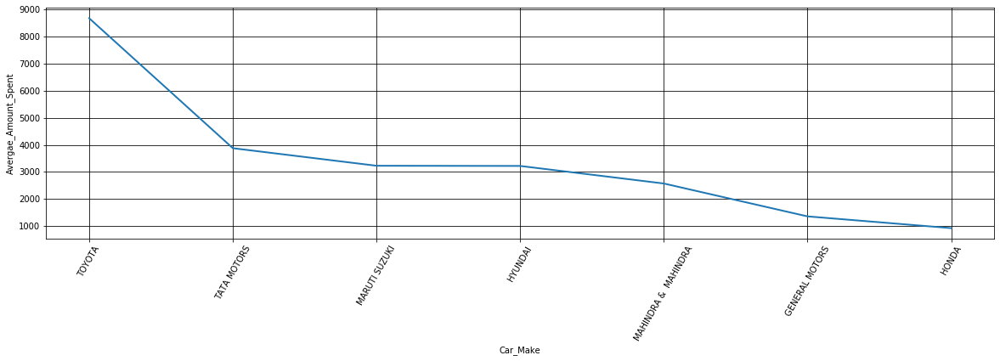

Average amount spent per make for the state of Jharkhand


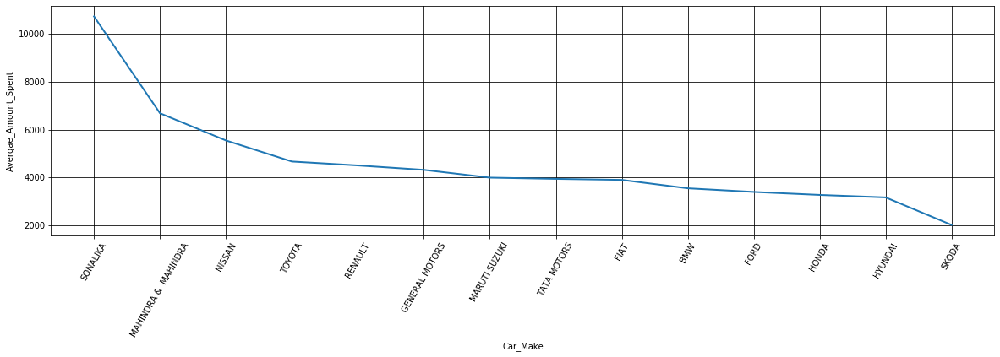

Average amount spent per make for the state of Karnataka


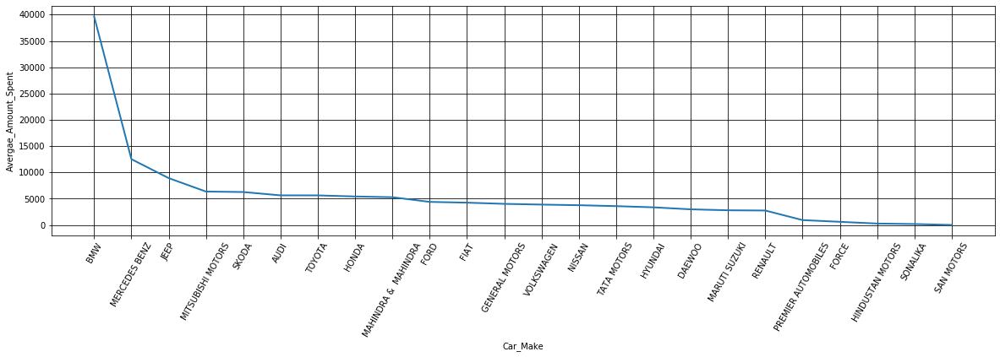

Average amount spent per make for the state of Kerala


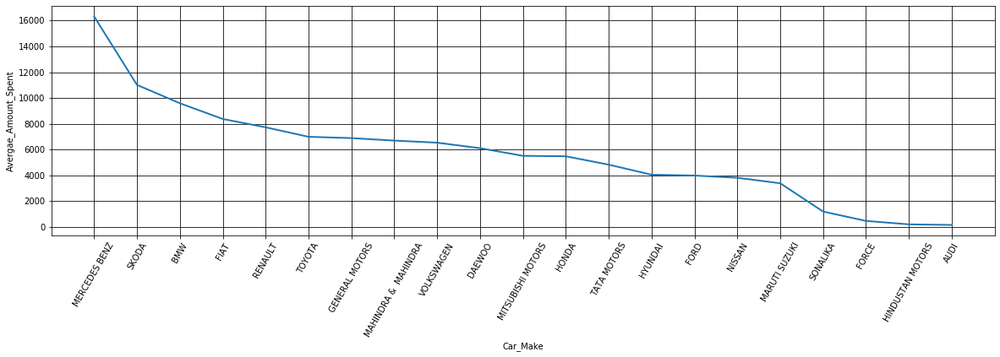

Average amount spent per make for the state of Lakshadweep


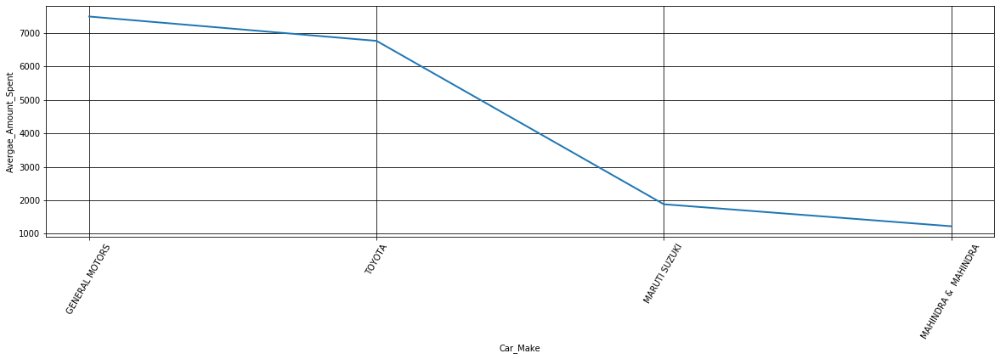

Average amount spent per make for the state of Madhya Pradesh


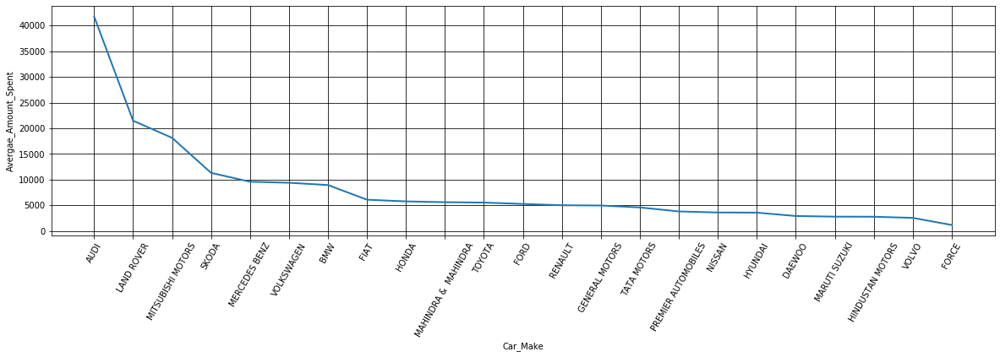

Average amount spent per make for the state of Maharashtra


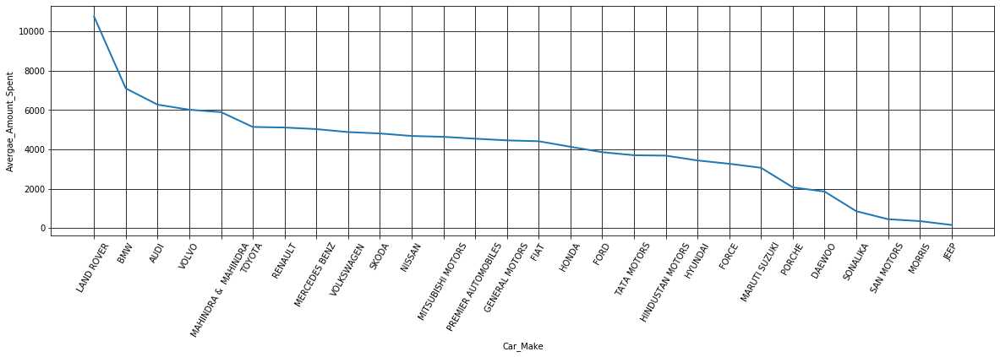

Average amount spent per make for the state of Manipur


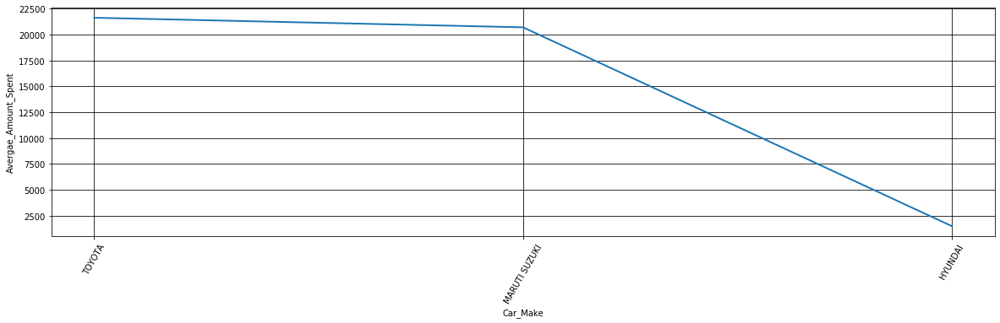

Average amount spent per make for the state of Megalaya


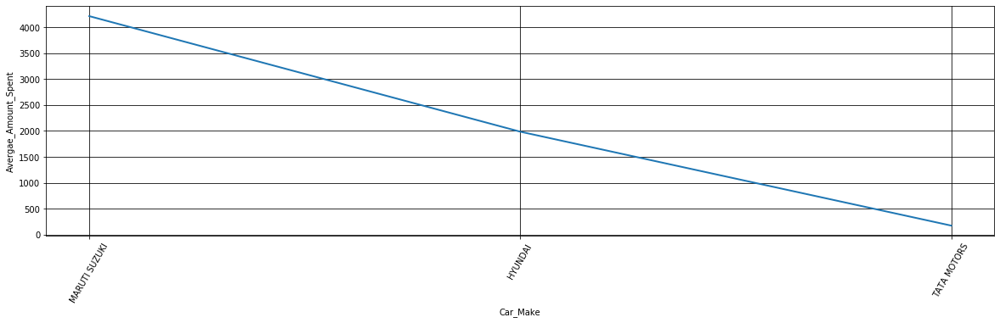

Average amount spent per make for the state of Mizoram


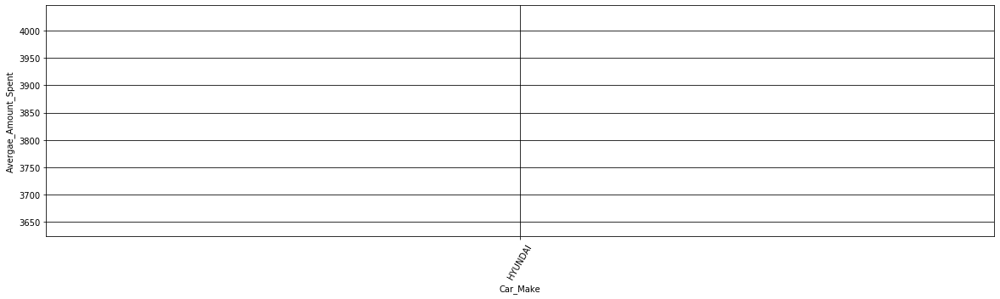

Average amount spent per make for the state of Nagaland


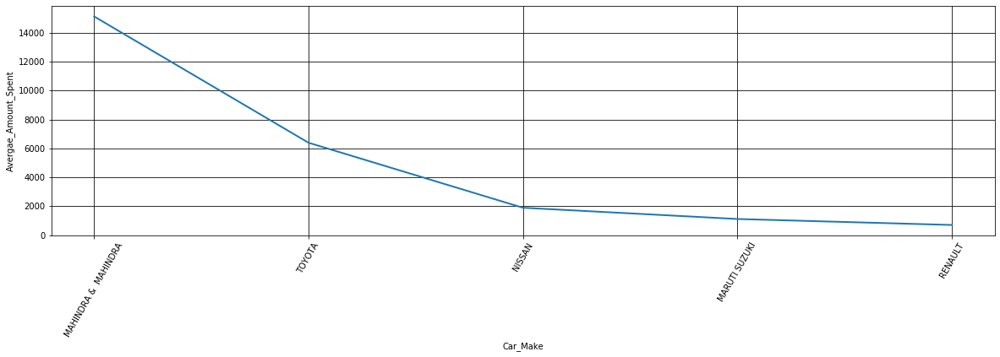

Average amount spent per make for the state of Odisha


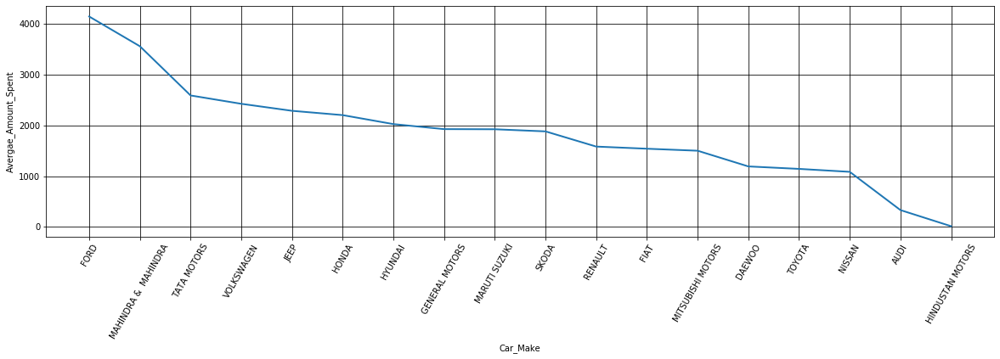

Average amount spent per make for the state of Puducherry


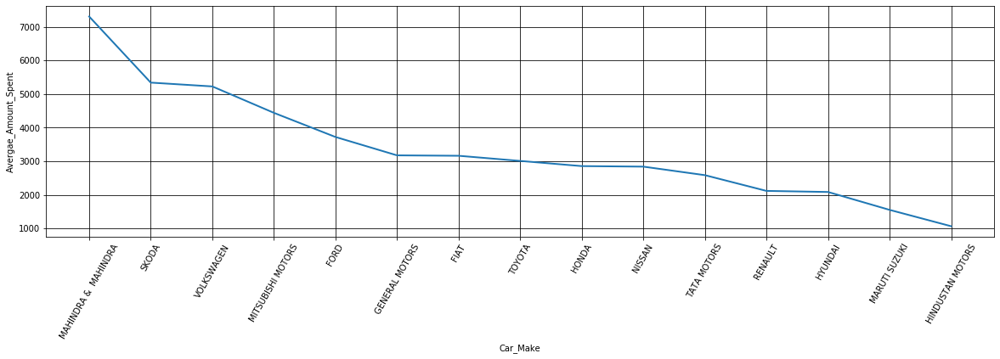

Average amount spent per make for the state of Punjab


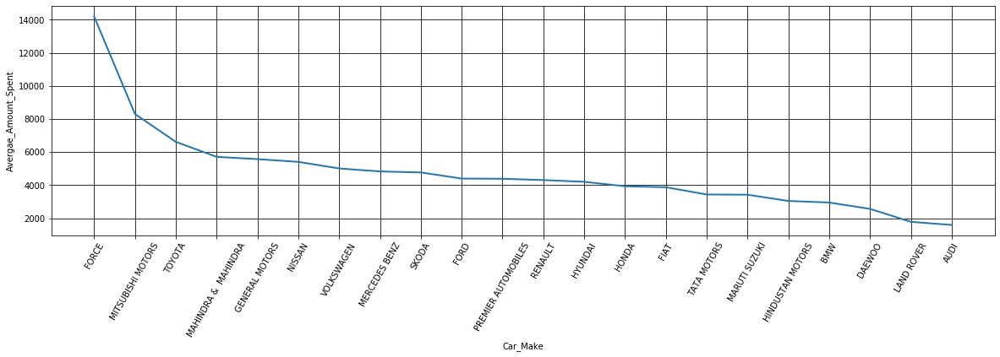

Average amount spent per make for the state of Rajasthan


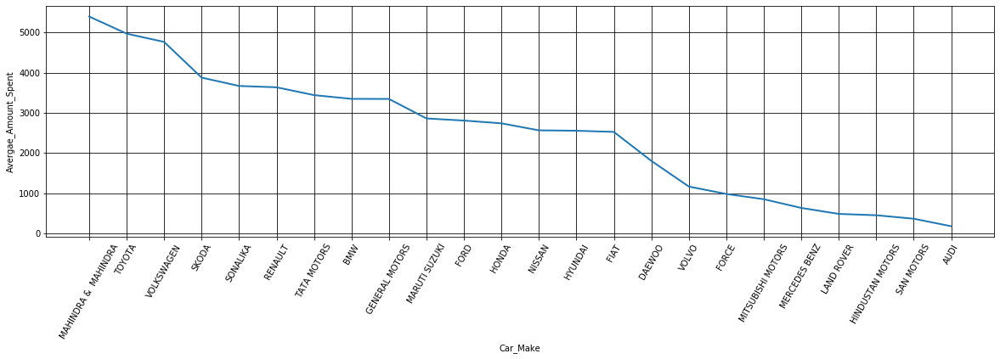

Average amount spent per make for the state of Sikkim


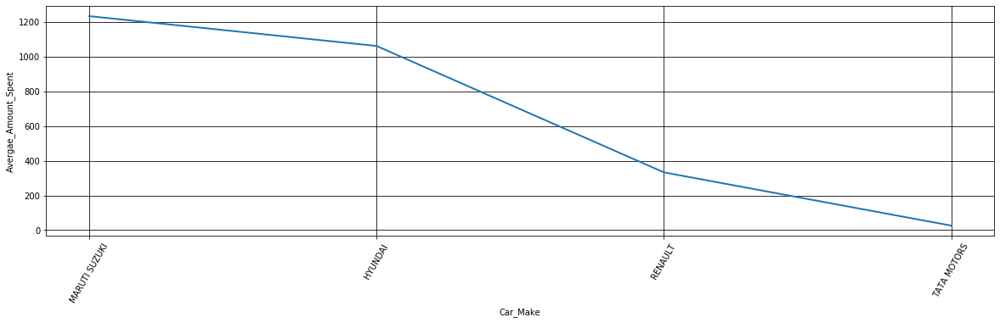

Average amount spent per make for the state of Tamil Nadu


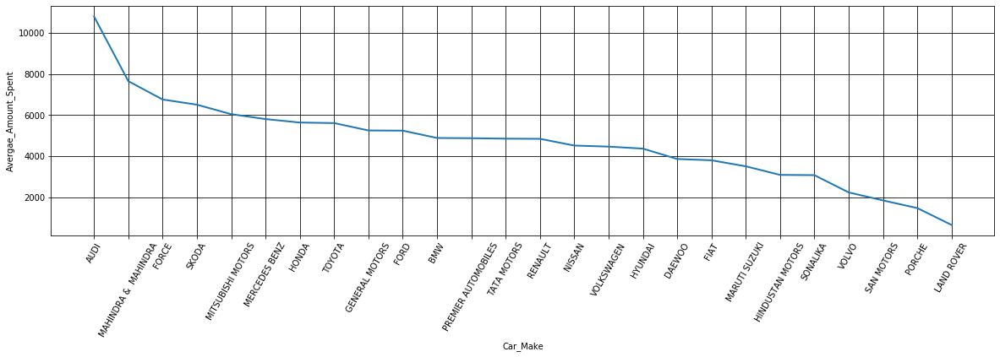

Average amount spent per make for the state of Telangana


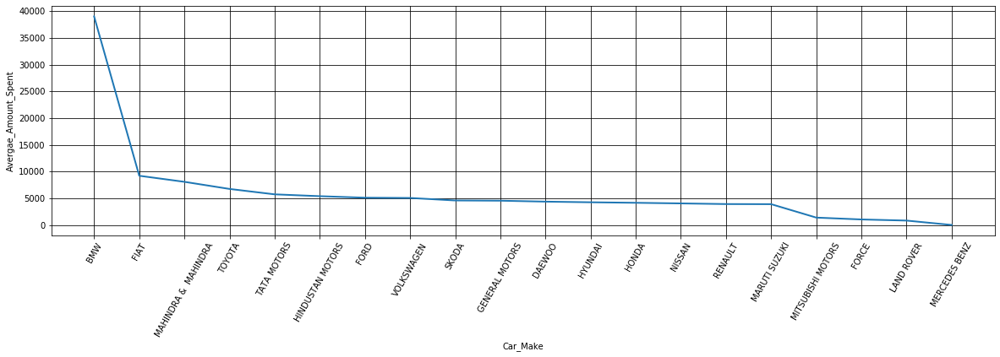

Average amount spent per make for the state of Tripura


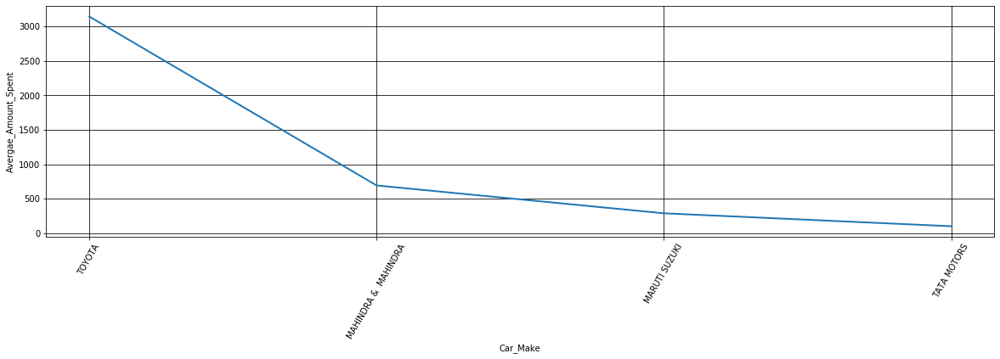

Average amount spent per make for the state of Uttar Pradesh


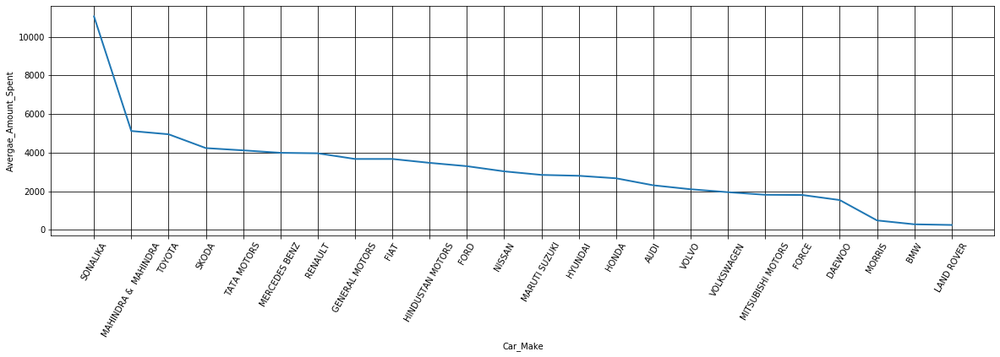

Average amount spent per make for the state of Uttarakhand


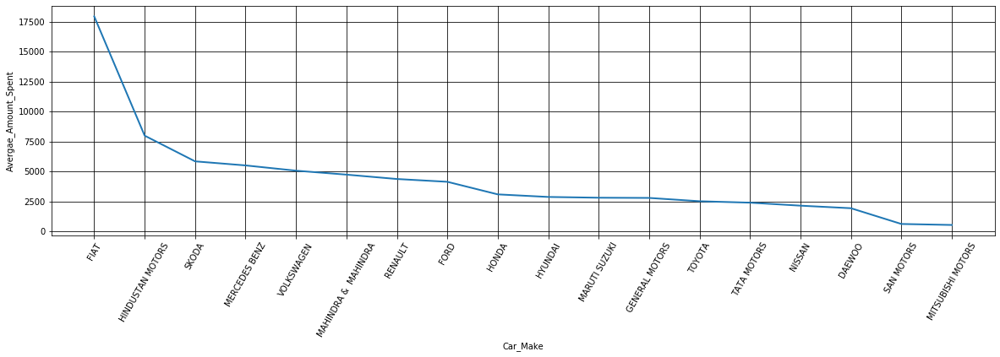

Average amount spent per make for the state of West Bengal


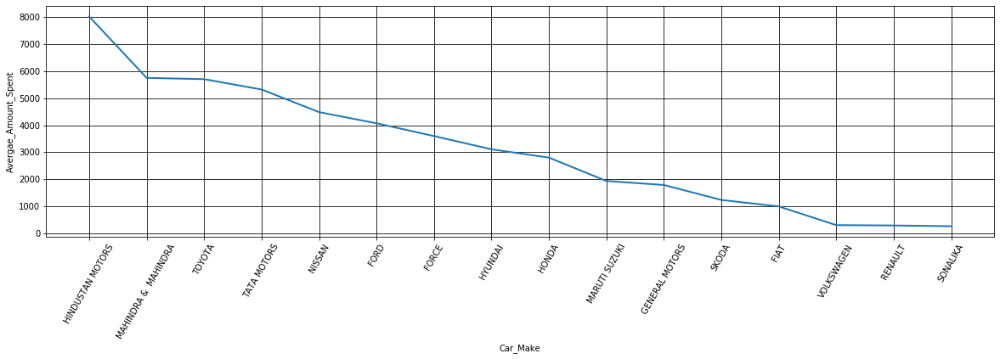

In [51]:
for i in o['District'].unique():
    state = i
    quart_cnt = list(o[o['District']== i]['Quart_rev_mean'].values)
    quart_lable = list(o[o['District']== i]['Make'].values)
    print('Average amount spent per make for the state of '+state)
    scatter_plot(quart_cnt,quart_lable,'Car_Make','Avergae_Amount_Spent')

In [52]:
p = pd.DataFrame(cust_inv_data.groupby(['District','Make'])['Total Amt Wtd Tax.'].max()).reset_index()
p.columns = ['District','Make','Quart_revenue']
p.sort_values(['District','Quart_revenue'], ascending=[1,0], inplace=True)
p.head()

,District,Make,Quart_revenue
1,Andaman and Nico.In.,MAHINDRA & MAHINDRA,33518.06
0,Andaman and Nico.In.,FIAT,19970.18
3,Andaman and Nico.In.,TOYOTA,3561.25
2,Andaman and Nico.In.,MARUTI SUZUKI,304.31
26,Andhra Pradesh,TOYOTA,343837.11


Most highest amount spent per make for the state of Andaman and Nico.In.


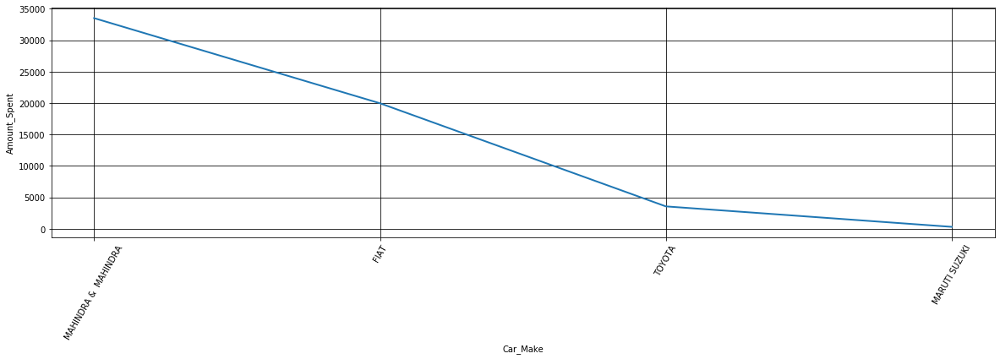

Most highest amount spent per make for the state of Andhra Pradesh


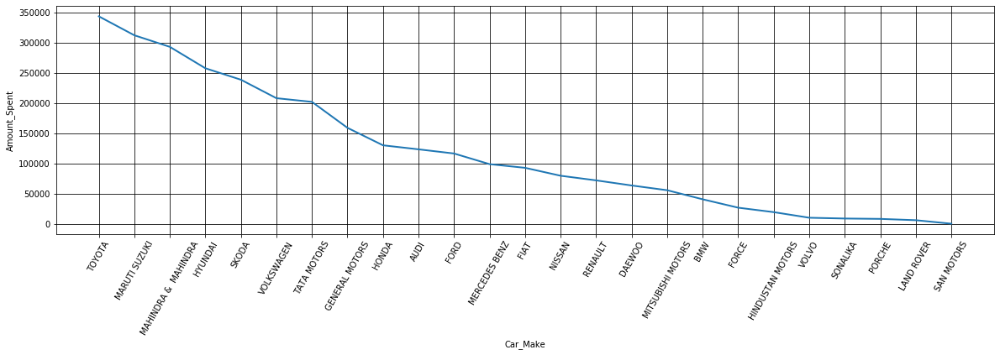

Most highest amount spent per make for the state of Arunachal Pradesh


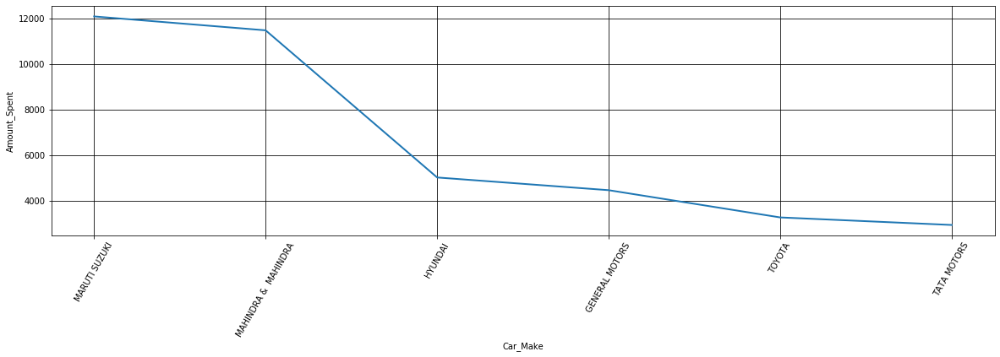

Most highest amount spent per make for the state of Assam


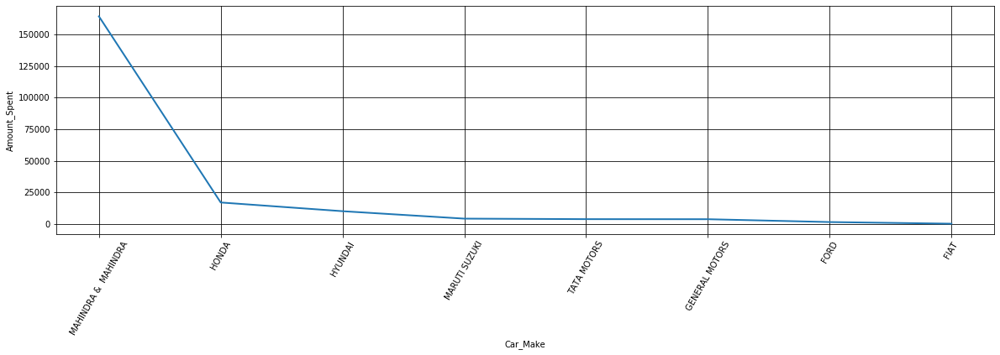

Most highest amount spent per make for the state of Bihar


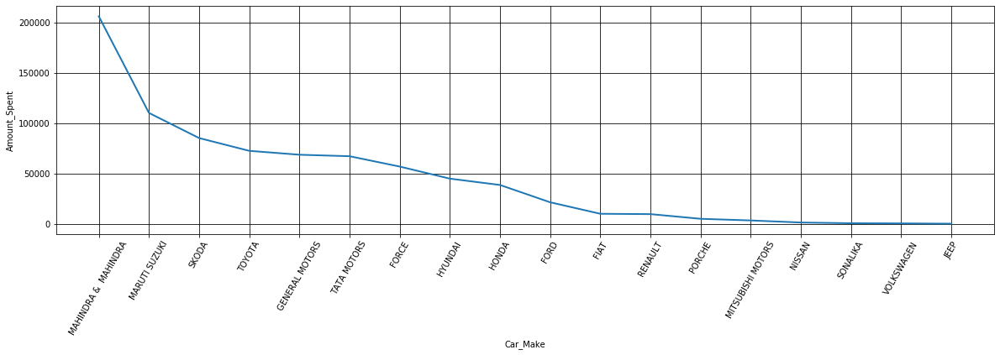

Most highest amount spent per make for the state of Chandigarh


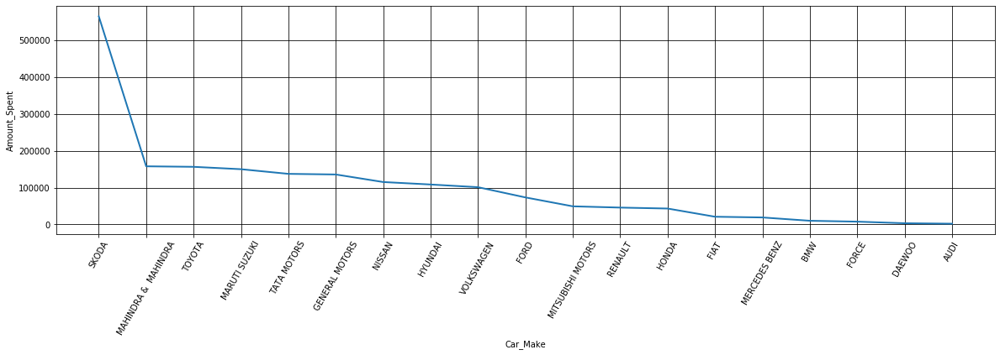

Most highest amount spent per make for the state of Chhattisgarh


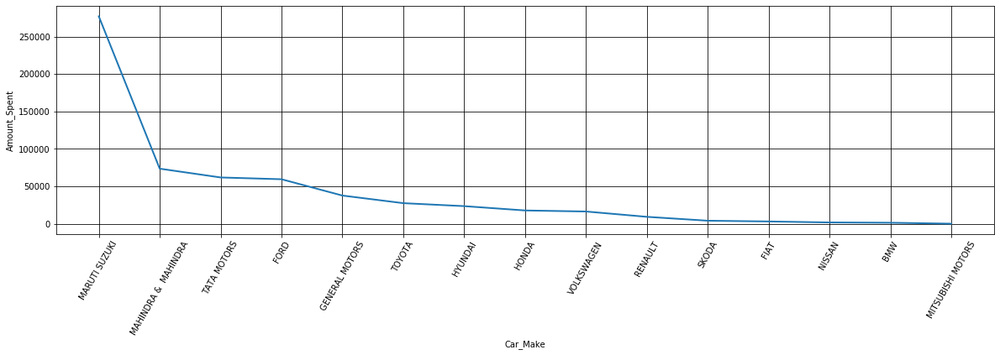

Most highest amount spent per make for the state of Dadra and Nagar Hav.


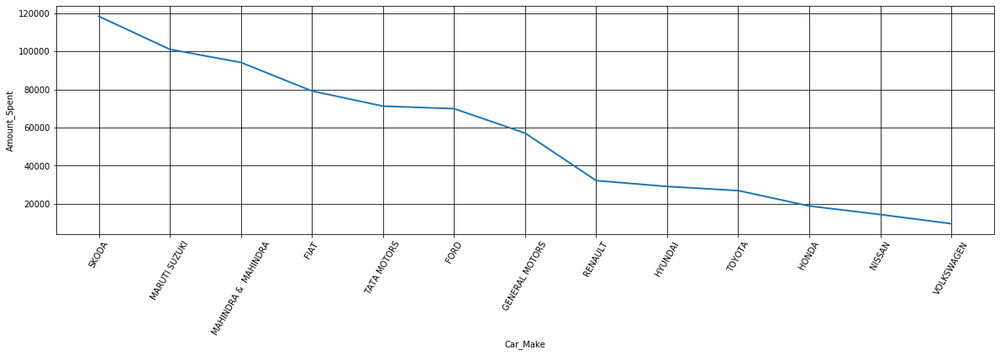

Most highest amount spent per make for the state of Daman and Diu


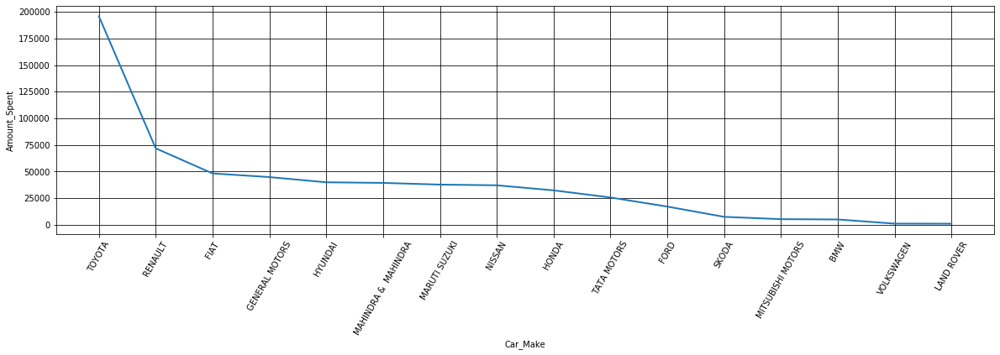

Most highest amount spent per make for the state of Delhi


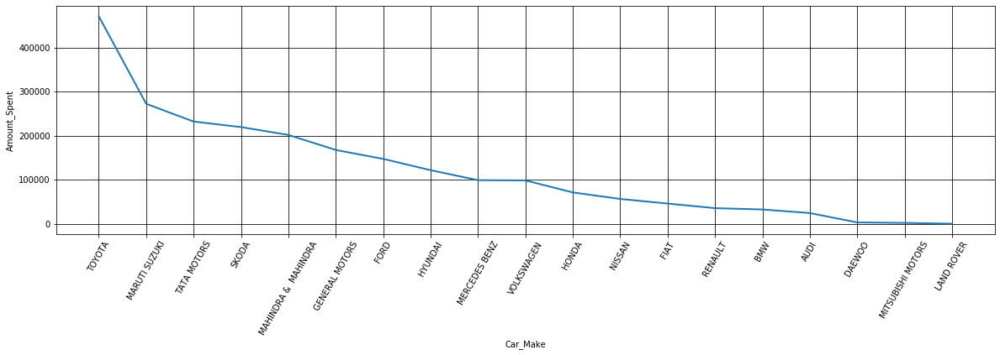

Most highest amount spent per make for the state of Goa


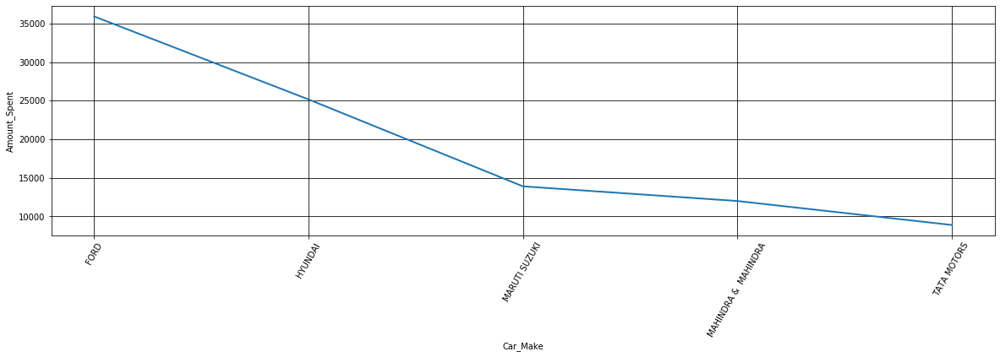

Most highest amount spent per make for the state of Gujarat


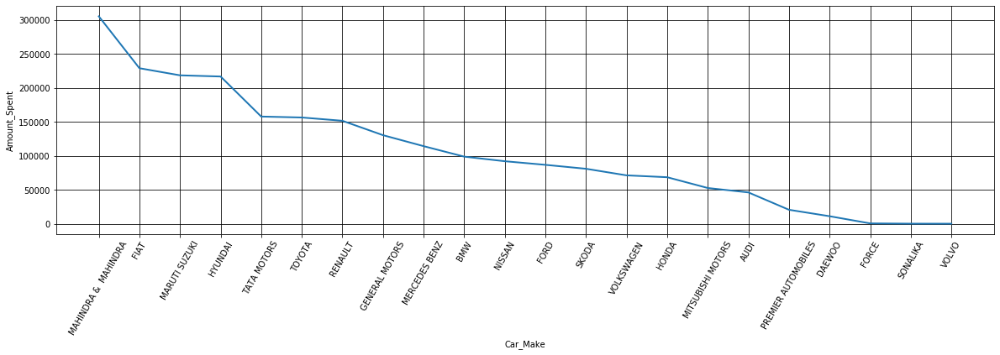

Most highest amount spent per make for the state of Haryana


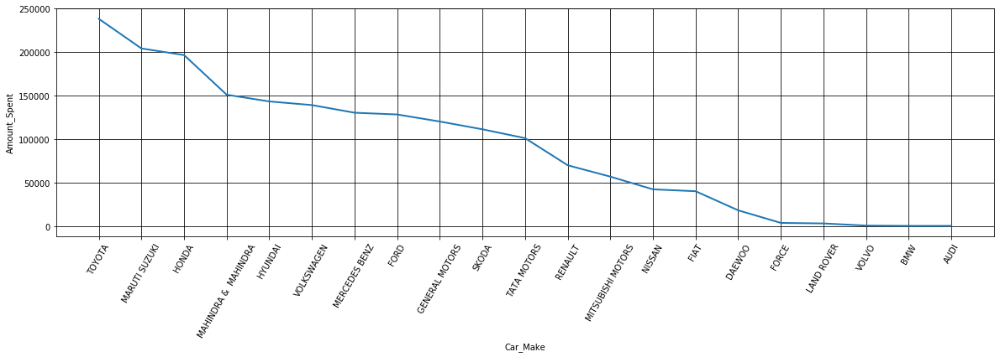

Most highest amount spent per make for the state of Himachal Pradesh


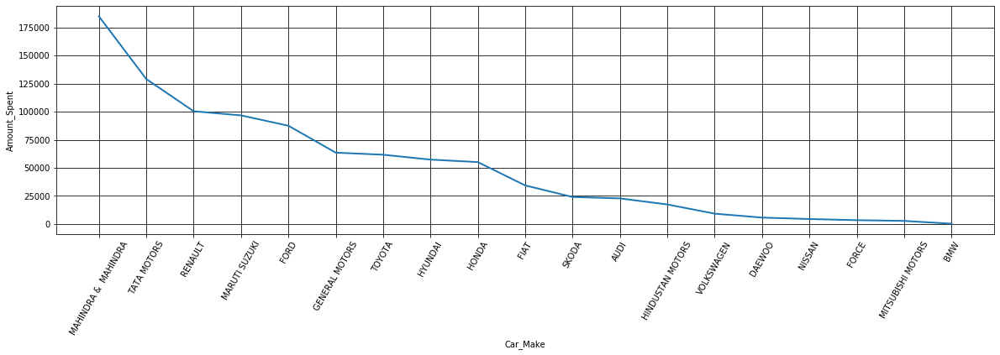

Most highest amount spent per make for the state of Jammu and Kashmir


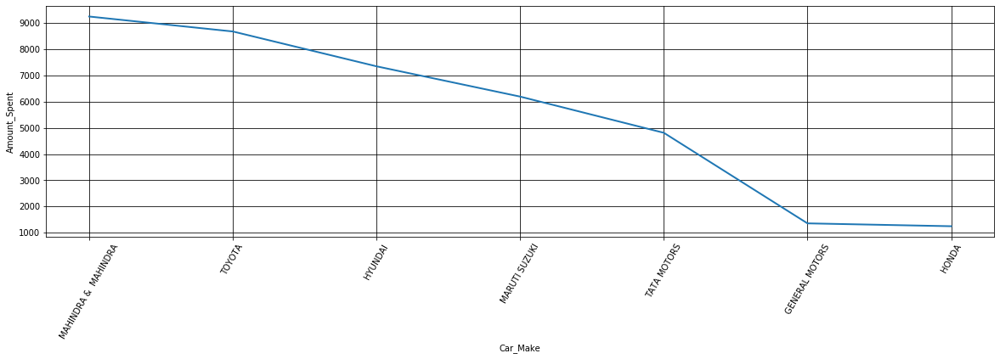

Most highest amount spent per make for the state of Jharkhand


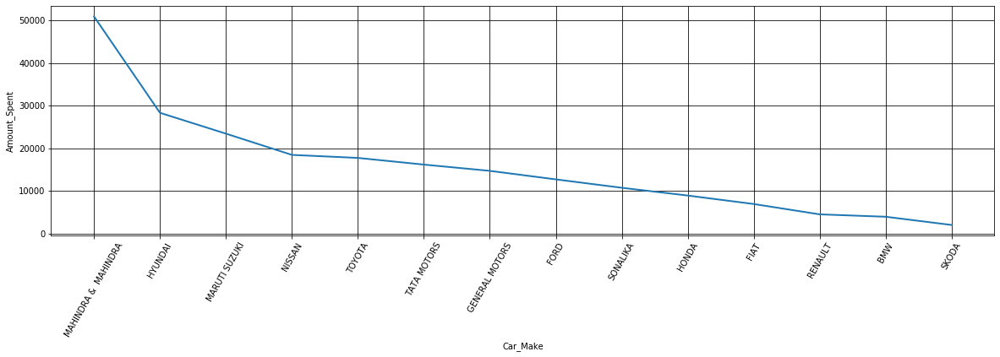

Most highest amount spent per make for the state of Karnataka


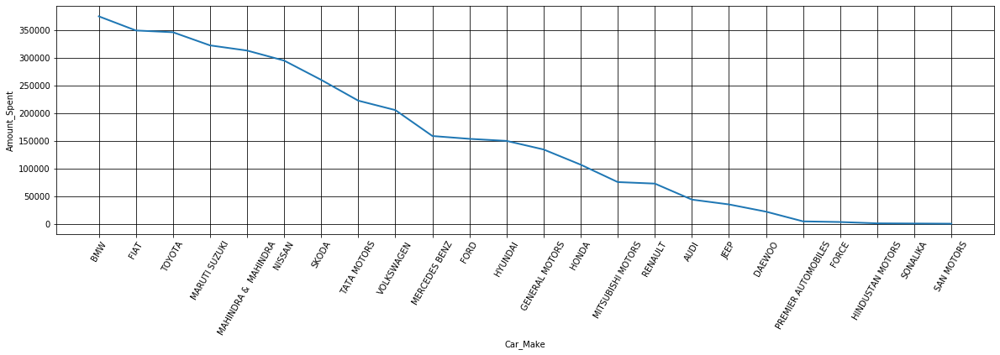

Most highest amount spent per make for the state of Kerala


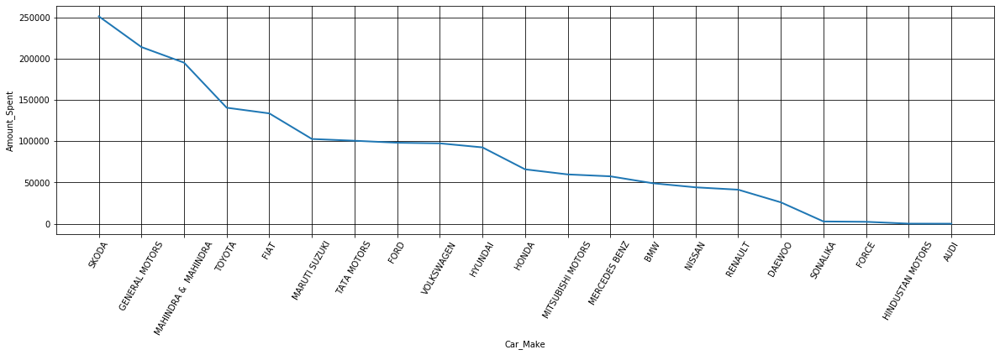

Most highest amount spent per make for the state of Lakshadweep


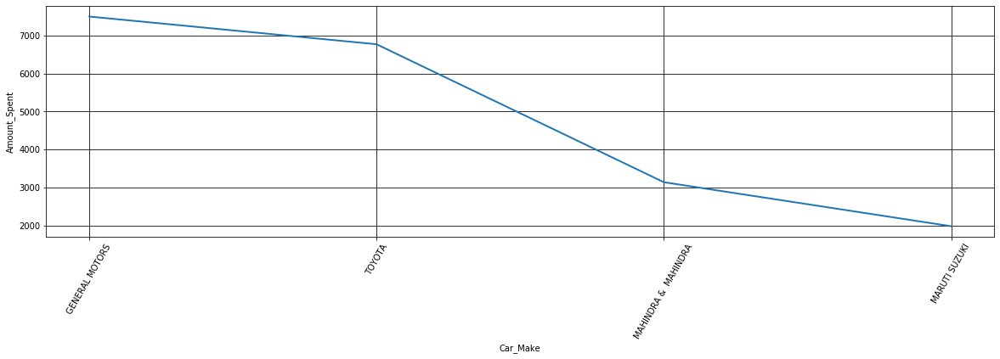

Most highest amount spent per make for the state of Madhya Pradesh


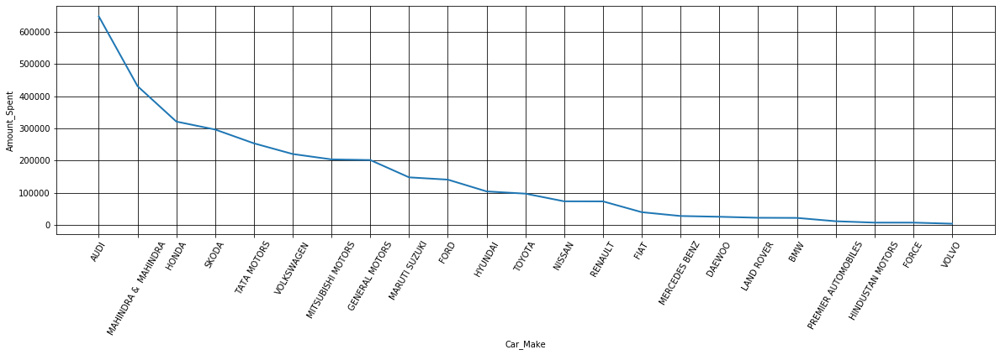

Most highest amount spent per make for the state of Maharashtra


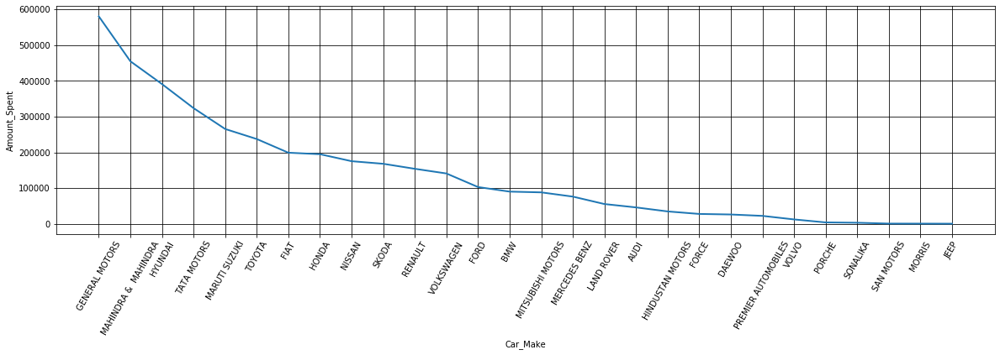

Most highest amount spent per make for the state of Manipur


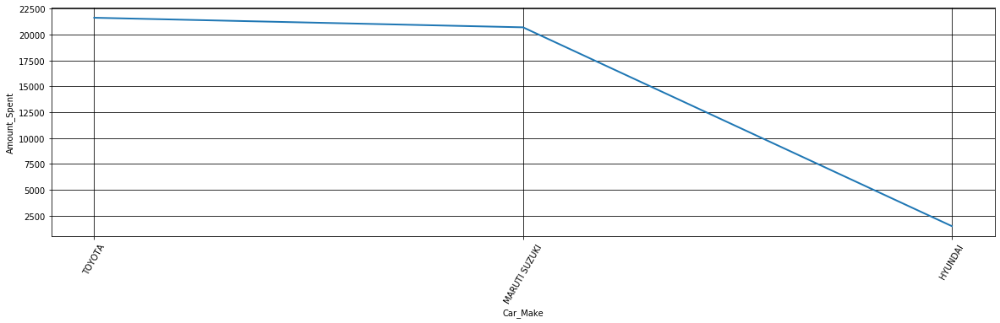

Most highest amount spent per make for the state of Megalaya


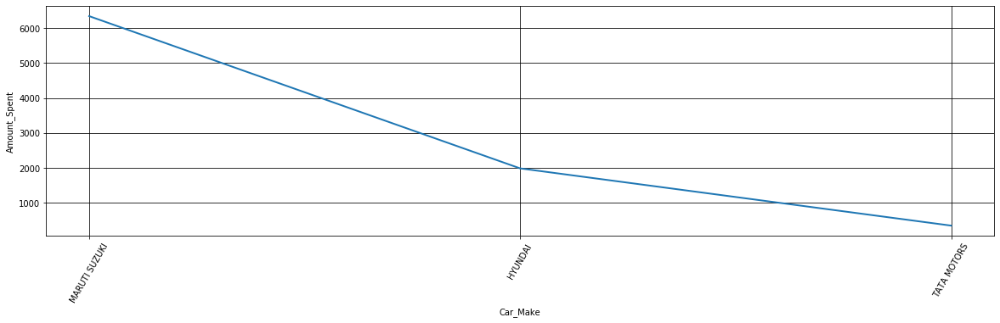

Most highest amount spent per make for the state of Mizoram


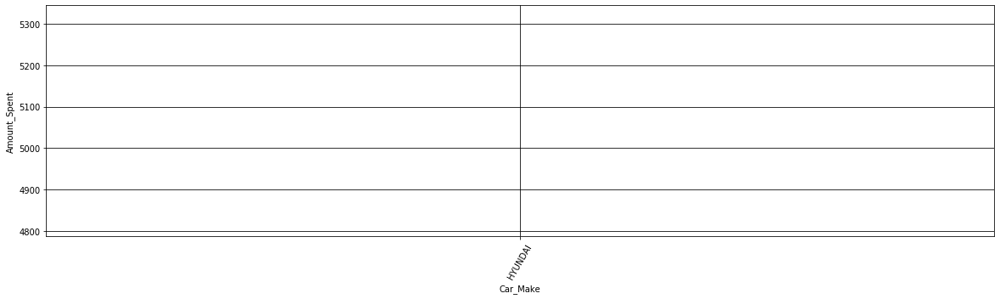

Most highest amount spent per make for the state of Nagaland


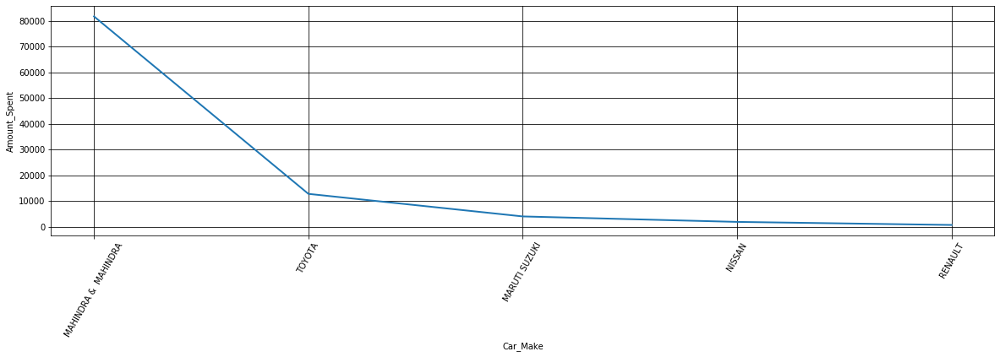

Most highest amount spent per make for the state of Odisha


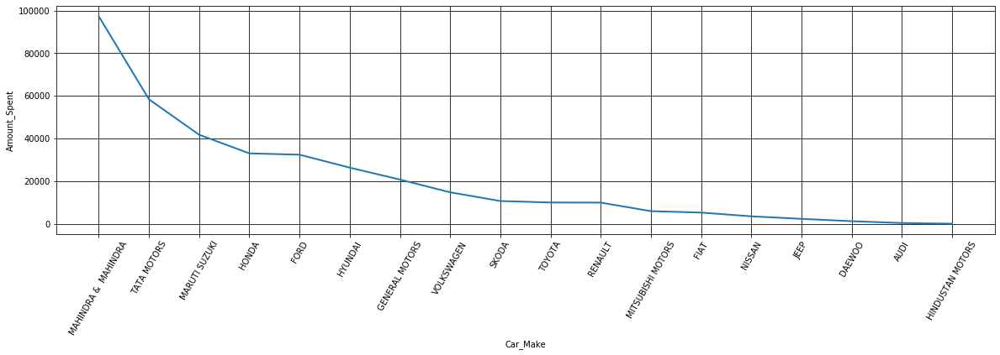

Most highest amount spent per make for the state of Puducherry


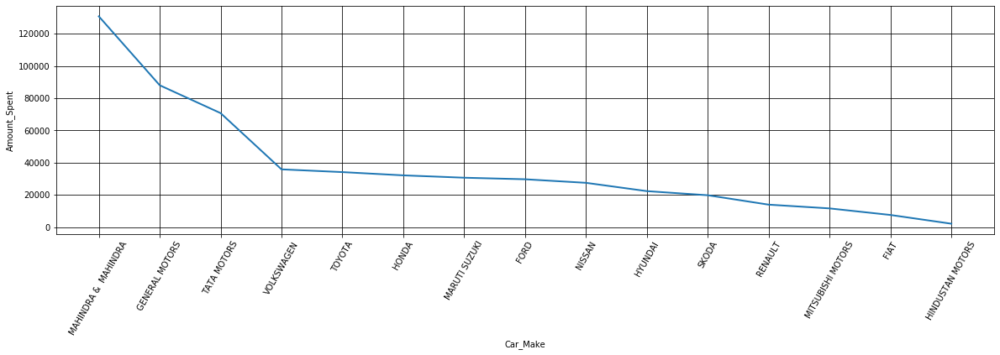

Most highest amount spent per make for the state of Punjab


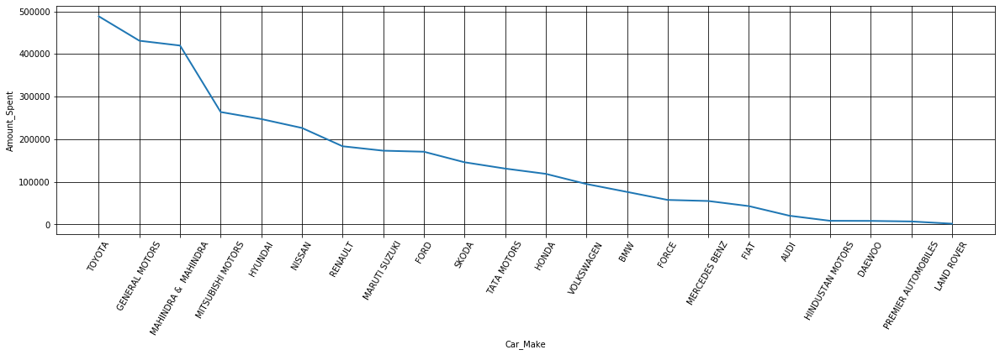

Most highest amount spent per make for the state of Rajasthan


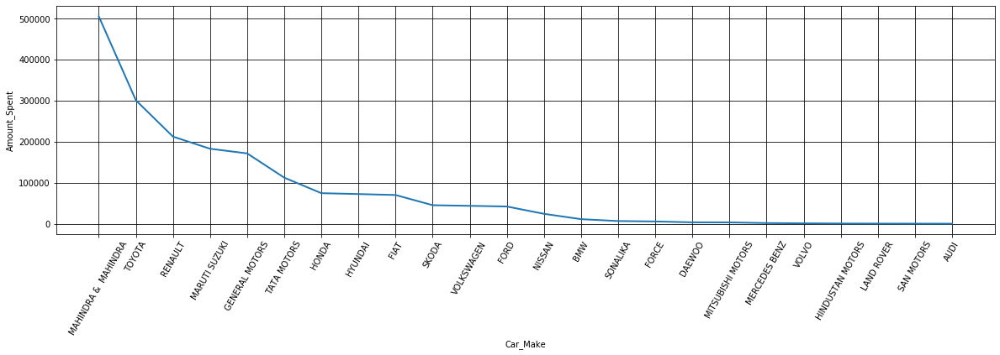

Most highest amount spent per make for the state of Sikkim


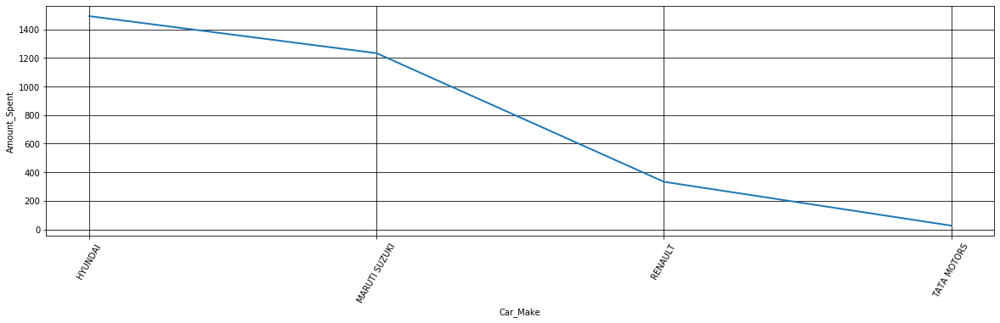

Most highest amount spent per make for the state of Tamil Nadu


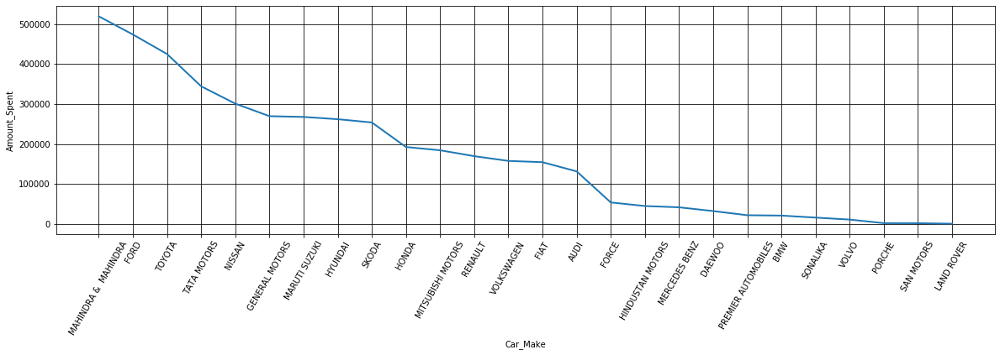

Most highest amount spent per make for the state of Telangana


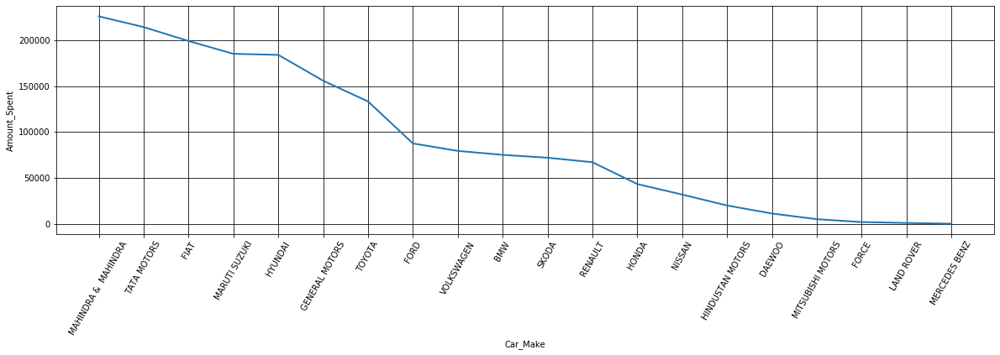

Most highest amount spent per make for the state of Tripura


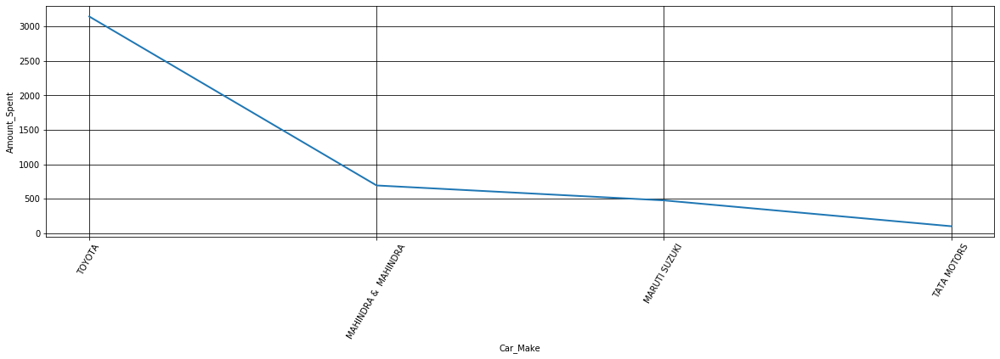

Most highest amount spent per make for the state of Uttar Pradesh


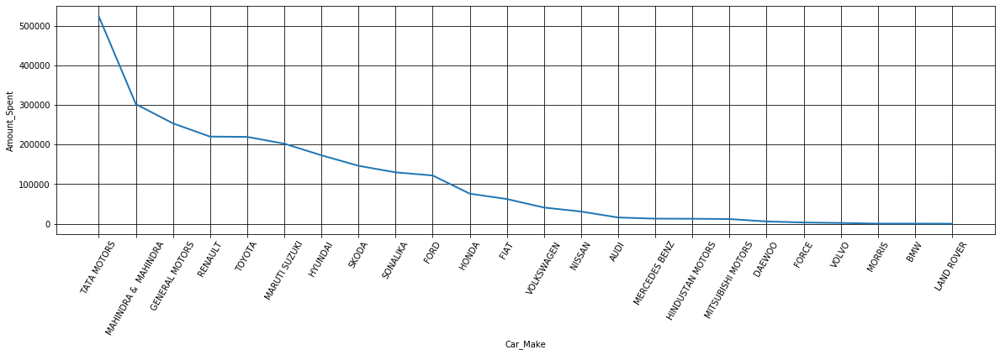

Most highest amount spent per make for the state of Uttarakhand


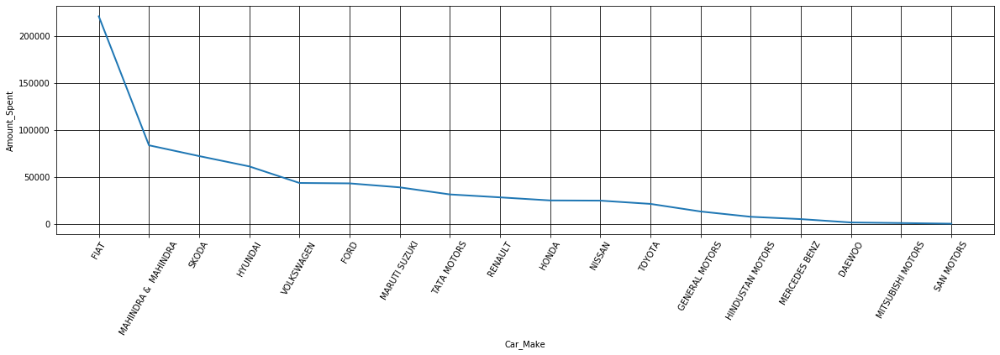

Most highest amount spent per make for the state of West Bengal


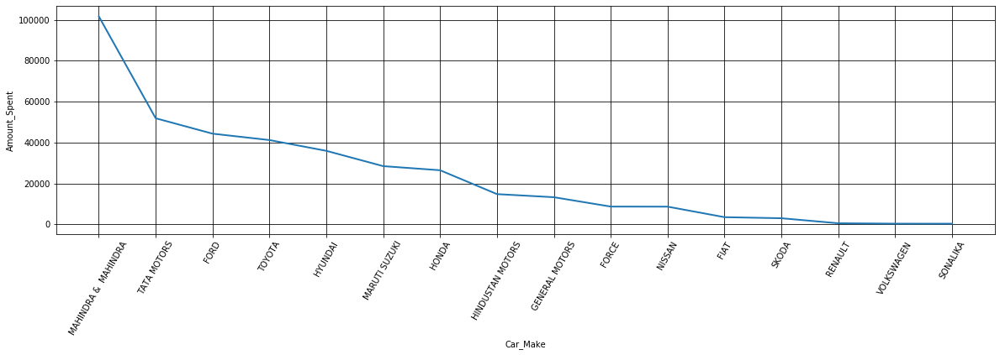

In [53]:
for i in p['District'].unique():
    state = i
    quart_cnt = list(p[p['District']== i]['Quart_revenue'].values)
    quart_lable = list(p[p['District']== i]['Make'].values)
    print('Most highest amount spent per make for the state of '+state)
    scatter_plot(quart_cnt,quart_lable,'Car_Make','Amount_Spent')

From above data we could gather information about top three average spent per make per state as well as top three highest spent per make per state.